## Pre-requisite: Library requirements

In [ ]:
# # !nvidia-smi
%pip install numpy
%pip install matplotlib
%pip install glob
%pip install os 
%pip install sklearn

In [ ]:
#!nvidia-smi
import numpy as np
from matplotlib import pyplot as plt
import matplotlib
import glob
import os

In [ ]:
%ls
%ls ../data
%ls ../data/frac_map | head -10

# Classification
## Phase 01 - Data Visualization
### 1. Extract data and save them into frac_map and time_series

- Each fraction map is of shape (1,64,64) and time series is of shape (442,1)
- There are 26754 data in total in fraction map and time series

In [ ]:
fracmaps_dir = '../data/frac_map'
frac_maps = os.listdir(fracmaps_dir)
timeseries_dir = '../data/time_series'
time_series = os.listdir(timeseries_dir)

total_maps = len(frac_maps) # 26754
total_ts = len(time_series) # 26754
print("total_maps len is ", total_maps, "total_ts len is ", total_ts)

## save fraction map and time series into img arrays
for i in range(0, total_maps):
    fm = frac_maps[i]
    frac_maps[i] = np.load(os.path.join(fracmaps_dir, fm), allow_pickle=True)
    ts = time_series[i]
    time_series[i] = np.load(os.path.join(timeseries_dir, ts), allow_pickle=True)
    

print(frac_maps[0].shape) ## (1,64,64)
print(time_series[0].shape) ## (442, 1)

In [ ]:
t = os.listdir('../data/frac_map')
t[0]

### 2. Visualization of Fraction Maps

In [ ]:
fig, axes = plt.subplots(40,5, figsize=(40, 250))
fig.suptitle('Fraction Map Visualization',y=0.35,fontsize=40,ha='center')
ax = axes.ravel()
for i in range(0,200):
    image_array = frac_maps[i]
    img_array = np.squeeze(image_array, axis = 0)
    ax[i].imshow(img_array)

for a in ax:
        a.set_axis_off()
plt.tight_layout()
plt.show()

# TODO: Add the map name as well, to match with equivalent time series.

In [ ]:
#plt.gray() # B/W Images
plt.figure(figsize = (10,9)) # Adjusting figure size
# Displaying a grid of 3x3 images
for i in range(9):
    plt.subplot(3,3,i+1)
    img_array = frac_maps[i]
    img_array = np.squeeze(img_array, axis = 0)
    plt.imshow(img_array)

### 3. Visualization of Time Series

In [ ]:
fig, axes = plt.subplots(40,5, figsize=(40, 250))
fig.suptitle('Time series visualization',y=1.0,fontsize=40,ha='center')
ax = axes.ravel()
for i in range(0,200):
    ts_array = time_series[i]
    ax[i].plot(ts_array)

for a in ax:
        a.set_axis_off()
plt.tight_layout()
plt.show()   


# TODO: Add the name as well, to match with equivalent fraction map.

In [ ]:
# helper function for visualizing time series array
def visualize_ts(ts):
    plt.plot(ts)
    plt.show()

def visualize_subplots(n, arr):
    fig, axes = plt.subplots(1, n, figsize=(30, 10))
    fig.suptitle('First ' + str(n) + ' Time series visualization')
    for i in range(0, n):
        array = arr[i]
        axes[i].plot(array)
    
# visualize_subplots(1,time_series)

### 4. Visualization of corresponding fraction map and time series of river

### 5. The following are the labels info in the ../data/label_info folder as ground truth.

#### Label Array - 1000000 in total

| Label      | Description |
| ----------- | ----------- |
| 0      | Unknown       |
| 1   | Farm        |
| 2   | Reservoir        |
| 3   | River        |
| 4   | Stable Lakes        |
| 5   | Seasonal Lakes        |

array[no] = C → ID no is class C


#### Continent info

| Label      | Description |
| ----------- | ----------- |
| 1   | Asia        |
| 2   | North America        |
| 3   | Europe        |
| 4   | Africa        |
| 5   | South America        |
| 6   | Oceania        |
| 7   | Australia        |
| 8   | Antarctica        |

array[no] = C → ID no is in Continent C


In [ ]:
ID_labels = '../label_info/all_IDs_labels.npy'
ID_labels = np.load(ID_labels, allow_pickle=True)

# size of all labels
print(ID_labels.shape) ## (1000000,)

# check size of each label
print(np.where(ID_labels==0)[0].shape) # (979799,) - unknown
print(np.where(ID_labels==1)[0].shape) # (427,) - farm
print(np.where(ID_labels==2)[0].shape) # (18707,) - reservoir
print(np.where(ID_labels==3)[0].shape) # (317,) - river
print(np.where(ID_labels==4)[0].shape) # (143,) - stable lakes
print(np.where(ID_labels==5)[0].shape) # (288,) - seasonal lakes

fm_river_labels = np.where(ID_labels==3)[0]
fm_river_labels
# print(fm_river_labels)
# fname = '../data/frac_map/ID_409869_frac_map.npy'
# s = np.load(fname, allow_pickle=True)
# river_0 = np.squeeze(s, axis = 0)
# plt.imshow(river_0)

In [ ]:
ID_labels[409869]

#### - Save all river fraction maps in the fm_rivers and river time series in the ts_rivers array

In [ ]:
# extract river from fraction maps and time series maps
river_ids = np.where(ID_labels==3)[0]
print(river_ids.shape) # 317
#fracmaps_dir = '../data/frac_map'
#timeseries_dir = '../data/time_series'
fm_rivers = []
ts_rivers = []
pre = 'ID_'
fm_post = '_frac_map.npy'
ts_post = '_time_series.npy'

for sid in river_ids:
    fm_name = pre + str(sid) + fm_post
    ts_name = pre + str(sid) + ts_post
    fm_path = os.path.join(fracmaps_dir, fm_name)
    ts_path = os.path.join(timeseries_dir, ts_name)
    fm_rivers.append(np.load(fm_path, allow_pickle=True))
    ts_rivers.append(np.load(ts_path, allow_pickle=True))
#     print(np.load(ts_path, allow_pickle=True).shape) # (442,1)

fm_rivers = np.array(fm_rivers)
ts_rivers = np.array(ts_rivers)
print(fm_rivers.shape) # should be 317
print(ts_rivers.shape) # should be 317

# visualize the first river fraction map
# river_0 = np.squeeze(fm_rivers[0], axis = 0)
# plt.imshow(river_0)

In [ ]:
## helper function for visualizing the fraction map and time series of the same river
def visualize_river(idx):
    fig, axes = plt.subplots(1, 2, figsize=(30, 10))
    fig.suptitle('Corresponding fraction map and time series visualization of river ' + str(idx))

    river = np.squeeze(fm_rivers[idx], axis = 0)
    axes[0].imshow(river)
    axes[1].plot(ts_rivers[idx])


In [ ]:
# There are 317 rivers, idx from [0, 316]
for i in range(20,40):
    visualize_river(i)

## Phase 02 - Data Exploration

Every fraction_map is 64x64.

What are the values?

In [ ]:
test_frac_arr = frac_maps[0]
# test_frac_arr
print(test_frac_arr[0])
print("\nUnique Values found:\n\n ", np.unique(test_frac_arr))

The values are floats between 0-1.

Let's visualize:

In [ ]:
plt.imshow(test_frac_arr[0])

Let's print out the coordinates of each pixel that aren't 0.

In [ ]:
nonzero = []

# 64*64 pixels
for i in range(len(test_frac_arr[0])):
    for j in range(len(test_frac_arr[0][i])):
        if test_frac_arr[0][i][j] != 0:
            print("X:",j,"Y:",i,"Value:",test_frac_arr[0][i][j])
            nonzero.append((j,i,test_frac_arr[0][i][j]))

# nonzero

How many of the pixels are non zero?

In [ ]:
# there are 64*64 = 4069 pixels in total in a single fraction map
print(len(nonzero),"(out of 4096) or ",(len(nonzero)/4096)*100,"%")

Let's see out of these 345 pixels, which ones are the highest value.

In [ ]:
max = 0
count = 0
for i in nonzero:
    if i[2] > max:
        count = 0
        max = i[2]
    if i[2] == max:
        count += 1

print("max:",max,"count:",count)

Now let's see how many fraction maps we have.



In [ ]:
print(len(frac_maps))
print(len(time_series))
plt.imshow(frac_maps[0][0]) #frac_maps[i] is 1*64*64

# Preprocessing frac_maps

Currently, we have 26754 fraction maps. Each of these is of shape 1x64x64. Let's change that to 64x64 and aggregate them all into one array where each value is tuple in the form (name of file, 64x64 array)

In [ ]:
fms = [] # fraction map: contains each 26754 64*64 array

for i in range(0, len(frac_maps)):
    fms.append(frac_maps[i][0])
    
fms = np.array(fms)
print(fms[0])
plt.imshow(fms[0])

In [ ]:
# time_series is saved in time_series array of size 442*1
plt.plot(time_series[0])

## Phase 03 - Classification Methods

In [ ]:
%pip install -U scikit-learn scipy matplotlib
%pip install opencv-python
%pip install kmeanstf

In [ ]:
from sklearn.cluster import KMeans
from sklearn import datasets
from sklearn.utils import shuffle
import re
import cv2
from kmeanstf import KMeansTF

In [ ]:
plt.gray() # B/W Images
plt.figure(figsize = (10,9)) # Adjusting figure size
# Displaying a grid of 3x3 images
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(fms[i])

In [ ]:
fm_filename = os.listdir('../data/frac_map') # has a 1-1 mapping with fms => fm_filename[i] is the filename of fms[i]
print(fm_filename[0])
ID_labels[0] # ID_labels is the ground truth array, len = 100,0000, ID_labels[ID] = class_no, ID is from filename

#### x_train is fms[i] which is a 64*64 2d array, y_train is ID_labels[getID(fm_filename, i)] which is a number

In [ ]:
# a helper function which gets the ID of a fraction map array given the idx

def getID(fm_fn, idx):
    fn = fm_fn[idx] # get the file name
    fm_id = int(re.findall(r'\d+', fn)[0])
    return fm_id

getID(fm_filename, 1)

In [ ]:
# print examples in y_train
for i in range(5):
    print(ID_labels[i])

The output is from [0,5]. The ‘y_train’ and ‘y_test’ are numbers from 0 to 5 which indicate the class labels of the water body fraction map.

In [ ]:
y_train = []
for i in range(0, len(fms)):
    y_train.append(ID_labels[getID(fm_filename, i)])

y_train = np.array(y_train)

Since data is already between 0 to 1 we do not require normalization.

In [ ]:
# Checking the minimum and maximum values of x_train pixels - we don't need data normalization
print(fms.min())
print(fms.max())

The minimum and maximum values are 0 and 1 respectively. The input data is in range of [0,1]. The input data have to be converted from 3 dimensional format to 2 dimensional format to be fed into the K-Means Clustering algorithm. Hence the input data has to be reshaped.

In [ ]:
print(fms.shape)
print(y_train.shape)

In [ ]:
# Reshaping input data
X_train = fms.reshape(len(fms),-1)
#X_test = x_test.reshape(len(x_test),-1)
print(X_train.shape)

The output is (26754, 4096). (64 x 64 = 4096)

## Mini-batch Kmeans

In [ ]:
from sklearn.cluster import MiniBatchKMeans
total_clusters = 100
# Initialize the K-Means model
kmeans = MiniBatchKMeans(n_clusters = total_clusters)
# Fitting the model to training set
kmeans.fit(X_train)

In [ ]:
print(kmeans.labels_)
print(len(kmeans.labels_))

The images are classified into clusters based on similarity of pixel values. Each image is assigned a cluster label value given by kmeans.labels_. So kmeans.labels_ is an array of length 26754 as there are 26754 images in the training set.

In [ ]:
def retrieve_info(cluster_labels,y_train):
#  Associates most probable label with each cluster in KMeans model
#  returns: dictionary of clusters assigned to each label
    # Initializing
    reference_labels = {}
    # For loop to run through each label of cluster label
    for i in range(len(np.unique(kmeans.labels_))):
        index = np.where(cluster_labels == i,1,0)
        num = np.bincount(y_train[index==1]).argmax()
        reference_labels[i] = num
        
#     print(reference_labels)
    return reference_labels

In [ ]:
reference_labels = retrieve_info(kmeans.labels_,y_train)
number_labels = np.random.rand(len(kmeans.labels_))
for i in range(len(kmeans.labels_)):
    number_labels[i] = reference_labels[kmeans.labels_[i]]

In [ ]:
# Comparing Predicted values and Actual values
print(number_labels[:20].astype('int'))
print(y_train[:20])

In [ ]:
from sklearn.metrics import accuracy_score

# It counts the undefined into consideration, may need to remove those data points for computing accuracy
print(accuracy_score(number_labels,y_train)) # accuracy_score(y_true, y_pred)

Reference: https://medium.com/@joel_34096/k-means-clustering-for-image-classification-a648f28bdc47

In [ ]:
kmeans

# shonal test

In [ ]:
!ls ../label_info

In [ ]:
filename = "../label_info/all_IDs_labels.npy"

label_info = np.load(filename)

In [ ]:
li2 = []

for i in range(len(label_info)):
    if label_info[i] == 3:
        li2.append(i)
        
print(len(li2))

In [ ]:
visualize_river(11)

set up train, test, and val

In [43]:
X_train.shape

(26754, 4096)

resnet50v2 testing

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img

In [ ]:
resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',include_top = False, input_shape = (64,64,3))

for i in resnet50v2.layers:
    i.trainable=False
    
output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])

history = resnet50v2model.fit(X_train,
                              epochs=10,
                              #validation_data=val,
                              steps_per_epoch=50,
                              callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience=10)],
                              batch_size=64)

train_score = resnet50v2model.evaluate(X_train)
#test_score = resnet50v2model.evaluate(y_test)
print("train accuracy:",train_score[1]*100,"%")
#print("test accuracy:", test_score[1]*100,"%")

In [44]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf

import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 


In [54]:
IMAGE_SIZE = [64,64]
train_path = "../data/train"
valid_path = "../data/test"

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',include_top = False, input_shape=(224,224,3))

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                         

                                                                                                  
 conv2_block3_preact_relu (Acti  (None, 56, 56, 256)  0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                                                                                          
                                                                                                  
 conv2_block3_1_conv (Conv2D)   (None, 56, 56, 64)   16384       ['conv2_block3_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv2_block3_1_bn (BatchNormal  (None, 56, 56, 64)  256         ['conv2_block3_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_blo

 conv3_block2_2_conv (Conv2D)   (None, 28, 28, 128)  147456      ['conv3_block2_2_pad[0][0]']     
                                                                                                  
 conv3_block2_2_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block2_2_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block2_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block2_3_conv (Conv2D)   (None, 28, 28, 512)  66048       ['conv3_block2_2_relu[0][0]']    
                                                                                                  
 conv3_blo

 conv4_block1_1_conv (Conv2D)   (None, 14, 14, 256)  131072      ['conv4_block1_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv4_block1_1_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block1_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block1_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block1_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block1_2_pad (ZeroPaddin  (None, 16, 16, 256)  0          ['conv4_block1_1_relu[0][0]']    
 g2D)     

                                                                                                  
 conv4_block3_2_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block3_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block3_3_conv (Conv2D)   (None, 14, 14, 1024  263168      ['conv4_block3_2_relu[0][0]']    
                                )                                                                 
                                                                                                  
 conv4_block3_out (Add)         (None, 14, 14, 1024  0           ['conv4_block2_out[0][0]',       
                                )                                 'conv4_block3_3_conv[0][0]']    
                                                                                                  
 conv4_blo

 conv4_block6_1_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block6_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block6_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block6_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block6_2_pad (ZeroPaddin  (None, 16, 16, 256)  0          ['conv4_block6_1_relu[0][0]']    
 g2D)                                                                                             
                                                                                                  
 conv4_block6_2_conv (Conv2D)   (None, 7, 7, 256)    589824      ['conv4_block6_2_pad[0][0]']     
          

                                                                                                  
 conv5_block2_3_conv (Conv2D)   (None, 7, 7, 2048)   1050624     ['conv5_block2_2_relu[0][0]']    
                                                                                                  
 conv5_block2_out (Add)         (None, 7, 7, 2048)   0           ['conv5_block1_out[0][0]',       
                                                                  'conv5_block2_3_conv[0][0]']    
                                                                                                  
 conv5_block3_preact_bn (BatchN  (None, 7, 7, 2048)  8192        ['conv5_block2_out[0][0]']       
 ormalization)                                                                                    
                                                                                                  
 conv5_block3_preact_relu (Acti  (None, 7, 7, 2048)  0           ['conv5_block3_preact_bn[0][0]'] 
 vation)  

In [46]:
output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', optimizer='adam',metrics=['accuracy'])

In [47]:
resnet50v2model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                            

                                                                                                  
 conv2_block3_preact_relu (Acti  (None, 56, 56, 256)  0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                                                                                          
                                                                                                  
 conv2_block3_1_conv (Conv2D)   (None, 56, 56, 64)   16384       ['conv2_block3_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv2_block3_1_bn (BatchNormal  (None, 56, 56, 64)  256         ['conv2_block3_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_blo

 conv3_block2_2_conv (Conv2D)   (None, 28, 28, 128)  147456      ['conv3_block2_2_pad[0][0]']     
                                                                                                  
 conv3_block2_2_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block2_2_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block2_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block2_3_conv (Conv2D)   (None, 28, 28, 512)  66048       ['conv3_block2_2_relu[0][0]']    
                                                                                                  
 conv3_blo

 conv4_block1_1_conv (Conv2D)   (None, 14, 14, 256)  131072      ['conv4_block1_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv4_block1_1_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block1_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block1_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block1_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block1_2_pad (ZeroPaddin  (None, 16, 16, 256)  0          ['conv4_block1_1_relu[0][0]']    
 g2D)     

                                                                                                  
 conv4_block3_2_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block3_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block3_3_conv (Conv2D)   (None, 14, 14, 1024  263168      ['conv4_block3_2_relu[0][0]']    
                                )                                                                 
                                                                                                  
 conv4_block3_out (Add)         (None, 14, 14, 1024  0           ['conv4_block2_out[0][0]',       
                                )                                 'conv4_block3_3_conv[0][0]']    
                                                                                                  
 conv4_blo

 conv4_block6_1_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block6_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block6_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block6_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block6_2_pad (ZeroPaddin  (None, 16, 16, 256)  0          ['conv4_block6_1_relu[0][0]']    
 g2D)                                                                                             
                                                                                                  
 conv4_block6_2_conv (Conv2D)   (None, 7, 7, 256)    589824      ['conv4_block6_2_pad[0][0]']     
          

                                                                                                  
 conv5_block2_3_conv (Conv2D)   (None, 7, 7, 2048)   1050624     ['conv5_block2_2_relu[0][0]']    
                                                                                                  
 conv5_block2_out (Add)         (None, 7, 7, 2048)   0           ['conv5_block1_out[0][0]',       
                                                                  'conv5_block2_3_conv[0][0]']    
                                                                                                  
 conv5_block3_preact_bn (BatchN  (None, 7, 7, 2048)  8192        ['conv5_block2_out[0][0]']       
 ormalization)                                                                                    
                                                                                                  
 conv5_block3_preact_relu (Acti  (None, 7, 7, 2048)  0           ['conv5_block3_preact_bn[0][0]'] 
 vation)  

In [48]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf

import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

In [49]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

In [53]:
train_path = '../data/train/'
valid_path = '../data/test/'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (224,224),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (224,224),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 1 images belonging to 1 classes.
Found 2 images belonging to 1 classes.


In [52]:
training

In [ ]:
hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))

In [ ]:
train_score = resnet50v2model.evaluate(train)
test_score = resnet50v2model.evaluate(test)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

# shonal 12/3/22 - 12/5

In [1]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf

import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

2022-12-06 16:55:57.441708: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-06 16:55:57.553693: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-06 16:55:57.553735: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-12-06 16:55:57.574730: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-12-06 16:5

In [9]:
%ls -a ../data/shonal/test

./  ../  .ipynb_checkpoints/  other/  river/


In [17]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

train_path = '../data/shonal/train'
valid_path = '../data/shonal/test'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (64,64),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (64,64),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 1406 images belonging to 2 classes.
Found 352 images belonging to 2 classes.


In [22]:
IMAGE_SIZE = [64,64]

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                              include_top = False,
                                              classes = 2
                                              #input_shape=(64,64,3)
                                             )

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', 
                        optimizer='adam',
                        metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))


Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_6[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                      

                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
                                                                                                  
 conv2_blo

                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)                           128)                                                              
          

 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_16 (MaxPooling2D  (None, None, None,   0          ['conv3_block3_out[0][0]']       
 )                              512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_block4_out (Add)         (None, None, None,   0           ['max_pooling2d_16[0][0]',       
          

                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_blo

                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
                                1024)                                                             
          

 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block2_preact_relu[0][0]'
          

In [23]:
train_score = resnet50v2model.evaluate(training)
test_score = resnet50v2model.evaluate(testing)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

44/44 [==============================] - 1s 21ms/step - loss: 0.1592 - accuracy: 0.9744 - precision_3: 0.8873 - recall_3: 0.9844
train accuracy: 98.64864945411682 %
test accuracy: 97.44318127632141 %


# k-fold cross validation k = 5 12/8/22

In [11]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf

import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

In [12]:
results = []

for i in range(5):
    train_augmentation = ImageDataGenerator(
        rescale = 1./255,
        shear_range = 0.2,
        horizontal_flip = True,
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
    )

    test_rescale = ImageDataGenerator(
        rescale = 1./255
    )

    train_path = '../data/shonal'+str(i+1)+'/train'
    valid_path = '../data/shonal'+str(i+1)+'/test'
    training = train_augmentation.flow_from_directory(train_path,
                                                     target_size = (64,64),
                                                     batch_size = 8,
                                                     class_mode = 'binary')
    testing = test_rescale.flow_from_directory(valid_path,
                                                   target_size = (64,64),
                                                   batch_size = 8,
                                                   class_mode = 'binary')

    IMAGE_SIZE = [64,64]

    resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                                  include_top = False,
                                                  classes = 2
                                                  #input_shape=(64,64,3)
                                                 )

    for layer in resnet50v2.layers:
        layer.trainable = False

    resnet50v2.summary()

    output = resnet50v2.output
    output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
    output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
    y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
    resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
    resnet50v2model.compile(loss='binary_crossentropy', 
                            optimizer='adam',
                            metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

    hist = resnet50v2model.fit(training,
                    validation_data = testing,
                    epochs = 20,
                    steps_per_epoch=len(training),
                    validation_steps=len(testing))

    train_score = resnet50v2model.evaluate(training)
    test_score = resnet50v2model.evaluate(testing)
    print("train accuracy:",train_score[1]*100,"%")
    print("test accuracy:", test_score[1]*100,"%")
    print("train score:", train_score)
    results.append([i+1, train_score[1]*100, train_score[2]*100, train_score[3]*100, 
                    test_score[1]*100, test_score[2]*100, test_score[3]*100])
    
for i in results:
    print("k = ",i[0],"\n", 
          "train accuracy:",i[1],"train precision:",i[2],"train recall:",i[3],
          "test accuracy:",i[4],"test precision:",i[5],"test recall:",i[6])

Found 1401 images belonging to 2 classes.
Found 352 images belonging to 2 classes.
Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_5[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
      

                                256)                                                              
                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
          

 conv3_block2_1_conv (Conv2D)   (None, None, None,   65536       ['conv3_block2_preact_relu[0][0]'
                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)     

                                                                                                  
 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_13 (MaxPooling2D  (None, None, None,   0          ['conv3_block3_out[0][0]']       
 )                              512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_blo

 ormalization)                  1024)                                                             
                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
          

 conv4_block5_2_conv (Conv2D)   (None, None, None,   589824      ['conv4_block5_2_pad[0][0]']     
                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
          

                                                                                                  
 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_blo

Epoch 3/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0654 - accuracy: 0.9800 - precision_4: 0.9421 - recall_4: 0.9494 - val_loss: 0.0313 - val_accuracy: 0.9858 - val_precision_4: 0.9661 - val_recall_4: 0.9500
Epoch 4/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0643 - accuracy: 0.9800 - precision_4: 0.9421 - recall_4: 0.9494 - val_loss: 0.0219 - val_accuracy: 0.9915 - val_precision_4: 0.9524 - val_recall_4: 1.0000
Epoch 5/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0615 - accuracy: 0.9800 - precision_4: 0.9455 - recall_4: 0.9455 - val_loss: 0.0946 - val_accuracy: 0.9744 - val_precision_4: 0.8696 - val_recall_4: 1.0000
Epoch 6/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0541 - accuracy: 0.9814 - precision_4: 0.9392 - recall_4: 0.9611 - val_loss: 0.0277 - val_accuracy: 0.9943 - val_precision_4: 0.9677 - val_recall_4: 1.0000
Epoch 7/20
176/176 [==============================] - 5s 26ms/step -

                                                                                                  
 conv2_block1_2_conv (Conv2D)   (None, None, None,   36864       ['conv2_block1_2_pad[0][0]']     
                                64)                                                               
                                                                                                  
 conv2_block1_2_bn (BatchNormal  (None, None, None,   256        ['conv2_block1_2_conv[0][0]']    
 ization)                       64)                                                               
                                                                                                  
 conv2_block1_2_relu (Activatio  (None, None, None,   0          ['conv2_block1_2_bn[0][0]']      
 n)                             64)                                                               
                                                                                                  
 conv2_blo

                                256)                                                              
                                                                                                  
 conv2_block3_out (Add)         (None, None, None,   0           ['max_pooling2d_15[0][0]',       
                                256)                              'conv2_block3_3_conv[0][0]']    
                                                                                                  
 conv3_block1_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block3_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv3_block1_preact_relu (Acti  (None, None, None,   0          ['conv3_block1_preact_bn[0][0]'] 
 vation)                        256)                                                              
          

 conv3_block3_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block3_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block3_1_relu (Activatio  (None, None, None,   0          ['conv3_block3_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block3_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block3_1_relu[0][0]']    
 g2D)                           128)                                                              
                                                                                                  
 conv3_block3_2_conv (Conv2D)   (None, None, None,   147456      ['conv3_block3_2_pad[0][0]']     
          

                                                                                                  
 conv4_block1_2_relu (Activatio  (None, None, None,   0          ['conv4_block1_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block1_0_conv (Conv2D)   (None, None, None,   525312      ['conv4_block1_preact_relu[0][0]'
                                1024)                            ]                                
                                                                                                  
 conv4_block1_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block1_2_relu[0][0]']    
                                1024)                                                             
                                                                                                  
 conv4_blo

 vation)                        1024)                                                             
                                                                                                  
 conv4_block4_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block4_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block4_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block4_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block4_1_relu (Activatio  (None, None, None,   0          ['conv4_block4_1_bn[0][0]']      
 n)                             256)                                                              
          

 conv4_block6_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block6_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block6_2_relu (Activatio  (None, None, None,   0          ['conv4_block6_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 max_pooling2d_17 (MaxPooling2D  (None, None, None,   0          ['conv4_block5_out[0][0]']       
 )                              1024)                                                             
                                                                                                  
 conv4_block6_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block6_2_relu[0][0]']    
          

                                                                                                  
 conv5_block3_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block2_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block3_preact_relu (Acti  (None, None, None,   0          ['conv5_block3_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block3_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block3_preact_relu[0][0]'
                                512)                             ]                                
                                                                                                  
 conv5_blo

Epoch 18/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0298 - accuracy: 0.9872 - precision_5: 0.9537 - recall_5: 0.9763 - val_loss: 0.0691 - val_accuracy: 0.9771 - val_precision_5: 0.8889 - val_recall_5: 1.0000
Epoch 19/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0560 - accuracy: 0.9808 - precision_5: 0.9484 - recall_5: 0.9447 - val_loss: 0.0353 - val_accuracy: 0.9857 - val_precision_5: 0.9538 - val_recall_5: 0.9688
Epoch 20/20
44/44 [==============================] - 1s 21ms/step - loss: 0.0438 - accuracy: 0.9857 - precision_5: 0.9683 - recall_5: 0.9531
train accuracy: 98.14682602882385 %
test accuracy: 98.57142567634583 %
train score: [0.04895438626408577, 0.9814682602882385, 0.9670782089233398, 0.9288537502288818]
Found 1403 images belonging to 2 classes.
Found 350 images belonging to 2 classes.
Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)          

                                                                                                  
 conv2_block2_2_conv (Conv2D)   (None, None, None,   36864       ['conv2_block2_2_pad[0][0]']     
                                64)                                                               
                                                                                                  
 conv2_block2_2_bn (BatchNormal  (None, None, None,   256        ['conv2_block2_2_conv[0][0]']    
 ization)                       64)                                                               
                                                                                                  
 conv2_block2_2_relu (Activatio  (None, None, None,   0          ['conv2_block2_2_bn[0][0]']      
 n)                             64)                                                               
                                                                                                  
 conv2_blo

                                512)                                                              
                                                                                                  
 conv3_block1_out (Add)         (None, None, None,   0           ['conv3_block1_0_conv[0][0]',    
                                512)                              'conv3_block1_3_conv[0][0]']    
                                                                                                  
 conv3_block2_preact_bn (BatchN  (None, None, None,   2048       ['conv3_block1_out[0][0]']       
 ormalization)                  512)                                                              
                                                                                                  
 conv3_block2_preact_relu (Acti  (None, None, None,   0          ['conv3_block2_preact_bn[0][0]'] 
 vation)                        512)                                                              
          

 conv3_block4_1_relu (Activatio  (None, None, None,   0          ['conv3_block4_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block4_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block4_1_relu[0][0]']    
 g2D)                           128)                                                              
                                                                                                  
 conv3_block4_2_conv (Conv2D)   (None, None, None,   147456      ['conv3_block4_2_pad[0][0]']     
                                128)                                                              
                                                                                                  
 conv3_block4_2_bn (BatchNormal  (None, None, None,   512        ['conv3_block4_2_conv[0][0]']    
 ization) 

                                                                                                  
 conv4_block2_2_relu (Activatio  (None, None, None,   0          ['conv4_block2_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block2_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block2_2_relu[0][0]']    
                                1024)                                                             
                                                                                                  
 conv4_block2_out (Add)         (None, None, None,   0           ['conv4_block1_out[0][0]',       
                                1024)                             'conv4_block2_3_conv[0][0]']    
                                                                                                  
 conv4_blo

                                256)                             ]                                
                                                                                                  
 conv4_block5_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_1_relu (Activatio  (None, None, None,   0          ['conv4_block5_1_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_2_pad (ZeroPaddin  (None, None, None,   0          ['conv4_block5_1_relu[0][0]']    
 g2D)                           256)                                                              
          

 conv5_block1_2_bn (BatchNormal  (None, None, None,   2048       ['conv5_block1_2_conv[0][0]']    
 ization)                       512)                                                              
                                                                                                  
 conv5_block1_2_relu (Activatio  (None, None, None,   0          ['conv5_block1_2_bn[0][0]']      
 n)                             512)                                                              
                                                                                                  
 conv5_block1_0_conv (Conv2D)   (None, None, None,   2099200     ['conv5_block1_preact_relu[0][0]'
                                2048)                            ]                                
                                                                                                  
 conv5_block1_3_conv (Conv2D)   (None, None, None,   1050624     ['conv5_block1_2_relu[0][0]']    
          

                                                                                                  
 post_relu (Activation)         (None, None, None,   0           ['post_bn[0][0]']                
                                2048)                                                             
                                                                                                  
Total params: 23,564,800
Trainable params: 0
Non-trainable params: 23,564,800
__________________________________________________________________________________________________
Epoch 1/20
176/176 [==============================] - 7s 30ms/step - loss: 0.0824 - accuracy: 0.9708 - precision_6: 0.9209 - recall_6: 0.9173 - val_loss: 0.1306 - val_accuracy: 0.9714 - val_precision_6: 0.9077 - val_recall_6: 0.9365
Epoch 2/20
176/176 [==============================] - 5s 26ms/step - loss: 0.0665 - accuracy: 0.9815 - precision_6: 0.9488 - recall_6: 0.9488 - val_loss: 0.1476 - val_accuracy: 0.9686 - val_prec

 conv2_block1_1_conv (Conv2D)   (None, None, None,   4096        ['conv2_block1_preact_relu[0][0]'
                                64)                              ]                                
                                                                                                  
 conv2_block1_1_bn (BatchNormal  (None, None, None,   256        ['conv2_block1_1_conv[0][0]']    
 ization)                       64)                                                               
                                                                                                  
 conv2_block1_1_relu (Activatio  (None, None, None,   0          ['conv2_block1_1_bn[0][0]']      
 n)                             64)                                                               
                                                                                                  
 conv2_block1_2_pad (ZeroPaddin  (None, None, None,   0          ['conv2_block1_1_relu[0][0]']    
 g2D)     

                                                                                                  
 conv2_block3_2_bn (BatchNormal  (None, None, None,   256        ['conv2_block3_2_conv[0][0]']    
 ization)                       64)                                                               
                                                                                                  
 conv2_block3_2_relu (Activatio  (None, None, None,   0          ['conv2_block3_2_bn[0][0]']      
 n)                             64)                                                               
                                                                                                  
 max_pooling2d_21 (MaxPooling2D  (None, None, None,   0          ['conv2_block2_out[0][0]']       
 )                              256)                                                              
                                                                                                  
 conv2_blo

                                512)                              'conv3_block2_3_conv[0][0]']    
                                                                                                  
 conv3_block3_preact_bn (BatchN  (None, None, None,   2048       ['conv3_block2_out[0][0]']       
 ormalization)                  512)                                                              
                                                                                                  
 conv3_block3_preact_relu (Acti  (None, None, None,   0          ['conv3_block3_preact_bn[0][0]'] 
 vation)                        512)                                                              
                                                                                                  
 conv3_block3_1_conv (Conv2D)   (None, None, None,   65536       ['conv3_block3_preact_relu[0][0]'
                                128)                             ]                                
          

 conv4_block1_1_relu (Activatio  (None, None, None,   0          ['conv4_block1_1_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block1_2_pad (ZeroPaddin  (None, None, None,   0          ['conv4_block1_1_relu[0][0]']    
 g2D)                           256)                                                              
                                                                                                  
 conv4_block1_2_conv (Conv2D)   (None, None, None,   589824      ['conv4_block1_2_pad[0][0]']     
                                256)                                                              
                                                                                                  
 conv4_block1_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block1_2_conv[0][0]']    
 ization) 

                                                                                                  
 conv4_block3_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block3_2_relu[0][0]']    
                                1024)                                                             
                                                                                                  
 conv4_block3_out (Add)         (None, None, None,   0           ['conv4_block2_out[0][0]',       
                                1024)                             'conv4_block3_3_conv[0][0]']    
                                                                                                  
 conv4_block4_preact_bn (BatchN  (None, None, None,   4096       ['conv4_block3_out[0][0]']       
 ormalization)                  1024)                                                             
                                                                                                  
 conv4_blo

 ization)                       256)                                                              
                                                                                                  
 conv4_block6_1_relu (Activatio  (None, None, None,   0          ['conv4_block6_1_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block6_2_pad (ZeroPaddin  (None, None, None,   0          ['conv4_block6_1_relu[0][0]']    
 g2D)                           256)                                                              
                                                                                                  
 conv4_block6_2_conv (Conv2D)   (None, None, None,   589824      ['conv4_block6_2_pad[0][0]']     
                                256)                                                              
          

 conv5_block2_2_bn (BatchNormal  (None, None, None,   2048       ['conv5_block2_2_conv[0][0]']    
 ization)                       512)                                                              
                                                                                                  
 conv5_block2_2_relu (Activatio  (None, None, None,   0          ['conv5_block2_2_bn[0][0]']      
 n)                             512)                                                              
                                                                                                  
 conv5_block2_3_conv (Conv2D)   (None, None, None,   1050624     ['conv5_block2_2_relu[0][0]']    
                                2048)                                                             
                                                                                                  
 conv5_block2_out (Add)         (None, None, None,   0           ['conv5_block1_out[0][0]',       
          

                                                                                                  
 conv2_block2_1_conv (Conv2D)   (None, None, None,   16384       ['conv2_block2_preact_relu[0][0]'
                                64)                              ]                                
                                                                                                  
 conv2_block2_1_bn (BatchNormal  (None, None, None,   256        ['conv2_block2_1_conv[0][0]']    
 ization)                       64)                                                               
                                                                                                  
 conv2_block2_1_relu (Activatio  (None, None, None,   0          ['conv2_block2_1_bn[0][0]']      
 n)                             64)                                                               
                                                                                                  
 conv2_blo

                                128)                                                              
                                                                                                  
 conv3_block1_2_bn (BatchNormal  (None, None, None,   512        ['conv3_block1_2_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block1_2_relu (Activatio  (None, None, None,   0          ['conv3_block1_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block1_0_conv (Conv2D)   (None, None, None,   131584      ['conv3_block1_preact_relu[0][0]'
                                512)                             ]                                
          

 conv3_block4_preact_bn (BatchN  (None, None, None,   2048       ['conv3_block3_out[0][0]']       
 ormalization)                  512)                                                              
                                                                                                  
 conv3_block4_preact_relu (Acti  (None, None, None,   0          ['conv3_block4_preact_bn[0][0]'] 
 vation)                        512)                                                              
                                                                                                  
 conv3_block4_1_conv (Conv2D)   (None, None, None,   65536       ['conv3_block4_preact_relu[0][0]'
                                128)                             ]                                
                                                                                                  
 conv3_block4_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block4_1_conv[0][0]']    
 ization) 

                                                                                                  
 conv4_block2_1_relu (Activatio  (None, None, None,   0          ['conv4_block2_1_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv4_block2_1_relu[0][0]']    
 g2D)                           256)                                                              
                                                                                                  
 conv4_block2_2_conv (Conv2D)   (None, None, None,   589824      ['conv4_block2_2_pad[0][0]']     
                                256)                                                              
                                                                                                  
 conv4_blo

                                1024)                                                             
                                                                                                  
 conv4_block4_out (Add)         (None, None, None,   0           ['conv4_block3_out[0][0]',       
                                1024)                             'conv4_block4_3_conv[0][0]']    
                                                                                                  
 conv4_block5_preact_bn (BatchN  (None, None, None,   4096       ['conv4_block4_out[0][0]']       
 ormalization)                  1024)                                                             
                                                                                                  
 conv4_block5_preact_relu (Acti  (None, None, None,   0          ['conv4_block5_preact_bn[0][0]'] 
 vation)                        1024)                                                             
          

 conv5_block1_1_bn (BatchNormal  (None, None, None,   2048       ['conv5_block1_1_conv[0][0]']    
 ization)                       512)                                                              
                                                                                                  
 conv5_block1_1_relu (Activatio  (None, None, None,   0          ['conv5_block1_1_bn[0][0]']      
 n)                             512)                                                              
                                                                                                  
 conv5_block1_2_pad (ZeroPaddin  (None, None, None,   0          ['conv5_block1_1_relu[0][0]']    
 g2D)                           512)                                                              
                                                                                                  
 conv5_block1_2_conv (Conv2D)   (None, None, None,   2359296     ['conv5_block1_2_pad[0][0]']     
          

                                                                                                  
 conv5_block3_2_relu (Activatio  (None, None, None,   0          ['conv5_block3_2_bn[0][0]']      
 n)                             512)                                                              
                                                                                                  
 conv5_block3_3_conv (Conv2D)   (None, None, None,   1050624     ['conv5_block3_2_relu[0][0]']    
                                2048)                                                             
                                                                                                  
 conv5_block3_out (Add)         (None, None, None,   0           ['conv5_block2_out[0][0]',       
                                2048)                             'conv5_block3_3_conv[0][0]']    
                                                                                                  
 post_bn (

# start of 12/9/22 testing

In [4]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf

import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

In [5]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

train_path = '../data/shonal/train'
valid_path = '../data/shonal/test'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (64,64),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (64,64),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 1406 images belonging to 2 classes.
Found 352 images belonging to 2 classes.


In [6]:
IMAGE_SIZE = [64,64]

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                              include_top = False,
                                              classes = 2
                                              #input_shape=(64,64,3)
                                             )

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', 
                        optimizer='adam',
                        metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))

2022-12-09 17:15:32.446760: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-09 17:15:32.446913: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-09 17:15:32.447001: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-09 17:15:32.447084: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcufft.so.10'; dlerror: libcu

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                      

                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
                                                                                                  
 conv2_blo

                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)                           128)                                                              
          

 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_1 (MaxPooling2D)  (None, None, None,   0          ['conv3_block3_out[0][0]']       
                                512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_block4_out (Add)         (None, None, None,   0           ['max_pooling2d_1[0][0]',        
          

                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_blo

                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
                                1024)                                                             
          

 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block2_preact_relu[0][0]'
          

In [7]:
train_score = resnet50v2model.evaluate(training)
test_score = resnet50v2model.evaluate(testing)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

44/44 [==============================] - 1s 25ms/step - loss: 0.0539 - accuracy: 0.9858 - precision: 0.9403 - recall: 0.9844
train accuracy: 99.00426864624023 %
test accuracy: 98.57954382896423 %


In [8]:
#%ls -a ../data/shonal_unlabeled

./           144.jpeg*    19000.jpeg*  23501.jpeg*  5501.jpeg*
../          14500.jpeg*  19001.jpeg*  23502.jpeg*  5502.jpeg*
0.jpeg*      14501.jpeg*  19002.jpeg*  23503.jpeg*  5503.jpeg*
10000.jpeg*  14502.jpeg*  19003.jpeg*  23504.jpeg*  5504.jpeg*
10001.jpeg*  14503.jpeg*  19004.jpeg*  23505.jpeg*  5505.jpeg*
10002.jpeg*  14504.jpeg*  19005.jpeg*  23506.jpeg*  5506.jpeg*
10003.jpeg*  14505.jpeg*  19006.jpeg*  23507.jpeg*  5507.jpeg*
10004.jpeg*  14506.jpeg*  19007.jpeg*  23508.jpeg*  5508.jpeg*
10005.jpeg*  14507.jpeg*  19008.jpeg*  23509.jpeg*  5509.jpeg*
10006.jpeg*  14508.jpeg*  19009.jpeg*  2350.jpeg*   550.jpeg*
10007.jpeg*  14509.jpeg*  1900.jpeg*   23510.jpeg*  5510.jpeg*
10008.jpeg*  1450.jpeg*   19010.jpeg*  23511.jpeg*  5511.jpeg*
10009.jpeg*  14510.jpeg*  19011.jpeg*  23512.jpeg*  5512.jpeg*
1000.jpeg*   14511.jpeg*  19012.jpeg*  23513.jpeg*  5513.jpeg*
10010.jpeg*  14512.jpeg*  19013.jpeg*  23514.jpeg*  5514.jpeg*
10011.jpeg*  14513.jpeg*  19014.jpeg*  23515.jpeg*  5515

14297.jpeg*  18799.jpeg*  23299.jpeg*  5299.jpeg*   97.jpeg*
14298.jpeg*  1879.jpeg*   2329.jpeg*   529.jpeg*    9800.jpeg*
14299.jpeg*  187.jpeg*    232.jpeg*    52.jpeg*     9801.jpeg*
1429.jpeg*   18800.jpeg*  23300.jpeg*  5300.jpeg*   9802.jpeg*
142.jpeg*    18801.jpeg*  23301.jpeg*  5301.jpeg*   9803.jpeg*
14300.jpeg*  18802.jpeg*  23302.jpeg*  5302.jpeg*   9804.jpeg*
14301.jpeg*  18803.jpeg*  23303.jpeg*  5303.jpeg*   9805.jpeg*
14302.jpeg*  18804.jpeg*  23304.jpeg*  5304.jpeg*   9806.jpeg*
14303.jpeg*  18805.jpeg*  23305.jpeg*  5305.jpeg*   9807.jpeg*
14304.jpeg*  18806.jpeg*  23306.jpeg*  5306.jpeg*   9808.jpeg*
14305.jpeg*  18807.jpeg*  23307.jpeg*  5307.jpeg*   9809.jpeg*
14306.jpeg*  18808.jpeg*  23308.jpeg*  5308.jpeg*   980.jpeg*
14307.jpeg*  18809.jpeg*  23309.jpeg*  5309.jpeg*   9810.jpeg*
14308.jpeg*  1880.jpeg*   2330.jpeg*   530.jpeg*    9811.jpeg*
14309.jpeg*  18810.jpeg*  23310.jpeg*  5310.jpeg*   9812.jpeg*
1430.jpeg*   18811.jpeg*  23311.jpeg*  5311.jpeg*   9813.j

In [9]:
unlabeled_path = "../data/shonal_unlabeled/unlabeled"

# unlabeledImageDataGen = ImageDataGenerator()

# unlabeled = unlabeledImageDataGen.flow_from_directory(unlabeled_path,
#                                                target_size = (64,64),
#                                                batch_size = 8,
#                                                class_mode = 'binary')

# predict_test = resnet50v2model.evaluate(unlabeled)

In [10]:
# from keras.applications.densenet import preprocess_input, decode_predictions

# img_path = '../data/shonal_unlabeled/unlabeled/0.jpeg'
# img = load_img(img_path, target_size=(64,64))
# x = img_to_array(img)
# x = np.expand_dims(x, axis=0)
# x = preprocess_input(x)
# pred = resnet50v2model.predict(x)
# print('Predicted:', decode_predictions(pred, top=3)[0])

In [11]:
# from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

# img = load_img(img_path, target_size=(64,64))
# plt.imshow(img)
# plt.show()
# numpy_image = img_to_array(img)
# plt.imshow(np.uint8(numpy_image))
# print('numpy array size',numpy_image.shape)
# image_batch = np.expand_dims(numpy_image, axis = 0) 
# print('image batch size', image_batch.shape) 
# processed_image = preprocess_input(image_batch.copy())
# model = resnet50v2model
# predictions = model.predict(processed_image)
# print(predictions)
# label = decode_predictions(predictions)

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------16 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------54 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------58 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------71 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------99 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------107 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------175 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------209 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------219 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------278 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------296 is a predicted river
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------334 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------336 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------343 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------357 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------368 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------379 is a predicted river
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------467 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------484 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------509 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------583 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------594 is a predicted river
1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------618 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------621 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------639 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------644 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------648 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------662 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------770 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------780 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------797 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------798 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------816 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------818 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------904 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------910 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------918 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------919 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------944 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------946 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------1042 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1043 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1048 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1051 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1055 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1069 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1137 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1150 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1174 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1180 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1194 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1198 is a predicted river
1/1 [==============================] - 0s 25ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1255 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1262 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1273 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1274 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1277 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1283 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1334 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1338 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1342 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1345 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1355 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1367 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1479 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1483 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1495 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1522 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1531 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1536 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------1659 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1685 is a predicted river
1/1 [==============================] - 0s 27ms/step
----------------------------------------------------------------------1686 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1697 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1700 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1713 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1768 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1777 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------1779 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1789 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1794 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1837 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1944 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1957 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1965 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------1971 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------1972 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------1979 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2061 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2109 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2111 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2131 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2163 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2190 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2211 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2240 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2242 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2248 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2278 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2283 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------2406 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2409 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------2438 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2452 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2486 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2528 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2544 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2558 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2559 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2587 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2612 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2672 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2680 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2706 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2712 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2744 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------2753 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2823 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2824 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2834 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2842 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2862 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------2906 is a predicted river
1/1 [==============================] - 0s 20ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------2965 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3063 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3066 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3074 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3075 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3090 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3126 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3136 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------3162 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------3168 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------3188 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3211 is a predicted river
1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3259 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3268 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3271 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3275 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------3299 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3306 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3414 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3415 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3444 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3449 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3470 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------3540 is a predicted river
1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3577 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------3580 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3636 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3637 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3638 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3639 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3709 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3722 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3724 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3731 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3732 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3748 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3850 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3876 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3890 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3892 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3900 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3916 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------3926 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3953 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3961 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------3973 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4005 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4007 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4074 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4084 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4089 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4090 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4101 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------4151 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4226 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4232 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4240 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4249 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4295 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4296 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4362 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4370 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4374 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4381 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4382 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4383 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4436 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4438 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4487 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4493 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4508 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4518 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4584 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4599 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4607 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4618 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4624 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4625 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4746 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4757 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4763 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------4780 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4782 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4784 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 26ms/step
----------------------------------------------------------------------4865 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4906 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------4923 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------4933 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5018 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5026 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5082 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------5106 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------5121 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------5124 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5262 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5269 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5346 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5362 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5365 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5383 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5446 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5455 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------5499 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------5507 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------5509 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5515 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------5517 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5522 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5631 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5654 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5659 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5670 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5679 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5689 is a predicted river
1/1 [==============================] - 0s 23ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5772 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5776 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5793 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5798 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5803 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5824 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5930 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5941 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5944 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5946 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------5961 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------5992 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6056 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6059 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6068 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6071 is a predicted river
1/1 [==============================] - 0s 28ms/step
----------------------------------------------------------------------6073 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6079 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6208 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6251 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6255 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6258 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------6288 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6293 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6344 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6349 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6361 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6380 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6395 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6401 is a predicted river
1/1 [==============================] - 0s 23ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6497 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6504 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6523 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6526 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6529 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6537 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6562 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6564 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6568 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6596 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6602 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6606 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6635 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6642 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6648 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6653 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------6677 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------6683 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6710 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6716 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6723 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6750 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6756 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6758 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6870 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6894 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------6900 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6903 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------6939 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------6945 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------7060 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7074 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7100 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7118 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7122 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7135 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7150 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7152 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7181 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7187 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7212 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7220 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7311 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7352 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7358 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7362 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7378 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7411 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------7448 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------7461 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7503 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7516 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7518 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7527 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7605 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7610 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7615 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7640 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7646 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7648 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7744 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7752 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7756 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7778 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7807 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------7833 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7915 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------7933 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7949 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7970 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7982 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------7997 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

----------------------------------------------------------------------8037 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------8044 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8065 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8068 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8070 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------8071 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8074 is a predicted river
1/1 [===========

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8181 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8185 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8194 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------8216 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------8223 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------8228 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8333 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8334 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8336 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8349 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------8379 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------8421 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8488 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8509 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8522 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------8535 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8537 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8546 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------8610 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------8613 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8660 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8674 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8682 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8684 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8764 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8784 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------8789 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8796 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------8808 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------8818 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8834 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8841 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8850 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8856 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8863 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------8864 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------8996 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------9002 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------9003 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9008 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9013 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9018 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9114 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9139 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9142 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9162 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9165 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9183 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

----------------------------------------------------------------------9255 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9266 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9294 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9313 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9324 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9338 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9358 is a predicted river
1/1 [===========

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9426 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------9430 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9438 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9446 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------9448 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9465 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9567 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9576 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9577 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9582 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9590 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9605 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9698 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9718 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------9768 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9785 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9798 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------9801 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9847 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9855 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9917 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9932 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9956 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------9970 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10018 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10024 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10034 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10045 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10058 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10061 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 26ms/step
----------------------------------------------------------------------10152 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------10160 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------10161 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------10166 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10179 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10181 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10299 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10336 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10346 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10353 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10371 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10384 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10441 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10462 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10469 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10475 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10485 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10490 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10594 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10642 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10649 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10657 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10680 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10716 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10723 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10724 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10726 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10809 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10811 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10817 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10820 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10823 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10827 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------10943 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------10945 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------10964 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------10992 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11013 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11041 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------11096 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11103 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11108 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11112 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11142 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------11150 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------11276 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11287 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11289 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------11316 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------11320 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------11339 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------11352 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11374 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11415 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------11467 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11490 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------11522 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11535 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------11542 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11547 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11625 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11637 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11638 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11675 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------11715 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------11737 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11774 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11799 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11814 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11823 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------11836 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11846 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11911 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11943 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11948 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------11950 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------11975 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------11980 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12057 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12058 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12059 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12068 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12082 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12092 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12130 is a predicted river
1/1 [==============================] - 0s 28ms/step
----------------------------------------------------------------------12133 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12165 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12169 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12194 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12204 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12273 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12278 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12295 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12310 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12322 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12332 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12418 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12422 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12424 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12427 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12449 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12465 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12580 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12594 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12595 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12673 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12678 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12745 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12763 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12764 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12772 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12789 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12797 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12812 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12815 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12850 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12852 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12938 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------12940 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12946 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------12974 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------12975 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------12994 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13085 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13100 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13122 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13124 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------13127 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13129 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13218 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13220 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13221 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13228 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13237 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13240 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------13294 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13305 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13307 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13308 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13313 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13317 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13433 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13446 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13449 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13465 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13467 is a predicted river
1/1 [==============================] - 0s 30ms/step
----------------------------------------------------------------------13471 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13503 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13530 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13545 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13554 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13556 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13563 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13676 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13685 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------13695 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13735 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13743 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13749 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13753 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13754 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13761 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13874 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13883 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13895 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13920 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------13957 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------13960 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14027 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14029 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------14042 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------14043 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------14046 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14064 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14170 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14172 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14176 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14201 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14207 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14237 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14303 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14304 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14312 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14329 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14337 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14338 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------14442 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14460 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14470 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14476 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14486 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14492 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14513 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14517 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14519 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14523 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14528 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14538 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14653 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14656 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14661 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14674 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14680 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14681 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14794 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------14796 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14799 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14803 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------14814 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------14815 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14920 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14921 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14922 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------14923 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14928 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14929 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14981 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14982 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14983 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14985 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14996 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------14999 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15112 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15119 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15124 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15125 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15126 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15128 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15174 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15176 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15179 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15185 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15193 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------15200 is a predicted river
1/1 [==============================] - 0s 25ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15355 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15360 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15364 is a predicted river
1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15384 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15389 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15394 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15396 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15404 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15410 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15536 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15540 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15543 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15550 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------15551 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15571 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------15598 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------15608 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------15610 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------15614 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15619 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15623 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15726 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15727 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15735 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15740 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15742 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15745 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15792 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15795 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15796 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15802 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15803 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15808 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15868 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15872 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------15873 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15875 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15880 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------15881 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------15996 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------16010 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16017 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16028 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16034 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16038 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16060 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------16061 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16065 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16066 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16072 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16073 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16204 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16205 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16208 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------16211 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16212 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16224 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16333 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16337 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16346 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16362 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------16376 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------16377 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16480 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16492 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16499 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16502 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16504 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16521 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16636 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16637 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------16640 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16641 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16642 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16651 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16704 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16705 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16713 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16715 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16729 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16745 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------16860 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16865 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16867 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16877 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16884 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16908 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16977 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------16988 is a predicted river
1/1 [==============================] - 0s 28ms/step
----------------------------------------------------------------------16996 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17003 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17008 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17010 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17051 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17056 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17061 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17063 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17065 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17076 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17200 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17202 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17203 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17219 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17224 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------17237 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17323 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17326 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17332 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17342 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17343 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17345 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17457 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------17462 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17470 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17471 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17475 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17477 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17580 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17595 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17596 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17598 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17603 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17617 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17651 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17653 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17656 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17664 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17667 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17668 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17716 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17721 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17733 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17743 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17750 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17759 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17866 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17869 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17873 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17885 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------17887 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17889 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------17932 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17959 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------17962 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------17963 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17980 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------17986 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18088 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18089 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18096 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18106 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18120 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18123 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18219 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18221 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------18223 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18240 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18242 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18247 is a predicted river
1/1 [==============================] - 0s 20ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18357 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18358 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18361 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18368 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18373 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18377 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18493 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18497 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18515 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18554 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18555 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18575 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18633 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18635 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18641 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18664 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18673 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18675 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

----------------------------------------------------------------------18700 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------18706 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------18712 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------18715 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------18719 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18731 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18733 is a predicted river
1/1 [====

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18840 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------18856 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18857 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------18860 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18873 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18874 is a predicted river
1/1 [==============================] - 0s 23ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18973 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------18995 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19010 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19012 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19014 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19015 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------19111 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19142 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19151 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19159 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19168 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19183 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19258 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19264 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19274 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19282 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19283 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19291 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19399 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19414 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19428 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19431 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19435 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19458 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19546 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19548 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19549 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19587 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19598 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19612 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19689 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19692 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19694 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19698 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19708 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19719 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19756 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19758 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19761 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19766 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------19775 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19777 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------19896 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------19903 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19908 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19934 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19951 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19955 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19966 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------19978 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------19994 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20004 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20025 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20030 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20111 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20126 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20139 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20150 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20163 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20165 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------20265 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------20272 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20281 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20290 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20302 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20322 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20399 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20402 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20403 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20409 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20415 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20428 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20476 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20480 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20482 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20496 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20524 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20527 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20624 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20628 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20630 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20634 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20639 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20645 is a predicted river
1/1 [==============================] - 0s 25ms/step
------------------------------------------------------

1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------20741 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20743 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20748 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20749 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20752 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20754 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20869 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20875 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------20878 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20887 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20891 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20892 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------20999 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21004 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21013 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21019 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21032 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------21040 is a predicted river
1/1 [==============================] - 0s 23ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21092 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21094 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21098 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21104 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21115 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21122 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21209 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------21212 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21221 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21225 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21233 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21235 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21359 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21364 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21377 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21388 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21411 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21416 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------21495 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21498 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------21499 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21500 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21527 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21535 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21555 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21566 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21581 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21587 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21593 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21603 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21697 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21703 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21709 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21716 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21718 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21720 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21846 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21856 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21857 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21860 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21869 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21881 is a predicted river
1/1 [==============================] - 0s 20ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21909 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21915 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------21919 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21926 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21927 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21930 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21974 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21978 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21984 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21987 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------21995 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------21997 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22116 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22119 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22128 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22149 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22156 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------22157 is a predicted river
1/1 [==============================] - 0s 20ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22191 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22196 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------22214 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------22216 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------22221 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------22223 is a predicted river
1/1 [==============================] - 0s 23ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22316 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22317 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22319 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22322 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22323 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22331 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22473 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22476 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22489 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22503 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22517 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22529 is a predicted river
1/1 [==============================] - 0s 20ms/step
------------------------------------------------------

1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------22601 is a predicted river
1/1 [==============================] - 0s 25ms/step
----------------------------------------------------------------------22603 is a predicted river
1/1 [==============================] - 0s 23ms/step
----------------------------------------------------------------------22613 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22634 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22635 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22640 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------22668 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------22669 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22677 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22680 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------22690 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22693 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22768 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------22772 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22785 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22794 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22795 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22801 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22889 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22897 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22899 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22902 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22910 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------22912 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------23028 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23031 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------23040 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------23044 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23045 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23049 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------23160 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23166 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23170 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23171 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23174 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23176 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23224 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------23234 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23271 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23279 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23282 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23292 is a predicted river
1/1 [==============================] - 0s 20ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23363 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23365 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23372 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23373 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------23387 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------23392 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23435 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23438 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------23440 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------23441 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23447 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23448 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

----------------------------------------------------------------------23563 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23565 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23568 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23580 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23594 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23598 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23607 is a predicted river
1/1 [====

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23634 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23635 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------23638 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23643 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23652 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23679 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------23767 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------23770 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------23773 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------23775 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23796 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23801 is a predicted river
1/1 [==============================] - 0s 22ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23906 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23915 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23916 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23918 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------23919 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------23922 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------24041 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------24049 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24051 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24057 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24062 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24064 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24112 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------24114 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24122 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24131 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------24141 is a predicted river
1/1 [==============================] - 0s 24ms/step
----------------------------------------------------------------------24160 is a predicted river
1/1 [==============================] - 0s 24ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24252 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24257 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24259 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24262 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24269 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24287 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24311 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------24316 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24319 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24322 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24323 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24326 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24446 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------24456 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------24461 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24467 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24483 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24492 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24587 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24591 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24593 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24596 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24601 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24614 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24725 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24731 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24736 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24740 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24753 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24755 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24864 is a predicted river
1/1 [==============================] - 0s 20ms/step
----------------------------------------------------------------------24865 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24870 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24875 is a predicted river
1/1 [==============================] - 0s 21ms/step
----------------------------------------------------------------------24880 is a predicted river
1/1 [==============================] - 0s 22ms/step
----------------------------------------------------------------------24885 is a predicted river
1/1 [==============================] - 0s 21ms/step
------------------------------------------------------

1/1 [==============================] - 0s 22ms/step
number of rivers: 2726
number of other: 22274
confidence for 16 is 0.98502713


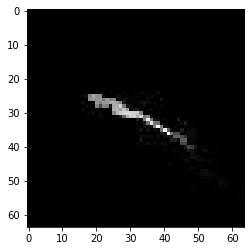

confidence for 54 is 0.9979585


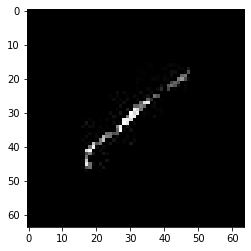

confidence for 58 is 0.91157186


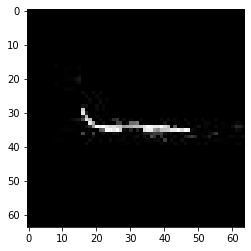

confidence for 71 is 0.89984775


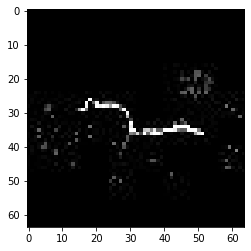

confidence for 99 is 0.98882633


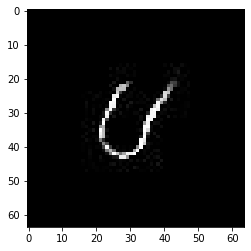

confidence for 107 is 0.9049207


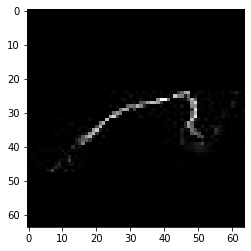

confidence for 114 is 0.997815


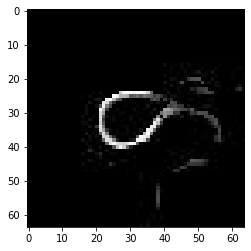

confidence for 140 is 0.99992496


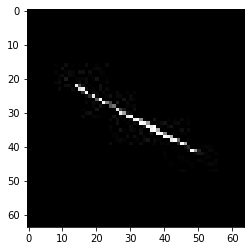

confidence for 143 is 0.8787016


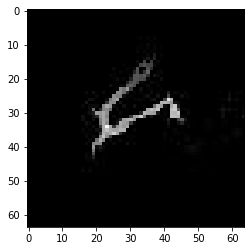

confidence for 175 is 0.9998787


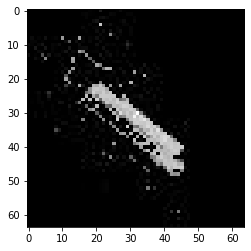

confidence for 209 is 0.92774856


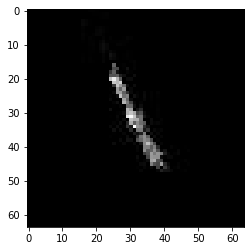

confidence for 219 is 0.9959952


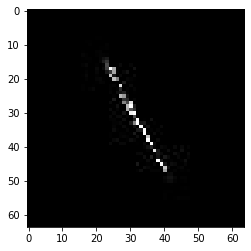

confidence for 278 is 0.7313951


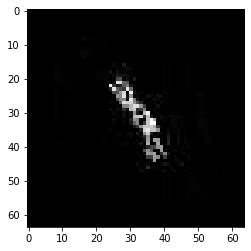

confidence for 296 is 0.9524952


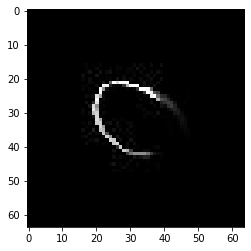

confidence for 334 is 0.9995452


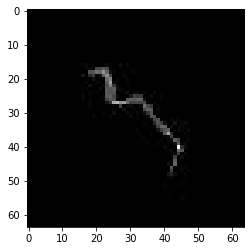

confidence for 336 is 0.86489964


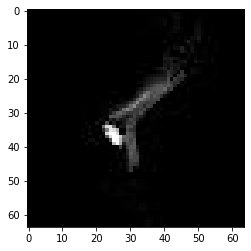

confidence for 343 is 0.9996666


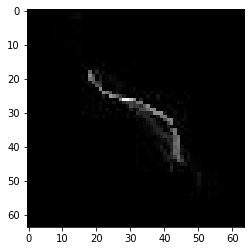

confidence for 357 is 0.9121868


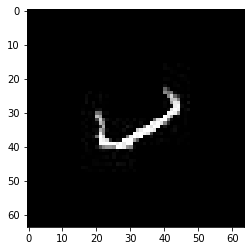

confidence for 368 is 0.98924387


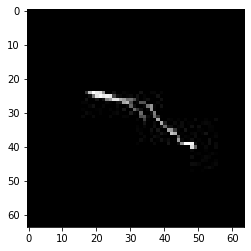

confidence for 379 is 0.9952396


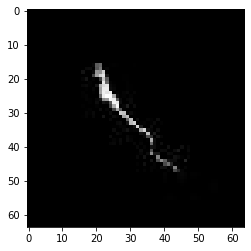

confidence for 467 is 0.74481225


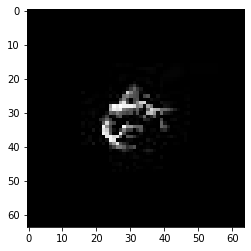

confidence for 484 is 0.9239099


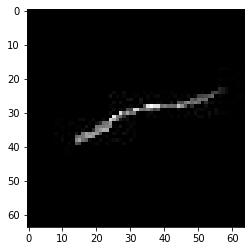

confidence for 509 is 0.8672983


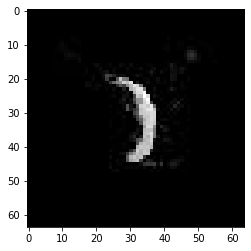

confidence for 583 is 0.82869166


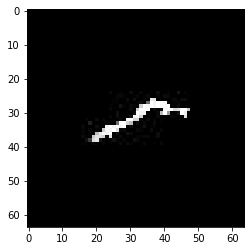

confidence for 594 is 0.98402935


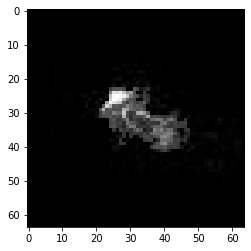

confidence for 618 is 0.95867914


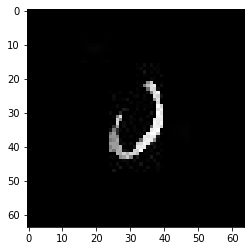

confidence for 621 is 0.9899394


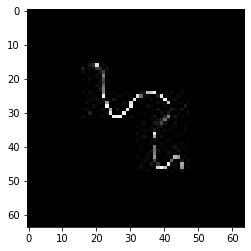

confidence for 639 is 0.9929255


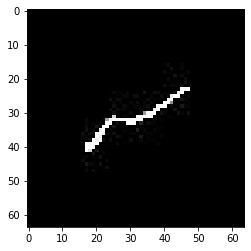

confidence for 644 is 0.98218447


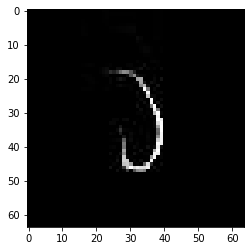

confidence for 648 is 0.99866533


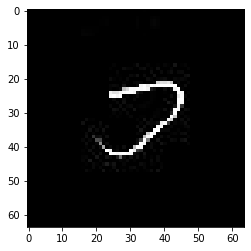

confidence for 662 is 0.9175239


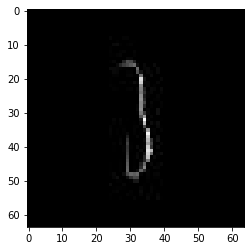

confidence for 676 is 0.8430983


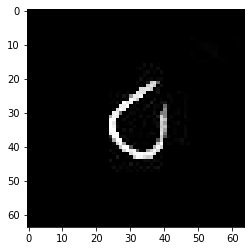

confidence for 688 is 0.9795551


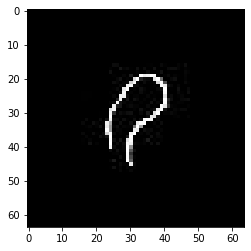

confidence for 702 is 0.90263313


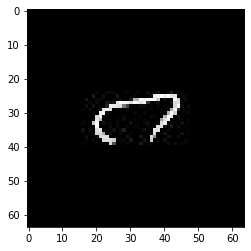

confidence for 707 is 0.9661811


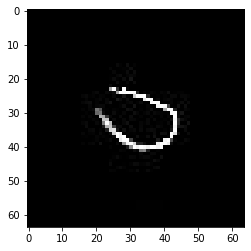

confidence for 741 is 0.9707138


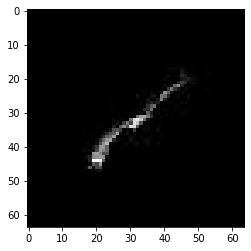

confidence for 746 is 0.97907084


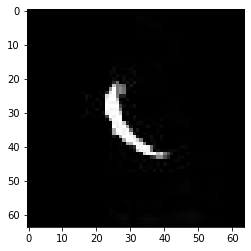

confidence for 770 is 0.9830504


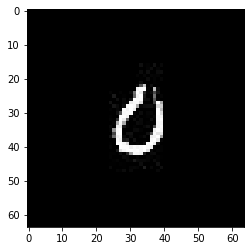

confidence for 780 is 0.95300466


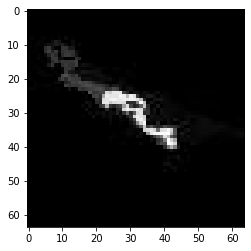

confidence for 797 is 0.9966171


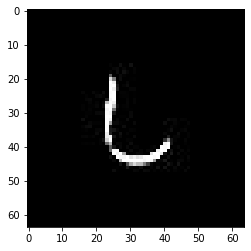

confidence for 798 is 0.96700656


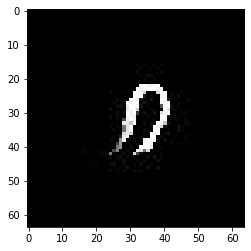

confidence for 816 is 0.97512776


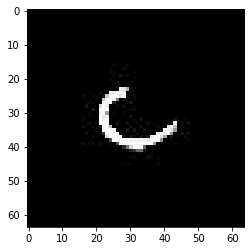

confidence for 818 is 0.95140094


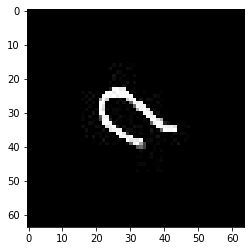

confidence for 827 is 0.8606387


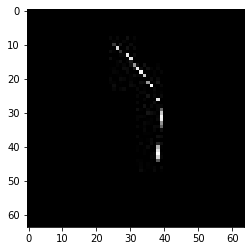

confidence for 838 is 0.8361729


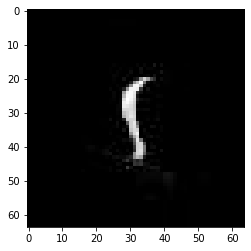

confidence for 841 is 0.9883393


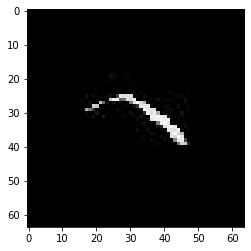

confidence for 850 is 0.70774394


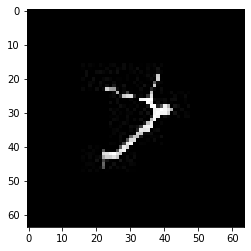

confidence for 860 is 0.88285446


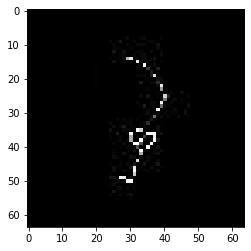

confidence for 873 is 0.97368926


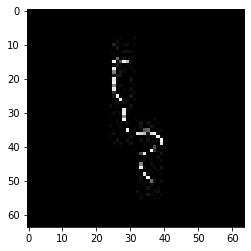

confidence for 876 is 0.99010825


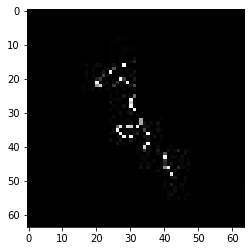

confidence for 879 is 0.9998704


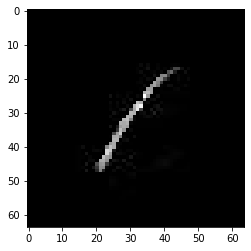

confidence for 884 is 0.9644444


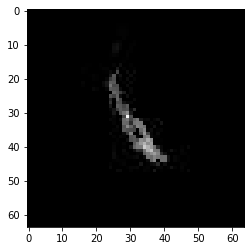

confidence for 892 is 0.9892071


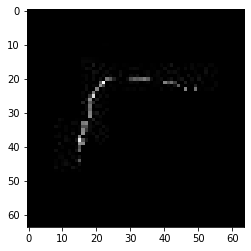

confidence for 894 is 0.99997437


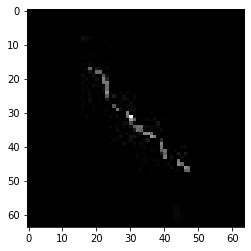

confidence for 904 is 0.87726176


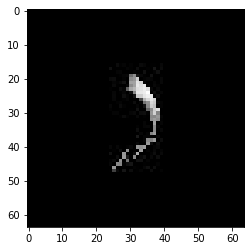

confidence for 910 is 0.9729404


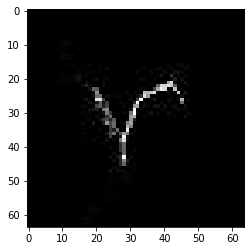

confidence for 918 is 0.944769


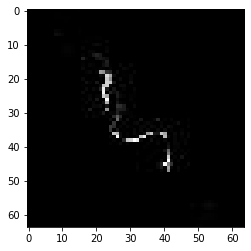

confidence for 919 is 0.88815314


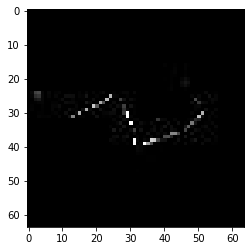

confidence for 944 is 0.9676128


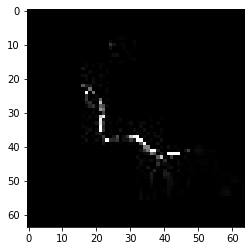

confidence for 946 is 0.9982939


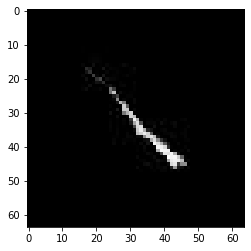

confidence for 947 is 0.96195257


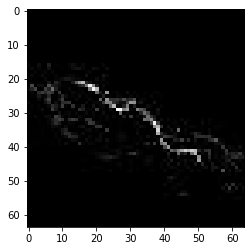

confidence for 969 is 0.7929496


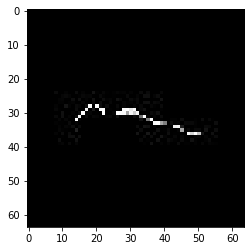

confidence for 972 is 0.99895525


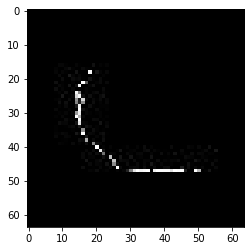

confidence for 976 is 0.9684879


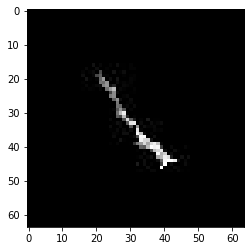

confidence for 982 is 0.78076017


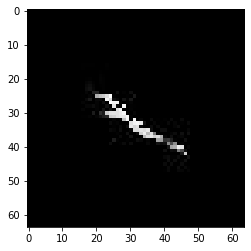

confidence for 994 is 0.99932134


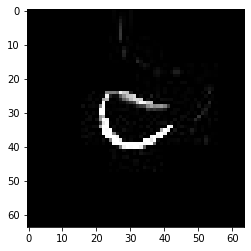

confidence for 995 is 1.0


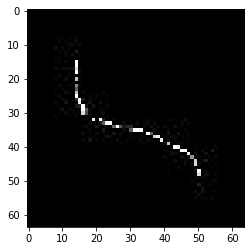

confidence for 1017 is 0.9460602


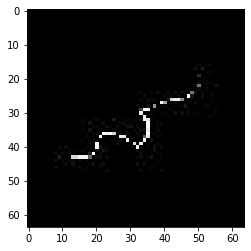

confidence for 1021 is 0.9718236


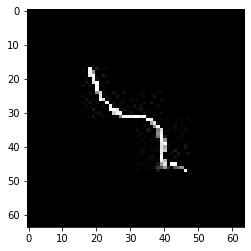

confidence for 1026 is 0.88236886


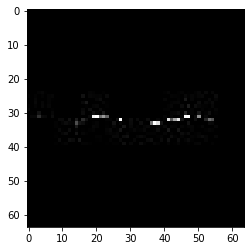

confidence for 1042 is 0.8030197


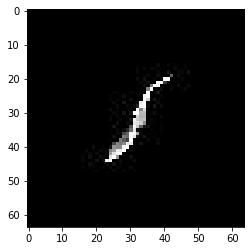

confidence for 1043 is 0.9972975


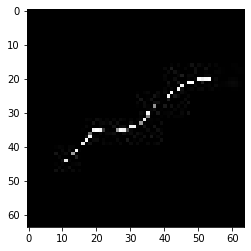

confidence for 1048 is 0.8881485


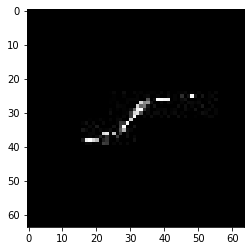

confidence for 1051 is 0.96835846


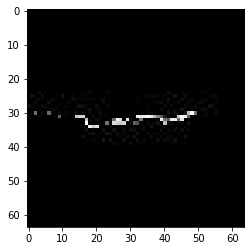

confidence for 1055 is 0.9625596


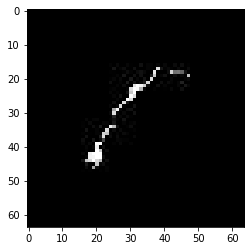

confidence for 1069 is 0.7140695


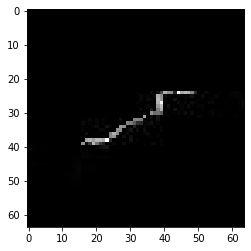

confidence for 1074 is 0.96182716


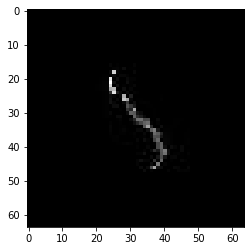

confidence for 1084 is 0.9875598


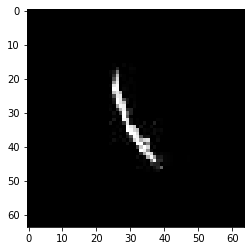

confidence for 1086 is 0.8838761


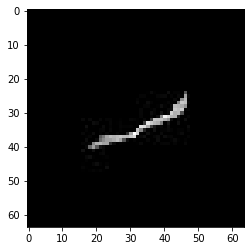

confidence for 1137 is 0.7659547


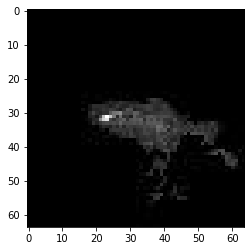

confidence for 1150 is 0.99999017


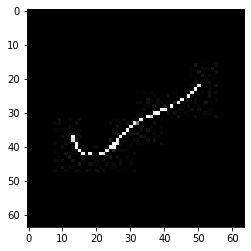

confidence for 1174 is 0.9787293


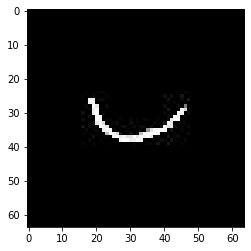

confidence for 1180 is 0.999865


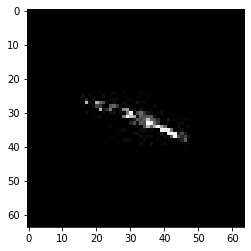

confidence for 1194 is 0.8856699


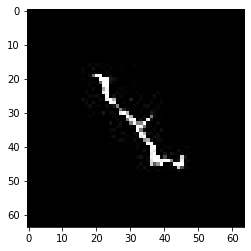

confidence for 1198 is 0.99913967


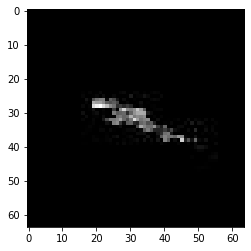

confidence for 1208 is 0.9991929


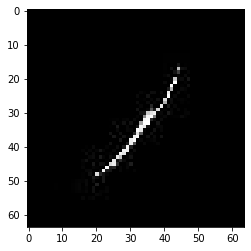

confidence for 1209 is 0.997457


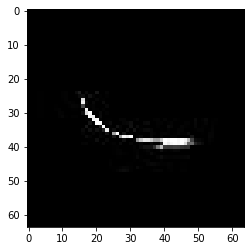

confidence for 1216 is 0.9813306


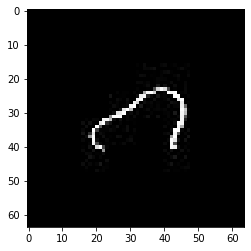

confidence for 1217 is 0.9996856


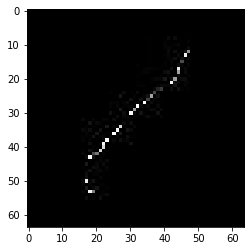

confidence for 1228 is 0.99853045


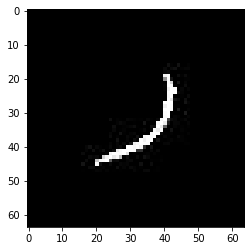

confidence for 1242 is 0.9708744


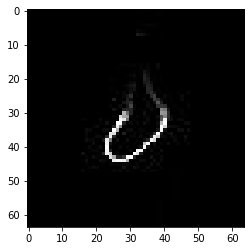

confidence for 1255 is 0.99032384


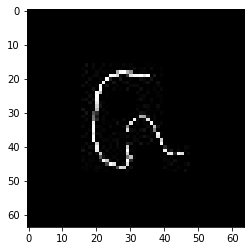

confidence for 1262 is 0.99985474


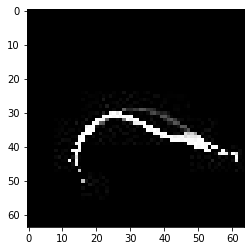

confidence for 1273 is 0.99340594


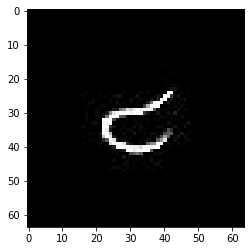

confidence for 1274 is 0.9898709


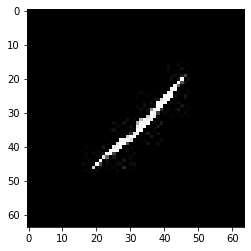

confidence for 1277 is 0.9750932


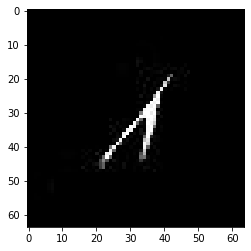

confidence for 1283 is 0.99527156


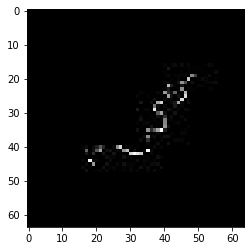

confidence for 1299 is 0.7114525


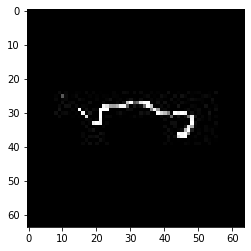

confidence for 1319 is 0.99977523


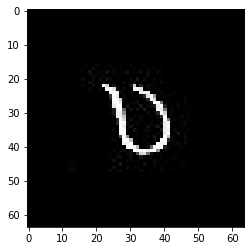

confidence for 1324 is 0.94632685


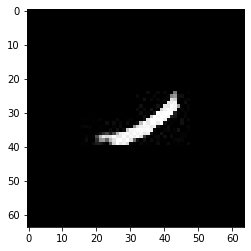

confidence for 1334 is 0.9937022


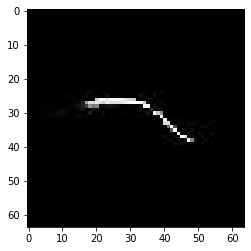

confidence for 1338 is 0.8332061


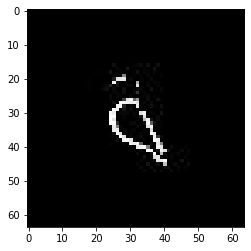

confidence for 1342 is 0.7288524


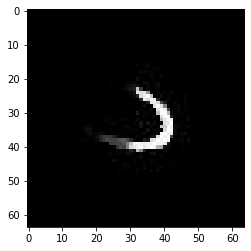

confidence for 1345 is 0.9156217


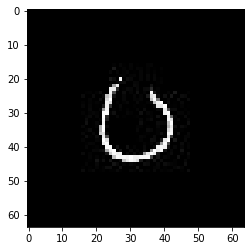

confidence for 1355 is 0.98501945


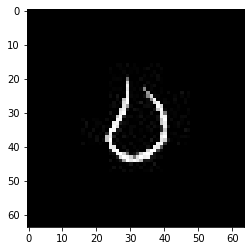

confidence for 1367 is 0.99999106


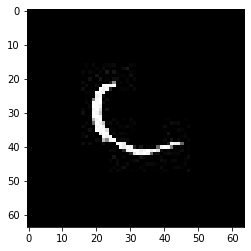

confidence for 1372 is 0.81028426


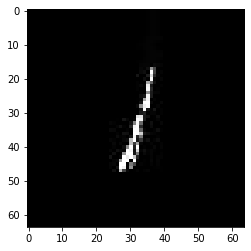

confidence for 1376 is 0.9983989


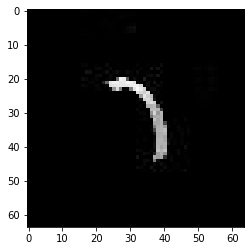

confidence for 1401 is 0.9999868


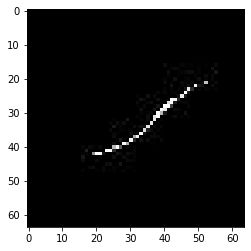

confidence for 1405 is 0.9920887


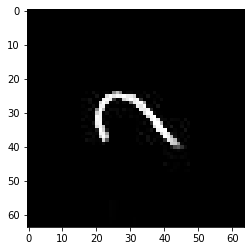

confidence for 1408 is 0.9961408


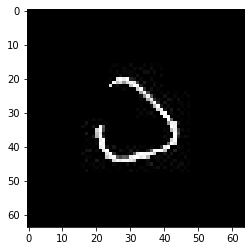

confidence for 1419 is 0.9438613


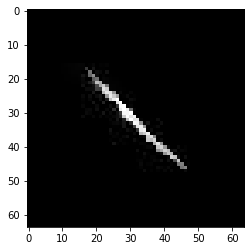

confidence for 1420 is 0.9685504


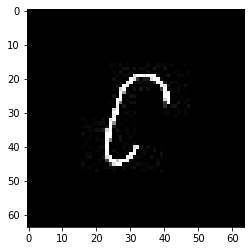

confidence for 1455 is 0.99759066


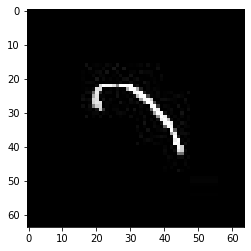

confidence for 1479 is 0.9987072


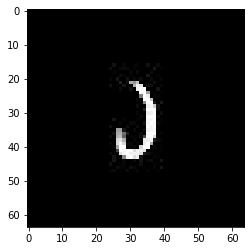

confidence for 1483 is 0.9740142


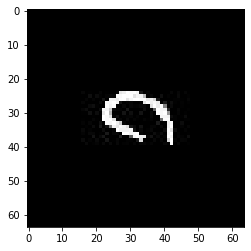

confidence for 1495 is 0.9645676


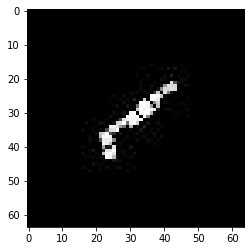

confidence for 1522 is 0.99373794


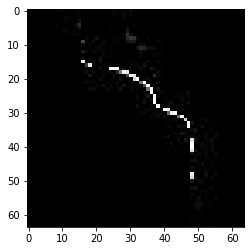

confidence for 1531 is 0.87161446


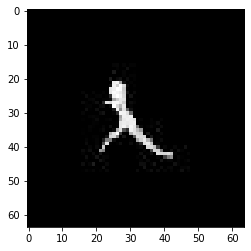

confidence for 1536 is 0.9778086


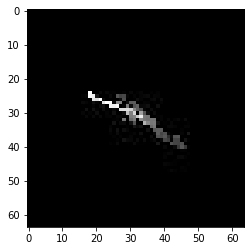

confidence for 1586 is 0.99970084


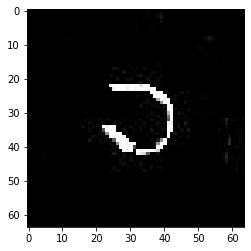

confidence for 1598 is 0.9994978


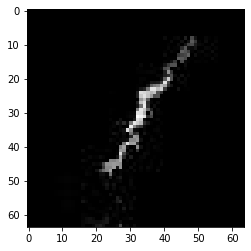

confidence for 1601 is 0.8971333


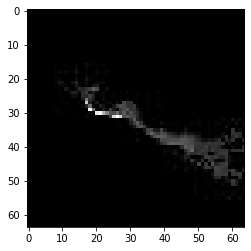

confidence for 1602 is 0.9713747


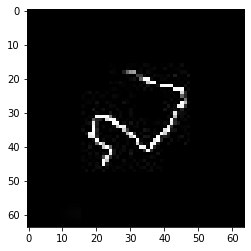

confidence for 1605 is 0.8596853


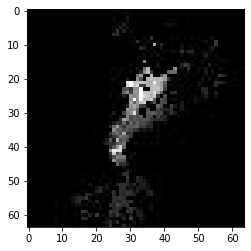

confidence for 1608 is 0.9771234


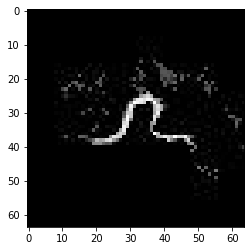

confidence for 1659 is 0.99244153


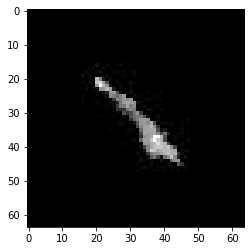

confidence for 1685 is 0.9583314


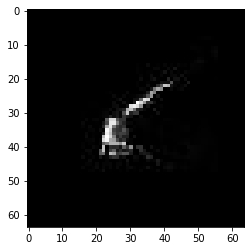

confidence for 1686 is 0.8681599


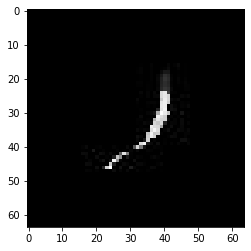

confidence for 1697 is 0.9965353


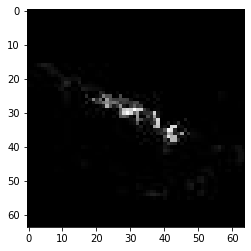

confidence for 1700 is 0.9998478


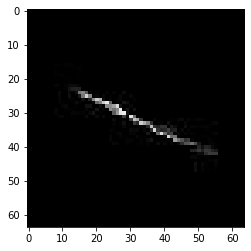

confidence for 1713 is 0.97251266


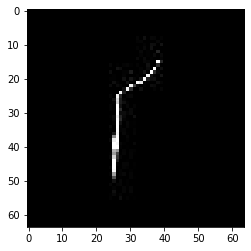

confidence for 1748 is 0.9060726


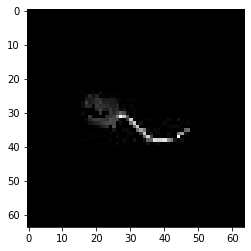

confidence for 1758 is 0.9864961


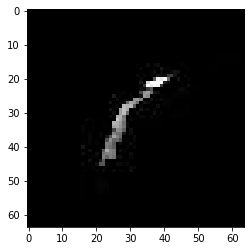

confidence for 1768 is 0.81562984


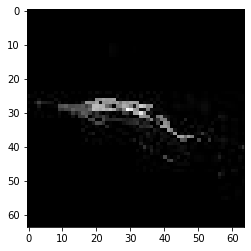

confidence for 1777 is 0.9819577


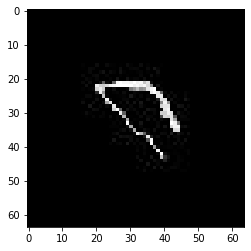

confidence for 1779 is 0.9760187


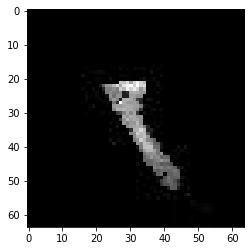

confidence for 1789 is 0.87286866


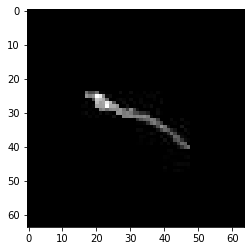

confidence for 1794 is 0.89805096


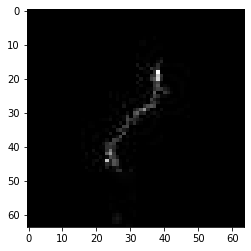

confidence for 1837 is 0.9997442


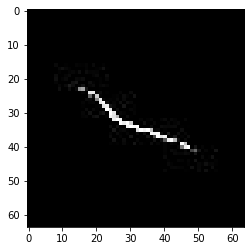

confidence for 1848 is 0.9043808


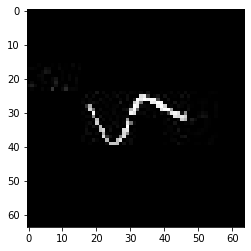

confidence for 1850 is 0.99903214


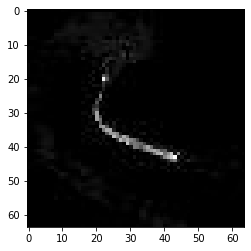

confidence for 1901 is 0.8345368


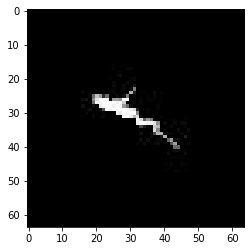

confidence for 1944 is 0.8665281


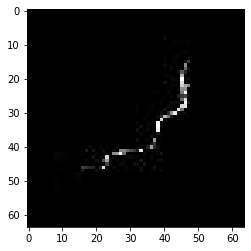

confidence for 1957 is 0.9518938


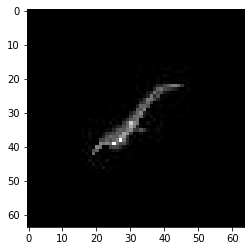

confidence for 1965 is 0.9652441


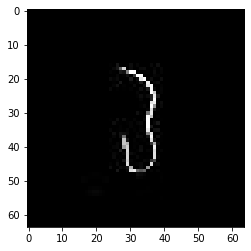

confidence for 1971 is 0.9995522


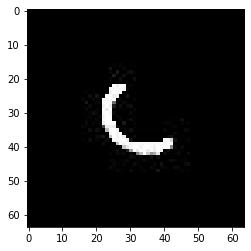

confidence for 1972 is 0.9260062


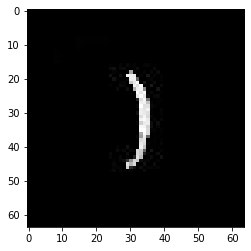

confidence for 1979 is 0.99437433


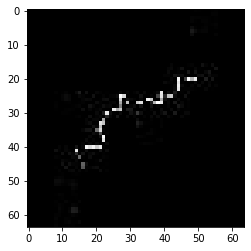

confidence for 1983 is 0.79962087


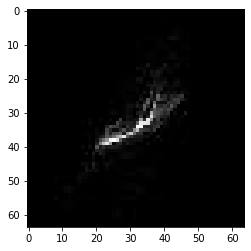

confidence for 1999 is 0.86729956


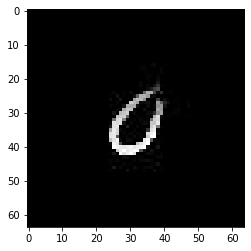

confidence for 2003 is 0.9022578


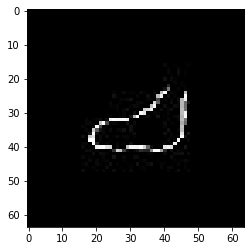

confidence for 2035 is 0.9432046


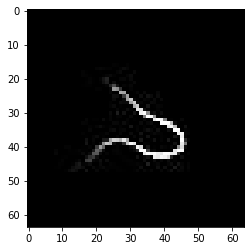

confidence for 2037 is 0.8474344


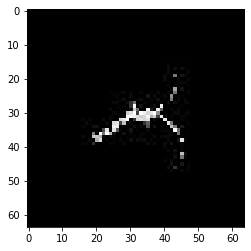

confidence for 2043 is 0.98677135


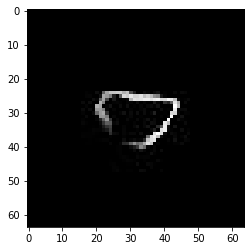

confidence for 2054 is 0.9893267


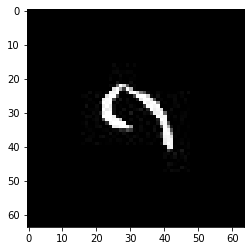

confidence for 2061 is 0.78486913


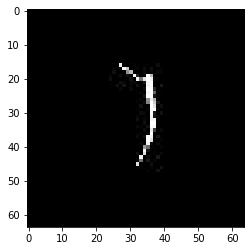

confidence for 2109 is 0.978518


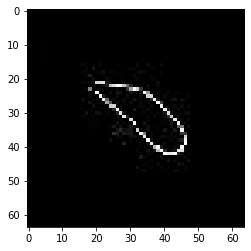

confidence for 2111 is 0.99365467


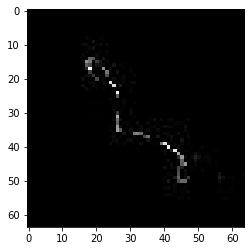

confidence for 2131 is 0.99673736


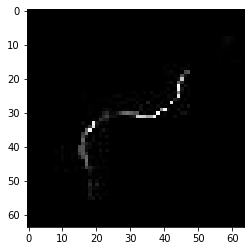

confidence for 2163 is 0.97116065


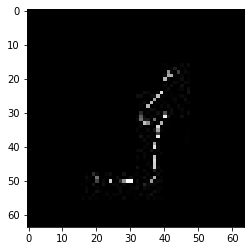

confidence for 2190 is 0.876449


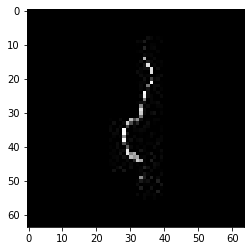

confidence for 2191 is 0.9996241


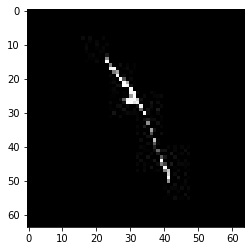

confidence for 2208 is 0.9948946


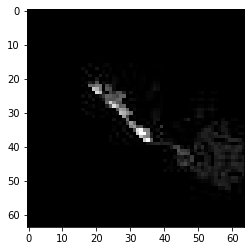

confidence for 2211 is 0.9742004


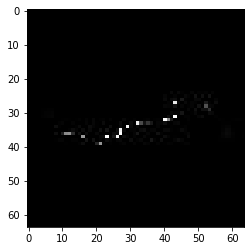

confidence for 2240 is 0.70148206


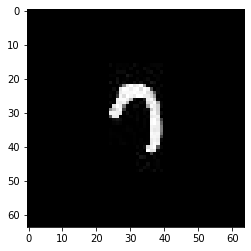

confidence for 2242 is 0.9410002


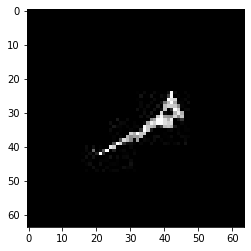

confidence for 2248 is 0.8021925


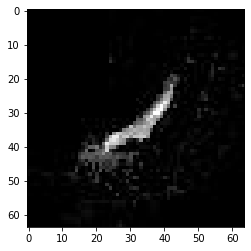

confidence for 2278 is 0.9896895


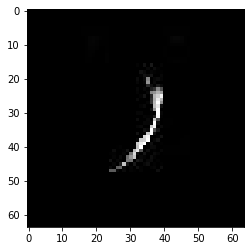

confidence for 2283 is 0.9991668


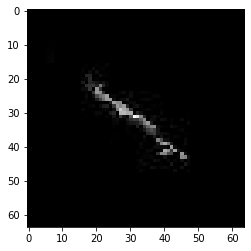

confidence for 2288 is 0.84703016


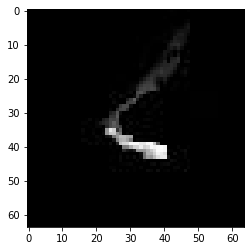

confidence for 2295 is 0.84674937


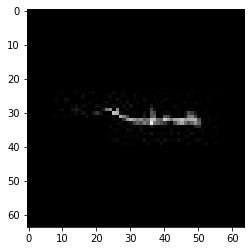

confidence for 2301 is 0.97889715


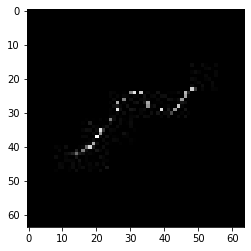

confidence for 2302 is 0.99137306


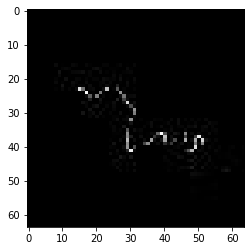

confidence for 2329 is 0.9122713


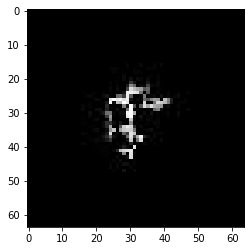

confidence for 2344 is 0.9096843


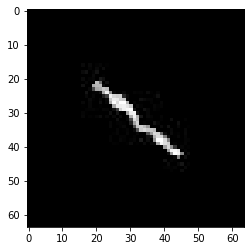

confidence for 2406 is 0.7836863


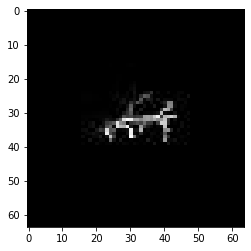

confidence for 2409 is 0.9855495


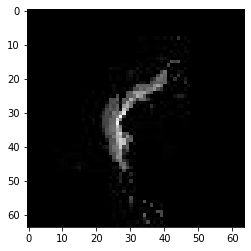

confidence for 2438 is 0.84350914


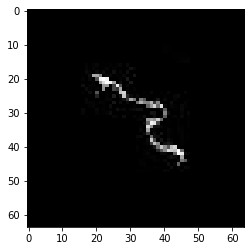

confidence for 2452 is 0.99821466


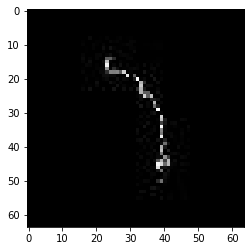

confidence for 2486 is 0.9995264


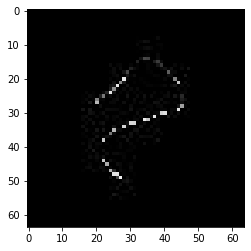

confidence for 2528 is 0.7456071


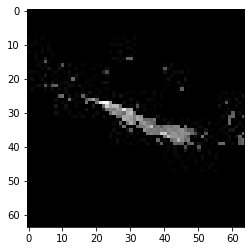

confidence for 2544 is 0.99287194


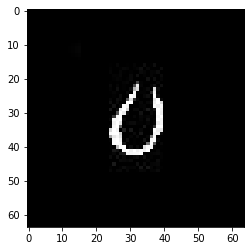

confidence for 2558 is 0.76845986


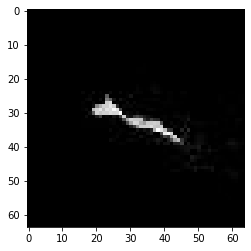

confidence for 2559 is 0.99515766


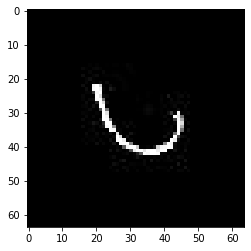

confidence for 2587 is 0.7268815


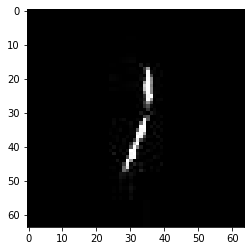

confidence for 2612 is 0.83597434


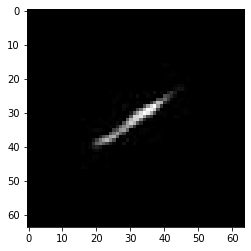

confidence for 2616 is 0.9806902


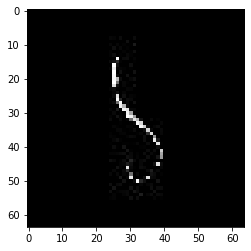

confidence for 2644 is 0.99938595


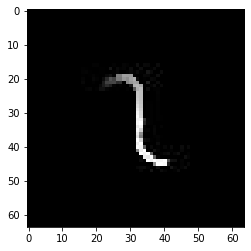

confidence for 2672 is 0.9971934


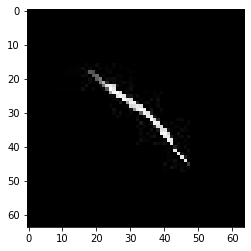

confidence for 2680 is 0.9991193


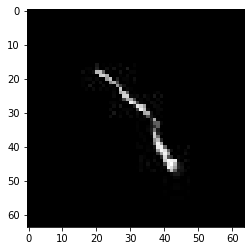

confidence for 2706 is 0.9730503


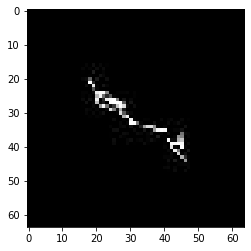

confidence for 2712 is 0.9710292


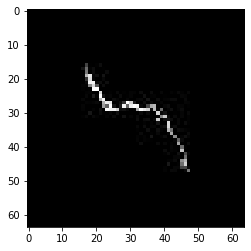

confidence for 2744 is 0.9518263


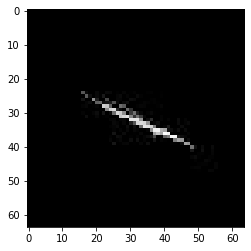

confidence for 2753 is 0.9963231


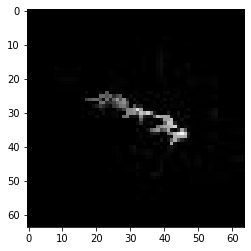

confidence for 2754 is 0.72927666


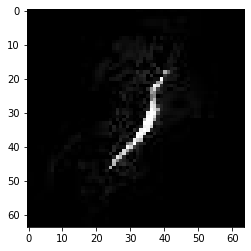

confidence for 2779 is 0.94043404


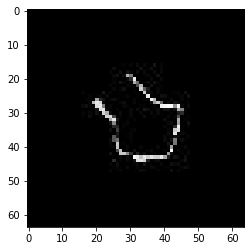

confidence for 2799 is 0.99934363


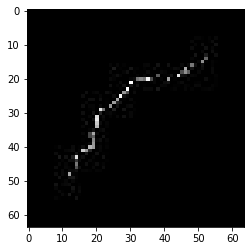

confidence for 2823 is 0.98387647


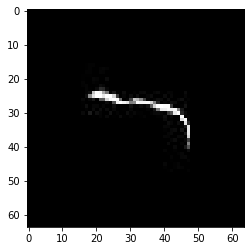

confidence for 2824 is 0.99665594


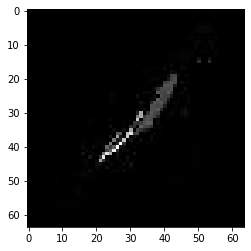

confidence for 2834 is 0.9877104


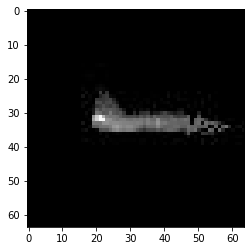

confidence for 2842 is 0.71994925


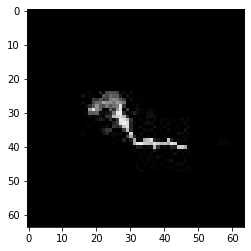

confidence for 2862 is 0.99934995


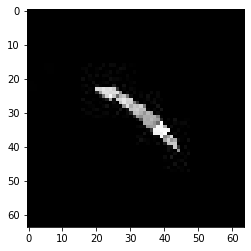

confidence for 2906 is 0.7283193


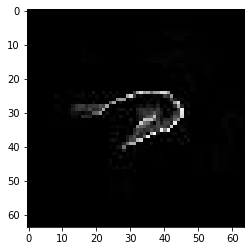

confidence for 2928 is 0.884146


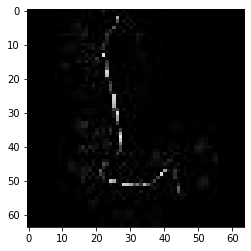

confidence for 2965 is 0.7957058


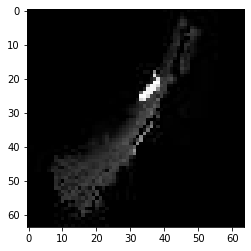

confidence for 3063 is 0.99634546


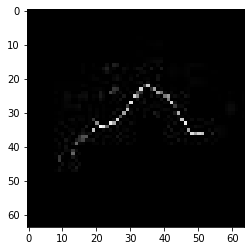

confidence for 3066 is 0.93003094


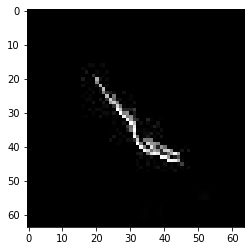

confidence for 3074 is 0.980206


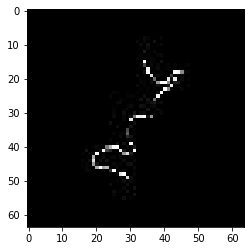

confidence for 3075 is 0.93220156


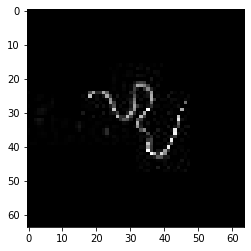

confidence for 3090 is 0.9992537


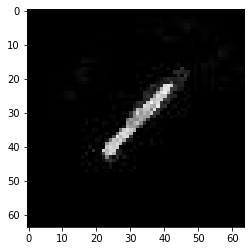

confidence for 3095 is 0.9995559


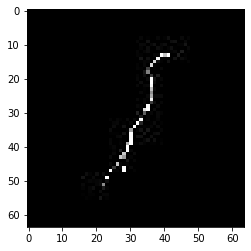

confidence for 3126 is 0.9732397


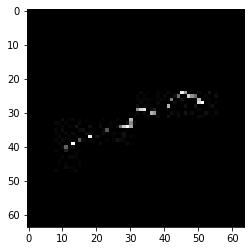

confidence for 3136 is 0.98536074


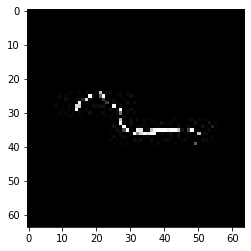

confidence for 3162 is 0.71323174


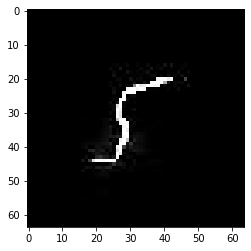

confidence for 3168 is 0.9031477


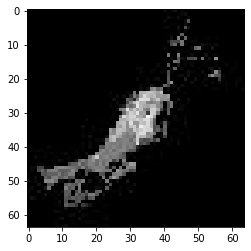

confidence for 3188 is 0.73461574


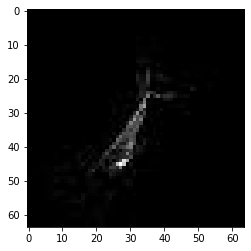

confidence for 3211 is 0.98976034


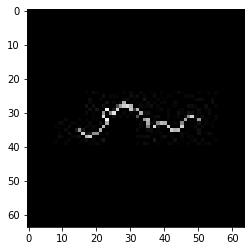

confidence for 3259 is 0.9388944


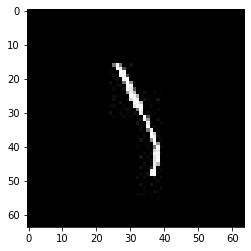

confidence for 3268 is 0.9455969


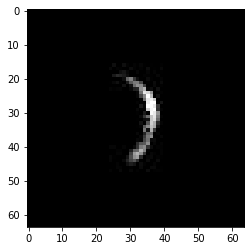

confidence for 3271 is 0.9750516


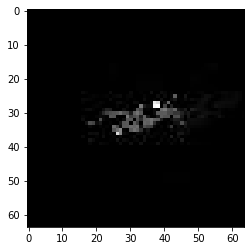

confidence for 3275 is 0.94431967


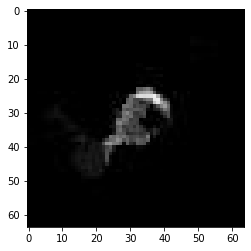

confidence for 3299 is 0.9298746


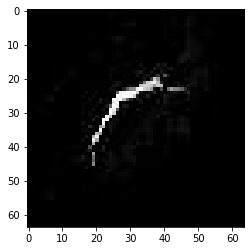

confidence for 3306 is 0.9917505


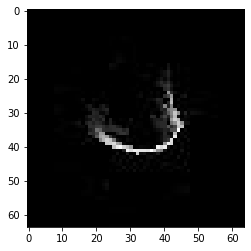

confidence for 3344 is 0.9967611


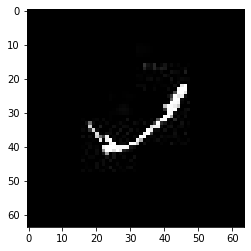

confidence for 3348 is 0.72444946


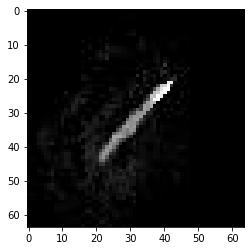

confidence for 3353 is 0.9858741


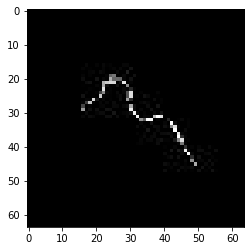

confidence for 3362 is 0.74132746


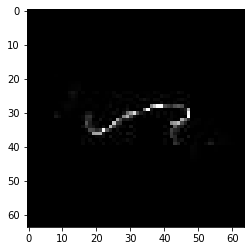

confidence for 3369 is 0.9564086


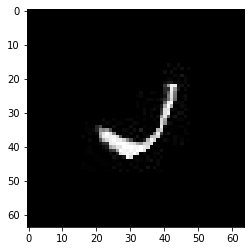

confidence for 3373 is 0.9003887


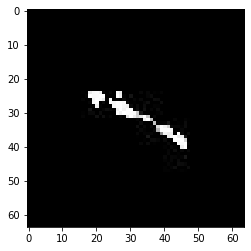

confidence for 3381 is 0.9757301


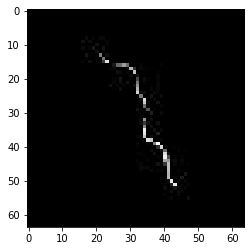

confidence for 3394 is 0.7594917


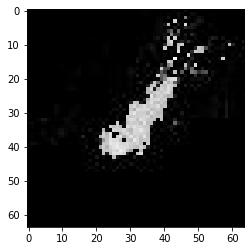

confidence for 3414 is 0.9399795


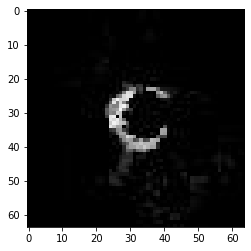

confidence for 3415 is 0.97899914


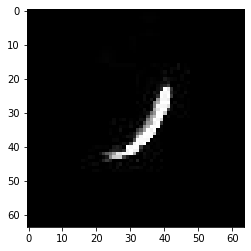

confidence for 3444 is 0.9647908


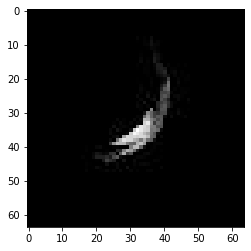

confidence for 3449 is 0.8012913


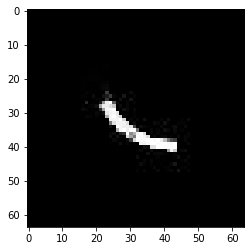

confidence for 3470 is 0.9701465


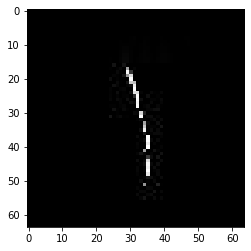

confidence for 3540 is 0.9891228


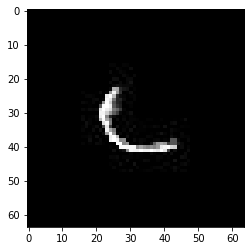

confidence for 3577 is 0.9737117


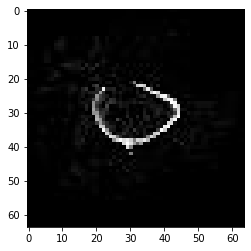

confidence for 3580 is 0.99148685


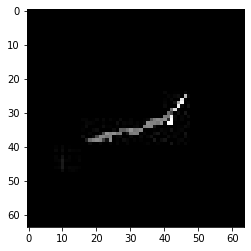

confidence for 3636 is 0.981035


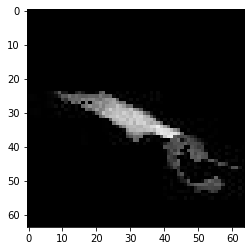

confidence for 3637 is 0.92341536


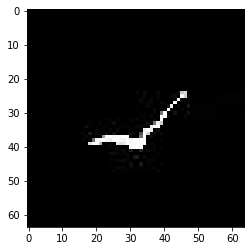

confidence for 3638 is 0.99857485


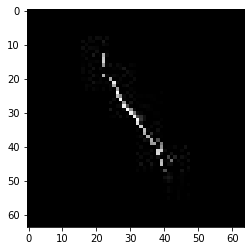

confidence for 3639 is 0.9725848


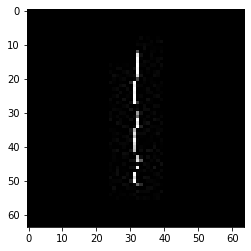

confidence for 3641 is 0.96109086


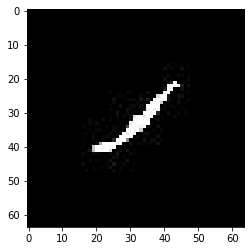

confidence for 3648 is 0.8853989


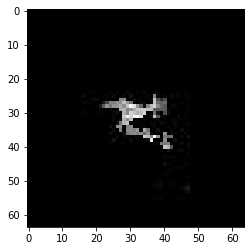

confidence for 3655 is 0.81348264


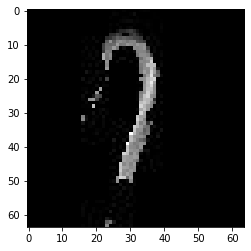

confidence for 3656 is 0.9883158


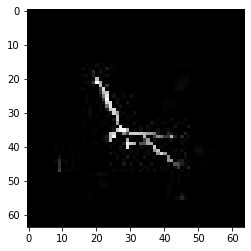

confidence for 3659 is 0.71269363


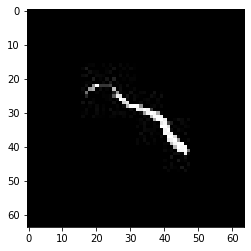

confidence for 3709 is 0.969039


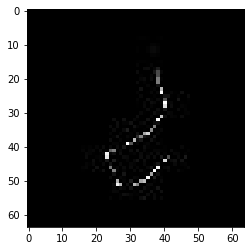

confidence for 3722 is 0.86237293


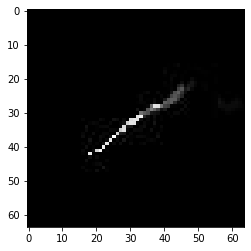

confidence for 3724 is 0.97540396


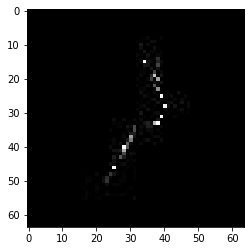

confidence for 3731 is 0.99291885


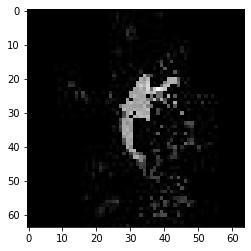

confidence for 3732 is 0.79130584


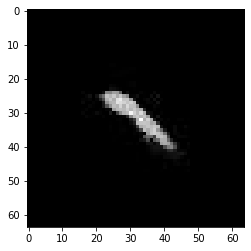

confidence for 3748 is 0.84284055


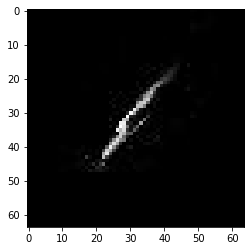

confidence for 3794 is 0.93368


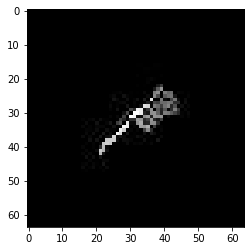

confidence for 3795 is 0.7651883


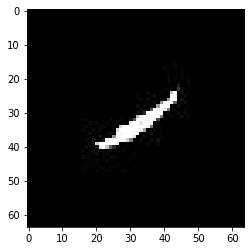

confidence for 3803 is 0.89586085


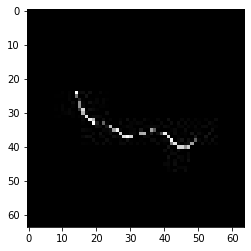

confidence for 3806 is 0.9994257


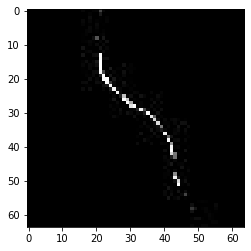

confidence for 3813 is 0.7741435


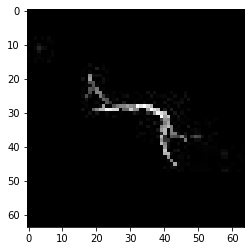

confidence for 3826 is 0.9976282


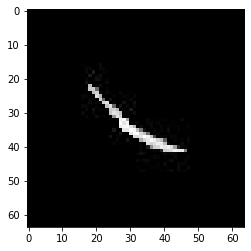

confidence for 3844 is 0.96557844


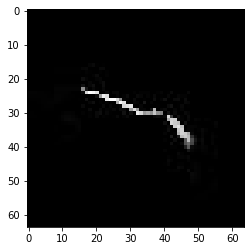

confidence for 3850 is 0.9200888


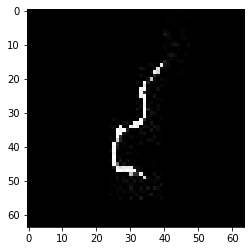

confidence for 3876 is 0.99615705


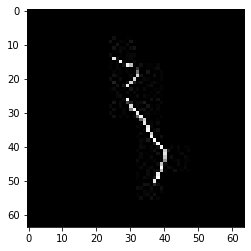

confidence for 3890 is 0.87139344


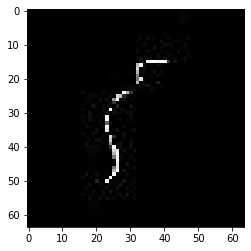

confidence for 3892 is 0.9959647


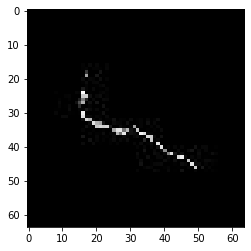

confidence for 3900 is 0.96121913


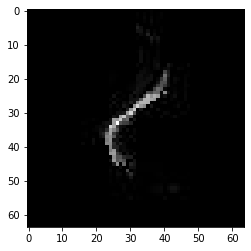

confidence for 3916 is 0.99410087


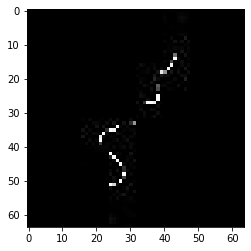

confidence for 3918 is 0.99996793


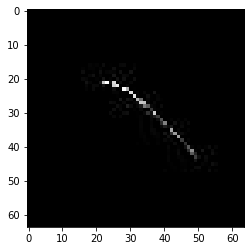

confidence for 3926 is 0.9997933


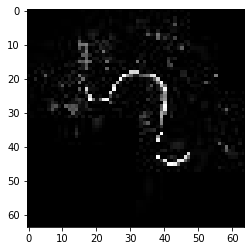

confidence for 3953 is 0.99483854


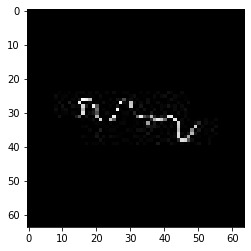

confidence for 3961 is 0.9999867


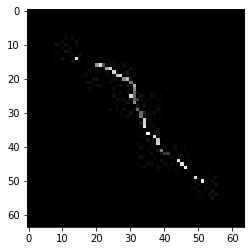

confidence for 3973 is 0.9998732


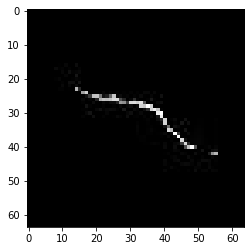

confidence for 4005 is 0.9952809


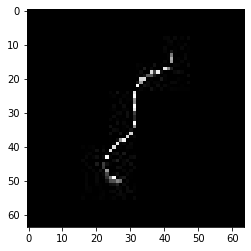

confidence for 4007 is 0.9663457


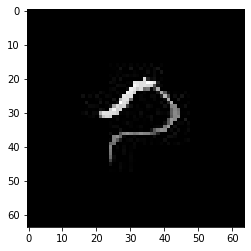

confidence for 4011 is 0.99876714


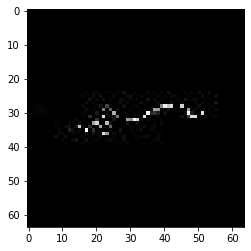

confidence for 4012 is 0.91553956


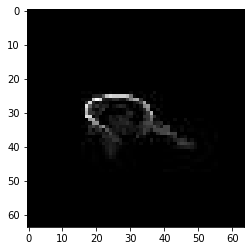

confidence for 4018 is 0.9099287


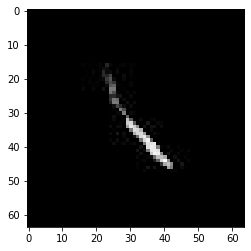

confidence for 4027 is 0.980172


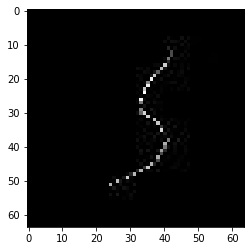

confidence for 4028 is 0.9937134


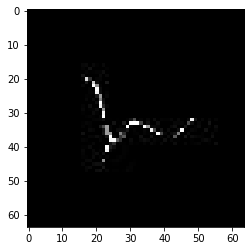

confidence for 4050 is 0.9826198


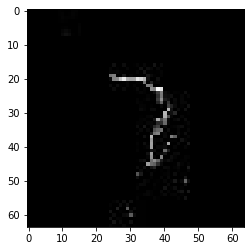

confidence for 4055 is 0.72896224


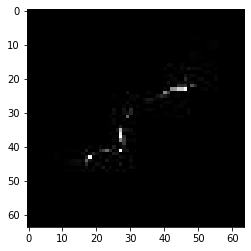

confidence for 4056 is 0.9763314


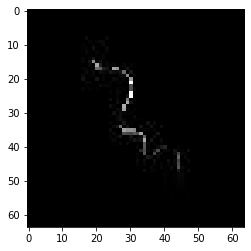

confidence for 4058 is 0.98126966


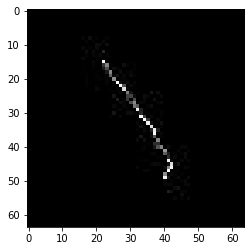

confidence for 4074 is 0.9993469


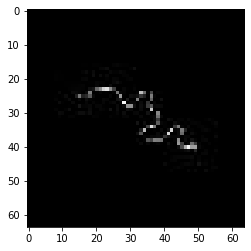

confidence for 4084 is 0.9994258


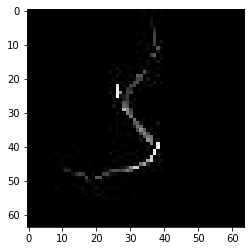

confidence for 4089 is 0.8182004


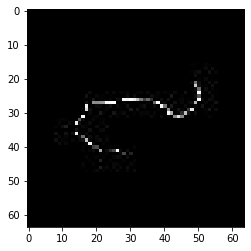

confidence for 4090 is 0.9494826


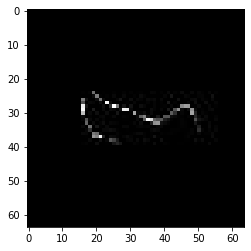

confidence for 4101 is 0.7371291


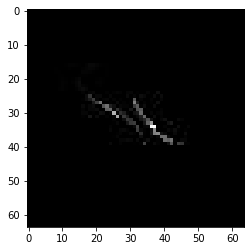

confidence for 4151 is 0.999995


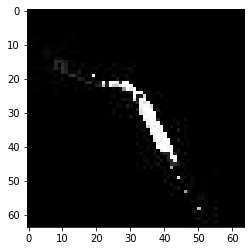

confidence for 4161 is 0.98345345


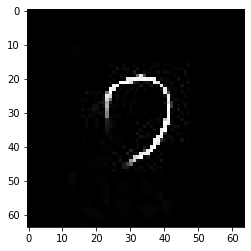

confidence for 4175 is 0.90904915


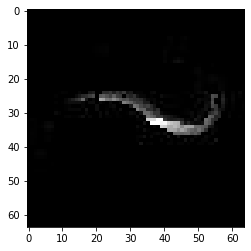

confidence for 4190 is 0.98422134


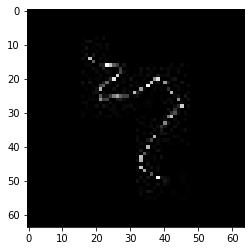

confidence for 4203 is 0.91048557


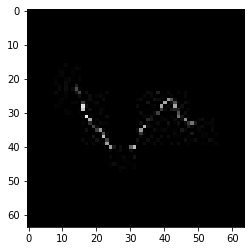

confidence for 4226 is 0.89374846


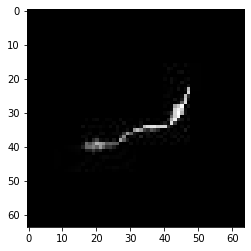

confidence for 4232 is 0.9186091


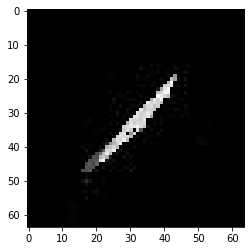

confidence for 4240 is 0.99987644


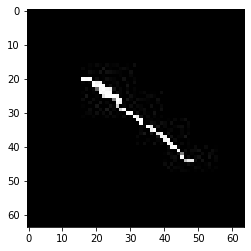

confidence for 4249 is 0.99662507


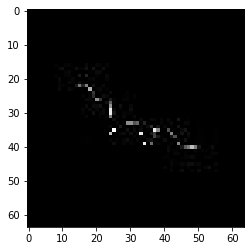

confidence for 4295 is 0.7251659


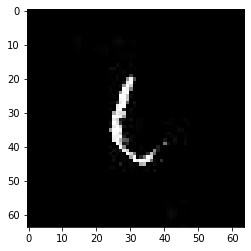

confidence for 4296 is 0.8580743


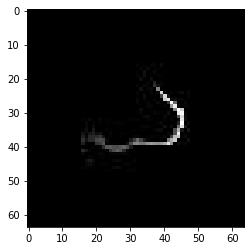

confidence for 4302 is 0.9999922


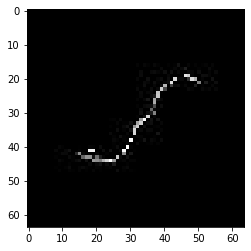

confidence for 4314 is 0.9971027


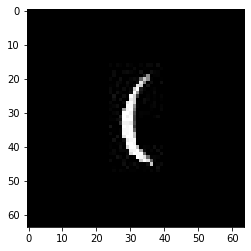

confidence for 4352 is 0.9771483


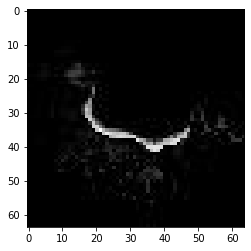

confidence for 4362 is 0.8454108


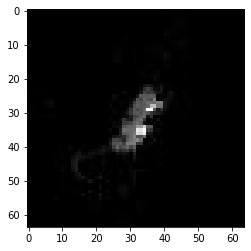

confidence for 4370 is 0.983991


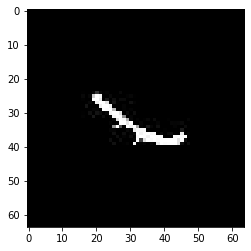

confidence for 4374 is 0.9992997


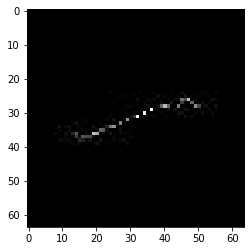

confidence for 4381 is 0.9766954


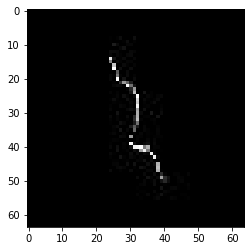

confidence for 4382 is 0.9993196


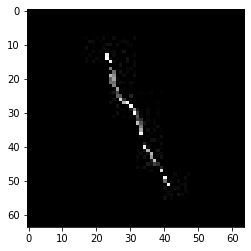

confidence for 4383 is 0.93723273


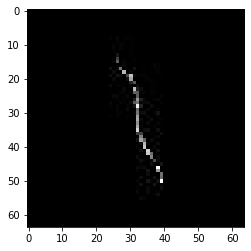

confidence for 4397 is 0.8970524


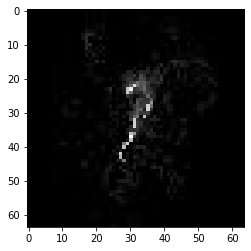

confidence for 4413 is 0.87403136


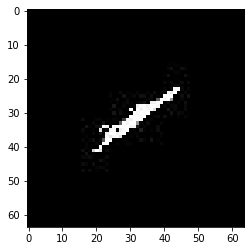

confidence for 4425 is 0.99938923


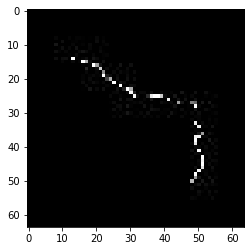

confidence for 4436 is 0.7482411


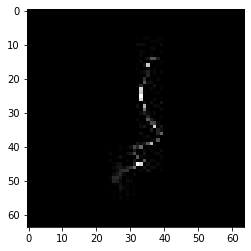

confidence for 4438 is 0.8590971


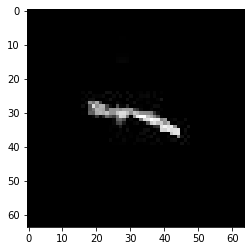

confidence for 4487 is 0.8481223


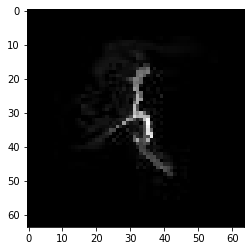

confidence for 4493 is 0.9688309


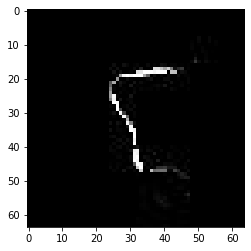

confidence for 4508 is 0.96597755


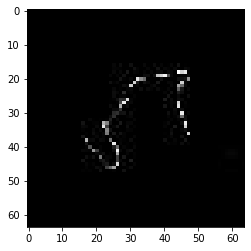

confidence for 4518 is 0.9308927


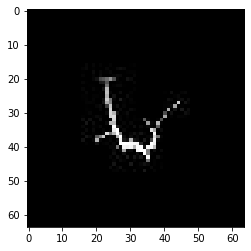

confidence for 4520 is 0.8344052


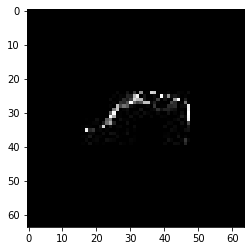

confidence for 4531 is 0.89234316


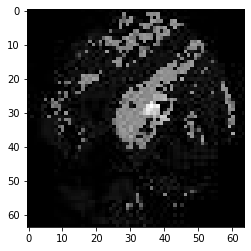

confidence for 4538 is 0.94954586


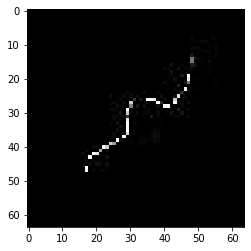

confidence for 4544 is 0.99585223


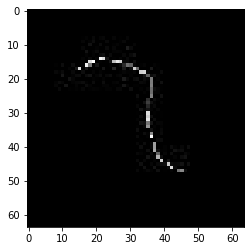

confidence for 4556 is 0.99942297


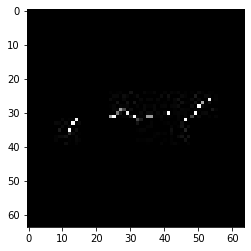

confidence for 4557 is 0.9953257


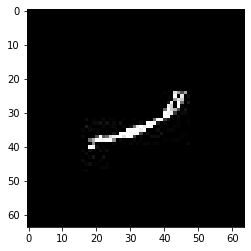

confidence for 4563 is 0.99841446


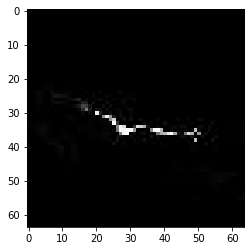

confidence for 4572 is 0.9469688


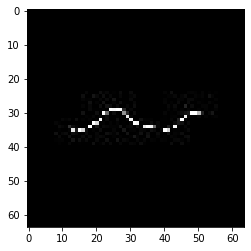

confidence for 4584 is 0.99999076


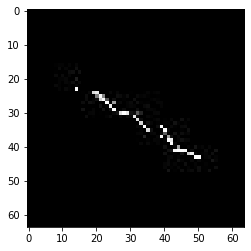

confidence for 4599 is 0.99933404


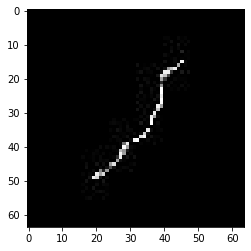

confidence for 4607 is 0.9951185


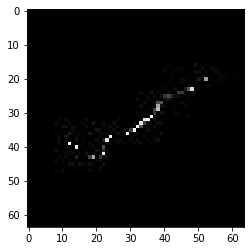

confidence for 4618 is 0.80688924


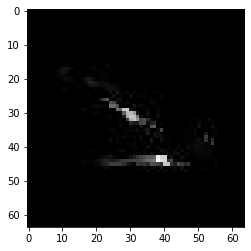

confidence for 4624 is 0.9831459


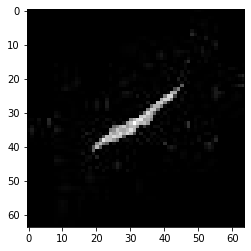

confidence for 4625 is 0.93620867


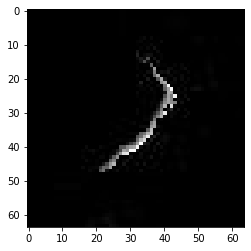

confidence for 4634 is 0.9996239


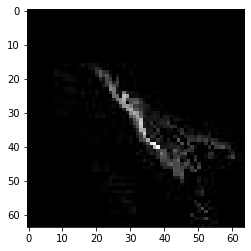

confidence for 4643 is 0.9986404


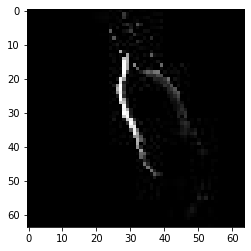

confidence for 4646 is 0.7336689


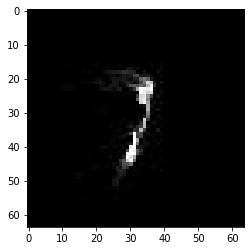

confidence for 4658 is 0.9820452


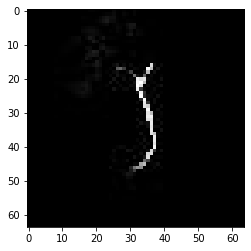

confidence for 4668 is 0.9969241


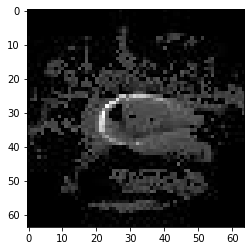

confidence for 4674 is 0.77392995


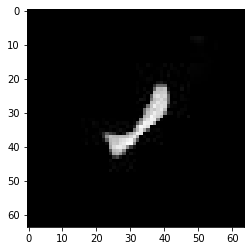

confidence for 4677 is 0.9085708


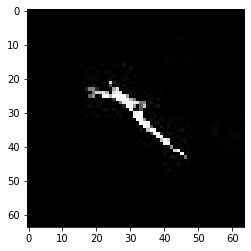

confidence for 4691 is 0.99072564


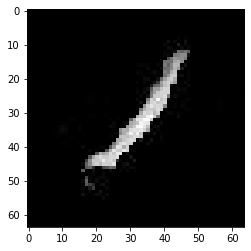

confidence for 4746 is 0.99891436


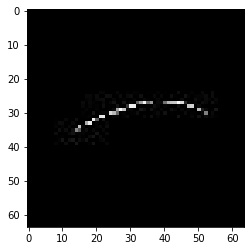

confidence for 4757 is 0.99794376


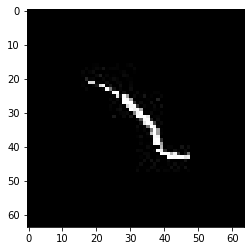

confidence for 4763 is 0.9959986


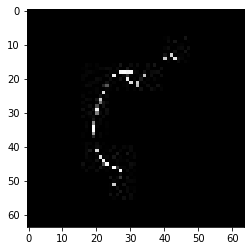

confidence for 4780 is 0.92842984


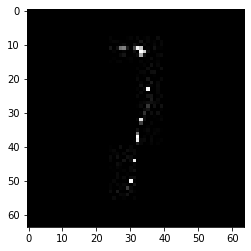

confidence for 4782 is 0.9682875


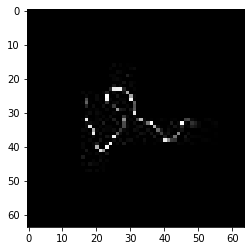

confidence for 4784 is 0.9625182


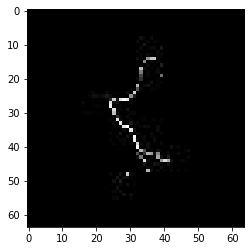

confidence for 4791 is 0.98265445


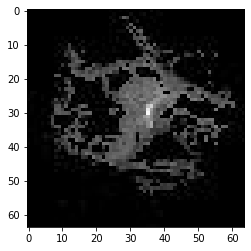

confidence for 4823 is 0.96172196


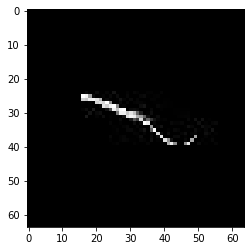

confidence for 4826 is 0.968956


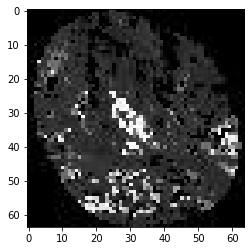

confidence for 4832 is 0.89769375


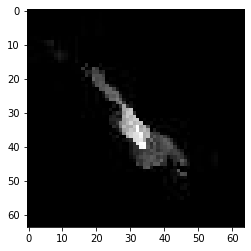

confidence for 4839 is 0.99564135


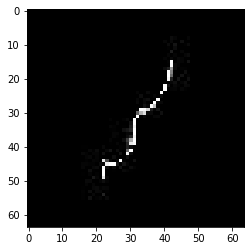

confidence for 4856 is 0.735209


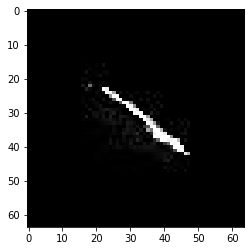

confidence for 4860 is 0.93720055


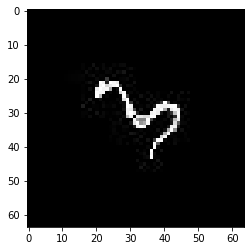

confidence for 4865 is 0.92855185


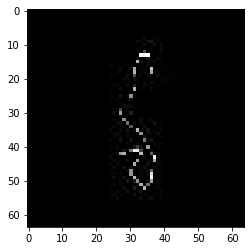

confidence for 4906 is 0.9889488


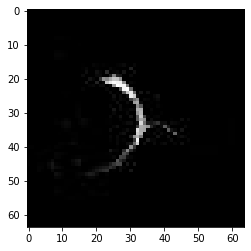

confidence for 4923 is 0.83981603


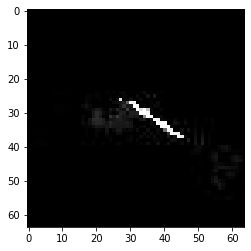

confidence for 4933 is 0.99898404


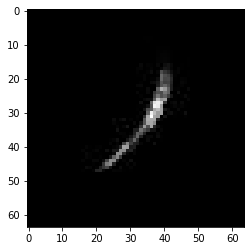

confidence for 5018 is 0.99332476


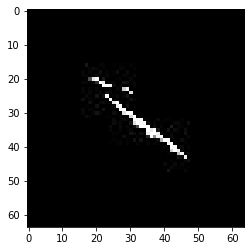

confidence for 5026 is 0.99920255


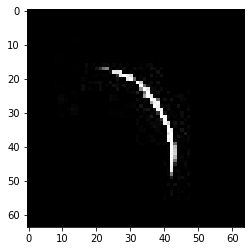

confidence for 5082 is 0.9738795


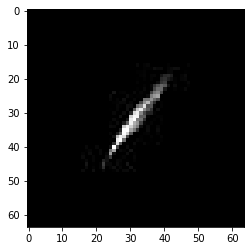

confidence for 5106 is 0.9374757


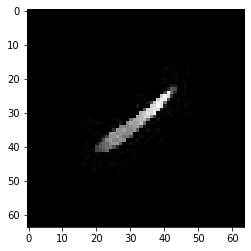

confidence for 5121 is 0.9956704


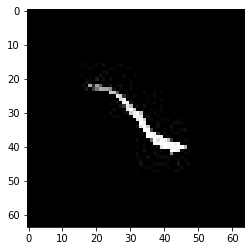

confidence for 5124 is 0.9844603


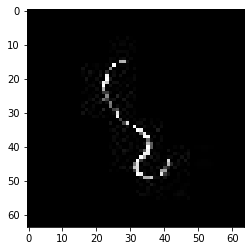

confidence for 5127 is 0.9990942


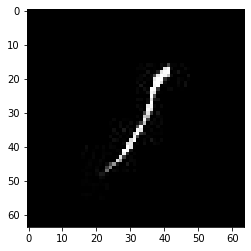

confidence for 5131 is 0.8115215


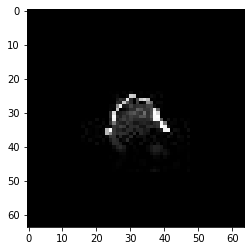

confidence for 5262 is 0.9987602


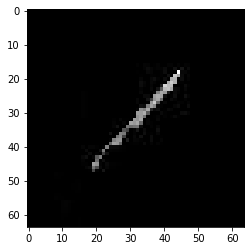

confidence for 5269 is 0.70969284


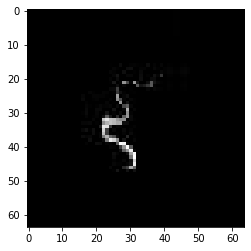

confidence for 5346 is 0.99745876


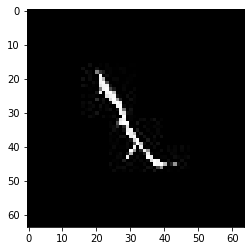

confidence for 5362 is 0.7437366


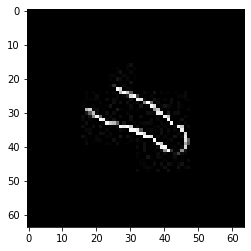

confidence for 5365 is 0.9878785


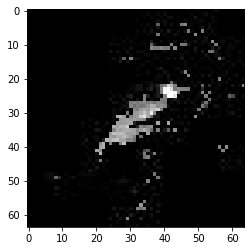

confidence for 5383 is 0.9228852


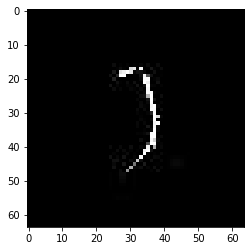

confidence for 5446 is 0.9159723


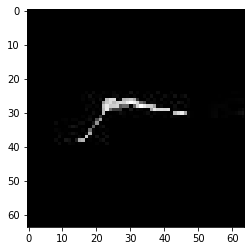

confidence for 5455 is 0.86769474


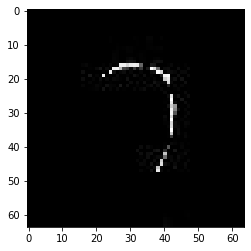

confidence for 5456 is 0.99490625


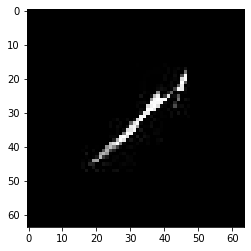

confidence for 5460 is 0.9504069


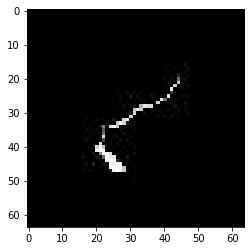

confidence for 5462 is 0.89172935


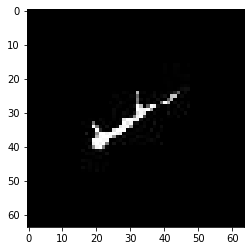

confidence for 5499 is 0.7347683


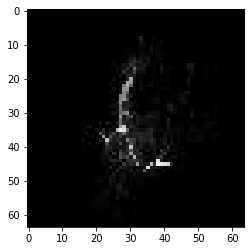

confidence for 5507 is 0.8089139


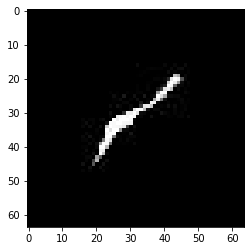

confidence for 5509 is 0.75620186


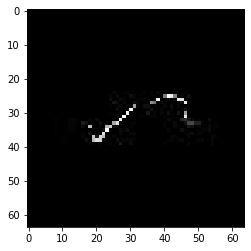

confidence for 5515 is 0.93106174


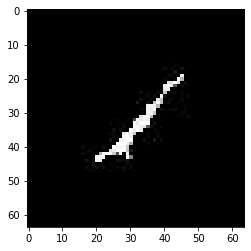

confidence for 5517 is 0.9809537


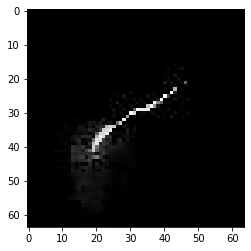

confidence for 5522 is 0.77746004


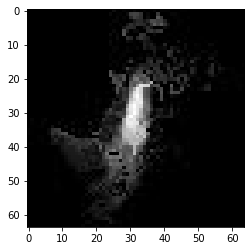

confidence for 5542 is 0.8655659


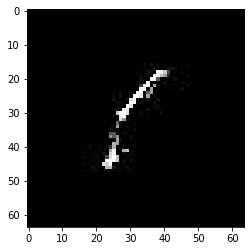

confidence for 5591 is 0.9917308


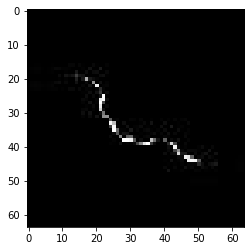

confidence for 5631 is 0.8833429


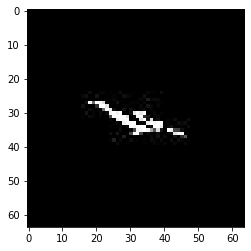

confidence for 5654 is 0.9995804


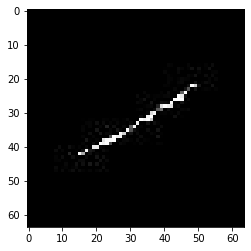

confidence for 5659 is 0.8768934


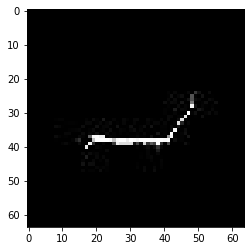

confidence for 5670 is 0.7580512


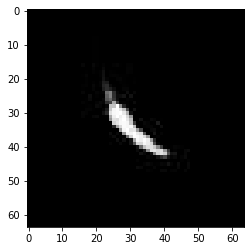

confidence for 5679 is 0.99720216


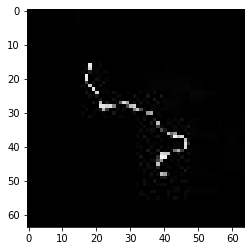

confidence for 5689 is 0.9313118


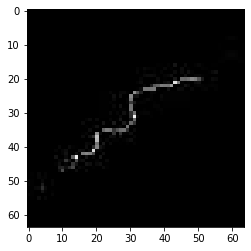

confidence for 5696 is 0.9062196


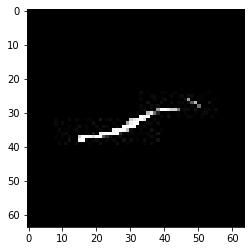

confidence for 5712 is 0.72252357


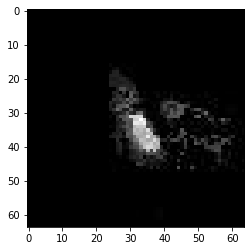

confidence for 5729 is 0.99995697


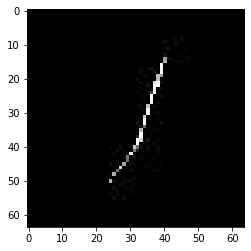

confidence for 5745 is 0.99964756


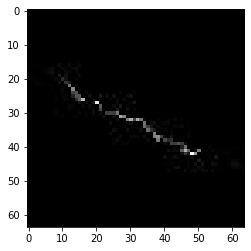

confidence for 5751 is 0.9607944


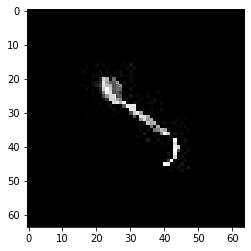

confidence for 5753 is 0.94568217


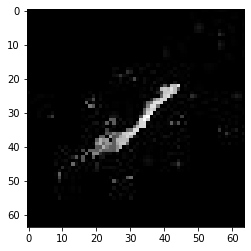

confidence for 5755 is 0.9715768


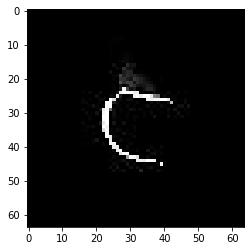

confidence for 5772 is 0.98072064


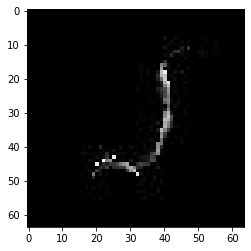

confidence for 5776 is 0.97535586


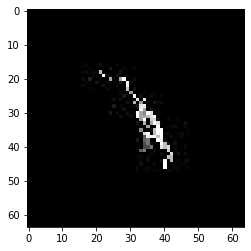

confidence for 5793 is 0.99162275


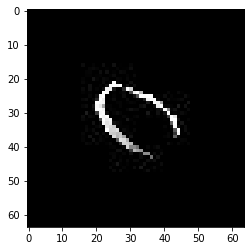

confidence for 5798 is 0.904176


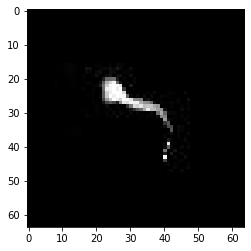

confidence for 5803 is 0.9915645


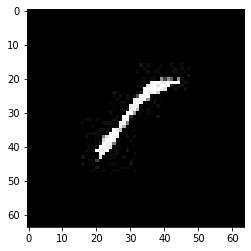

confidence for 5824 is 0.9846089


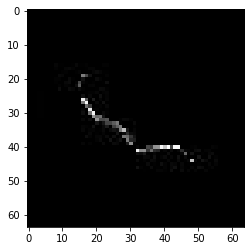

confidence for 5848 is 0.7910641


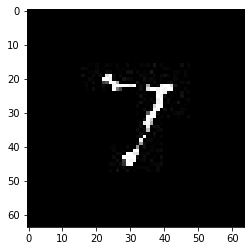

confidence for 5863 is 0.99983066


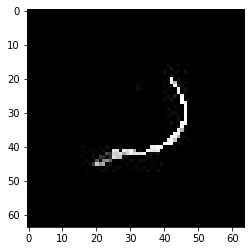

confidence for 5930 is 0.9936408


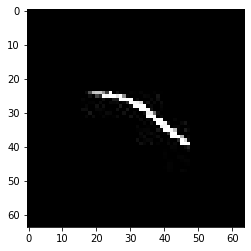

confidence for 5941 is 0.9625916


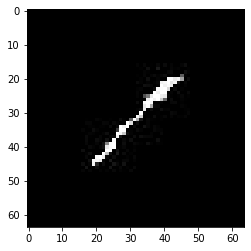

confidence for 5944 is 0.95738983


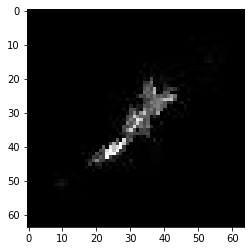

confidence for 5946 is 0.99979484


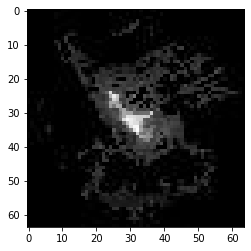

confidence for 5961 is 0.98115236


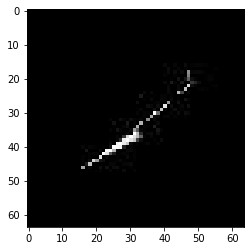

confidence for 5992 is 0.9354183


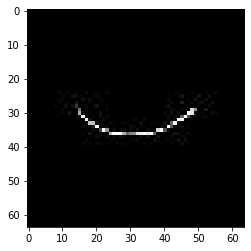

confidence for 5994 is 0.92508954


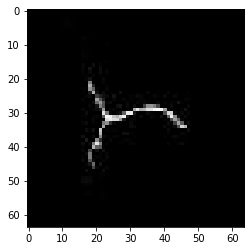

confidence for 6002 is 0.9971472


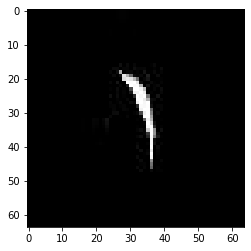

confidence for 6015 is 0.9999708


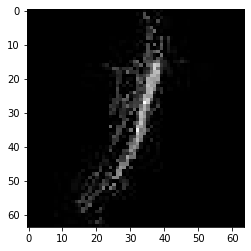

confidence for 6024 is 0.77332294


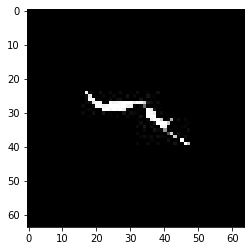

confidence for 6027 is 0.97356117


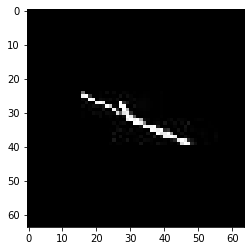

confidence for 6034 is 0.99084693


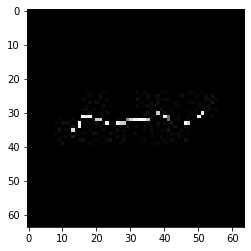

confidence for 6035 is 0.88473046


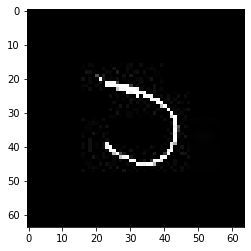

confidence for 6036 is 0.9989382


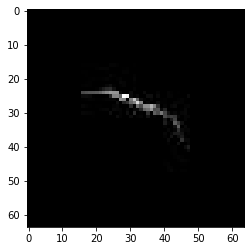

confidence for 6038 is 0.9796915


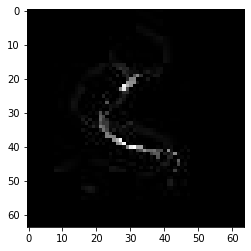

confidence for 6041 is 0.88861775


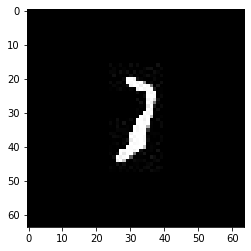

confidence for 6043 is 0.9998832


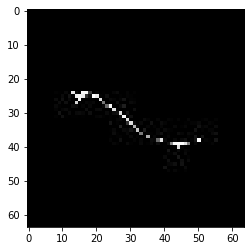

confidence for 6047 is 0.90393835


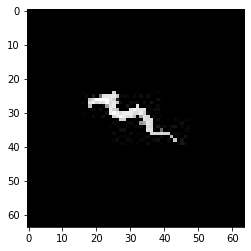

confidence for 6056 is 0.992525


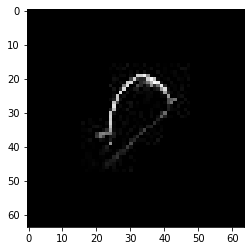

confidence for 6059 is 0.9929467


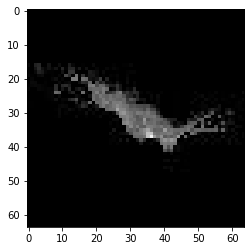

confidence for 6068 is 0.875441


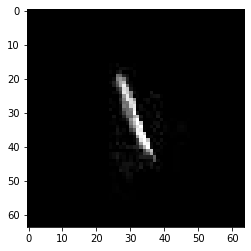

confidence for 6071 is 0.7097101


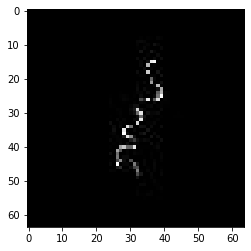

confidence for 6073 is 0.968263


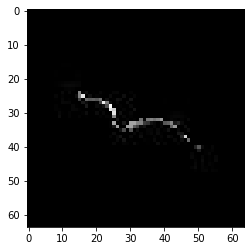

confidence for 6079 is 0.9994591


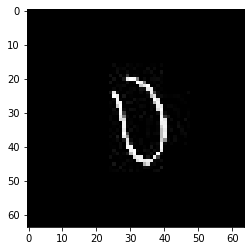

confidence for 6084 is 0.99976104


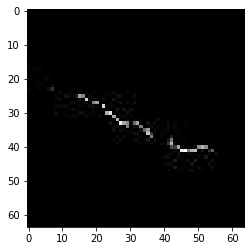

confidence for 6085 is 0.97199714


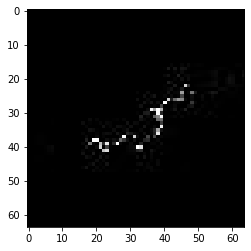

confidence for 6107 is 0.9450422


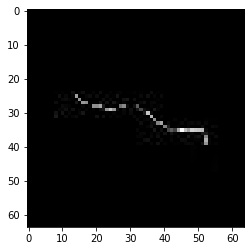

confidence for 6124 is 0.997898


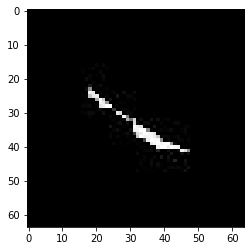

confidence for 6126 is 0.9130202


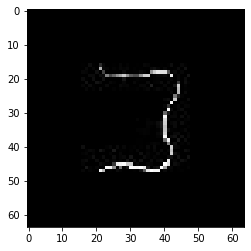

confidence for 6137 is 0.86233777


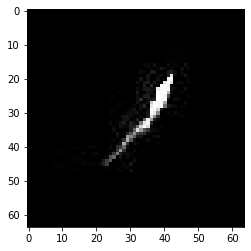

confidence for 6159 is 0.88892025


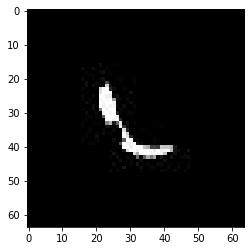

confidence for 6167 is 0.9999858


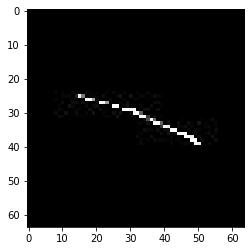

confidence for 6173 is 0.96717435


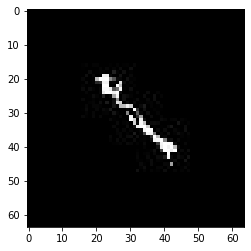

confidence for 6175 is 0.9999913


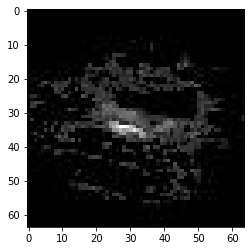

confidence for 6180 is 0.999854


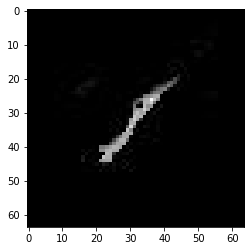

confidence for 6189 is 0.99912035


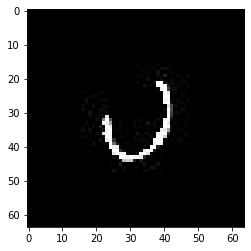

confidence for 6208 is 0.73504


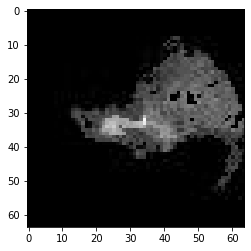

confidence for 6251 is 0.70541877


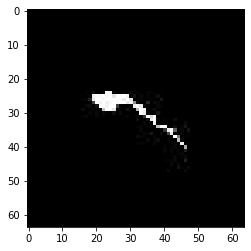

confidence for 6255 is 0.9726518


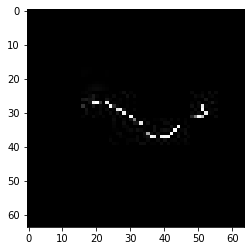

confidence for 6258 is 0.99160606


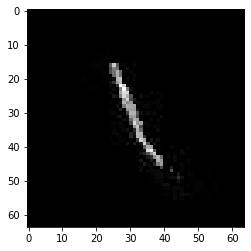

confidence for 6288 is 0.90899545


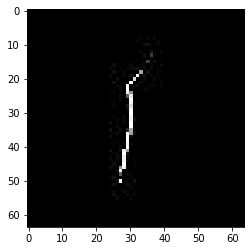

confidence for 6293 is 0.7093124


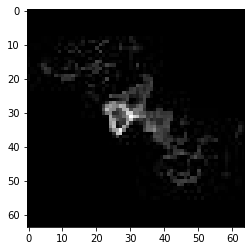

confidence for 6294 is 0.9960266


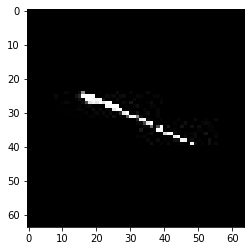

confidence for 6304 is 0.9682586


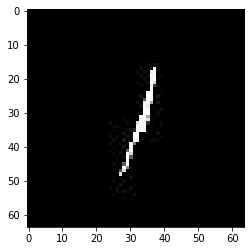

confidence for 6313 is 0.89282787


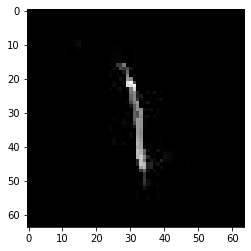

confidence for 6324 is 0.7821196


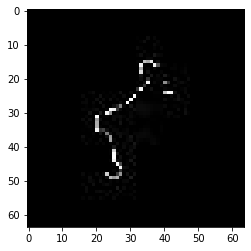

confidence for 6344 is 0.88997334


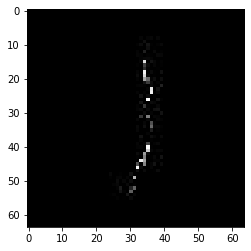

confidence for 6349 is 0.9919567


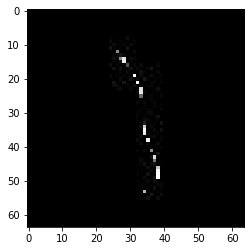

confidence for 6361 is 0.8206124


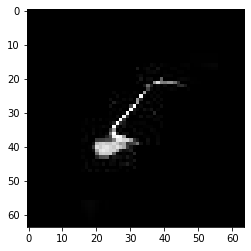

confidence for 6380 is 0.86231977


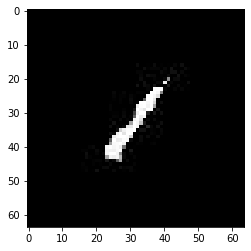

confidence for 6395 is 0.8409853


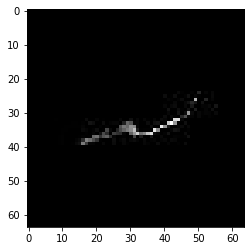

confidence for 6401 is 0.881213


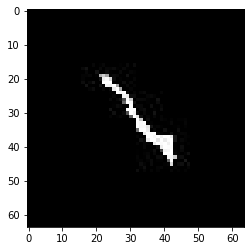

confidence for 6409 is 0.9167364


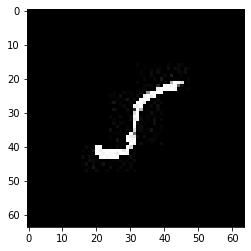

confidence for 6417 is 0.83474517


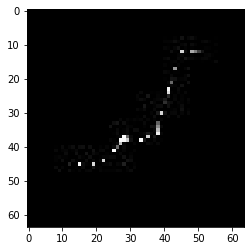

confidence for 6454 is 0.9999348


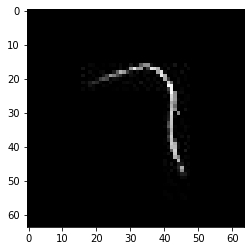

confidence for 6474 is 0.9672135


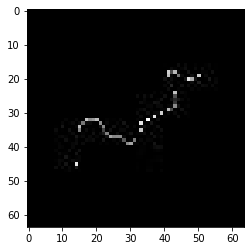

confidence for 6497 is 0.9983513


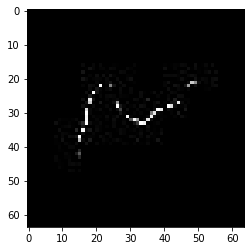

confidence for 6504 is 0.96112645


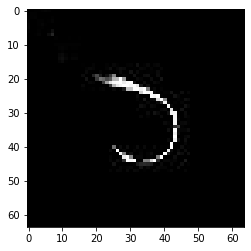

confidence for 6523 is 0.9999677


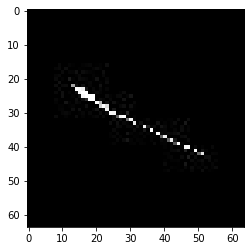

confidence for 6526 is 0.85237366


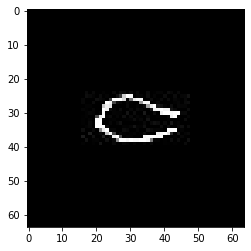

confidence for 6529 is 0.8945339


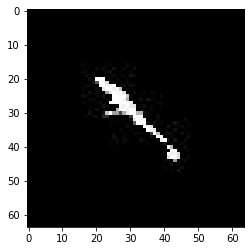

confidence for 6537 is 0.90517396


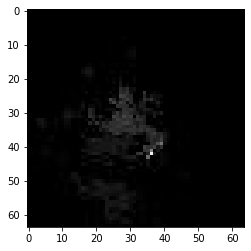

confidence for 6541 is 0.76898205


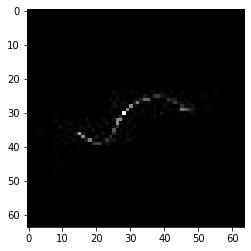

confidence for 6548 is 0.7226588


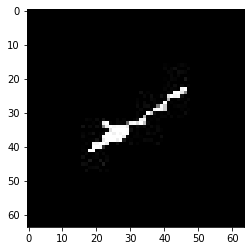

confidence for 6558 is 0.79346144


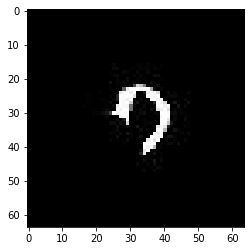

confidence for 6562 is 0.99349904


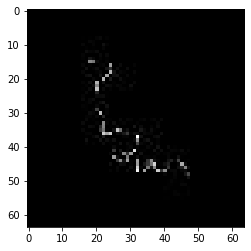

confidence for 6564 is 0.9945817


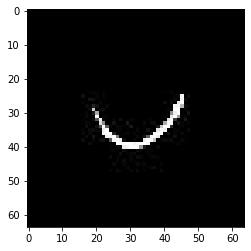

confidence for 6568 is 0.97734565


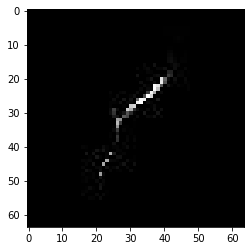

confidence for 6596 is 0.8865487


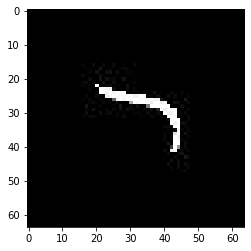

confidence for 6602 is 0.9959297


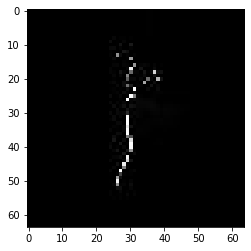

confidence for 6606 is 0.97186756


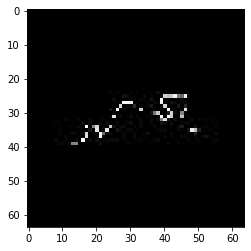

confidence for 6613 is 0.9823336


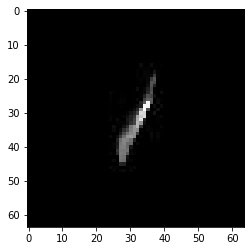

confidence for 6615 is 0.91509706


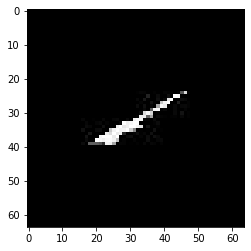

confidence for 6627 is 0.75951356


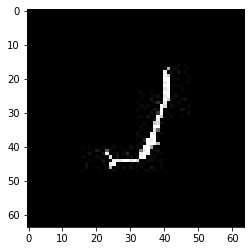

confidence for 6635 is 0.9585947


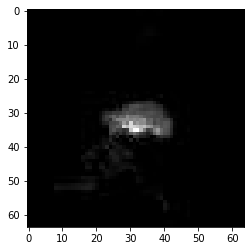

confidence for 6642 is 0.99734086


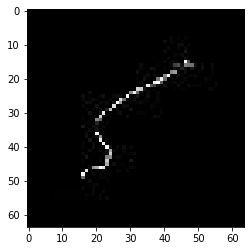

confidence for 6648 is 0.9360108


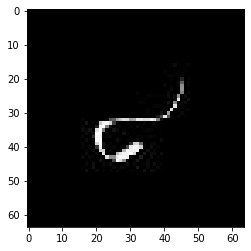

confidence for 6653 is 0.99847734


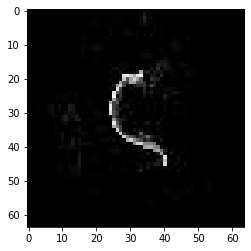

confidence for 6677 is 0.9992385


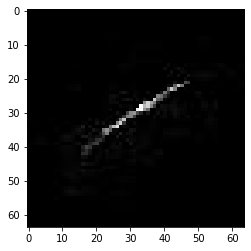

confidence for 6683 is 0.96292126


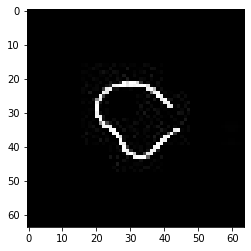

confidence for 6691 is 0.9946292


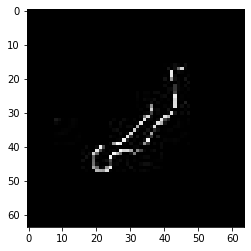

confidence for 6700 is 0.7138351


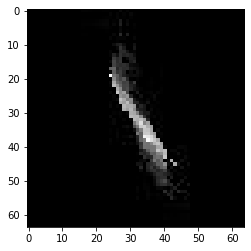

confidence for 6703 is 0.9983502


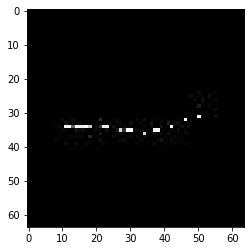

confidence for 6710 is 0.9990612


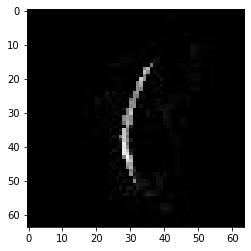

confidence for 6716 is 0.75258553


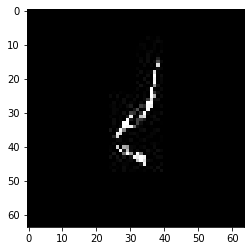

confidence for 6723 is 0.95362353


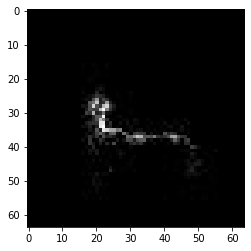

confidence for 6750 is 0.9380436


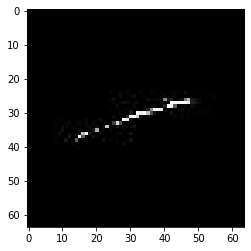

confidence for 6756 is 0.99997675


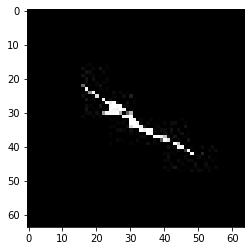

confidence for 6758 is 0.9550032


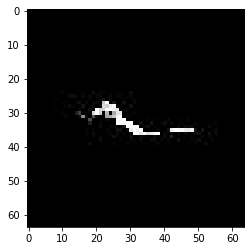

confidence for 6767 is 0.91511774


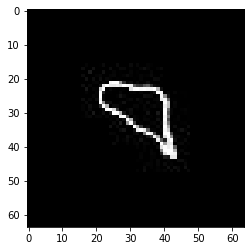

confidence for 6781 is 0.9777233


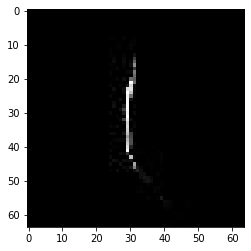

confidence for 6796 is 0.99982345


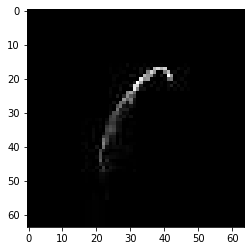

confidence for 6799 is 0.9999298


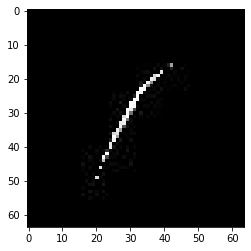

confidence for 6803 is 0.73475283


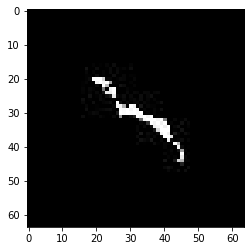

confidence for 6806 is 0.82265437


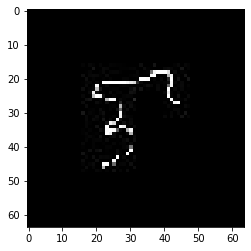

confidence for 6807 is 0.9682557


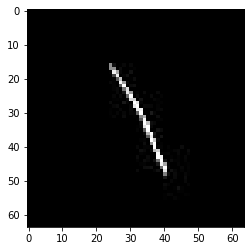

confidence for 6825 is 0.9769819


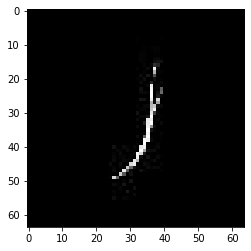

confidence for 6827 is 0.9997858


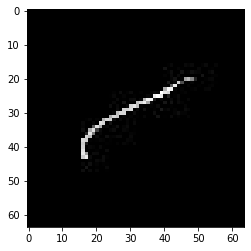

confidence for 6832 is 0.9997173


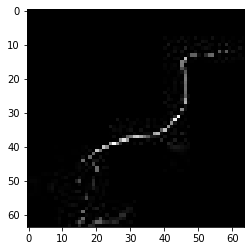

confidence for 6834 is 0.99236345


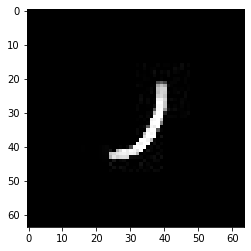

confidence for 6838 is 0.98881686


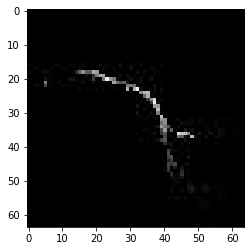

confidence for 6870 is 0.99908906


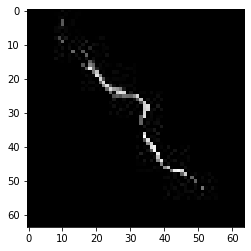

confidence for 6894 is 0.99305403


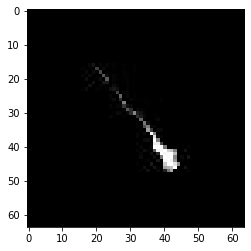

confidence for 6900 is 0.9858176


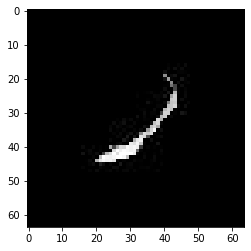

confidence for 6903 is 0.99798787


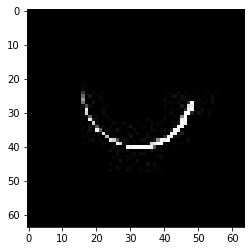

confidence for 6939 is 0.9985259


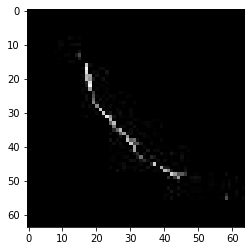

confidence for 6945 is 0.997052


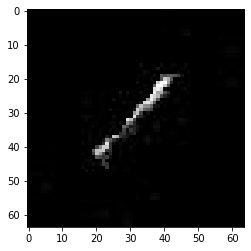

confidence for 6946 is 0.9952861


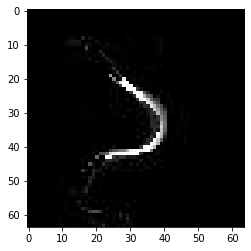

confidence for 6962 is 0.9857751


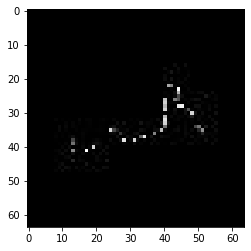

confidence for 7060 is 0.9946896


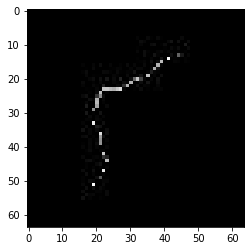

confidence for 7074 is 0.77829766


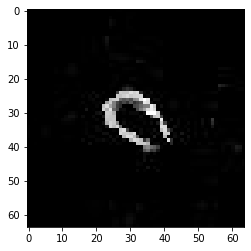

confidence for 7100 is 0.8184866


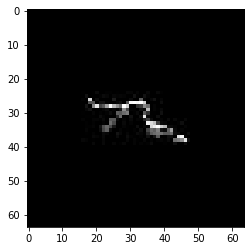

confidence for 7118 is 0.9872564


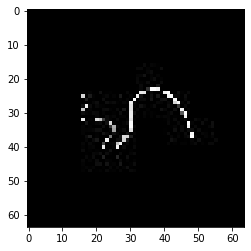

confidence for 7122 is 0.8942938


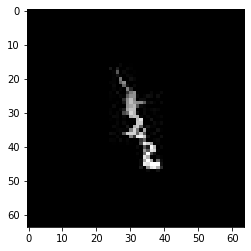

confidence for 7135 is 0.73097193


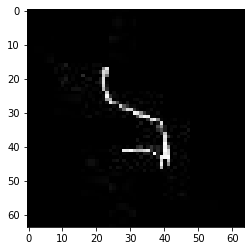

confidence for 7150 is 0.9562692


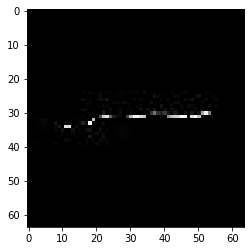

confidence for 7152 is 0.96246064


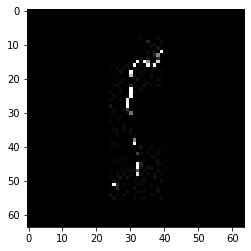

confidence for 7181 is 0.8602361


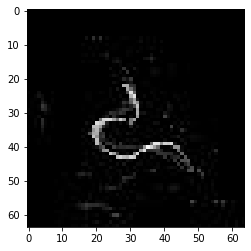

confidence for 7187 is 0.9166965


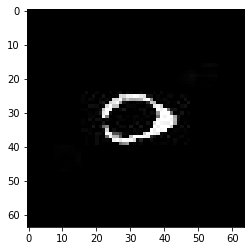

confidence for 7212 is 0.96081877


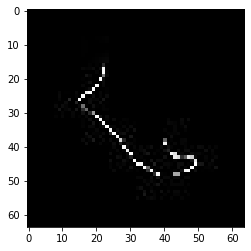

confidence for 7220 is 0.78522205


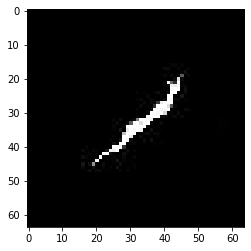

confidence for 7235 is 0.9832334


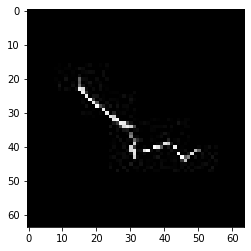

confidence for 7238 is 0.8970197


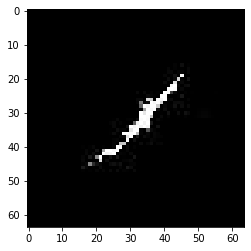

confidence for 7280 is 0.97905034


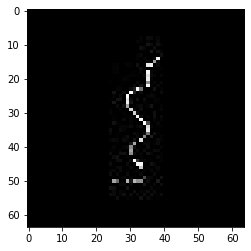

confidence for 7282 is 0.9380397


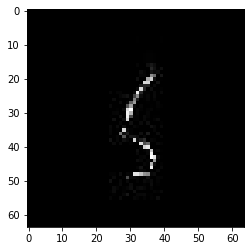

confidence for 7311 is 0.8370903


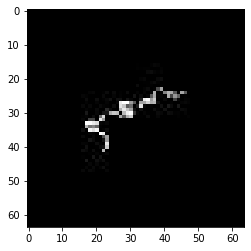

confidence for 7352 is 0.85644776


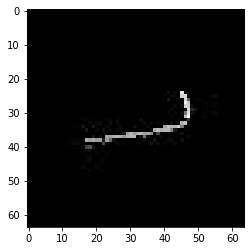

confidence for 7358 is 0.8969397


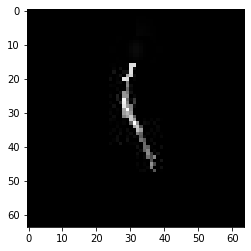

confidence for 7362 is 0.8089114


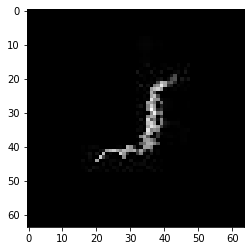

confidence for 7378 is 0.9748142


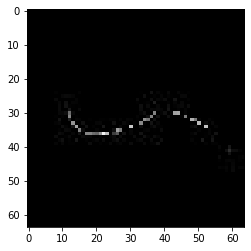

confidence for 7411 is 0.73123467


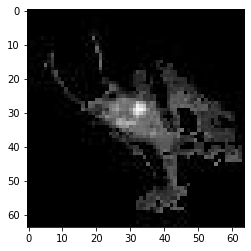

confidence for 7415 is 0.9999797


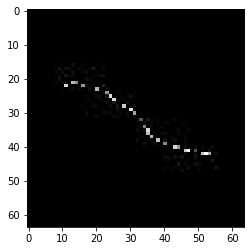

confidence for 7427 is 0.79287153


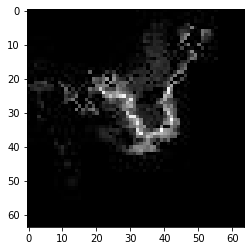

confidence for 7431 is 0.9991859


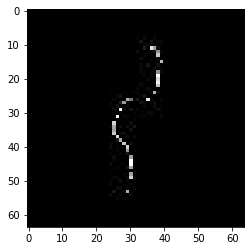

confidence for 7437 is 0.9952909


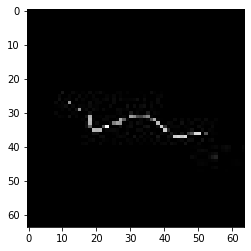

confidence for 7448 is 0.97248536


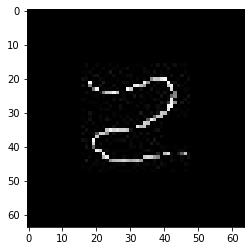

confidence for 7461 is 0.9316482


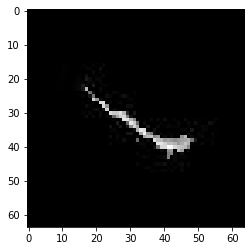

confidence for 7503 is 0.9516013


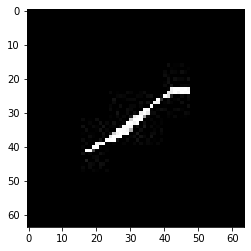

confidence for 7516 is 0.7239159


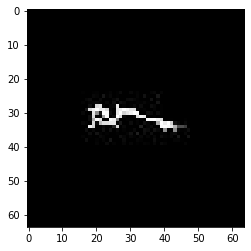

confidence for 7518 is 0.9676457


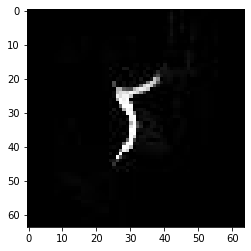

confidence for 7527 is 0.9936343


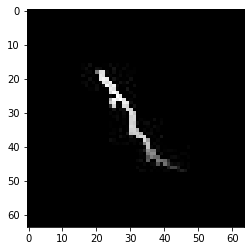

confidence for 7531 is 0.9997992


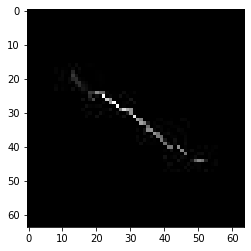

confidence for 7589 is 0.9782325


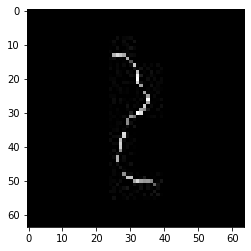

confidence for 7605 is 0.9976688


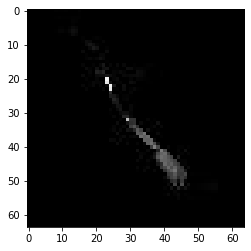

confidence for 7610 is 0.9979613


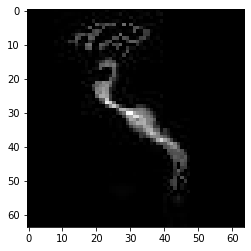

confidence for 7615 is 0.9901834


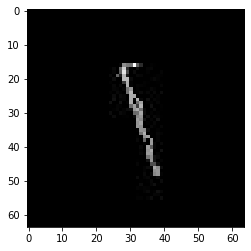

confidence for 7640 is 0.99733007


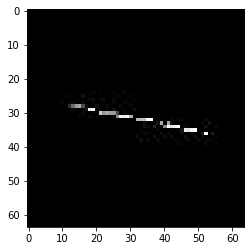

confidence for 7646 is 0.9971338


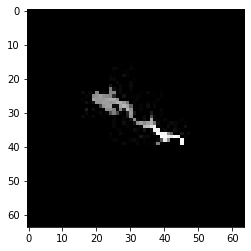

confidence for 7648 is 0.98316294


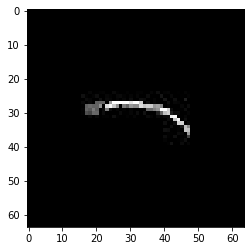

confidence for 7724 is 0.998026


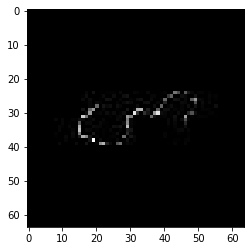

confidence for 7733 is 0.92271584


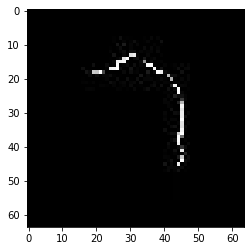

confidence for 7744 is 0.9890464


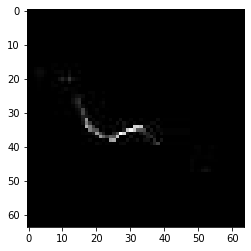

confidence for 7752 is 0.9959811


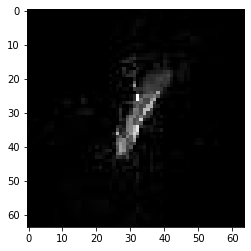

confidence for 7756 is 0.7029894


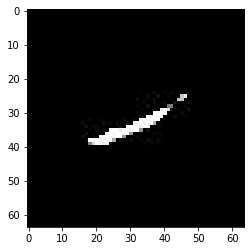

confidence for 7778 is 0.89854777


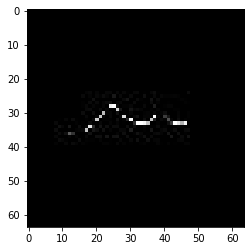

confidence for 7807 is 0.9999638


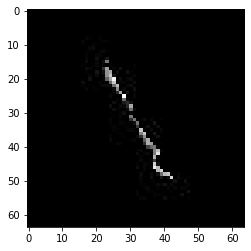

confidence for 7833 is 0.98856086


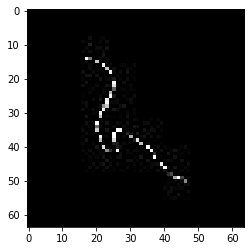

confidence for 7865 is 0.9980182


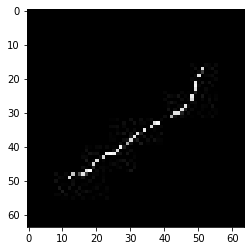

confidence for 7872 is 0.91381127


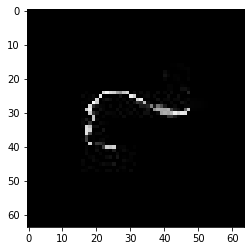

confidence for 7915 is 0.7950308


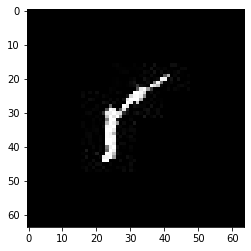

confidence for 7933 is 0.9818342


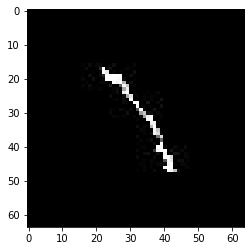

confidence for 7949 is 0.7416123


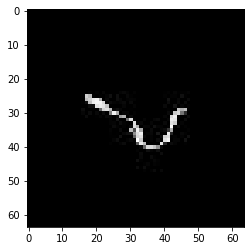

confidence for 7970 is 0.99737304


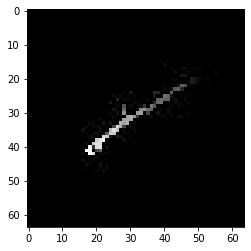

confidence for 7982 is 0.9623248


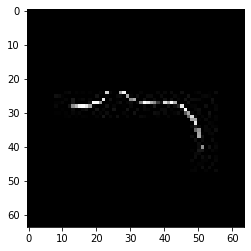

confidence for 7997 is 0.9877016


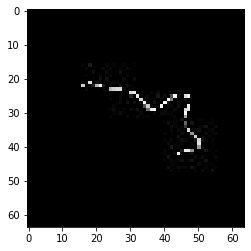

confidence for 8003 is 0.9849437


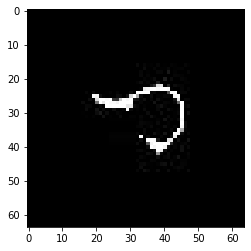

confidence for 8015 is 0.99541414


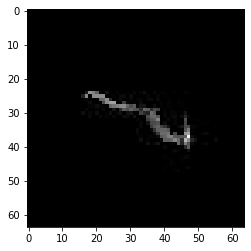

confidence for 8023 is 0.76440984


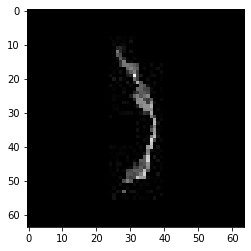

confidence for 8028 is 0.9976151


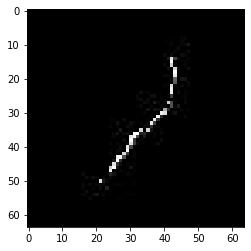

confidence for 8032 is 0.92018026


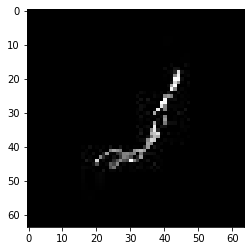

confidence for 8033 is 0.92286074


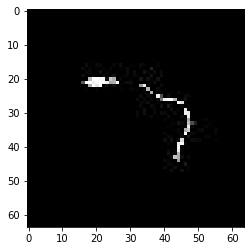

confidence for 8037 is 0.95029104


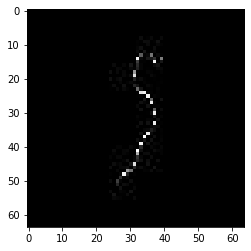

confidence for 8044 is 0.99979776


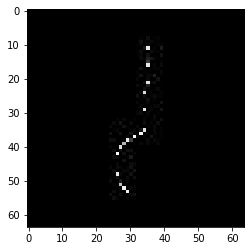

confidence for 8065 is 0.99997365


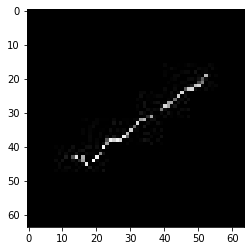

confidence for 8068 is 0.7149795


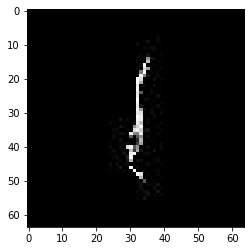

confidence for 8070 is 0.9530967


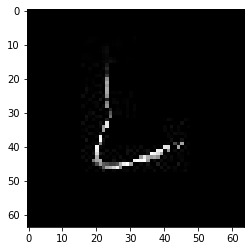

confidence for 8071 is 0.999928


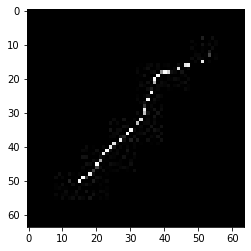

confidence for 8074 is 0.99189276


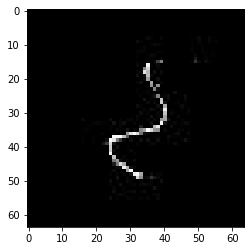

confidence for 8077 is 0.98375833


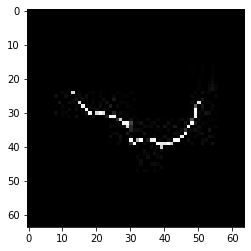

confidence for 8088 is 0.99990493


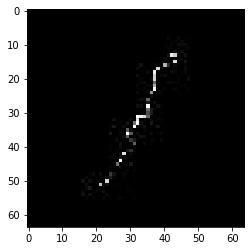

confidence for 8093 is 0.827131


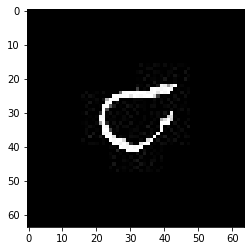

confidence for 8105 is 0.99221075


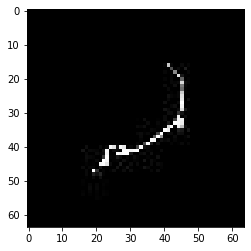

confidence for 8122 is 0.7282185


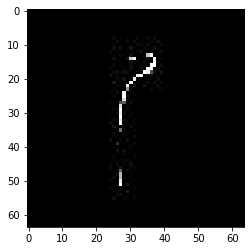

confidence for 8128 is 0.96077013


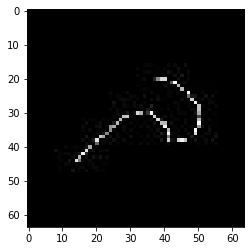

confidence for 8134 is 0.8585352


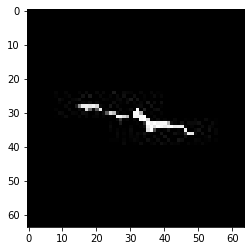

confidence for 8140 is 0.9598326


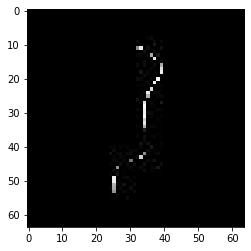

confidence for 8154 is 0.99493766


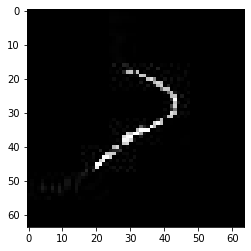

confidence for 8162 is 0.99693954


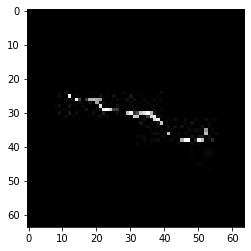

confidence for 8170 is 0.8902822


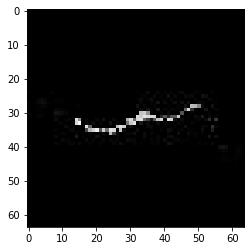

confidence for 8181 is 0.9974118


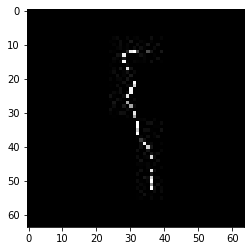

confidence for 8185 is 0.99638


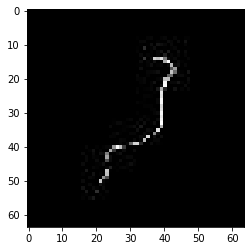

confidence for 8194 is 0.9317616


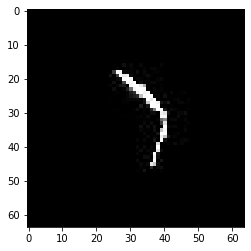

confidence for 8216 is 0.99544203


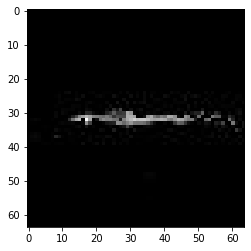

confidence for 8223 is 0.9034261


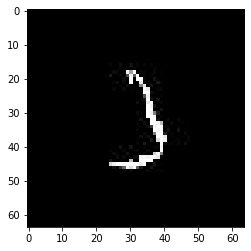

confidence for 8228 is 0.9249794


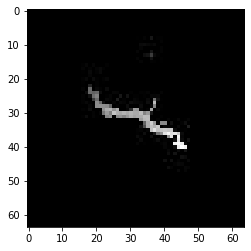

confidence for 8229 is 0.9284067


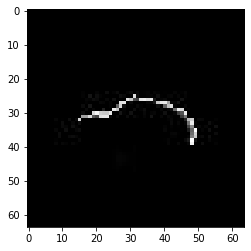

confidence for 8235 is 0.9999817


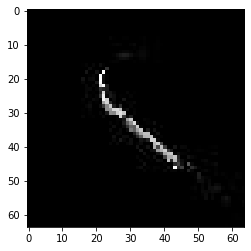

confidence for 8250 is 0.971062


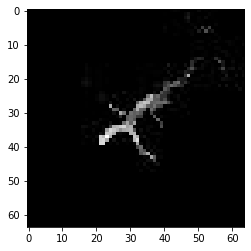

confidence for 8251 is 0.87643087


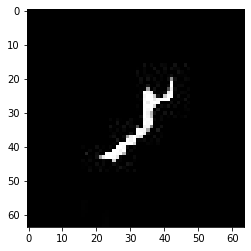

confidence for 8265 is 0.88541466


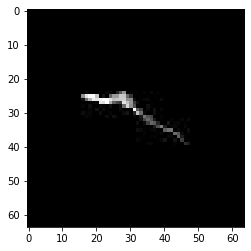

confidence for 8266 is 0.97019637


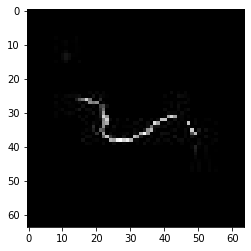

confidence for 8280 is 0.7819492


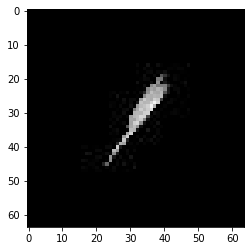

confidence for 8295 is 0.75372833


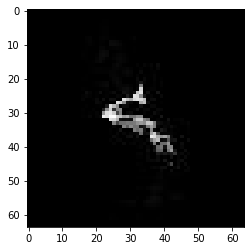

confidence for 8297 is 0.99989


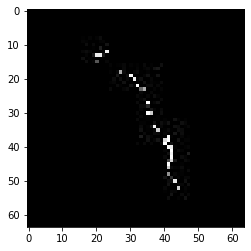

confidence for 8312 is 0.99538094


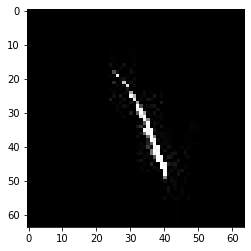

confidence for 8317 is 0.9861218


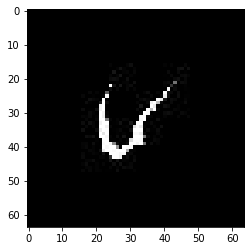

confidence for 8333 is 0.8804274


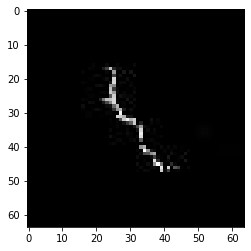

confidence for 8334 is 0.94431096


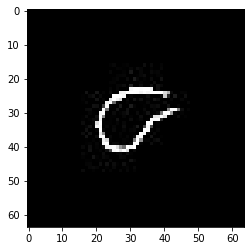

confidence for 8336 is 0.99539286


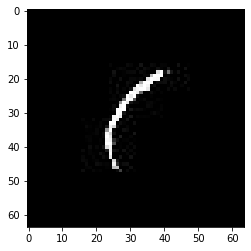

confidence for 8349 is 0.9668567


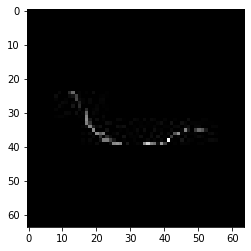

confidence for 8379 is 0.99737495


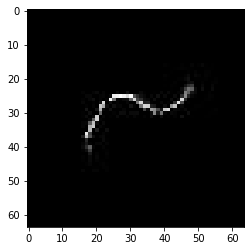

confidence for 8421 is 0.9945216


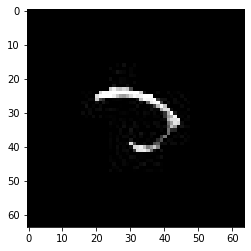

confidence for 8429 is 0.7676194


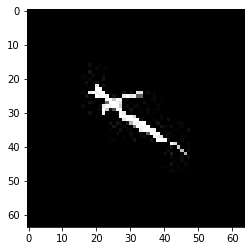

confidence for 8438 is 0.97254914


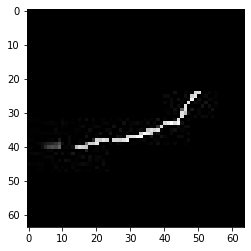

confidence for 8444 is 0.93570924


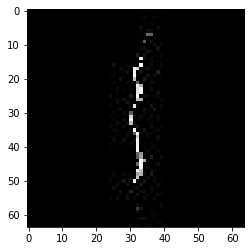

confidence for 8447 is 0.8403364


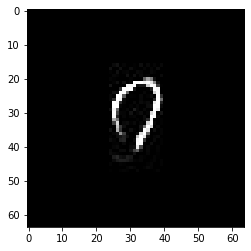

confidence for 8457 is 0.9843756


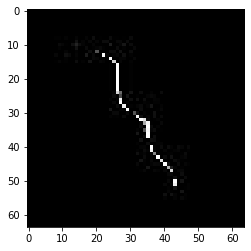

confidence for 8459 is 0.94224066


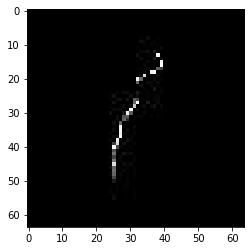

confidence for 8488 is 0.9636908


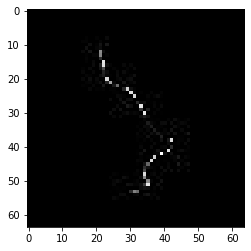

confidence for 8509 is 0.8770395


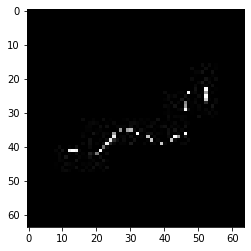

confidence for 8522 is 0.9335733


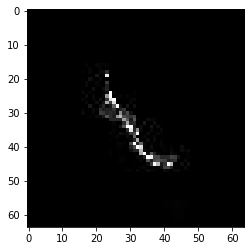

confidence for 8535 is 0.99760354


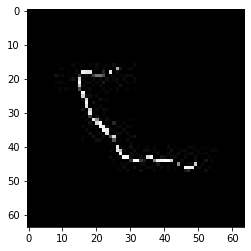

confidence for 8537 is 0.99994415


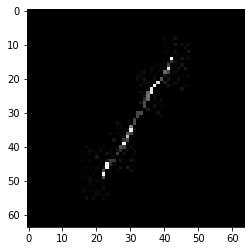

confidence for 8546 is 0.9799695


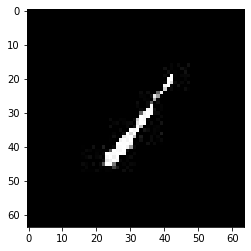

confidence for 8574 is 0.9980215


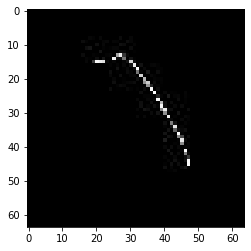

confidence for 8577 is 0.9999052


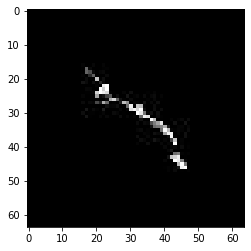

confidence for 8580 is 0.98310983


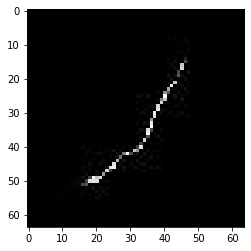

confidence for 8581 is 0.9966469


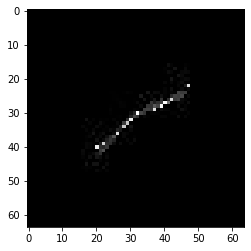

confidence for 8584 is 0.8147896


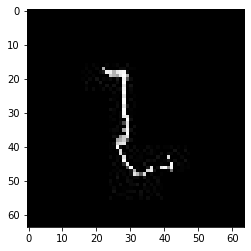

confidence for 8585 is 0.9997441


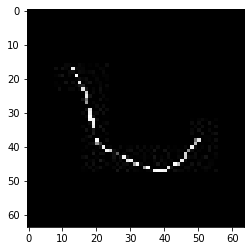

confidence for 8601 is 0.99856025


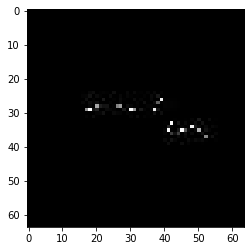

confidence for 8602 is 0.99973005


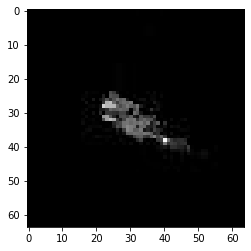

confidence for 8608 is 0.9936647


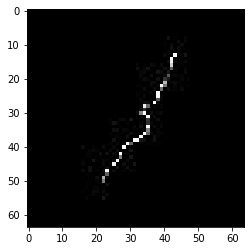

confidence for 8610 is 0.9985731


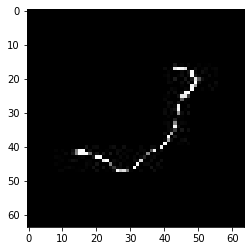

confidence for 8613 is 0.9990269


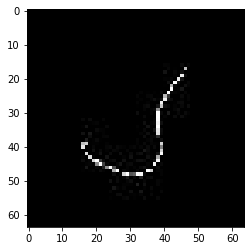

confidence for 8660 is 0.99843


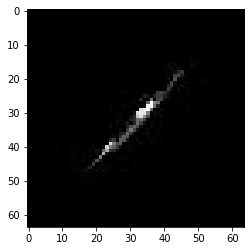

confidence for 8674 is 0.9877955


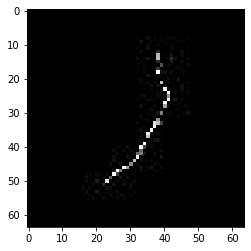

confidence for 8682 is 0.9999789


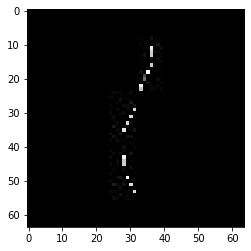

confidence for 8684 is 0.9432711


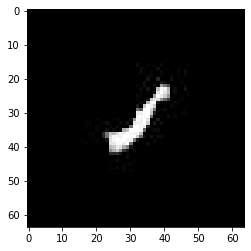

confidence for 8712 is 0.9985618


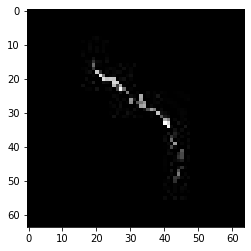

confidence for 8722 is 0.99998784


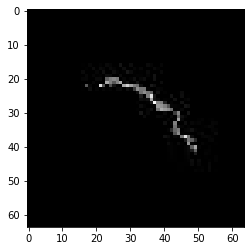

confidence for 8723 is 0.9873798


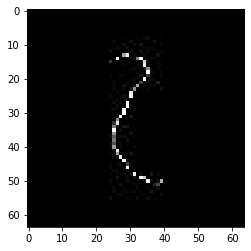

confidence for 8732 is 0.9810905


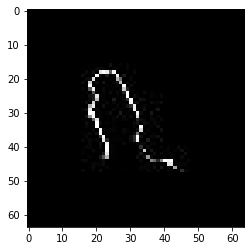

confidence for 8733 is 0.9991084


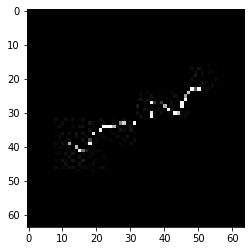

confidence for 8735 is 0.9848243


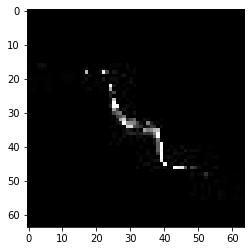

confidence for 8750 is 0.7176312


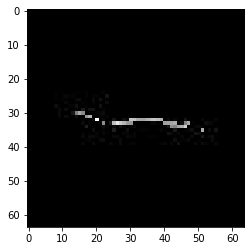

confidence for 8764 is 0.860035


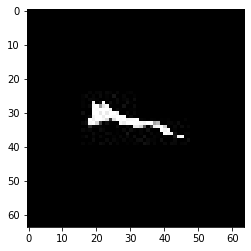

confidence for 8784 is 0.9999054


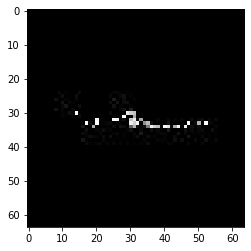

confidence for 8789 is 0.99210364


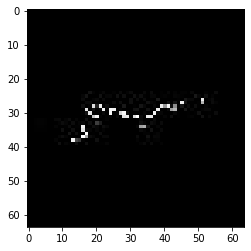

confidence for 8796 is 0.8846499


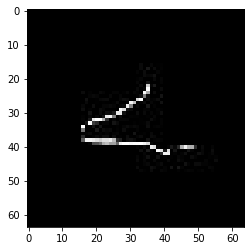

confidence for 8808 is 0.9767


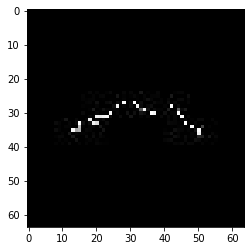

confidence for 8818 is 0.9959763


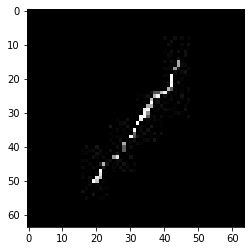

confidence for 8826 is 0.9682549


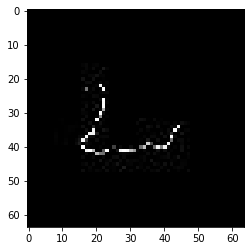

confidence for 8834 is 0.98686165


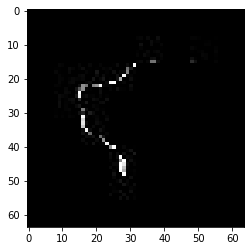

confidence for 8841 is 0.9998897


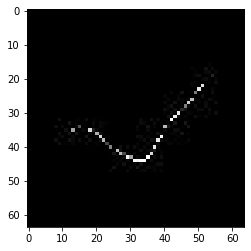

confidence for 8850 is 0.9139273


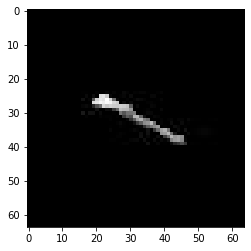

confidence for 8856 is 0.8092078


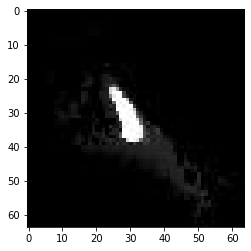

confidence for 8863 is 0.99600416


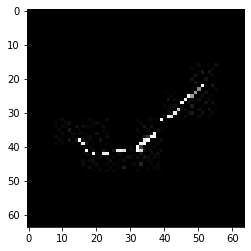

confidence for 8864 is 0.8772685


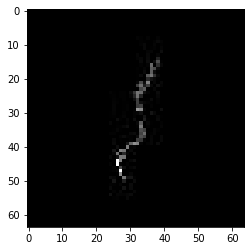

confidence for 8877 is 0.9997531


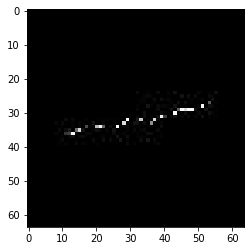

confidence for 8900 is 0.999639


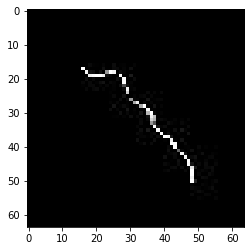

confidence for 8933 is 0.77259916


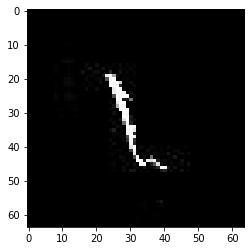

confidence for 8935 is 0.9824171


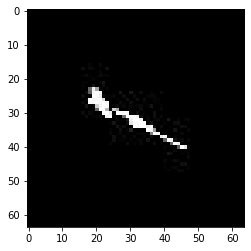

confidence for 8937 is 0.98450255


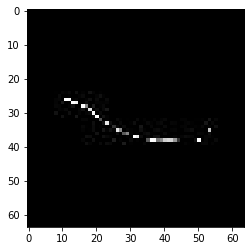

confidence for 8939 is 0.94449097


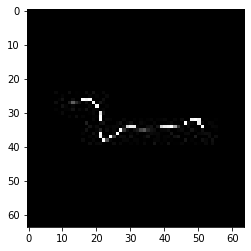

confidence for 8970 is 0.8531804


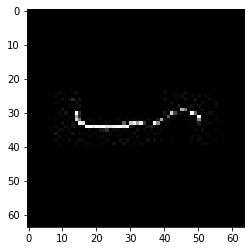

confidence for 8996 is 0.7093849


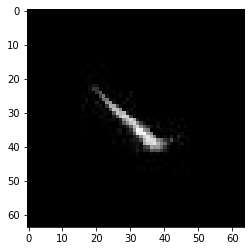

confidence for 9002 is 0.9725513


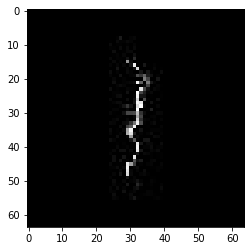

confidence for 9003 is 0.9998288


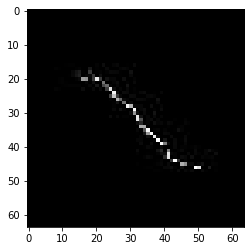

confidence for 9008 is 0.8657412


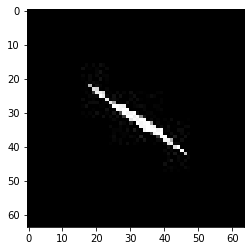

confidence for 9013 is 0.7554778


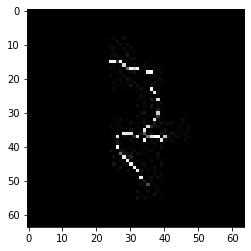

confidence for 9018 is 0.9999231


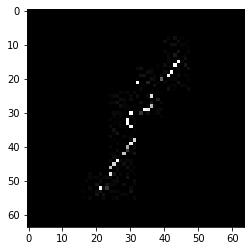

confidence for 9021 is 0.93014675


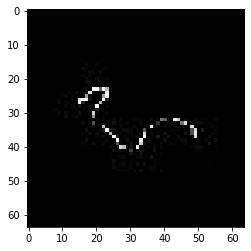

confidence for 9030 is 0.83186734


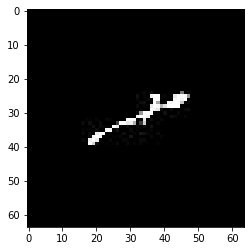

confidence for 9043 is 0.9953351


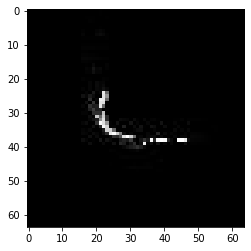

confidence for 9050 is 0.99958897


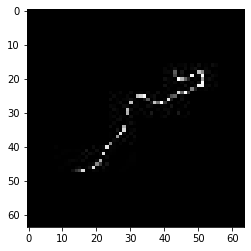

confidence for 9060 is 0.98347723


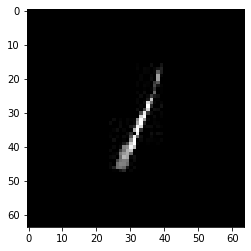

confidence for 9062 is 0.9645419


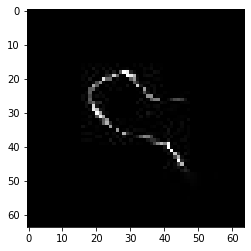

confidence for 9073 is 0.97787195


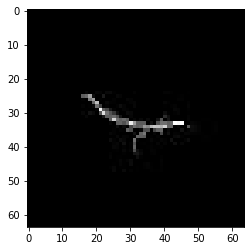

confidence for 9075 is 0.9427891


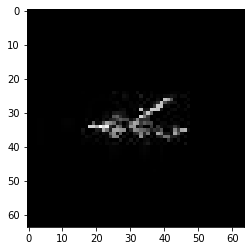

confidence for 9081 is 0.9999361


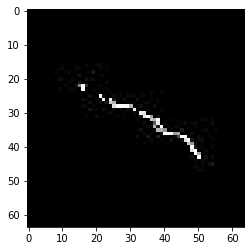

confidence for 9087 is 0.99999356


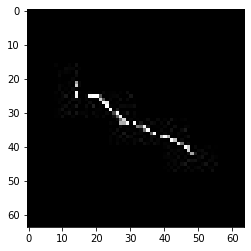

confidence for 9090 is 0.74837536


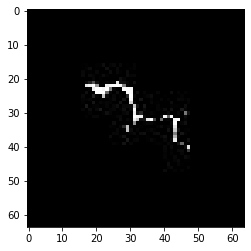

confidence for 9106 is 0.99222195


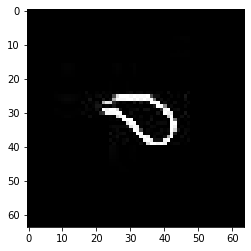

confidence for 9114 is 0.99992067


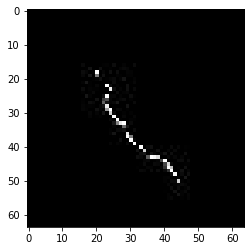

confidence for 9139 is 0.9936562


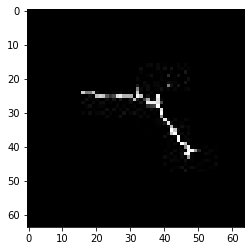

confidence for 9142 is 0.77859265


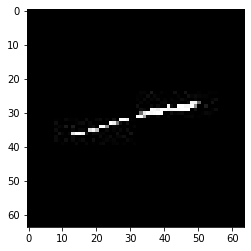

confidence for 9162 is 0.9988144


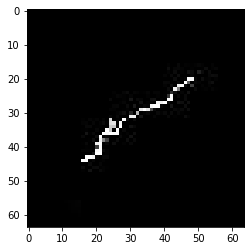

confidence for 9165 is 0.9818826


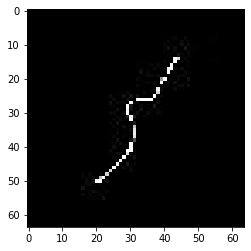

confidence for 9183 is 0.82618266


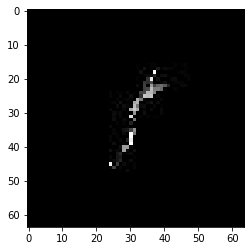

confidence for 9185 is 0.70717543


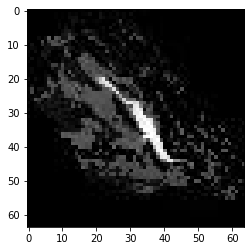

confidence for 9188 is 0.7316522


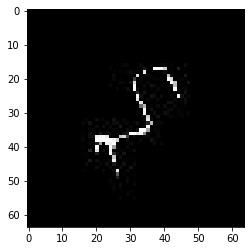

confidence for 9189 is 0.91187745


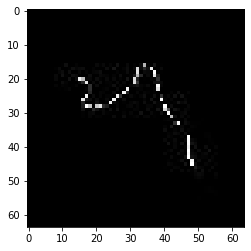

confidence for 9208 is 0.9941033


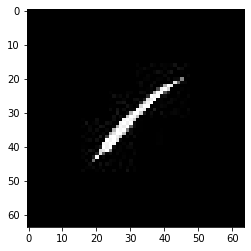

confidence for 9217 is 0.986465


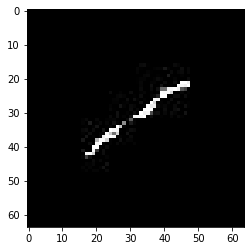

confidence for 9226 is 0.97572887


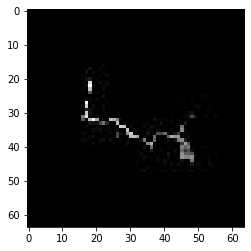

confidence for 9232 is 0.99966323


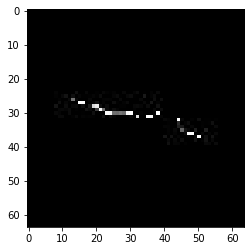

confidence for 9233 is 0.9887422


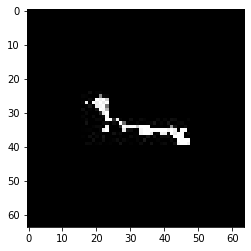

confidence for 9242 is 0.9289404


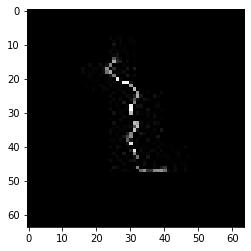

confidence for 9255 is 0.9591064


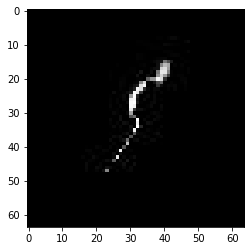

confidence for 9266 is 0.86153305


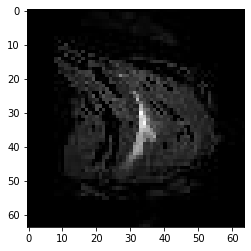

confidence for 9294 is 0.98877895


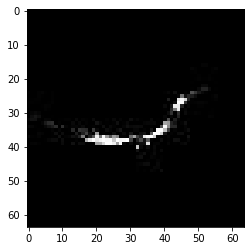

confidence for 9313 is 0.96327156


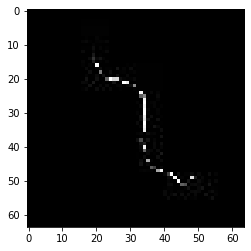

confidence for 9324 is 0.9330489


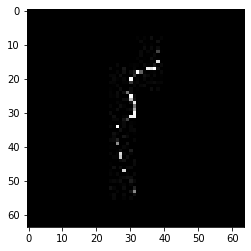

confidence for 9338 is 0.9547497


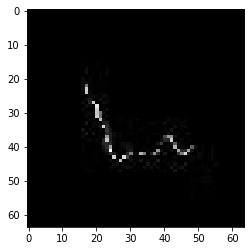

confidence for 9358 is 0.88972276


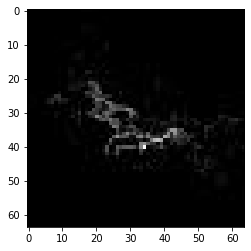

confidence for 9380 is 0.98718524


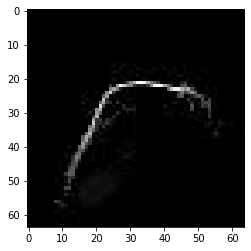

confidence for 9426 is 0.9941983


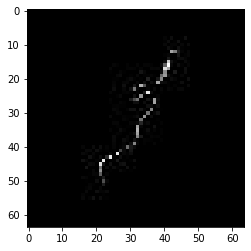

confidence for 9430 is 0.9999999


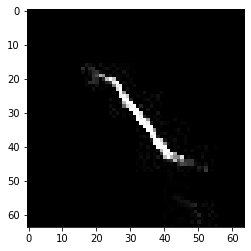

confidence for 9438 is 0.9527781


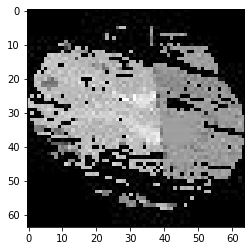

confidence for 9446 is 0.99999714


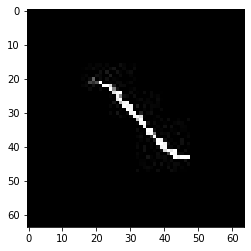

confidence for 9448 is 0.8681875


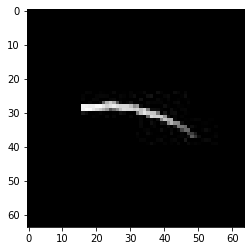

confidence for 9465 is 0.9999919


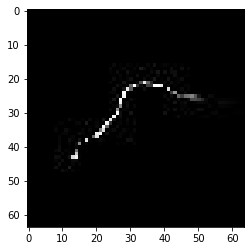

confidence for 9466 is 0.98976874


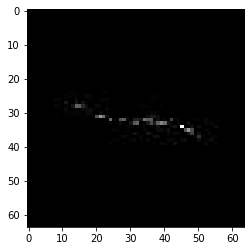

confidence for 9482 is 0.9997096


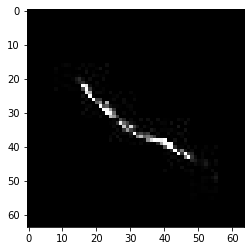

confidence for 9484 is 0.98646456


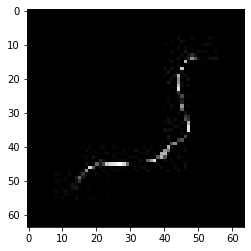

confidence for 9493 is 0.9944752


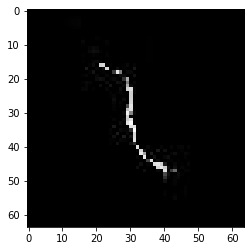

confidence for 9494 is 0.999999


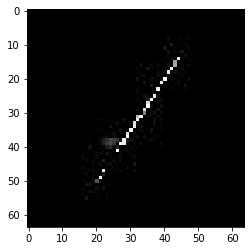

confidence for 9500 is 0.98161876


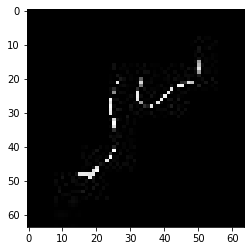

confidence for 9509 is 0.8482336


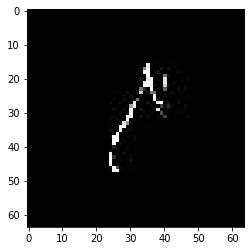

confidence for 9520 is 0.89521414


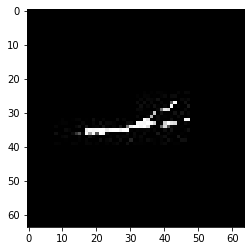

confidence for 9522 is 0.9858526


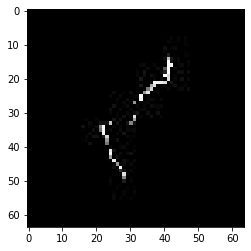

confidence for 9531 is 0.98764306


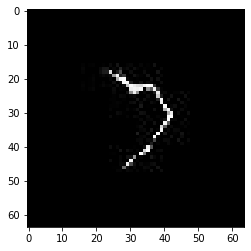

confidence for 9536 is 0.8885622


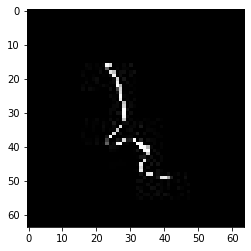

confidence for 9567 is 0.9827105


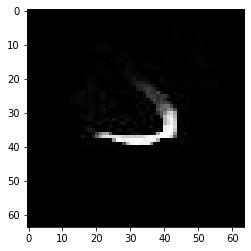

confidence for 9576 is 0.83560884


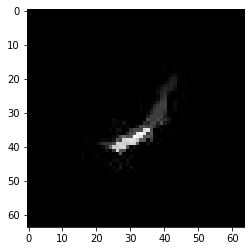

confidence for 9577 is 0.9983633


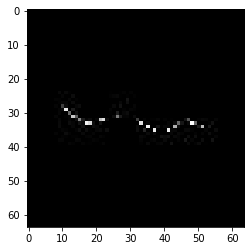

confidence for 9582 is 0.9995517


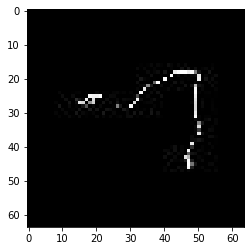

confidence for 9590 is 0.9993353


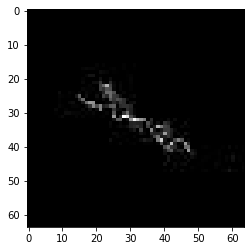

confidence for 9605 is 0.99990803


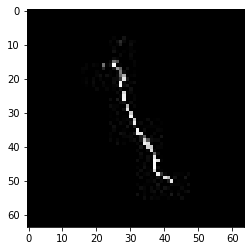

confidence for 9613 is 0.9656611


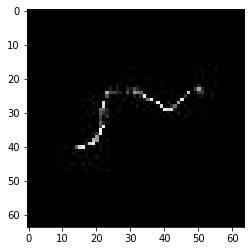

confidence for 9661 is 0.9926209


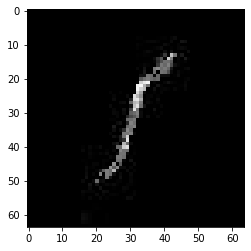

confidence for 9683 is 0.9961339


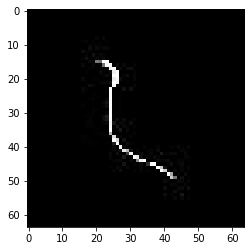

confidence for 9690 is 0.9863168


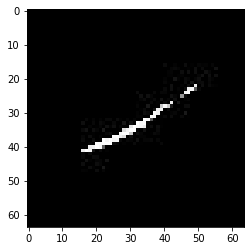

confidence for 9698 is 0.99430144


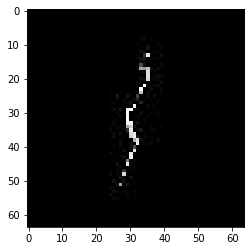

confidence for 9718 is 0.9858927


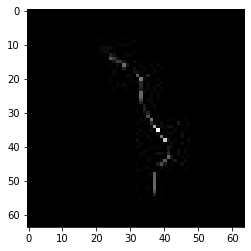

confidence for 9768 is 0.7175484


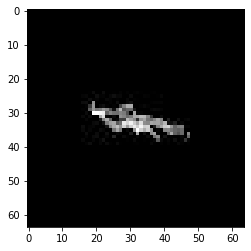

confidence for 9785 is 0.780387


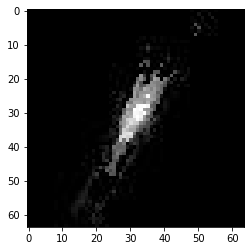

confidence for 9798 is 0.97006744


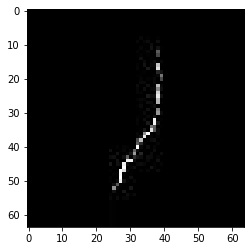

confidence for 9801 is 0.99999636


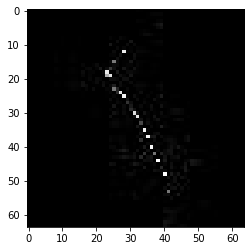

confidence for 9804 is 0.93391484


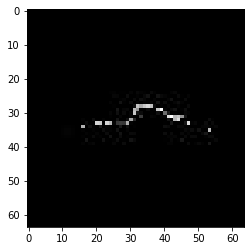

confidence for 9806 is 0.9764236


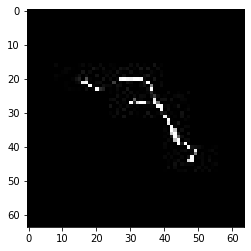

confidence for 9823 is 0.73731875


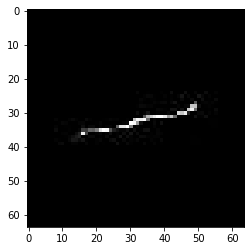

confidence for 9833 is 0.8417028


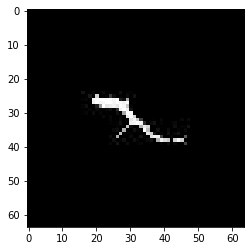

confidence for 9847 is 0.9448276


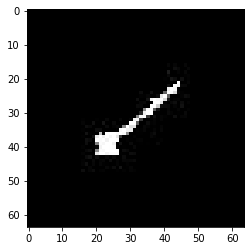

confidence for 9855 is 0.99475014


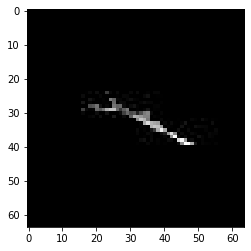

confidence for 9917 is 0.9599024


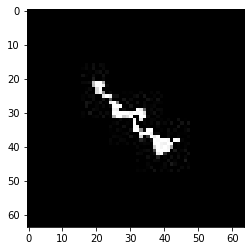

confidence for 9932 is 0.94375974


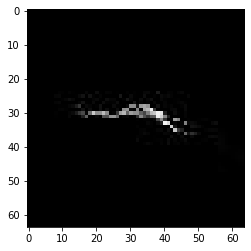

confidence for 9956 is 0.9823479


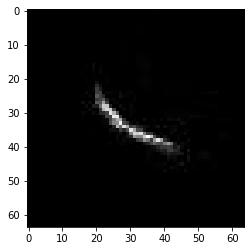

confidence for 9970 is 0.8983736


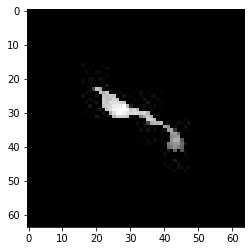

confidence for 9981 is 0.99656504


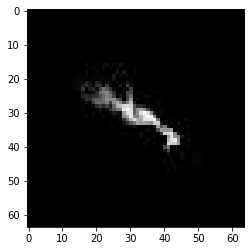

confidence for 10018 is 0.9961796


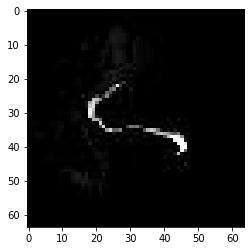

confidence for 10024 is 0.9021637


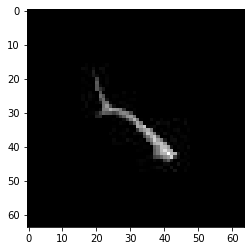

confidence for 10034 is 0.8965194


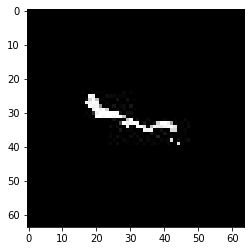

confidence for 10045 is 0.8523257


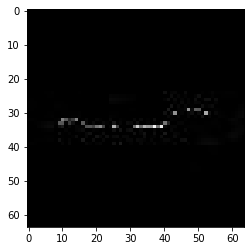

confidence for 10058 is 0.814675


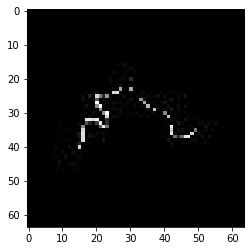

confidence for 10061 is 0.74744296


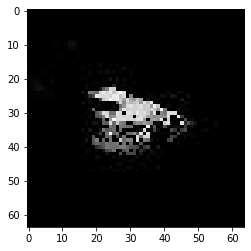

confidence for 10067 is 0.99895513


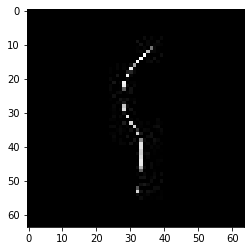

confidence for 10074 is 0.99916553


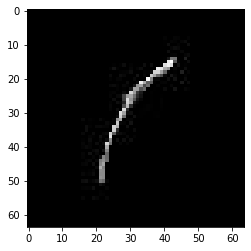

confidence for 10080 is 0.99949515


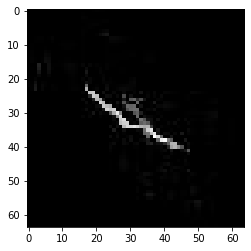

confidence for 10081 is 0.96881634


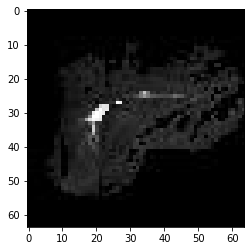

confidence for 10082 is 0.8586157


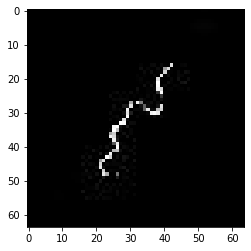

confidence for 10106 is 0.96957594


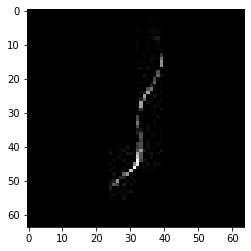

confidence for 10116 is 0.7577773


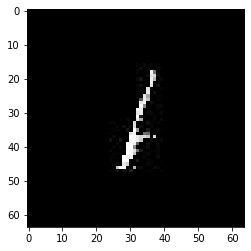

confidence for 10124 is 0.9910249


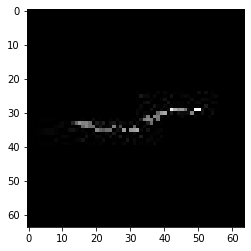

confidence for 10152 is 0.8898756


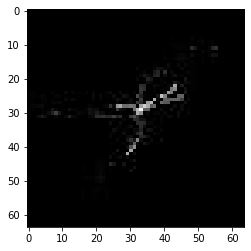

confidence for 10160 is 0.98436064


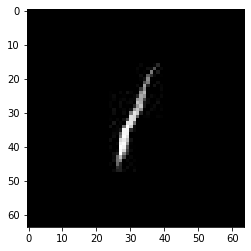

confidence for 10161 is 0.9686125


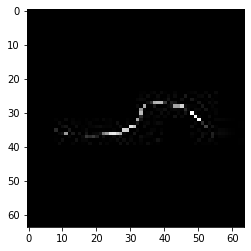

confidence for 10166 is 0.98124975


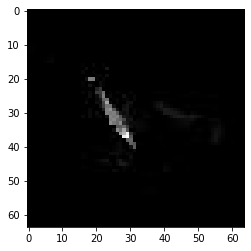

confidence for 10179 is 0.81271887


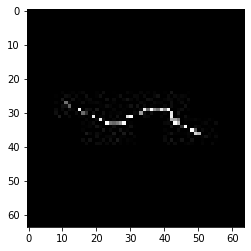

confidence for 10181 is 0.9999247


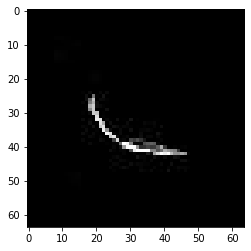

confidence for 10196 is 0.93708897


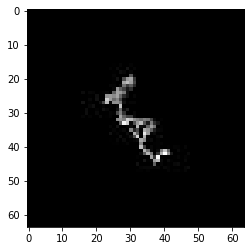

confidence for 10221 is 0.9811679


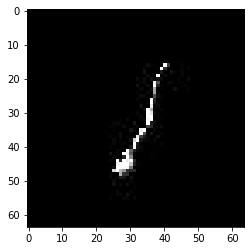

confidence for 10251 is 0.9985512


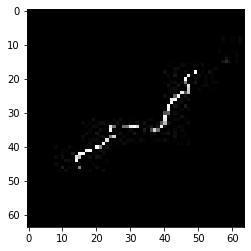

confidence for 10267 is 0.9418213


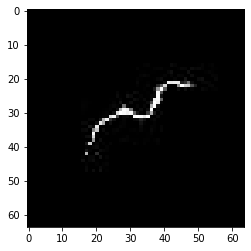

confidence for 10299 is 0.97790253


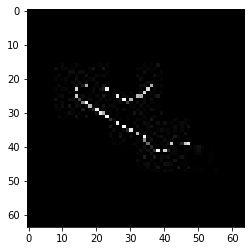

confidence for 10336 is 0.9993112


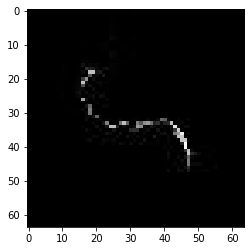

confidence for 10346 is 0.8762719


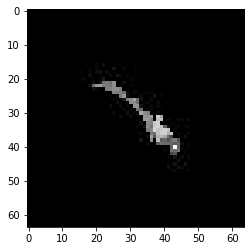

confidence for 10353 is 0.96991843


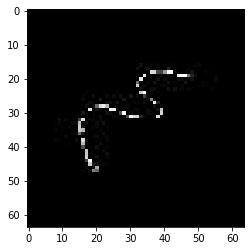

confidence for 10371 is 0.99799836


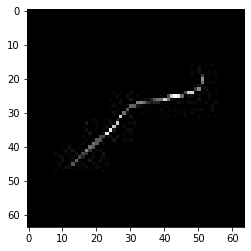

confidence for 10384 is 0.9304369


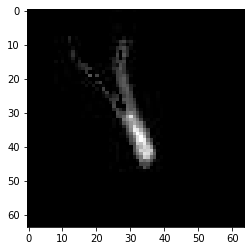

confidence for 10420 is 0.99849695


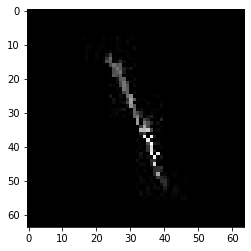

confidence for 10422 is 0.8544307


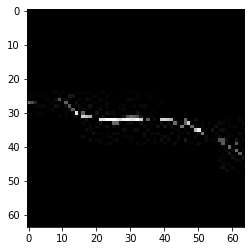

confidence for 10425 is 1.0


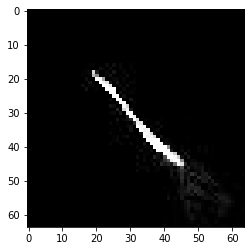

confidence for 10430 is 0.99962485


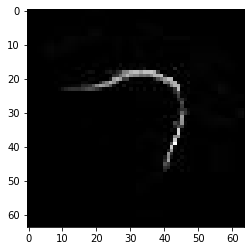

confidence for 10441 is 0.99429065


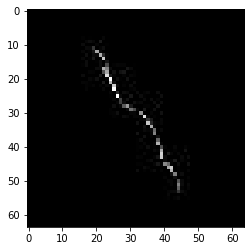

confidence for 10462 is 0.9978088


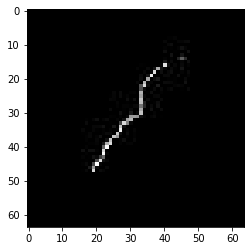

confidence for 10469 is 0.827868


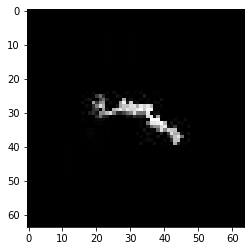

confidence for 10475 is 0.782107


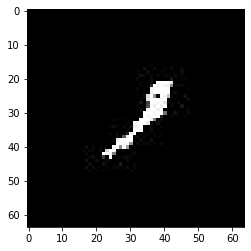

confidence for 10485 is 0.8604039


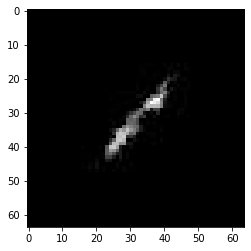

confidence for 10490 is 0.99891895


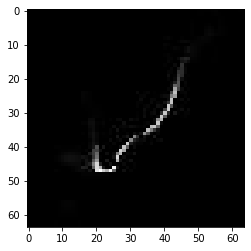

confidence for 10520 is 0.97457767


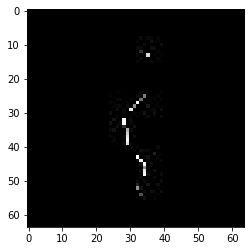

confidence for 10522 is 0.91078806


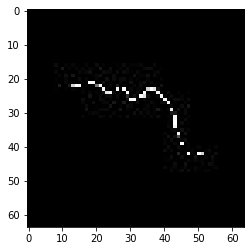

confidence for 10524 is 0.9200147


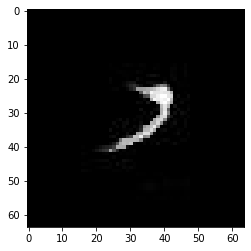

confidence for 10527 is 0.7718205


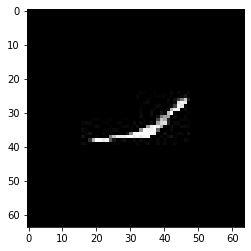

confidence for 10535 is 0.9859421


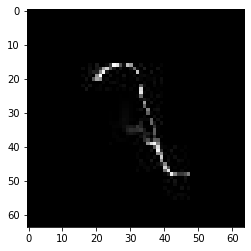

confidence for 10545 is 0.9997334


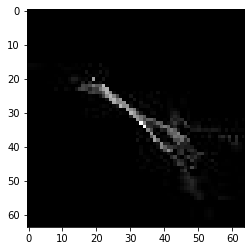

confidence for 10552 is 0.9784897


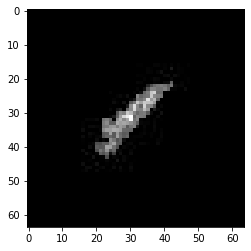

confidence for 10573 is 0.9907616


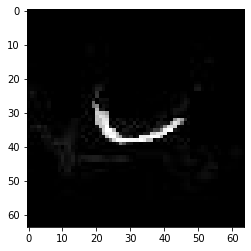

confidence for 10594 is 0.83074147


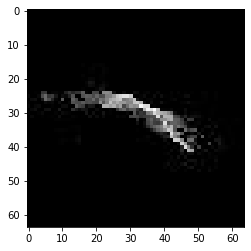

confidence for 10642 is 0.9999995


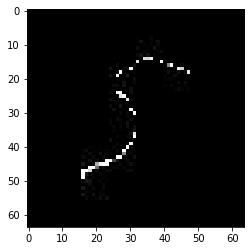

confidence for 10649 is 0.9968215


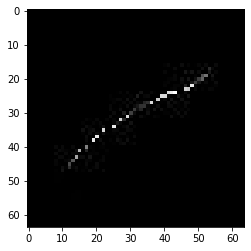

confidence for 10657 is 0.8177036


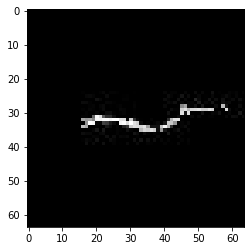

confidence for 10680 is 0.9968901


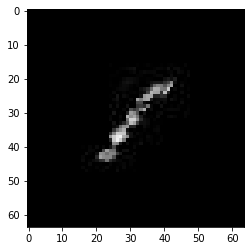

confidence for 10716 is 0.9935198


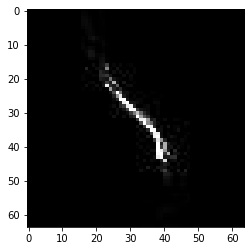

confidence for 10723 is 0.80671823


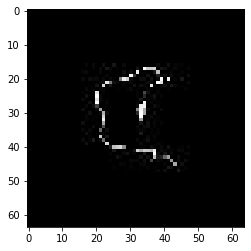

confidence for 10724 is 0.98840505


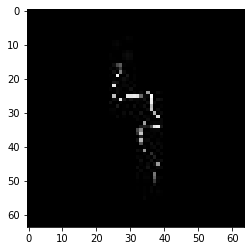

confidence for 10726 is 0.847031


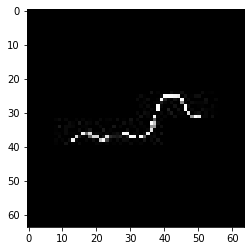

confidence for 10732 is 0.9449922


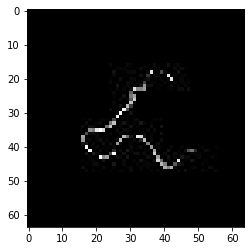

confidence for 10741 is 0.81679577


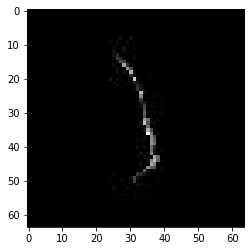

confidence for 10742 is 0.99057734


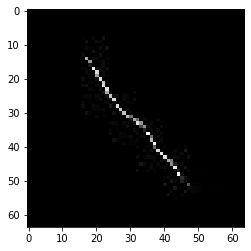

confidence for 10765 is 0.90778977


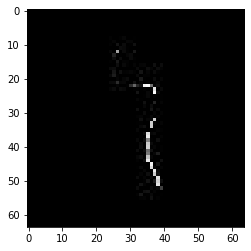

confidence for 10777 is 0.9909046


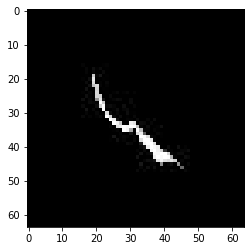

confidence for 10780 is 0.9772666


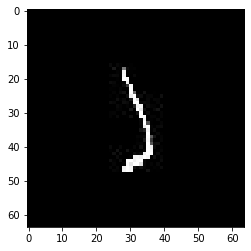

confidence for 10782 is 0.99884725


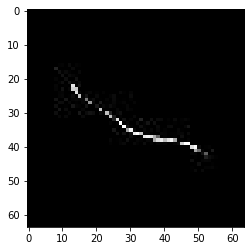

confidence for 10789 is 0.9761771


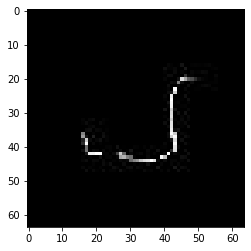

confidence for 10794 is 0.9280077


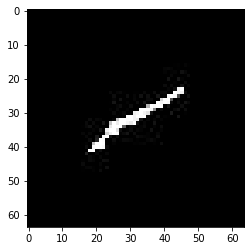

confidence for 10809 is 0.95607626


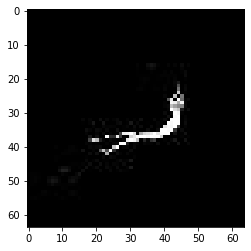

confidence for 10811 is 0.9999819


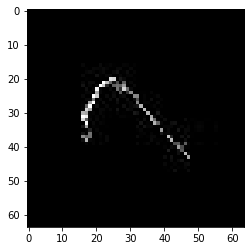

confidence for 10817 is 0.9502883


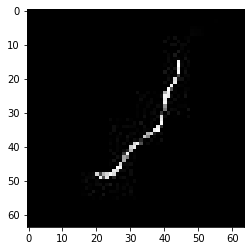

confidence for 10820 is 0.95192206


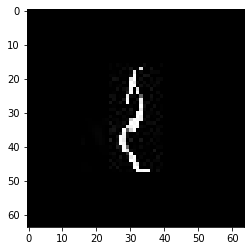

confidence for 10823 is 0.98488146


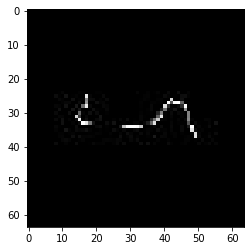

confidence for 10827 is 0.999116


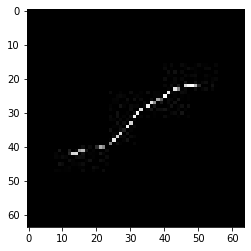

confidence for 10840 is 0.9999914


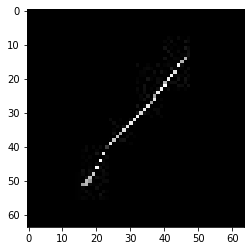

confidence for 10846 is 0.86845666


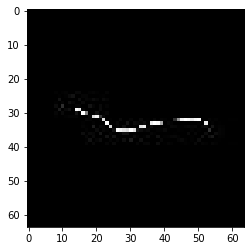

confidence for 10849 is 0.9862423


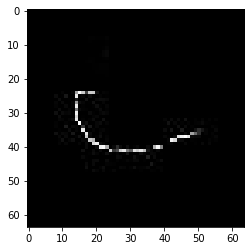

confidence for 10867 is 0.973011


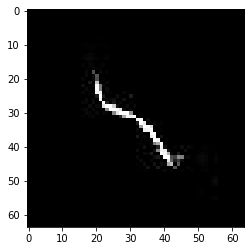

confidence for 10886 is 0.99675184


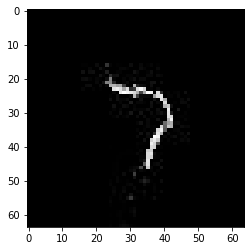

confidence for 10898 is 0.9999995


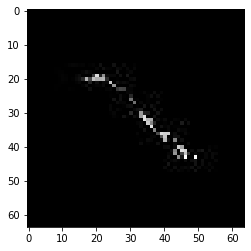

confidence for 10907 is 0.99684846


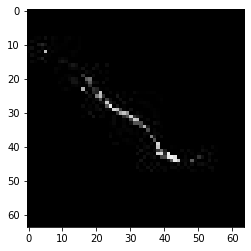

confidence for 10929 is 0.75866216


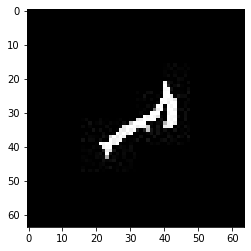

confidence for 10943 is 0.9219504


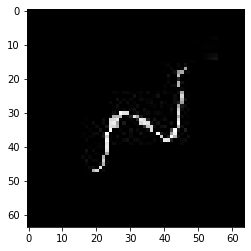

confidence for 10945 is 0.92602056


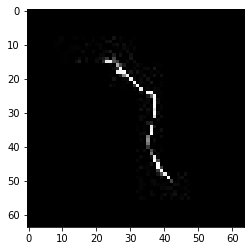

confidence for 10964 is 0.94298744


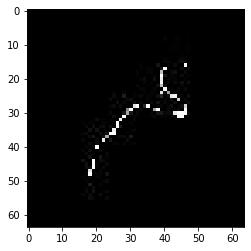

confidence for 10992 is 0.99847996


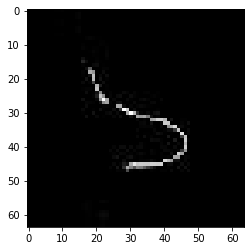

confidence for 11013 is 0.998864


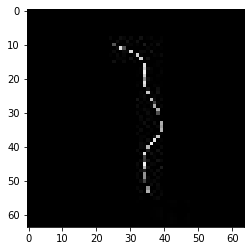

confidence for 11041 is 0.9733531


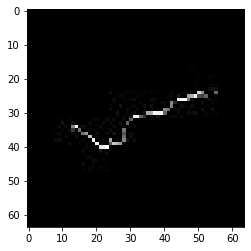

confidence for 11042 is 0.96130365


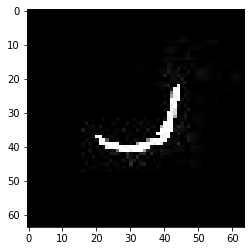

confidence for 11048 is 0.9282506


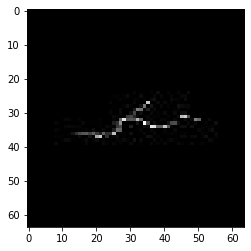

confidence for 11065 is 0.9992068


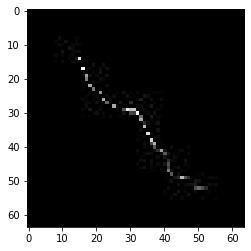

confidence for 11074 is 0.9970907


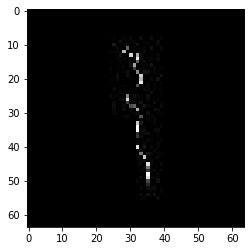

confidence for 11096 is 0.9890091


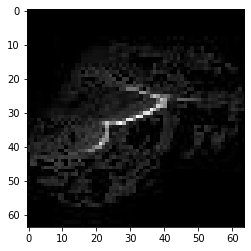

confidence for 11103 is 0.9999102


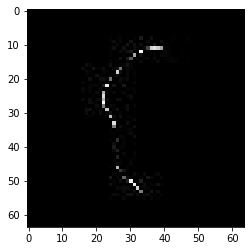

confidence for 11108 is 0.8355027


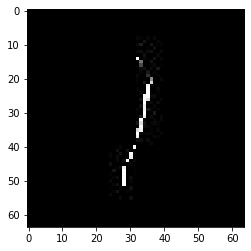

confidence for 11112 is 0.898852


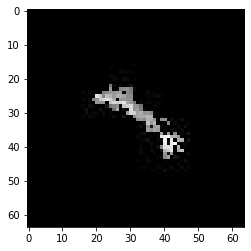

confidence for 11142 is 0.9196838


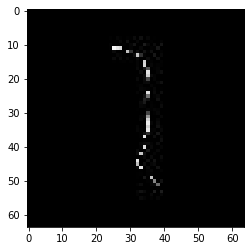

confidence for 11150 is 0.9874813


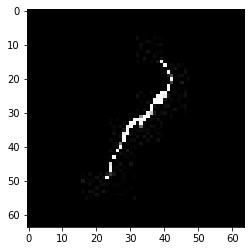

confidence for 11159 is 0.9294953


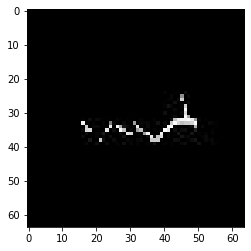

confidence for 11169 is 0.9999865


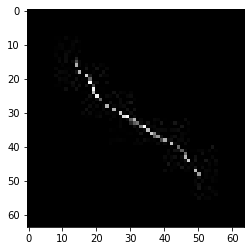

confidence for 11173 is 0.9210705


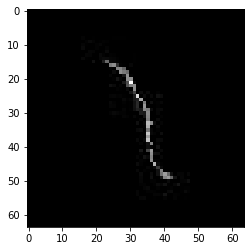

confidence for 11232 is 0.7086619


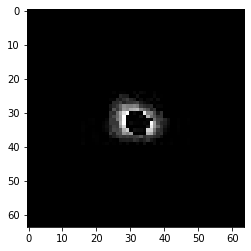

confidence for 11276 is 0.7769448


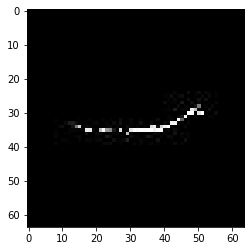

confidence for 11287 is 0.9958456


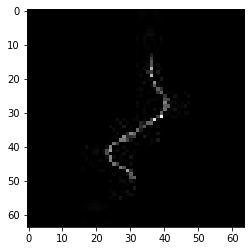

confidence for 11289 is 0.98259777


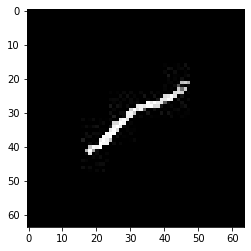

confidence for 11316 is 0.9384269


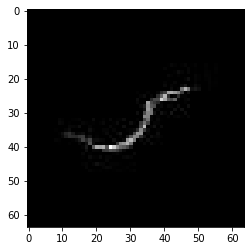

confidence for 11320 is 0.9945388


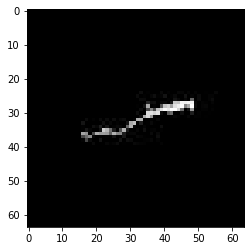

confidence for 11339 is 0.99999464


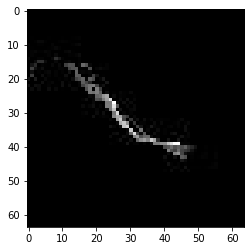

confidence for 11352 is 0.98910797


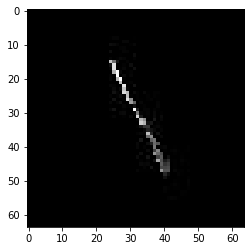

confidence for 11374 is 0.99982154


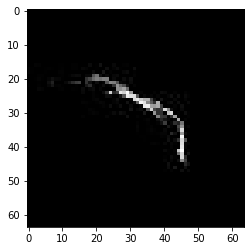

confidence for 11415 is 0.9487208


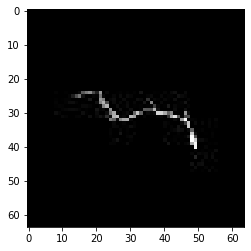

confidence for 11446 is 0.83383256


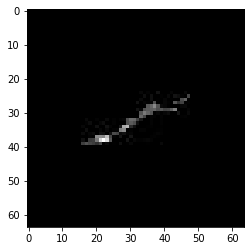

confidence for 11458 is 0.79993004


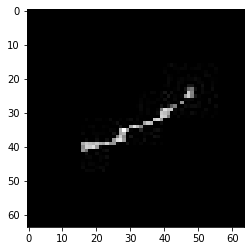

confidence for 11467 is 0.9987468


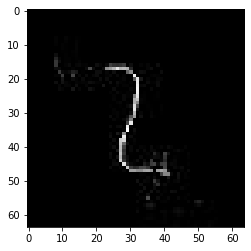

confidence for 11490 is 0.874247


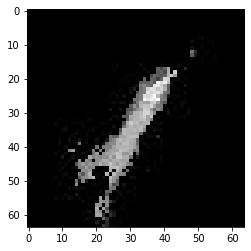

confidence for 11522 is 1.0


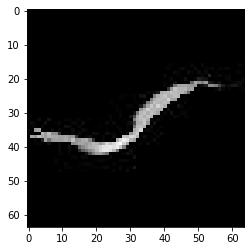

confidence for 11535 is 0.8831703


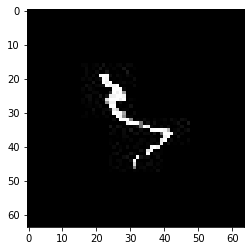

confidence for 11542 is 0.99988675


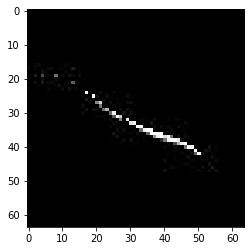

confidence for 11547 is 0.88401455


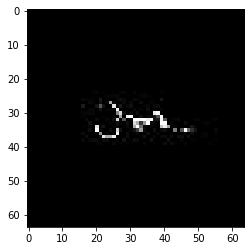

confidence for 11559 is 0.981035


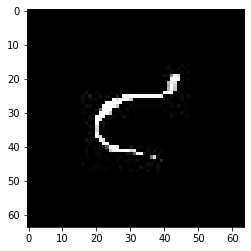

confidence for 11599 is 0.9999931


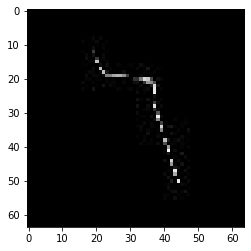

confidence for 11602 is 0.70958287


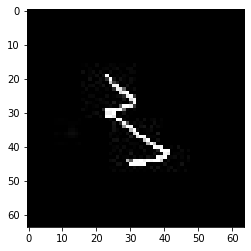

confidence for 11625 is 0.9944543


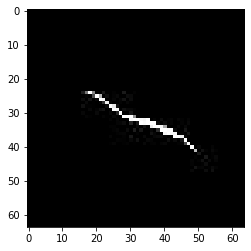

confidence for 11637 is 0.9990075


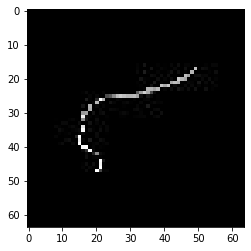

confidence for 11638 is 0.9485829


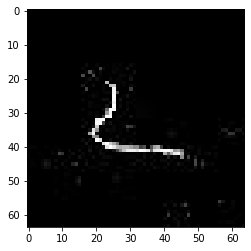

confidence for 11675 is 0.9995261


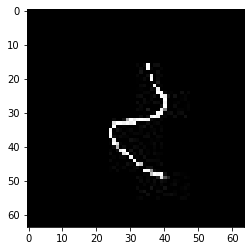

confidence for 11715 is 0.99993134


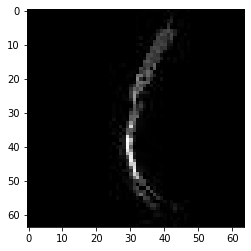

confidence for 11737 is 0.95368385


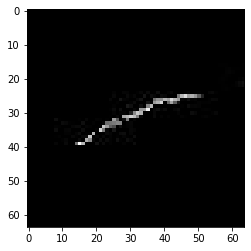

confidence for 11741 is 0.9830192


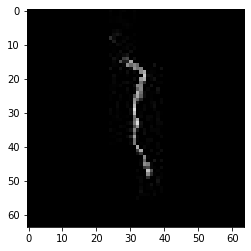

confidence for 11743 is 0.7846478


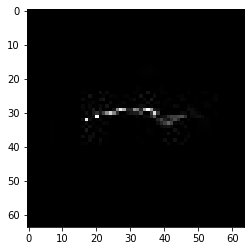

confidence for 11744 is 0.98071617


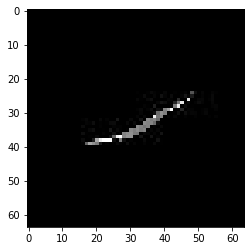

confidence for 11752 is 0.9999973


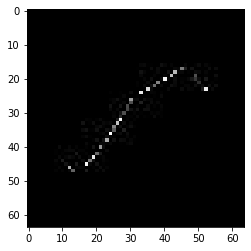

confidence for 11753 is 0.9370999


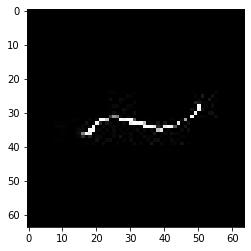

confidence for 11774 is 0.97934014


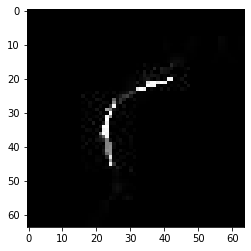

confidence for 11799 is 0.9987851


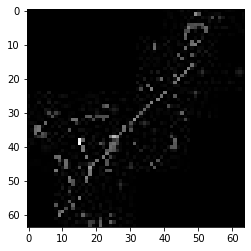

confidence for 11814 is 0.9399786


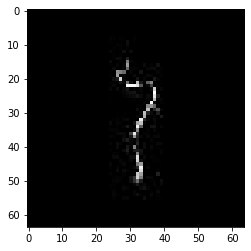

confidence for 11823 is 0.9993233


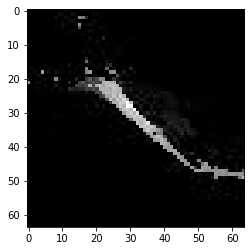

confidence for 11836 is 0.89505064


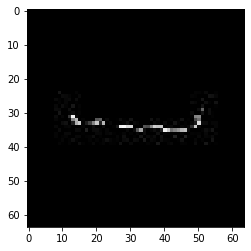

confidence for 11846 is 0.9386601


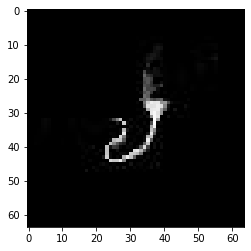

confidence for 11856 is 0.99397737


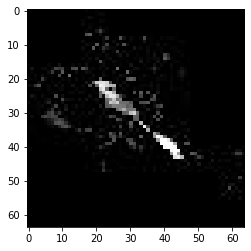

confidence for 11911 is 0.9962149


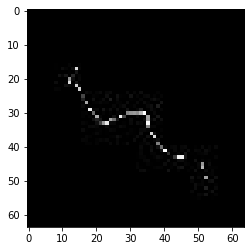

confidence for 11943 is 0.78816056


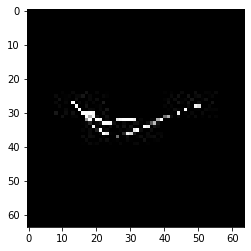

confidence for 11948 is 0.9999999


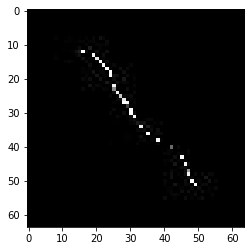

confidence for 11950 is 0.98018324


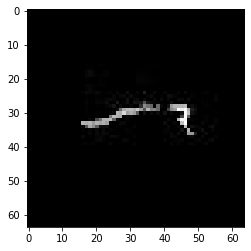

confidence for 11975 is 0.99930024


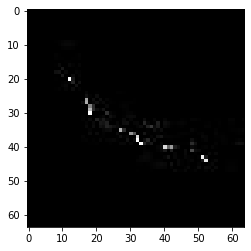

confidence for 11980 is 0.9903001


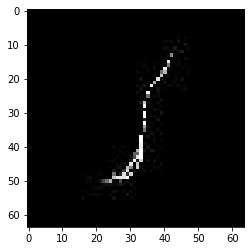

confidence for 11988 is 0.9978139


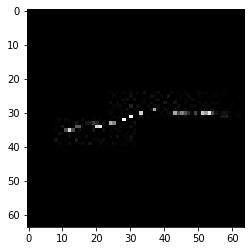

confidence for 11998 is 0.95274144


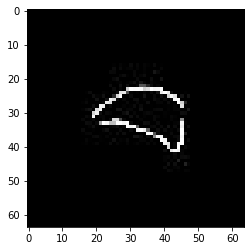

confidence for 12021 is 0.99859256


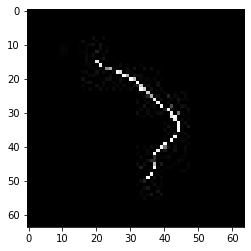

confidence for 12032 is 0.8200456


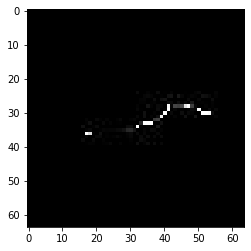

confidence for 12036 is 0.9976556


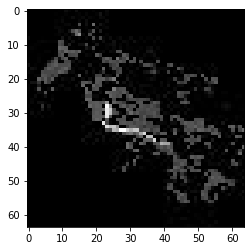

confidence for 12041 is 0.9967632


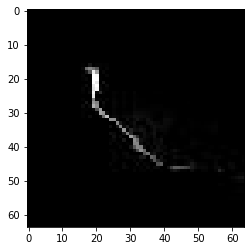

confidence for 12053 is 0.99998885


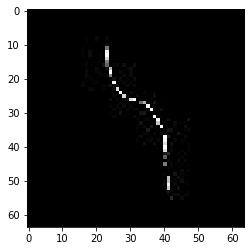

confidence for 12057 is 0.9973605


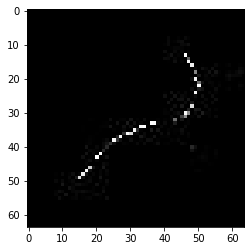

confidence for 12058 is 0.70129377


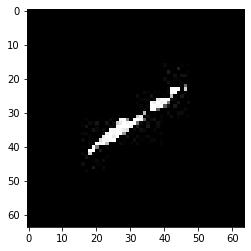

confidence for 12059 is 0.8647554


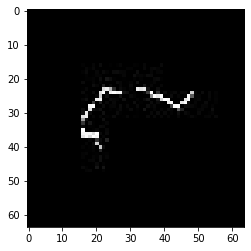

confidence for 12068 is 0.98743343


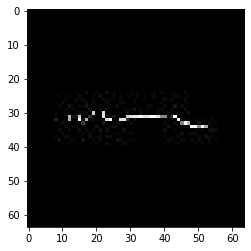

confidence for 12082 is 0.8989142


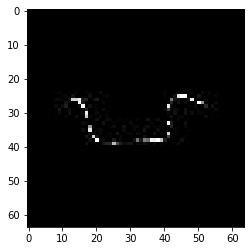

confidence for 12092 is 0.99994195


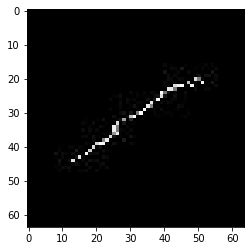

confidence for 12095 is 0.78289926


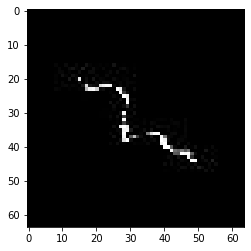

confidence for 12101 is 0.9999998


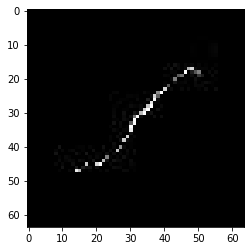

confidence for 12116 is 0.91038007


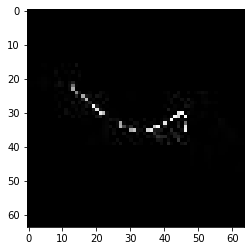

confidence for 12117 is 0.9991442


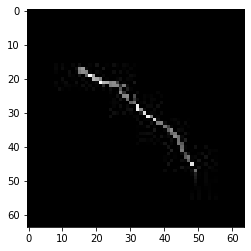

confidence for 12120 is 0.9685678


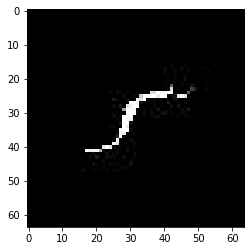

confidence for 12123 is 0.99901026


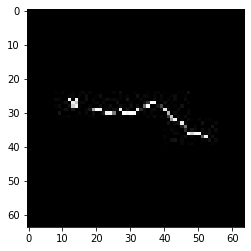

confidence for 12130 is 0.99948347


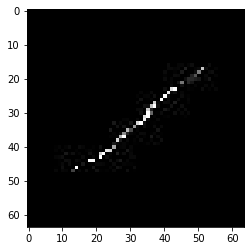

confidence for 12133 is 0.9984368


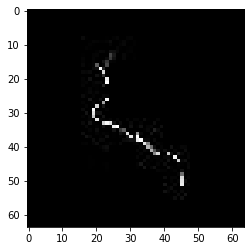

confidence for 12165 is 0.99997765


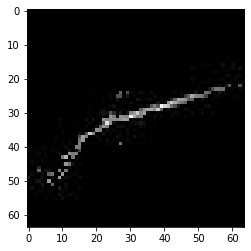

confidence for 12169 is 0.88610286


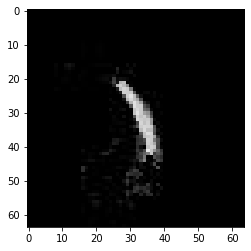

confidence for 12194 is 0.9974097


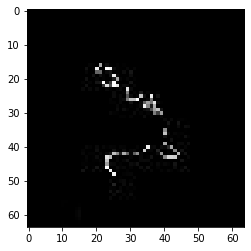

confidence for 12204 is 0.99728084


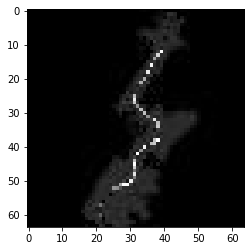

confidence for 12207 is 0.9271529


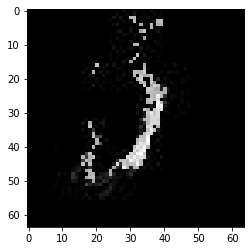

confidence for 12234 is 0.99889654


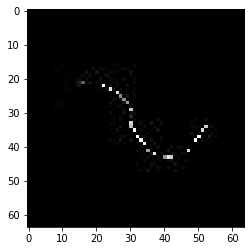

confidence for 12237 is 0.99976015


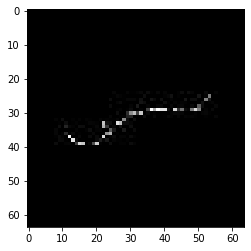

confidence for 12256 is 0.9801358


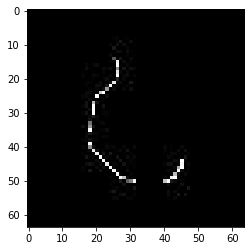

confidence for 12257 is 0.7591056


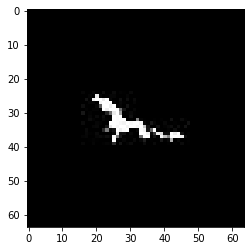

confidence for 12258 is 0.8671822


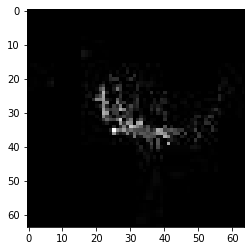

confidence for 12261 is 0.9714553


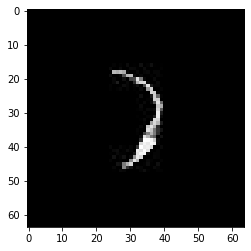

confidence for 12273 is 0.7380067


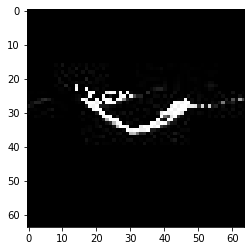

confidence for 12278 is 0.9831538


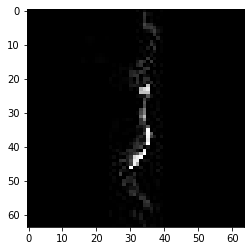

confidence for 12295 is 0.9999377


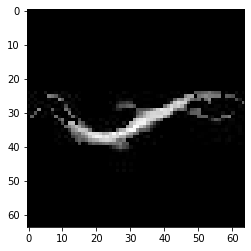

confidence for 12310 is 0.9999161


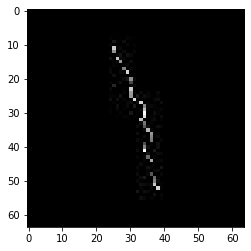

confidence for 12322 is 0.98889464


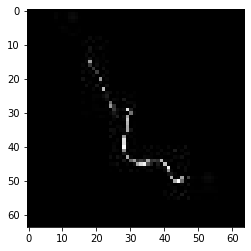

confidence for 12332 is 0.91095525


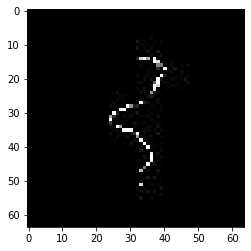

confidence for 12340 is 0.8658236


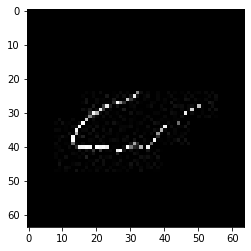

confidence for 12346 is 0.99911255


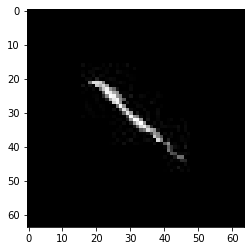

confidence for 12410 is 0.98534817


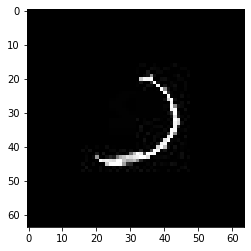

confidence for 12418 is 0.9443756


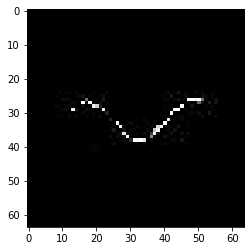

confidence for 12422 is 0.99159855


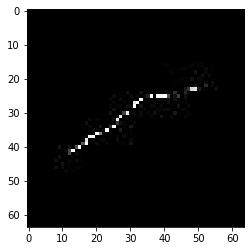

confidence for 12424 is 0.9999364


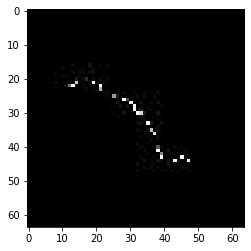

confidence for 12427 is 0.9993672


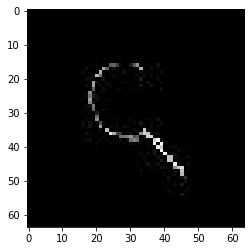

confidence for 12449 is 0.99995744


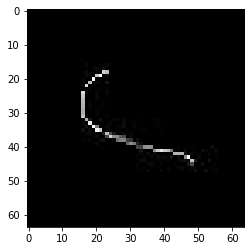

confidence for 12465 is 0.99283916


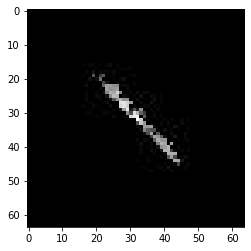

confidence for 12477 is 0.9945832


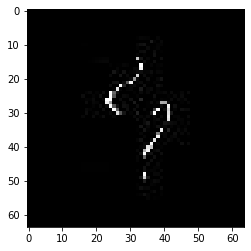

confidence for 12481 is 0.9857009


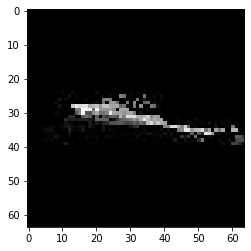

confidence for 12486 is 0.7482629


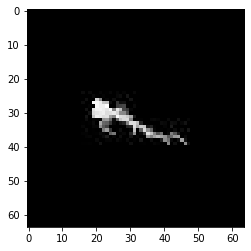

confidence for 12493 is 0.904699


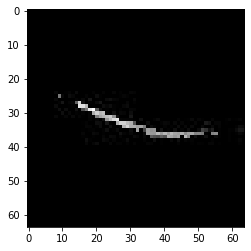

confidence for 12504 is 0.9768937


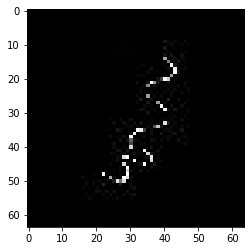

confidence for 12512 is 0.9709


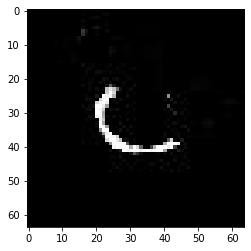

confidence for 12514 is 0.7551544


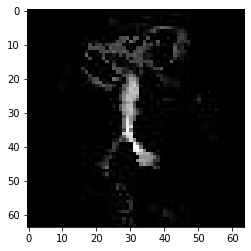

confidence for 12519 is 0.9998697


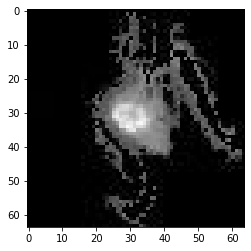

confidence for 12580 is 0.9460238


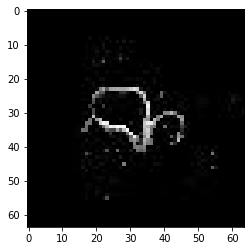

confidence for 12594 is 0.839072


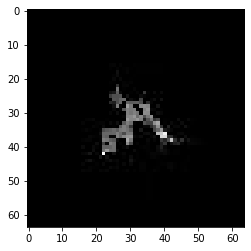

confidence for 12595 is 0.99999744


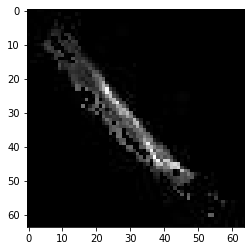

confidence for 12673 is 0.98622024


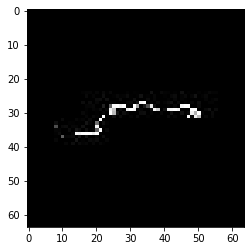

confidence for 12678 is 0.94061327


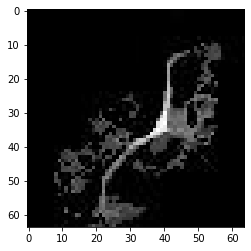

confidence for 12745 is 0.9254853


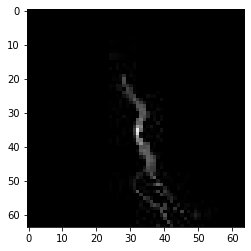

confidence for 12763 is 0.8269658


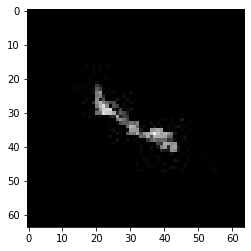

confidence for 12764 is 0.7355474


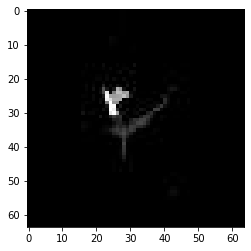

confidence for 12772 is 0.99809325


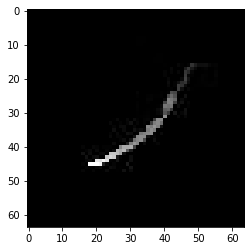

confidence for 12788 is 0.9010056


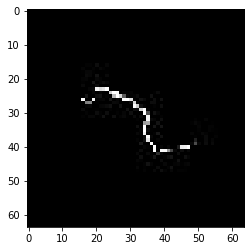

confidence for 12789 is 0.99328786


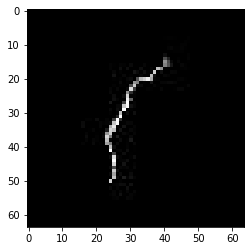

confidence for 12797 is 0.9977847


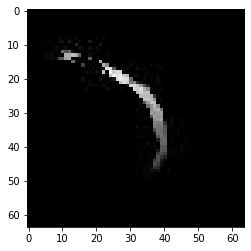

confidence for 12812 is 0.97103435


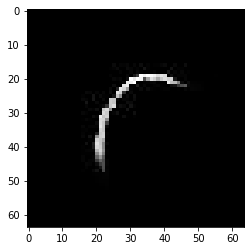

confidence for 12815 is 0.99741334


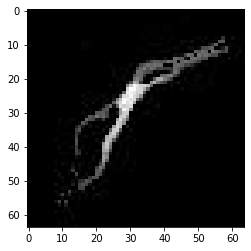

confidence for 12850 is 0.7934401


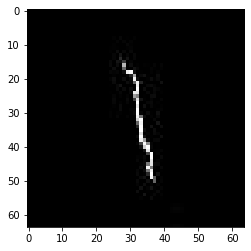

confidence for 12852 is 0.99956733


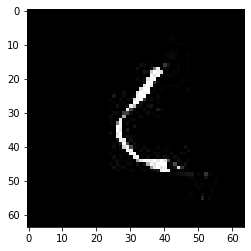

confidence for 12858 is 0.9538626


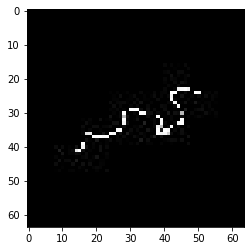

confidence for 12859 is 0.98658323


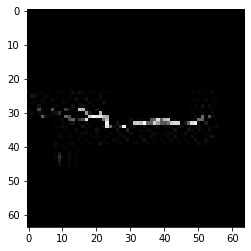

confidence for 12870 is 0.9973127


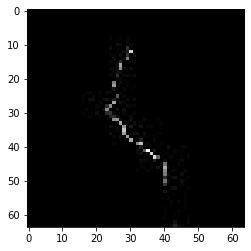

confidence for 12879 is 0.9996305


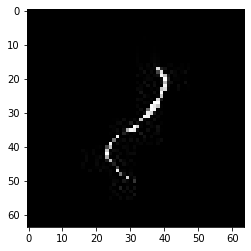

confidence for 12881 is 0.9811586


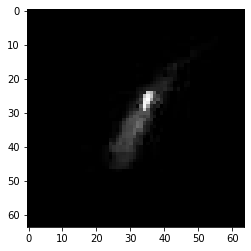

confidence for 12895 is 0.9814759


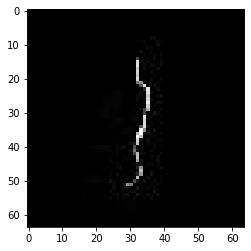

confidence for 12898 is 0.9803067


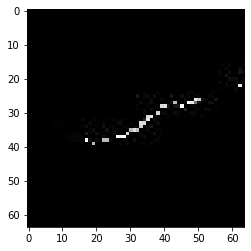

confidence for 12900 is 0.99168235


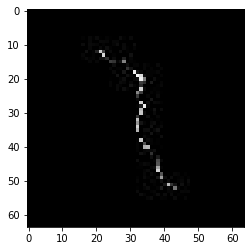

confidence for 12910 is 0.86510324


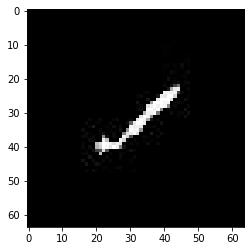

confidence for 12928 is 0.995631


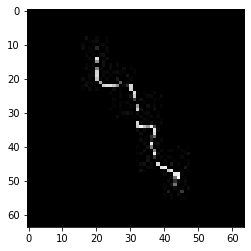

confidence for 12938 is 0.99949515


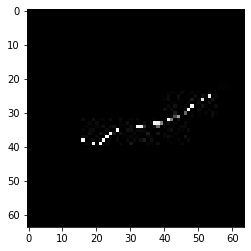

confidence for 12940 is 0.8824757


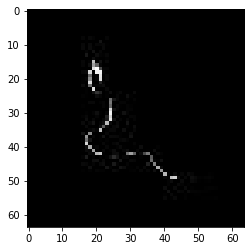

confidence for 12946 is 0.9856378


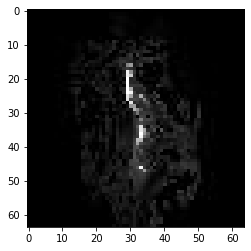

confidence for 12974 is 0.9983581


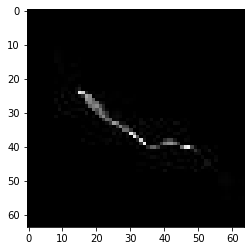

confidence for 12975 is 0.93062985


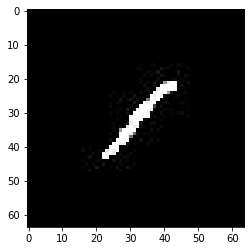

confidence for 12994 is 0.99755716


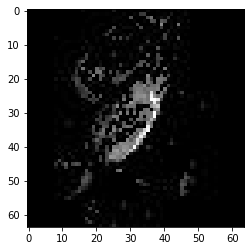

confidence for 13006 is 0.9987303


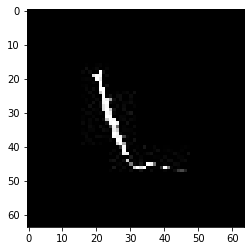

confidence for 13008 is 0.9982062


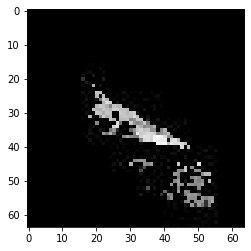

confidence for 13025 is 0.99931103


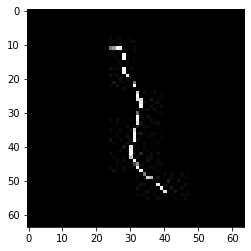

confidence for 13036 is 0.9970841


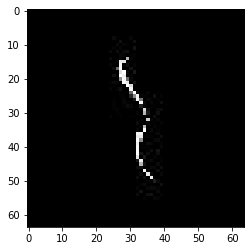

confidence for 13046 is 0.866202


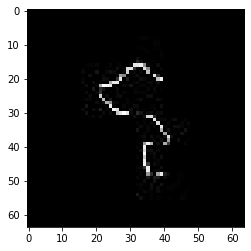

confidence for 13050 is 0.99981755


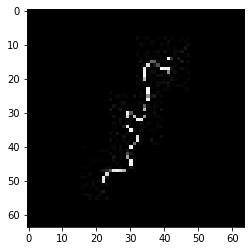

confidence for 13058 is 0.999024


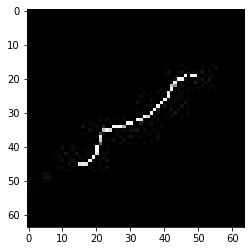

confidence for 13060 is 0.9641098


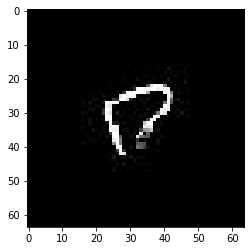

confidence for 13063 is 0.9583089


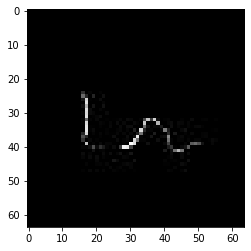

confidence for 13064 is 0.95679766


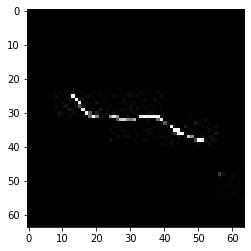

confidence for 13085 is 0.9824211


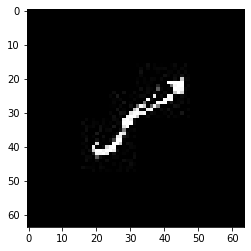

confidence for 13100 is 0.9920658


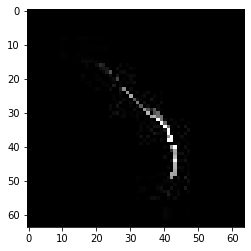

confidence for 13122 is 0.97264904


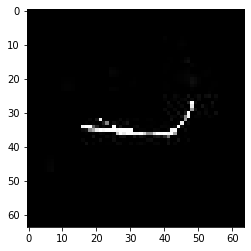

confidence for 13124 is 0.95518535


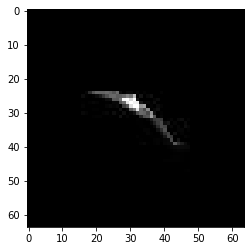

confidence for 13127 is 0.99749297


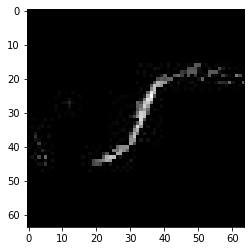

confidence for 13129 is 0.97556293


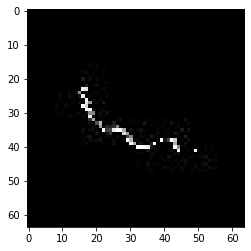

confidence for 13133 is 0.9960358


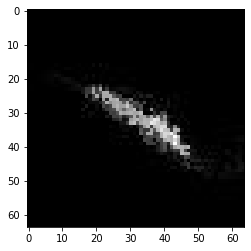

confidence for 13136 is 0.89898694


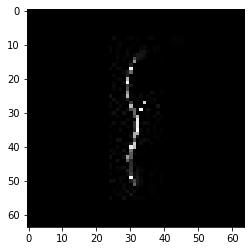

confidence for 13153 is 0.9979295


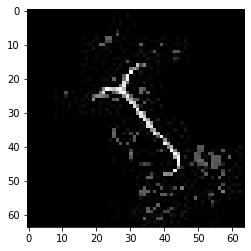

confidence for 13176 is 0.8391788


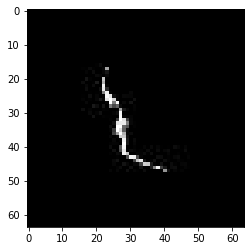

confidence for 13205 is 0.99508995


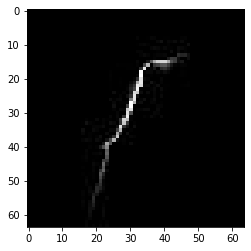

confidence for 13207 is 0.99706244


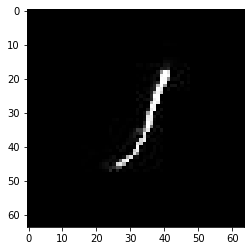

confidence for 13211 is 0.99999845


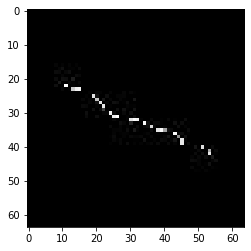

confidence for 13214 is 0.7865877


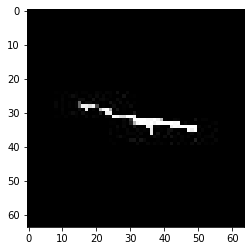

confidence for 13218 is 0.98657906


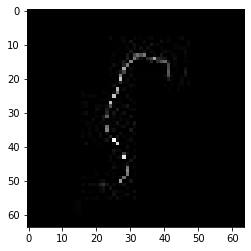

confidence for 13220 is 0.96736425


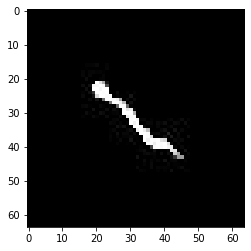

confidence for 13221 is 0.97562015


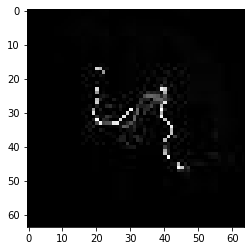

confidence for 13228 is 0.9998824


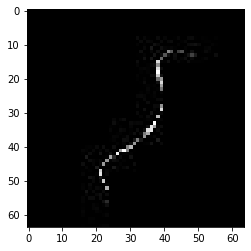

confidence for 13237 is 0.98267287


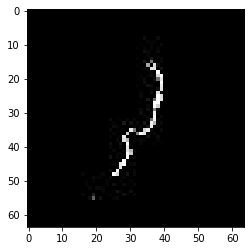

confidence for 13240 is 0.90137875


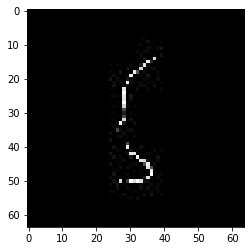

confidence for 13244 is 0.9948071


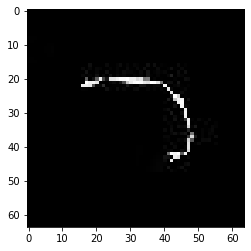

confidence for 13247 is 0.998812


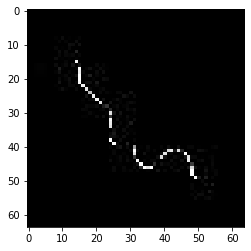

confidence for 13251 is 0.9549543


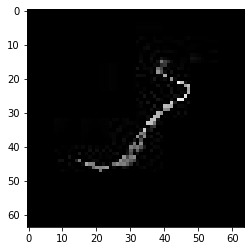

confidence for 13255 is 0.997927


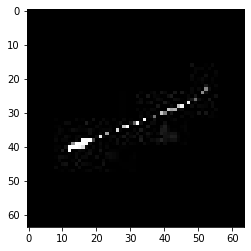

confidence for 13294 is 0.99782556


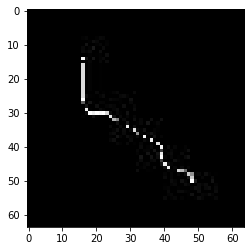

confidence for 13305 is 0.8942634


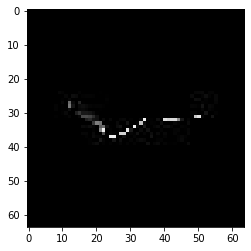

confidence for 13307 is 0.79152507


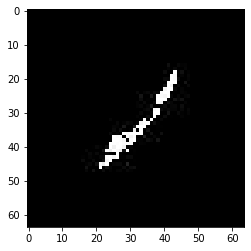

confidence for 13308 is 0.95923775


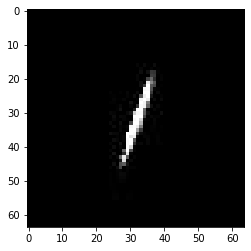

confidence for 13313 is 0.9972533


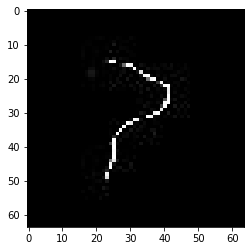

confidence for 13317 is 0.72693425


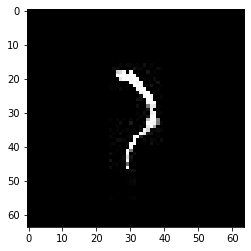

confidence for 13334 is 0.9990227


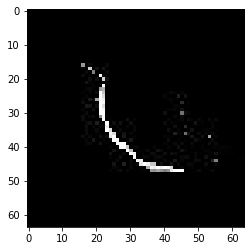

confidence for 13370 is 0.8974325


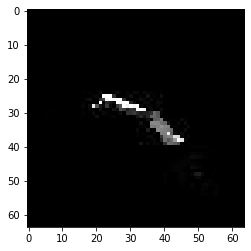

confidence for 13374 is 0.92829996


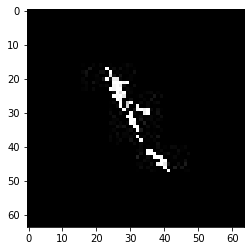

confidence for 13380 is 0.99995166


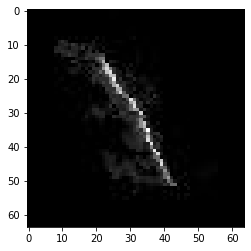

confidence for 13384 is 0.9999962


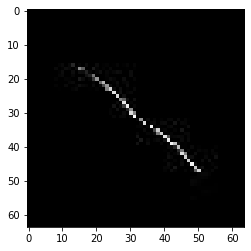

confidence for 13394 is 0.9574161


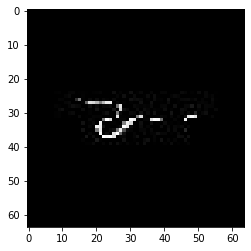

confidence for 13398 is 0.94441956


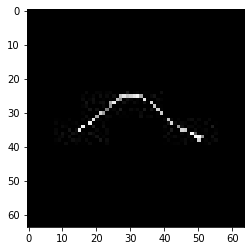

confidence for 13416 is 0.997678


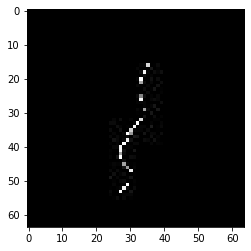

confidence for 13420 is 0.9997865


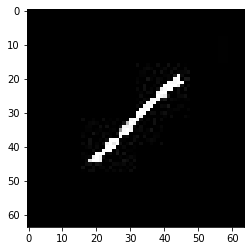

confidence for 13433 is 0.9999058


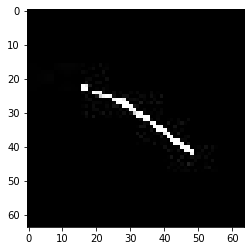

confidence for 13446 is 0.99999505


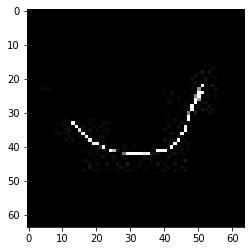

confidence for 13449 is 0.8977148


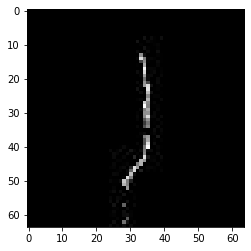

confidence for 13465 is 0.88227916


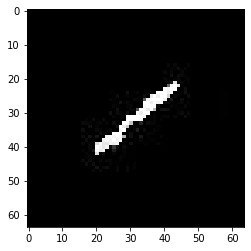

confidence for 13467 is 0.9961185


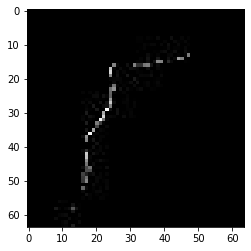

confidence for 13471 is 0.8508632


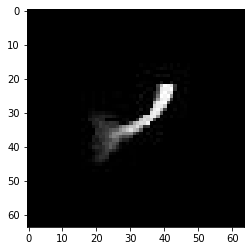

confidence for 13502 is 0.76057184


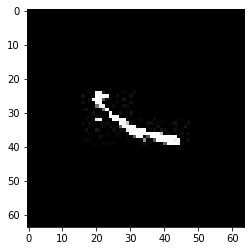

confidence for 13503 is 0.999183


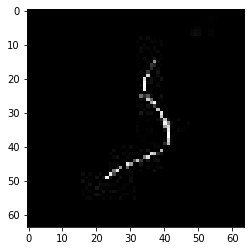

confidence for 13530 is 0.99760336


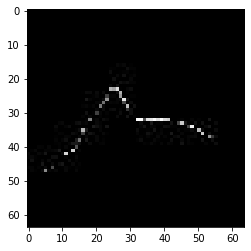

confidence for 13545 is 0.9949515


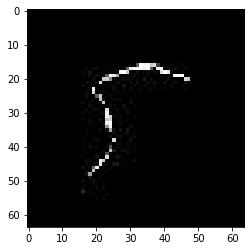

confidence for 13554 is 0.99999994


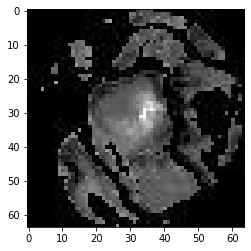

confidence for 13556 is 0.96892035


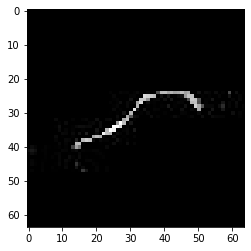

confidence for 13563 is 0.9562762


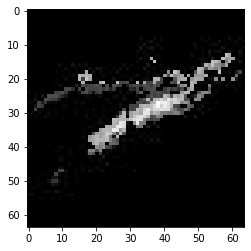

confidence for 13580 is 0.9562699


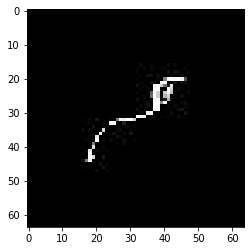

confidence for 13601 is 0.915405


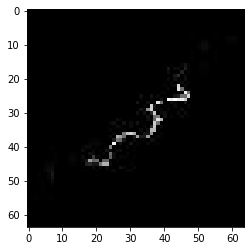

confidence for 13627 is 0.9999541


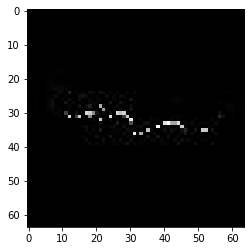

confidence for 13642 is 0.99973446


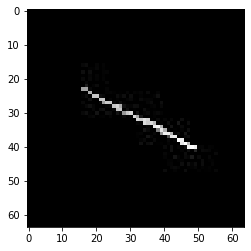

confidence for 13676 is 0.99634


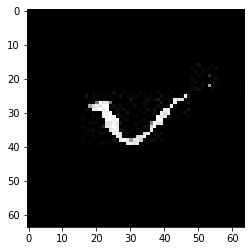

confidence for 13685 is 0.99954385


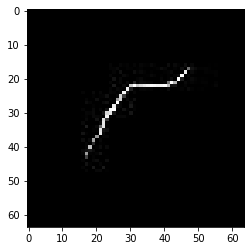

confidence for 13695 is 0.99025124


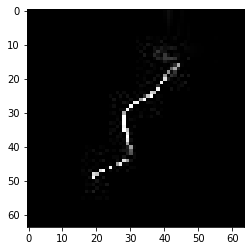

confidence for 13735 is 0.9684807


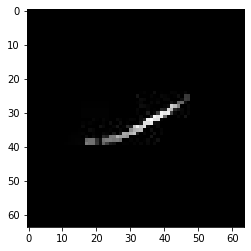

confidence for 13743 is 0.9953377


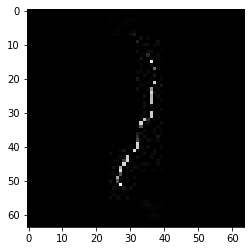

confidence for 13749 is 0.95801497


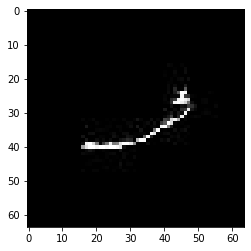

confidence for 13753 is 0.94475466


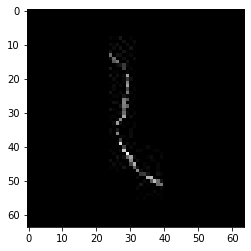

confidence for 13754 is 0.99935126


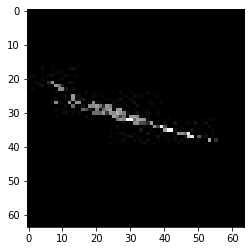

confidence for 13761 is 0.70543975


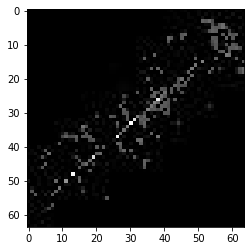

confidence for 13772 is 0.9984335


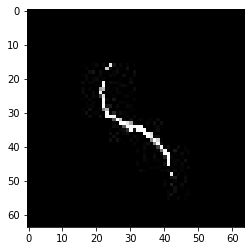

confidence for 13773 is 0.9956018


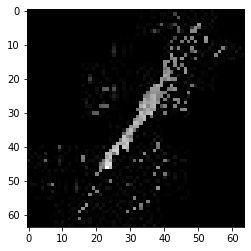

confidence for 13781 is 0.98147607


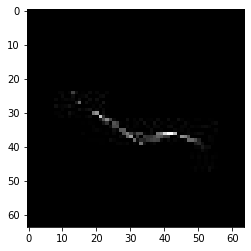

confidence for 13801 is 0.9144629


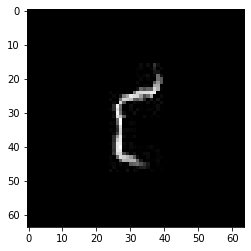

confidence for 13804 is 0.9998107


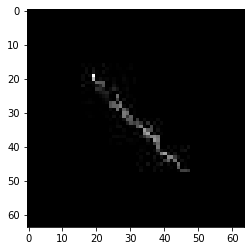

confidence for 13809 is 0.9645229


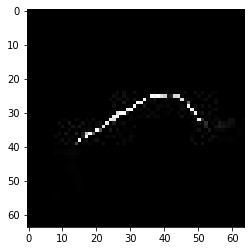

confidence for 13810 is 0.9618586


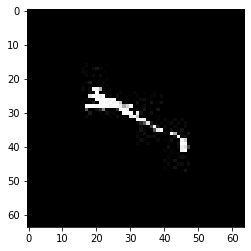

confidence for 13814 is 0.8132121


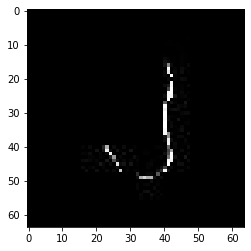

confidence for 13836 is 0.8704103


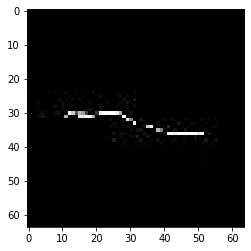

confidence for 13837 is 0.9899884


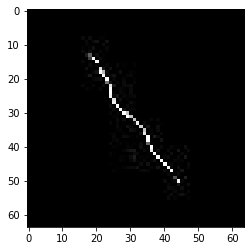

confidence for 13838 is 0.99902


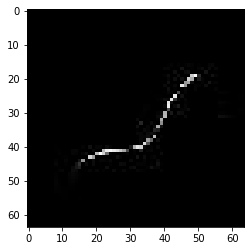

confidence for 13847 is 0.9803026


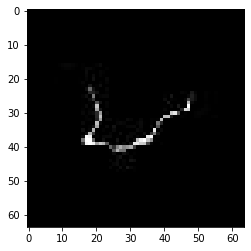

confidence for 13848 is 0.8435545


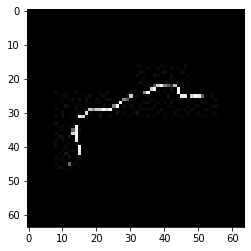

confidence for 13851 is 0.98078805


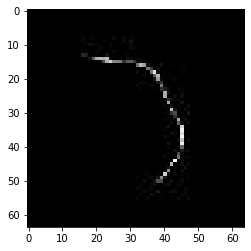

confidence for 13855 is 0.9969912


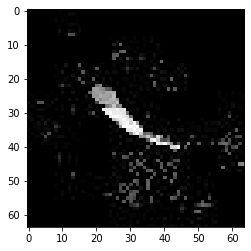

confidence for 13861 is 0.96124744


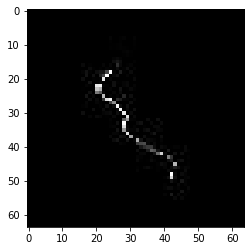

confidence for 13874 is 0.998726


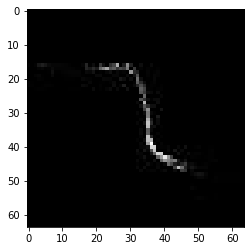

confidence for 13883 is 0.96579707


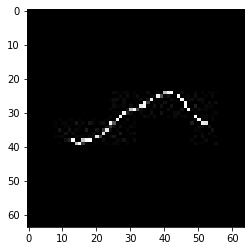

confidence for 13895 is 0.999724


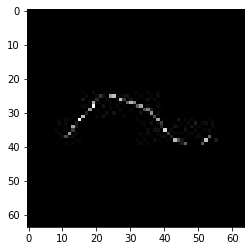

confidence for 13920 is 0.94035184


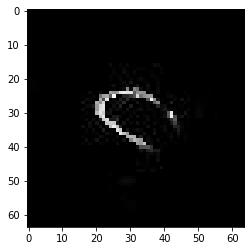

confidence for 13957 is 0.9999974


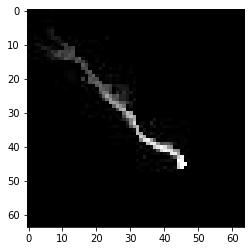

confidence for 13960 is 0.9336979


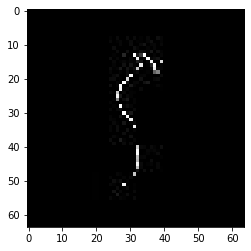

confidence for 13985 is 0.99837077


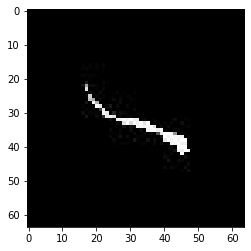

confidence for 14012 is 0.74098474


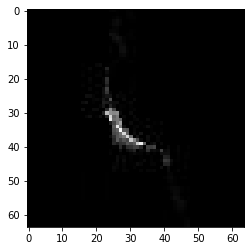

confidence for 14027 is 0.94763094


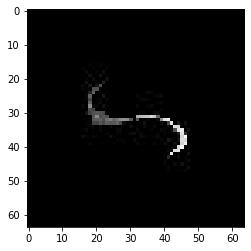

confidence for 14029 is 0.9422558


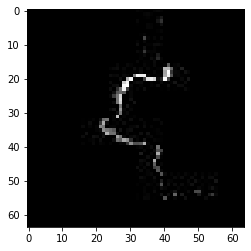

confidence for 14042 is 0.9957842


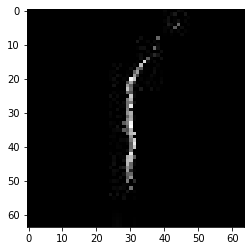

confidence for 14043 is 0.8359697


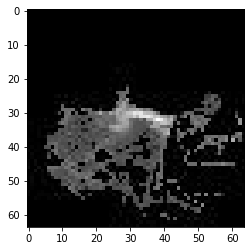

confidence for 14046 is 0.9973108


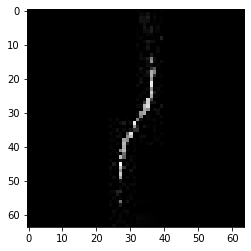

confidence for 14064 is 0.71817684


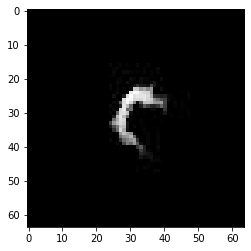

confidence for 14068 is 0.801197


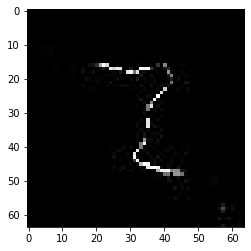

confidence for 14074 is 0.9810064


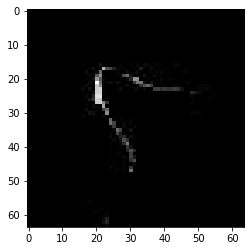

confidence for 14091 is 0.8913517


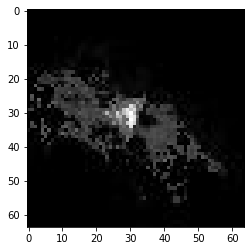

confidence for 14092 is 0.99177796


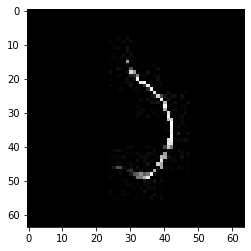

confidence for 14111 is 0.77559006


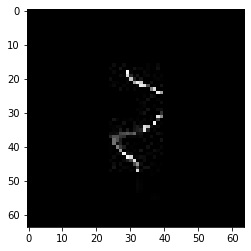

confidence for 14118 is 0.8878866


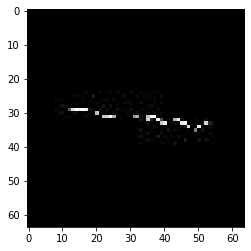

confidence for 14120 is 0.7694009


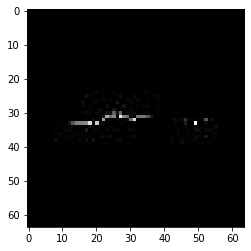

confidence for 14142 is 0.99081767


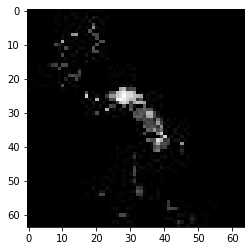

confidence for 14145 is 0.96020347


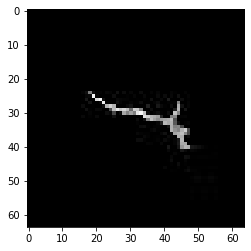

confidence for 14146 is 0.7804802


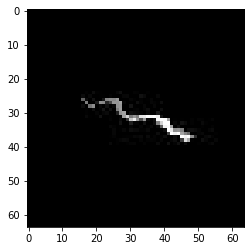

confidence for 14147 is 0.863584


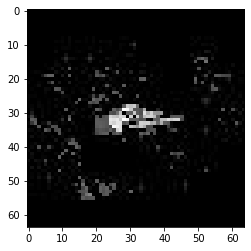

confidence for 14152 is 0.9773828


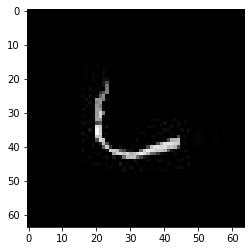

confidence for 14170 is 0.8157789


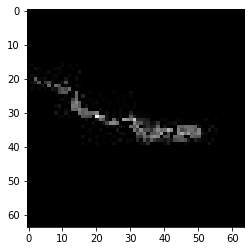

confidence for 14172 is 0.9987514


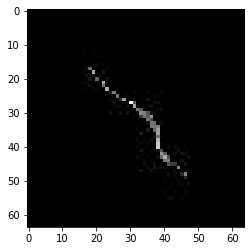

confidence for 14176 is 0.87133056


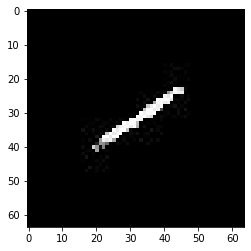

confidence for 14201 is 0.9983531


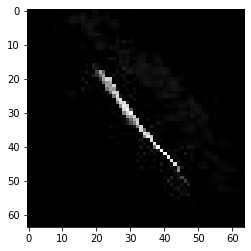

confidence for 14207 is 0.9985621


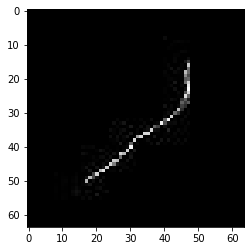

confidence for 14237 is 0.9999033


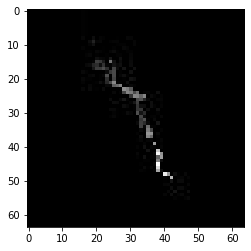

confidence for 14280 is 0.9949453


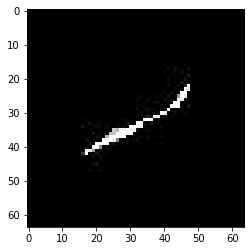

confidence for 14290 is 0.98509765


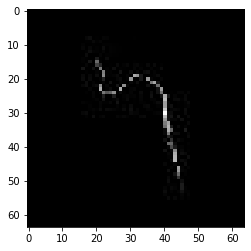

confidence for 14300 is 0.94499975


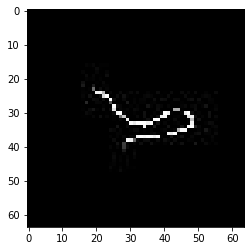

confidence for 14303 is 0.99973714


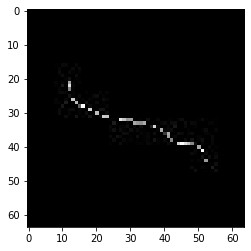

confidence for 14304 is 0.7948018


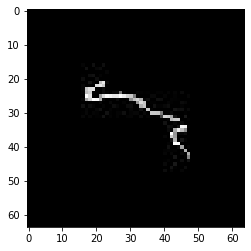

confidence for 14312 is 0.7996665


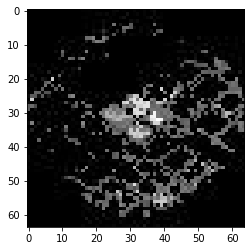

confidence for 14329 is 0.9916294


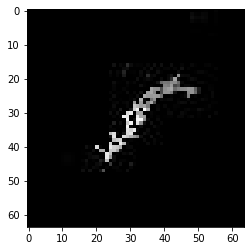

confidence for 14337 is 0.985224


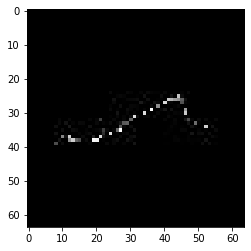

confidence for 14338 is 0.8768635


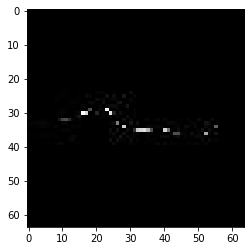

confidence for 14339 is 0.8743312


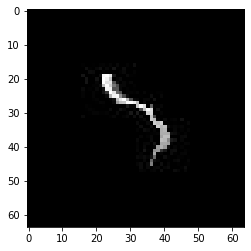

confidence for 14343 is 0.76649445


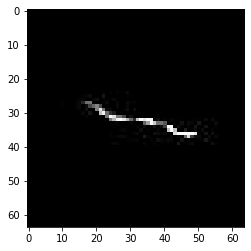

confidence for 14370 is 0.9858546


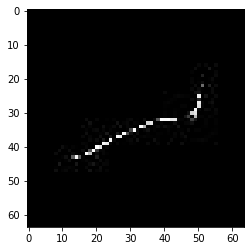

confidence for 14376 is 0.9851617


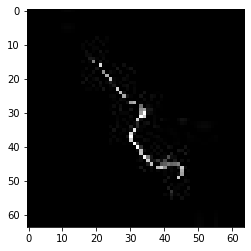

confidence for 14385 is 0.992416


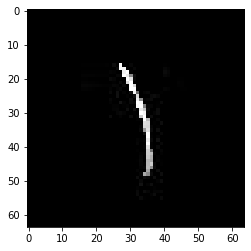

confidence for 14399 is 0.95287067


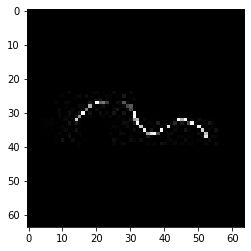

confidence for 14404 is 0.9814574


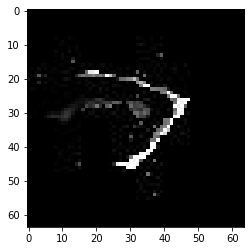

confidence for 14406 is 0.8644398


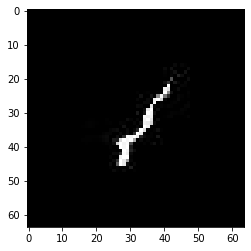

confidence for 14408 is 0.71985763


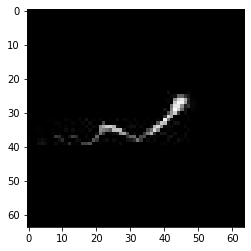

confidence for 14410 is 0.9897271


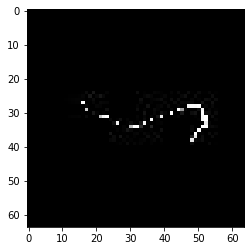

confidence for 14413 is 0.93153673


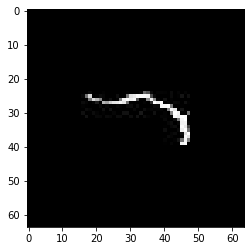

confidence for 14418 is 0.8737878


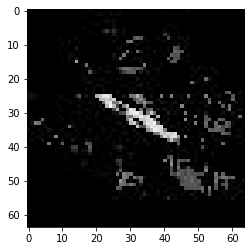

confidence for 14426 is 0.9754229


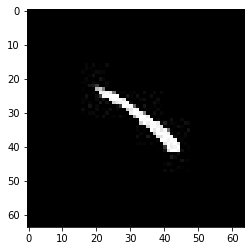

confidence for 14439 is 0.9999982


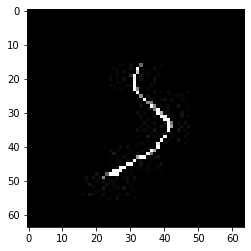

confidence for 14442 is 0.9921306


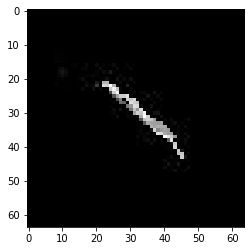

confidence for 14460 is 0.9998627


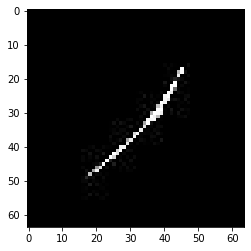

confidence for 14470 is 0.9994656


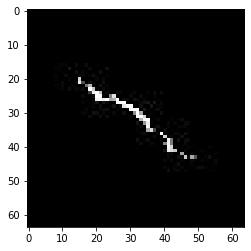

confidence for 14476 is 0.94988394


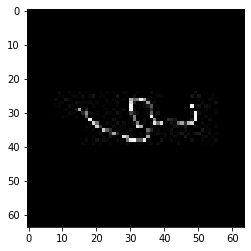

confidence for 14486 is 0.8918586


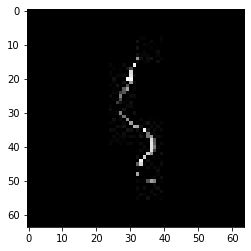

confidence for 14492 is 0.96624434


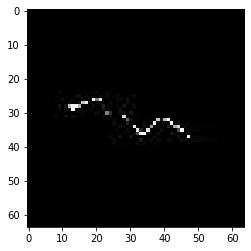

confidence for 14494 is 0.8220132


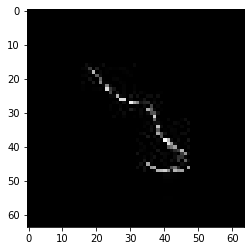

confidence for 14495 is 0.90448856


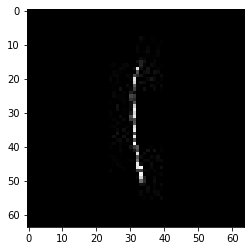

confidence for 14500 is 0.9999545


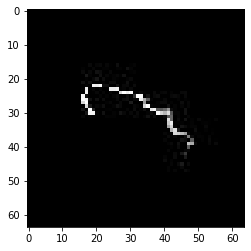

confidence for 14504 is 0.7100358


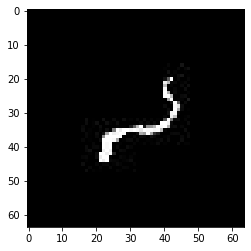

confidence for 14513 is 0.947315


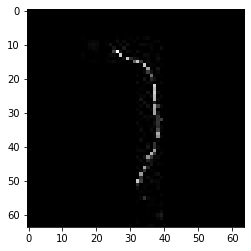

confidence for 14517 is 0.99923354


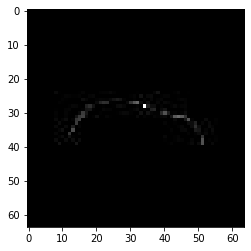

confidence for 14519 is 0.9954723


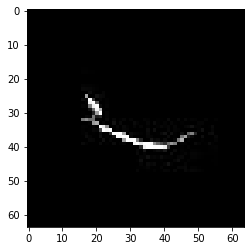

confidence for 14523 is 0.98571557


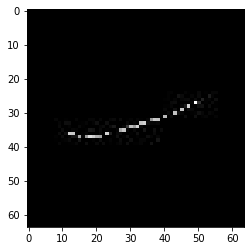

confidence for 14528 is 0.8546903


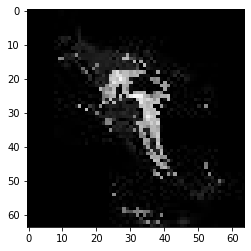

confidence for 14538 is 0.9200957


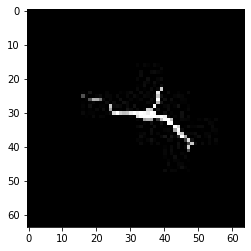

confidence for 14542 is 0.9705236


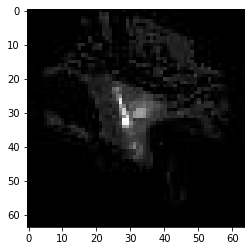

confidence for 14545 is 0.9606905


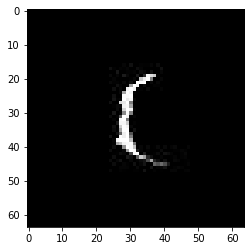

confidence for 14551 is 0.9973517


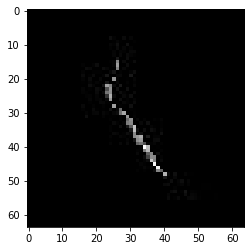

confidence for 14586 is 0.9957656


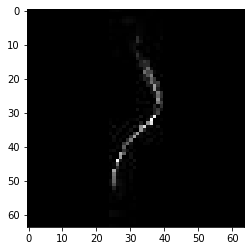

confidence for 14588 is 0.91396874


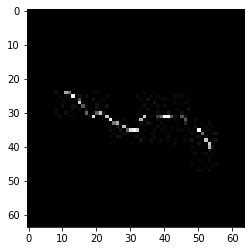

confidence for 14601 is 0.9923449


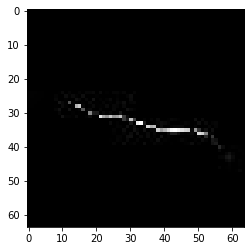

confidence for 14607 is 0.99761176


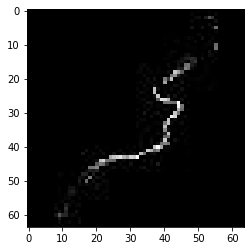

confidence for 14610 is 0.7013711


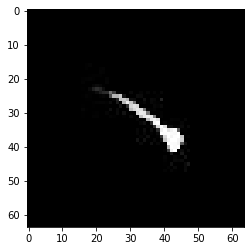

confidence for 14620 is 0.99073297


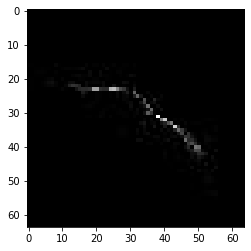

confidence for 14624 is 0.9023187


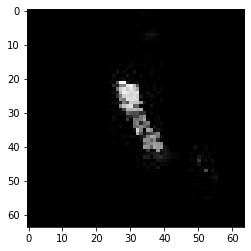

confidence for 14639 is 0.8452133


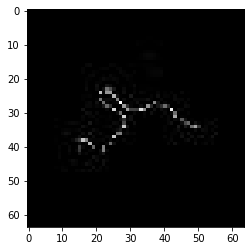

confidence for 14653 is 0.99656177


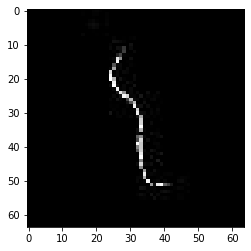

confidence for 14656 is 0.99327195


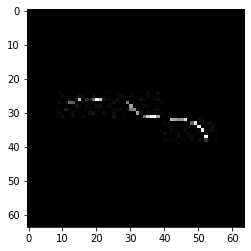

confidence for 14661 is 0.9787607


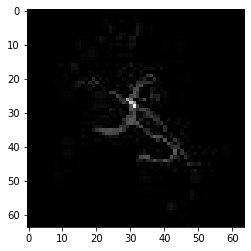

confidence for 14674 is 0.99546164


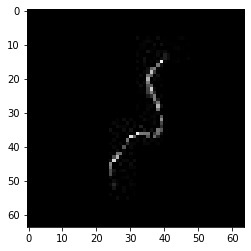

confidence for 14680 is 0.99964637


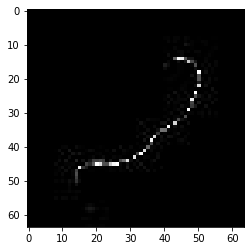

confidence for 14681 is 0.86284494


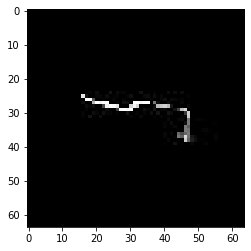

confidence for 14690 is 0.8438516


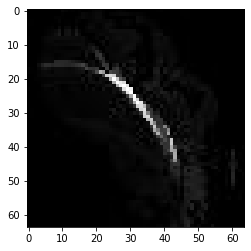

confidence for 14709 is 0.9999281


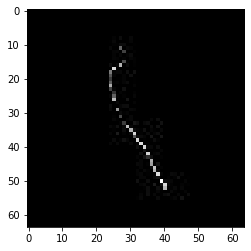

confidence for 14721 is 0.99466294


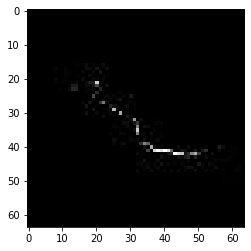

confidence for 14728 is 0.9951574


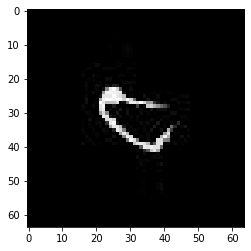

confidence for 14732 is 0.9997711


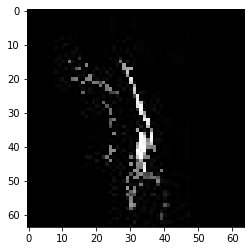

confidence for 14752 is 0.7539561


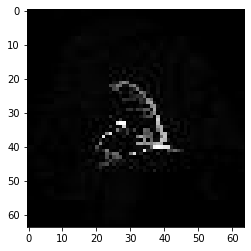

confidence for 14755 is 0.9972175


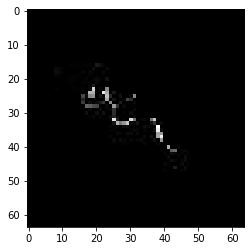

confidence for 14761 is 0.7517353


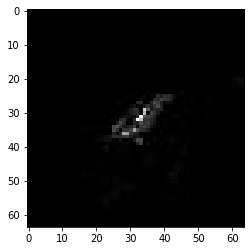

confidence for 14765 is 0.9853498


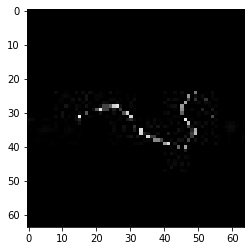

confidence for 14777 is 0.9118435


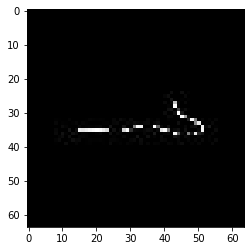

confidence for 14782 is 0.9996289


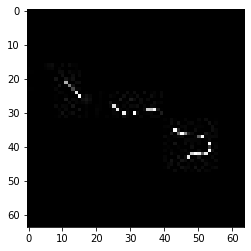

confidence for 14790 is 0.99984586


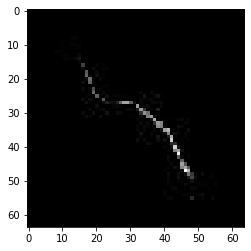

confidence for 14794 is 0.9983009


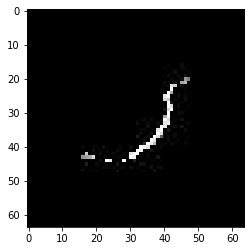

confidence for 14796 is 0.98559195


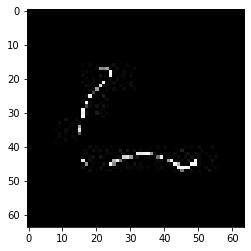

confidence for 14799 is 0.9992711


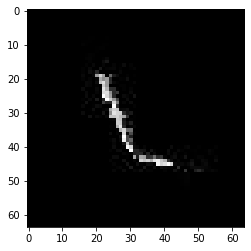

confidence for 14803 is 0.9733219


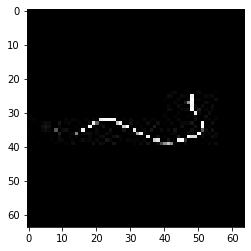

confidence for 14814 is 0.9650518


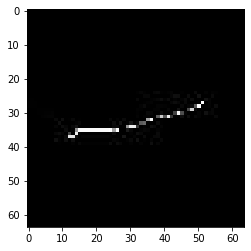

confidence for 14815 is 0.9963196


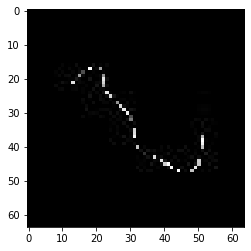

confidence for 14816 is 0.997866


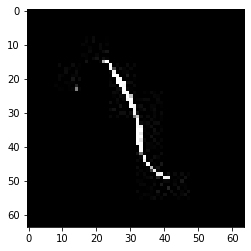

confidence for 14820 is 0.9993282


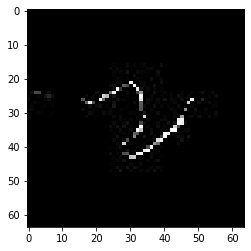

confidence for 14822 is 0.9292982


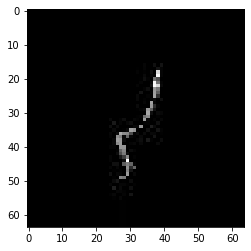

confidence for 14823 is 0.9992593


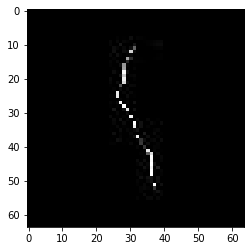

confidence for 14831 is 0.99621964


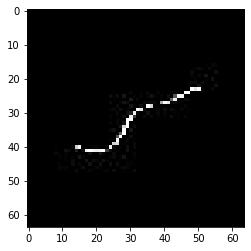

confidence for 14834 is 0.9998023


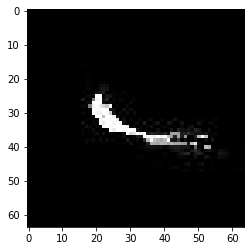

confidence for 14844 is 0.84810793


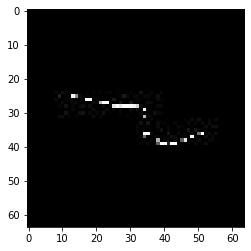

confidence for 14854 is 0.9773626


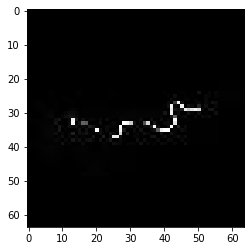

confidence for 14859 is 0.9959217


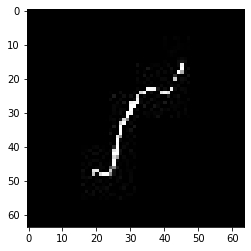

confidence for 14861 is 0.7085081


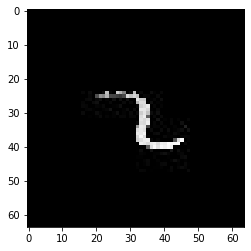

confidence for 14862 is 0.98992985


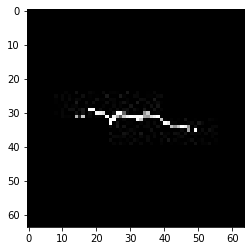

confidence for 14863 is 0.9855073


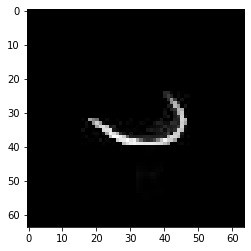

confidence for 14864 is 0.98933804


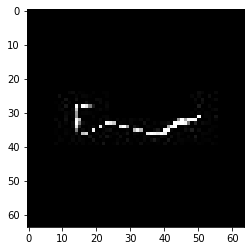

confidence for 14873 is 0.9417633


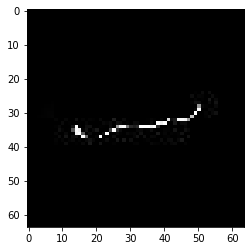

confidence for 14876 is 0.9826159


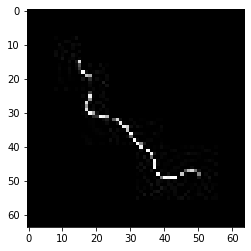

confidence for 14881 is 0.93956107


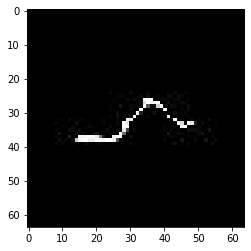

confidence for 14882 is 0.92874193


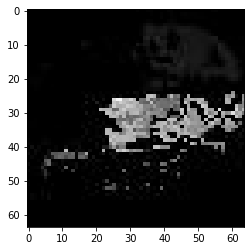

confidence for 14883 is 0.96040165


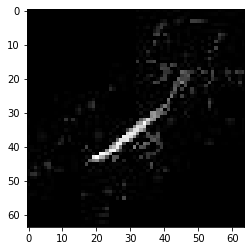

confidence for 14886 is 0.9707993


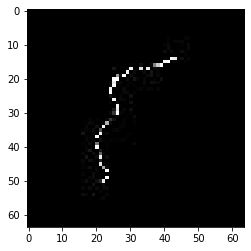

confidence for 14889 is 0.70181865


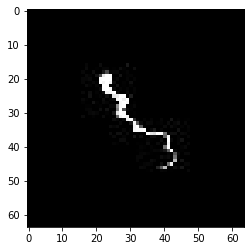

confidence for 14892 is 0.9841965


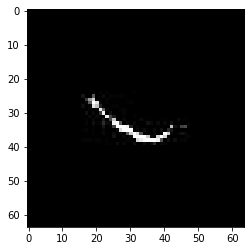

confidence for 14894 is 0.74364346


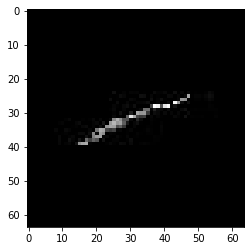

confidence for 14896 is 0.97742283


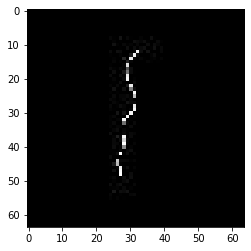

confidence for 14901 is 0.9929522


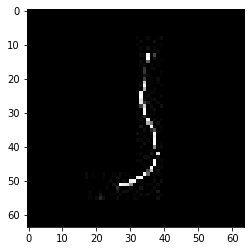

confidence for 14905 is 0.99759996


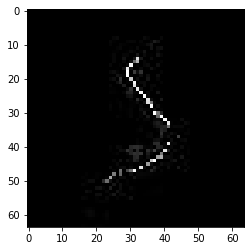

confidence for 14906 is 0.7131231


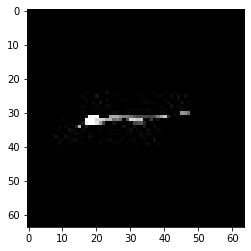

confidence for 14908 is 0.87811035


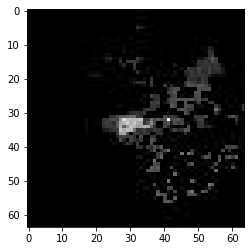

confidence for 14909 is 0.9642204


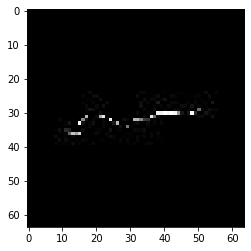

confidence for 14920 is 0.86837924


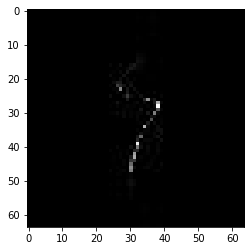

confidence for 14921 is 0.9995936


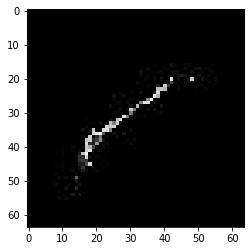

confidence for 14922 is 0.9832163


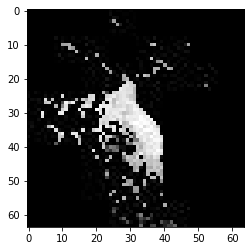

confidence for 14923 is 0.9029233


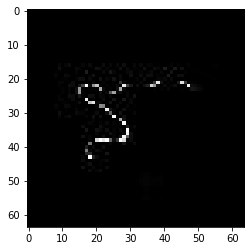

confidence for 14928 is 0.9974173


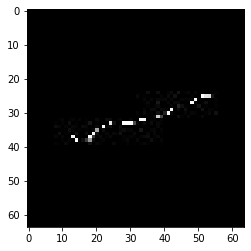

confidence for 14929 is 0.95757455


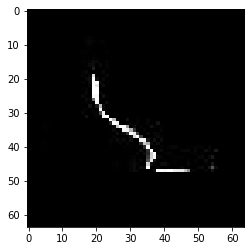

confidence for 14933 is 0.96909416


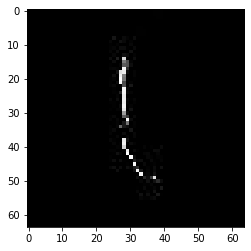

confidence for 14934 is 0.86826086


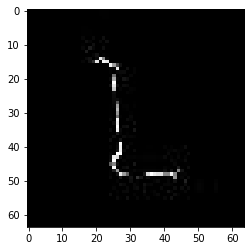

confidence for 14935 is 0.96469


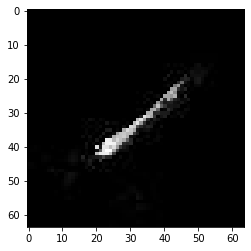

confidence for 14951 is 0.9000854


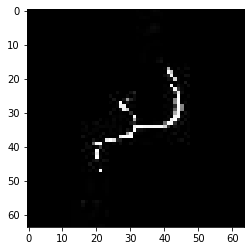

confidence for 14959 is 0.9614407


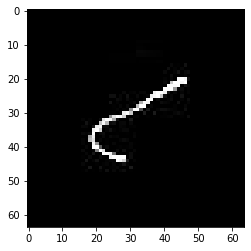

confidence for 14963 is 0.99999154


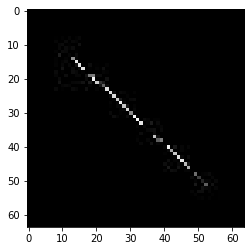

confidence for 14965 is 0.99997365


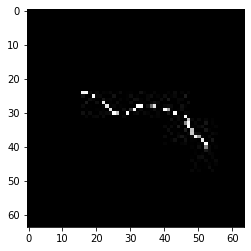

confidence for 14967 is 0.97340983


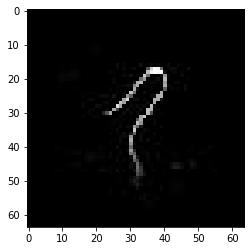

confidence for 14968 is 0.99945945


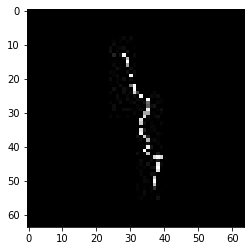

confidence for 14970 is 0.9426021


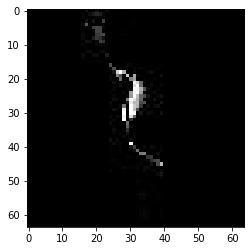

confidence for 14973 is 0.9993067


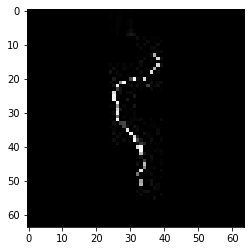

confidence for 14975 is 0.9835351


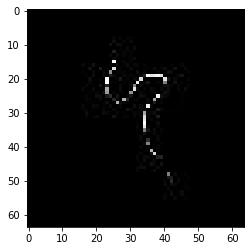

confidence for 14981 is 0.99897105


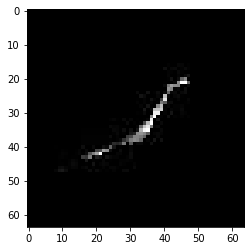

confidence for 14982 is 0.9779501


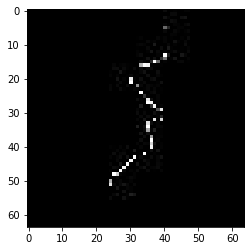

confidence for 14983 is 0.889912


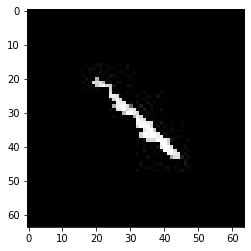

confidence for 14985 is 0.9978659


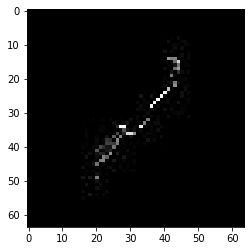

confidence for 14996 is 0.75751793


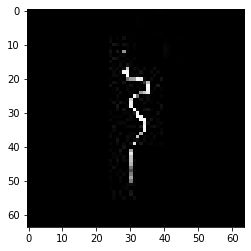

confidence for 14999 is 0.99827904


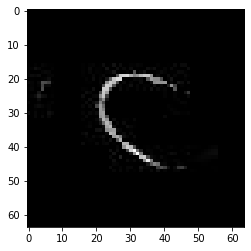

confidence for 15003 is 0.9841409


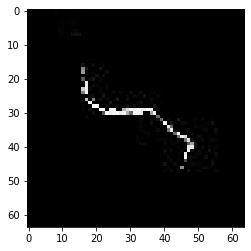

confidence for 15004 is 0.9995842


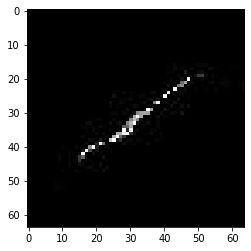

confidence for 15014 is 0.85186166


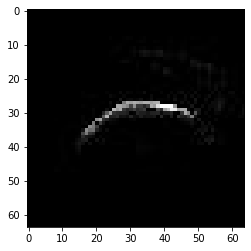

confidence for 15018 is 0.99650604


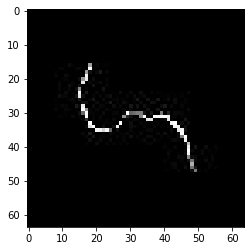

confidence for 15019 is 0.7206119


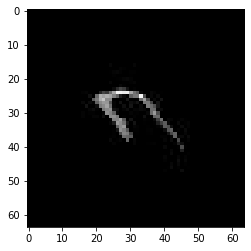

confidence for 15041 is 0.9976717


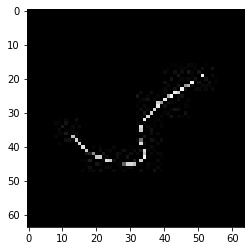

confidence for 15042 is 0.9995372


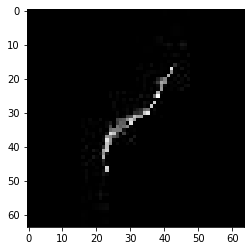

confidence for 15053 is 0.99443454


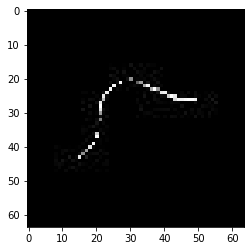

confidence for 15066 is 0.89202785


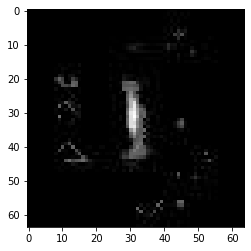

confidence for 15068 is 0.7055663


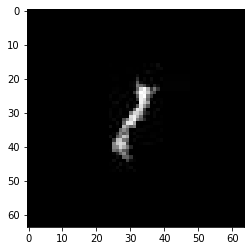

confidence for 15070 is 0.9900455


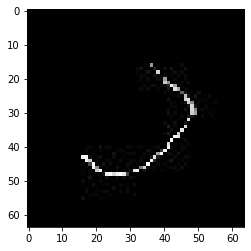

confidence for 15073 is 0.9996164


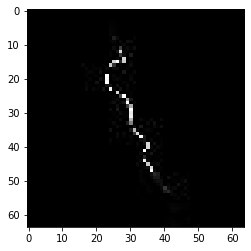

confidence for 15077 is 0.8333141


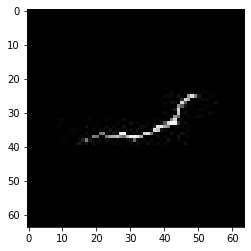

confidence for 15081 is 0.9851674


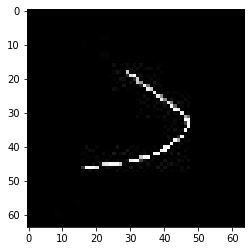

confidence for 15086 is 0.9934511


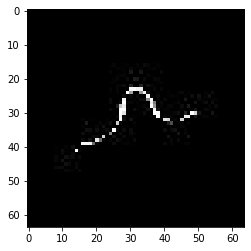

confidence for 15087 is 0.99950516


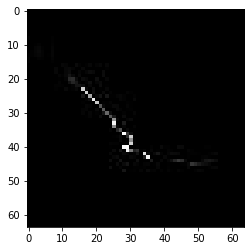

confidence for 15092 is 0.99926585


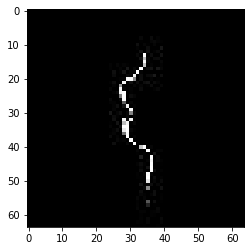

confidence for 15096 is 0.99878794


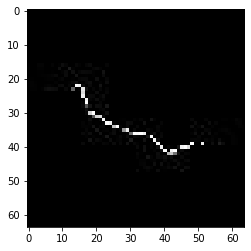

confidence for 15104 is 0.9993331


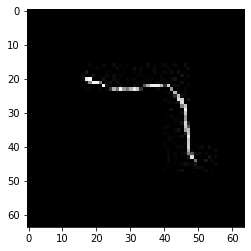

confidence for 15106 is 0.8866611


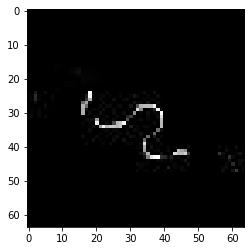

confidence for 15108 is 0.99757534


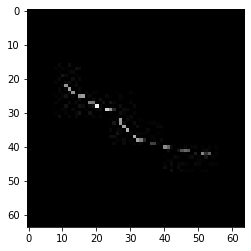

confidence for 15112 is 0.9983615


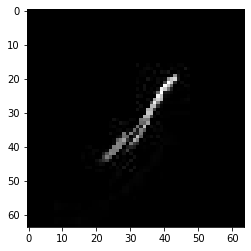

confidence for 15119 is 0.8508927


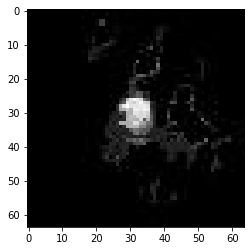

confidence for 15124 is 0.99924177


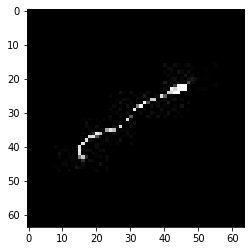

confidence for 15125 is 0.99321467


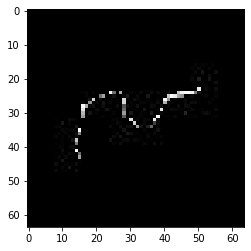

confidence for 15126 is 0.81997925


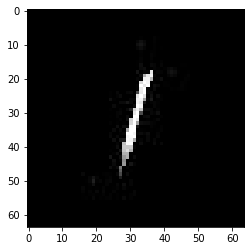

confidence for 15128 is 0.99641687


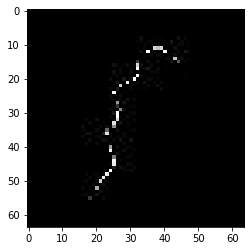

confidence for 15130 is 0.9996702


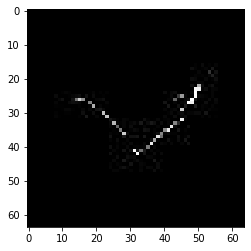

confidence for 15131 is 0.9988311


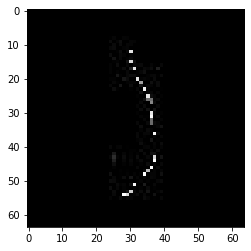

confidence for 15134 is 0.9978982


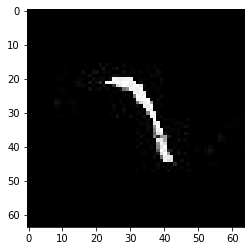

confidence for 15135 is 0.9917857


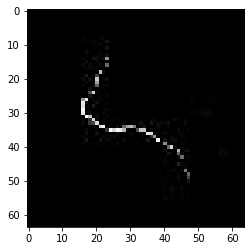

confidence for 15137 is 0.96603596


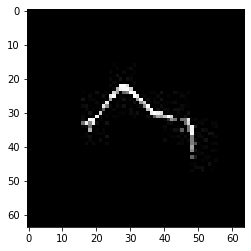

confidence for 15143 is 0.9993642


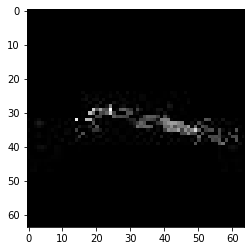

confidence for 15151 is 0.71829855


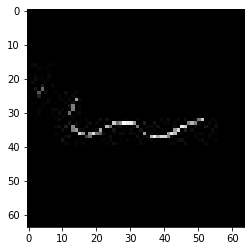

confidence for 15158 is 0.9894544


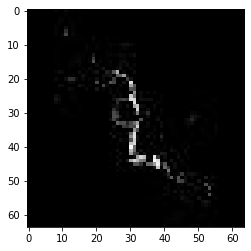

confidence for 15159 is 0.96228987


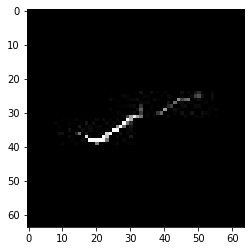

confidence for 15164 is 0.9999641


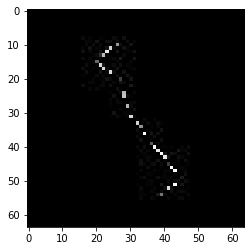

confidence for 15166 is 0.7424314


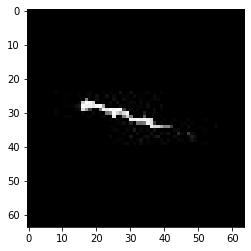

confidence for 15173 is 0.9912861


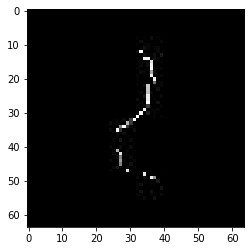

confidence for 15174 is 0.84705454


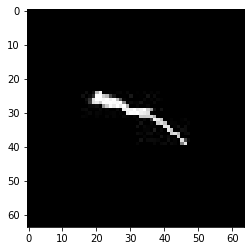

confidence for 15176 is 0.99981606


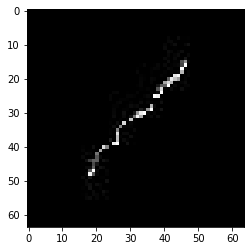

confidence for 15179 is 0.96207917


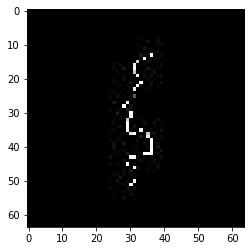

confidence for 15185 is 0.9990658


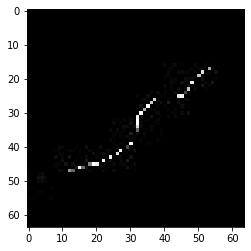

confidence for 15193 is 0.99996084


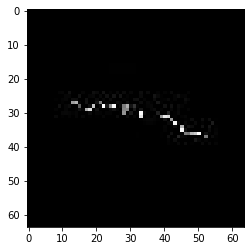

confidence for 15200 is 0.75580174


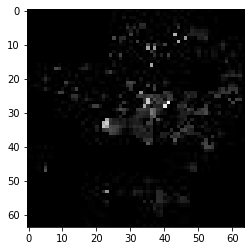

confidence for 15204 is 0.99779946


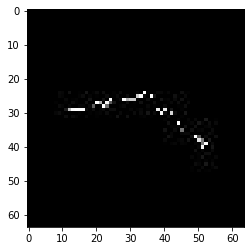

confidence for 15209 is 0.9981366


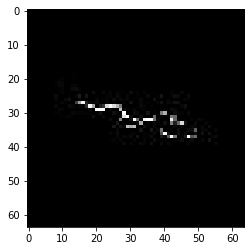

confidence for 15221 is 1.0


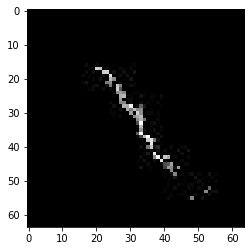

confidence for 15222 is 0.99988705


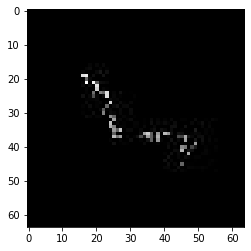

confidence for 15232 is 0.9963479


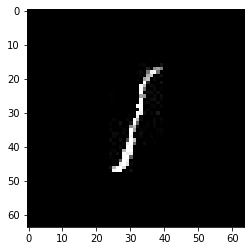

confidence for 15238 is 0.9689571


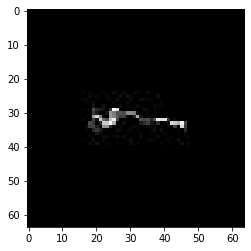

confidence for 15245 is 0.731131


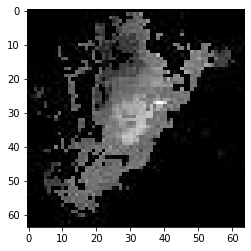

confidence for 15247 is 0.98564184


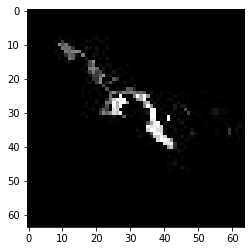

confidence for 15252 is 0.9965147


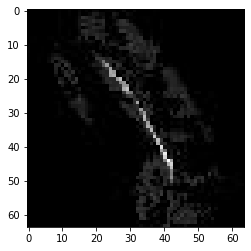

confidence for 15276 is 0.986104


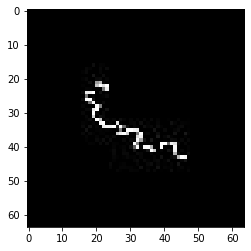

confidence for 15278 is 0.9815635


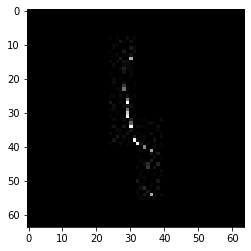

confidence for 15284 is 0.99999934


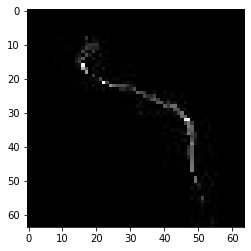

confidence for 15286 is 0.9764229


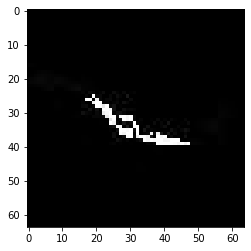

confidence for 15291 is 0.9999293


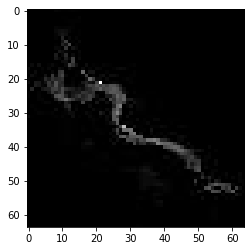

confidence for 15296 is 0.99109113


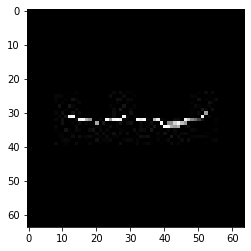

confidence for 15299 is 0.8432307


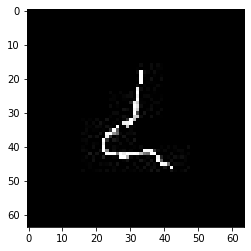

confidence for 15301 is 0.99879026


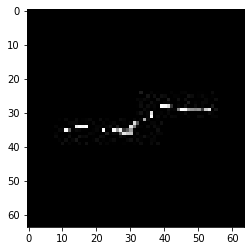

confidence for 15302 is 0.9322128


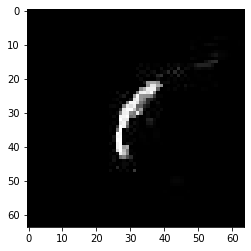

confidence for 15304 is 0.99860233


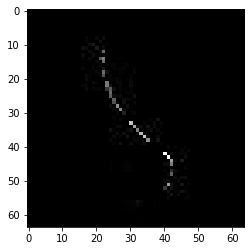

confidence for 15355 is 0.9997492


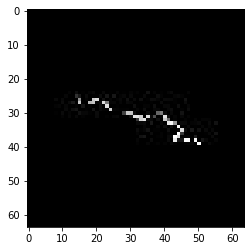

confidence for 15360 is 0.9368288


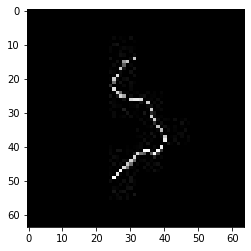

confidence for 15364 is 0.8223926


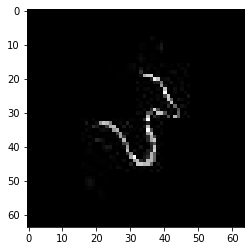

confidence for 15384 is 0.99710995


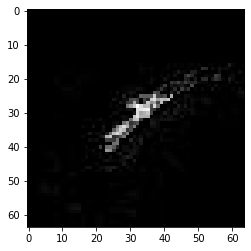

confidence for 15389 is 0.9964306


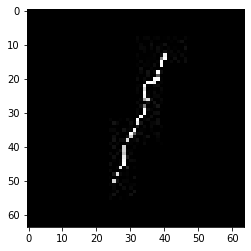

confidence for 15394 is 0.99996215


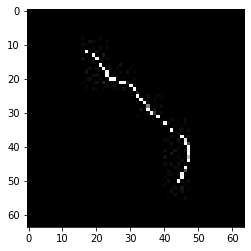

confidence for 15396 is 0.9899484


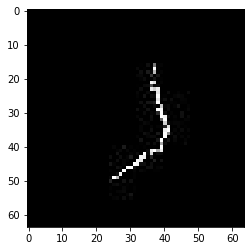

confidence for 15404 is 0.99670964


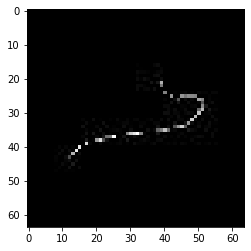

confidence for 15410 is 0.9944442


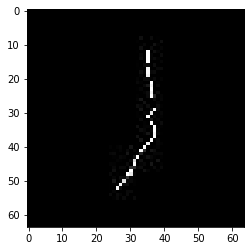

confidence for 15413 is 0.9572752


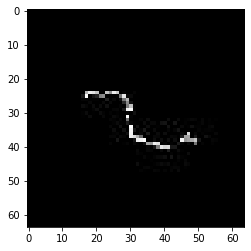

confidence for 15418 is 0.9999459


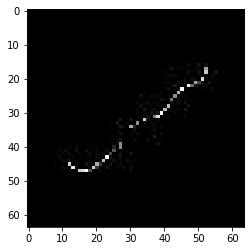

confidence for 15419 is 0.9741117


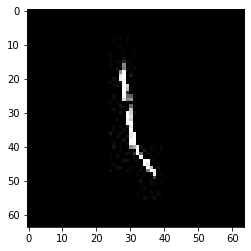

confidence for 15426 is 0.8735434


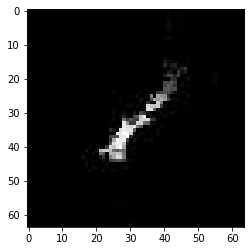

confidence for 15428 is 0.9632131


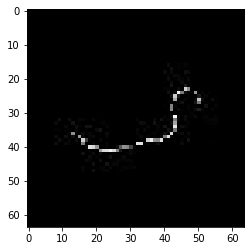

confidence for 15435 is 0.97870433


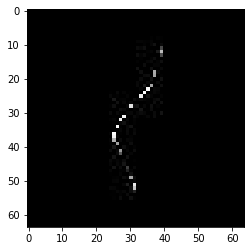

confidence for 15440 is 0.7501724


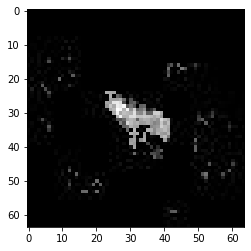

confidence for 15445 is 0.9940209


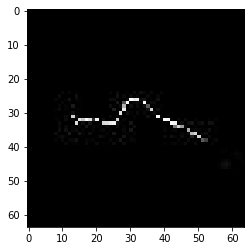

confidence for 15446 is 0.998348


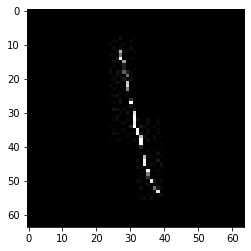

confidence for 15457 is 0.99994326


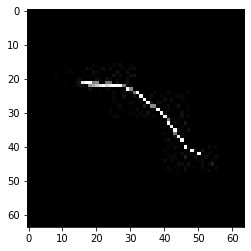

confidence for 15463 is 0.9995396


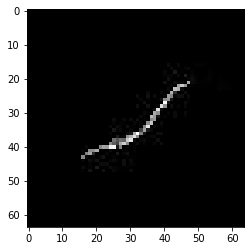

confidence for 15464 is 0.9999926


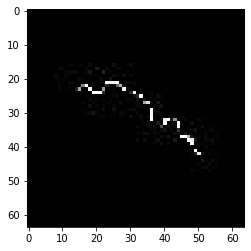

confidence for 15469 is 0.7883074


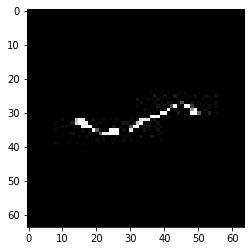

confidence for 15483 is 0.99993736


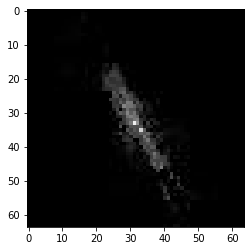

confidence for 15489 is 0.7157729


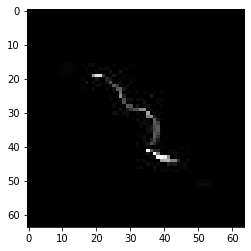

confidence for 15509 is 0.9988279


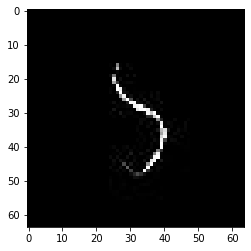

confidence for 15536 is 0.97726375


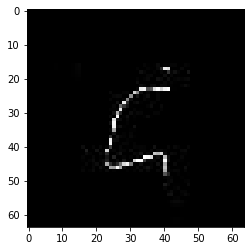

confidence for 15540 is 0.8973848


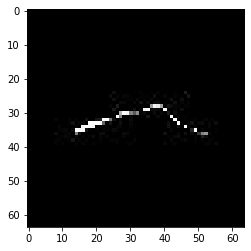

confidence for 15543 is 0.81316656


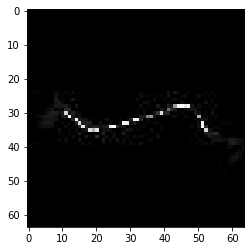

confidence for 15550 is 0.9927168


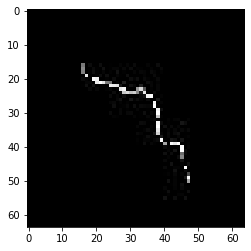

confidence for 15551 is 0.9991471


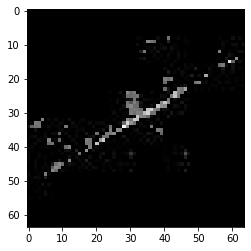

confidence for 15571 is 0.99976075


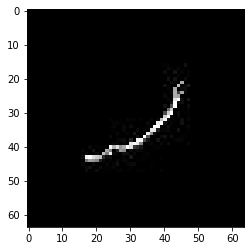

confidence for 15579 is 0.98538655


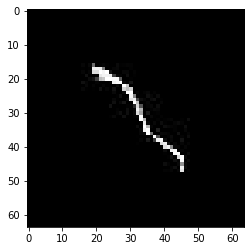

confidence for 15591 is 0.9957977


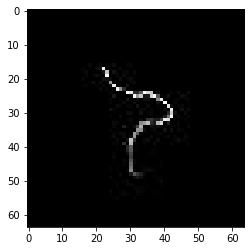

confidence for 15598 is 0.9523684


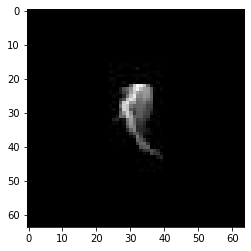

confidence for 15608 is 0.9999929


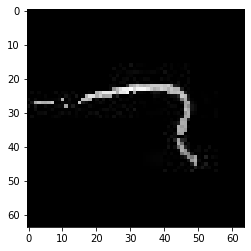

confidence for 15610 is 0.9996291


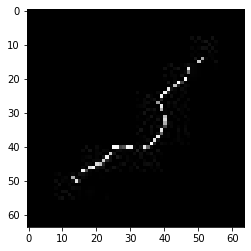

confidence for 15614 is 0.78041863


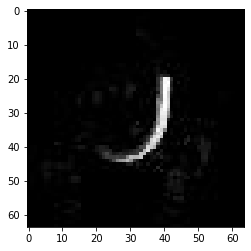

confidence for 15619 is 0.9999714


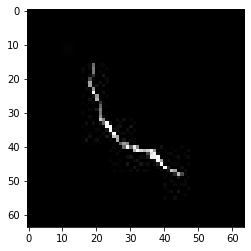

confidence for 15623 is 0.98846954


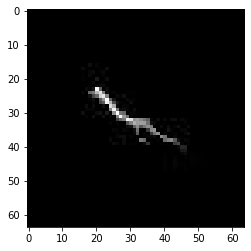

confidence for 15627 is 0.9986832


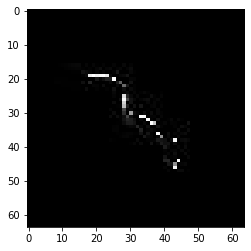

confidence for 15629 is 0.99891776


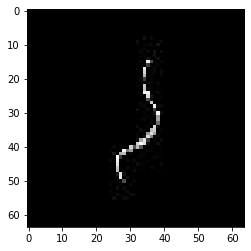

confidence for 15636 is 0.99530596


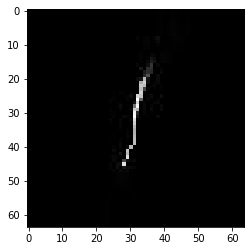

confidence for 15637 is 0.9924961


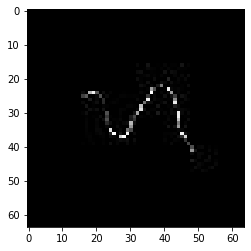

confidence for 15646 is 0.9999746


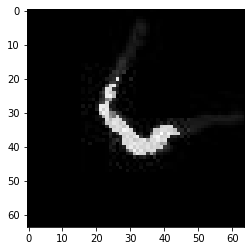

confidence for 15648 is 0.9952358


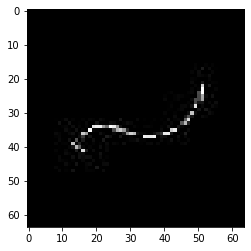

confidence for 15657 is 0.9997135


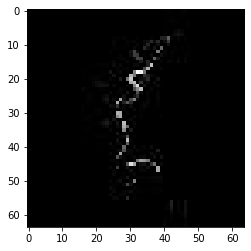

confidence for 15660 is 0.7718325


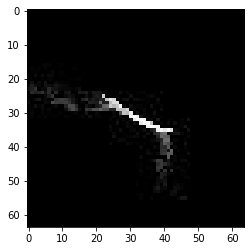

confidence for 15665 is 0.71712244


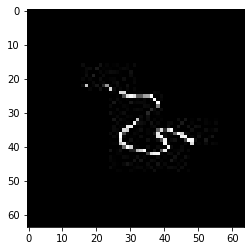

confidence for 15668 is 0.94253534


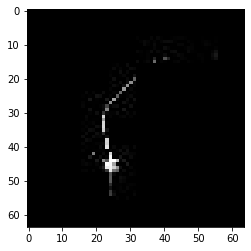

confidence for 15672 is 0.9879294


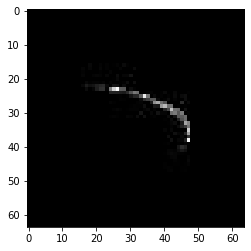

confidence for 15676 is 0.93897825


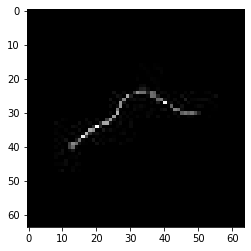

confidence for 15696 is 0.98748994


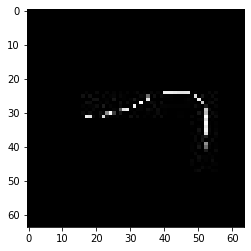

confidence for 15701 is 0.9999006


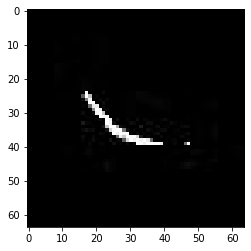

confidence for 15703 is 0.76210445


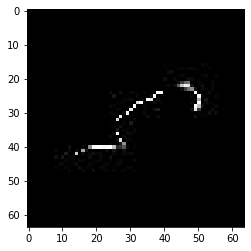

confidence for 15713 is 0.8628652


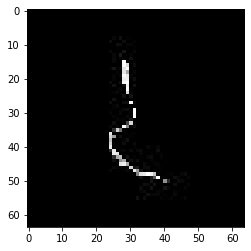

confidence for 15718 is 0.89393216


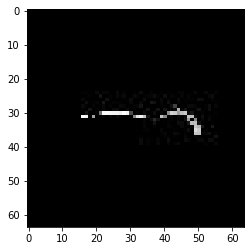

confidence for 15720 is 0.9854574


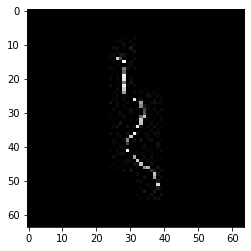

confidence for 15723 is 0.99967355


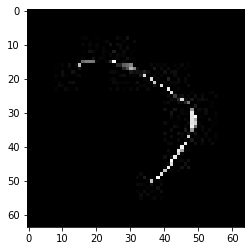

confidence for 15726 is 0.9828417


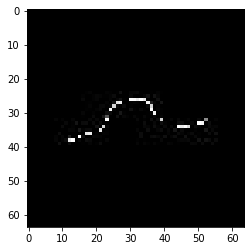

confidence for 15727 is 0.9981279


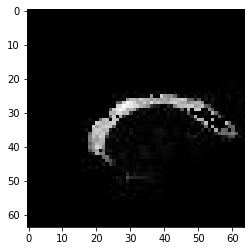

confidence for 15735 is 0.99124366


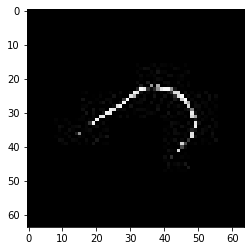

confidence for 15740 is 0.9988197


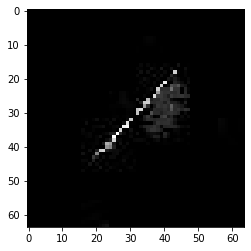

confidence for 15742 is 0.9960471


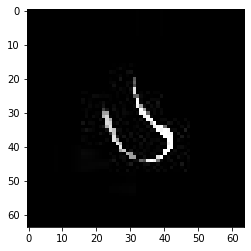

confidence for 15745 is 0.9129387


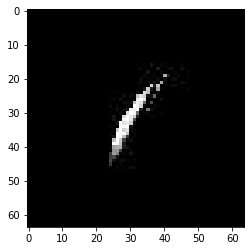

confidence for 15748 is 0.9323467


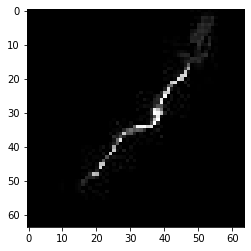

confidence for 15750 is 0.9737984


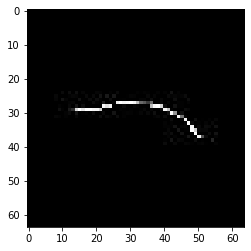

confidence for 15752 is 0.9928763


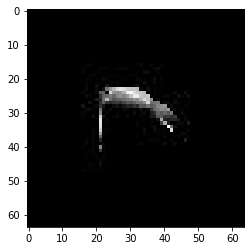

confidence for 15759 is 0.9931985


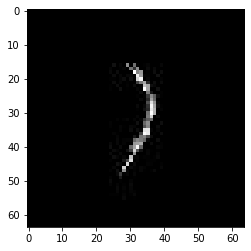

confidence for 15760 is 0.9993357


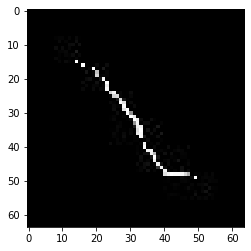

confidence for 15764 is 0.96559453


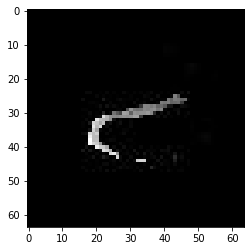

confidence for 15767 is 0.8202691


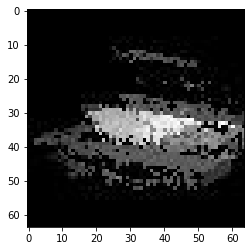

confidence for 15772 is 0.9999759


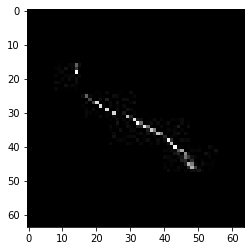

confidence for 15776 is 0.90281606


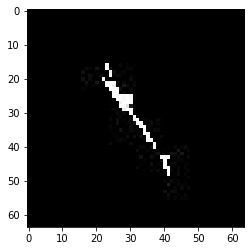

confidence for 15789 is 0.9998035


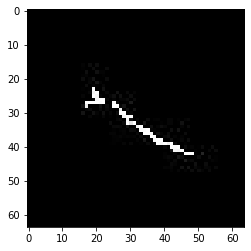

confidence for 15792 is 0.981201


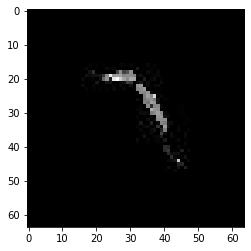

confidence for 15795 is 0.93040156


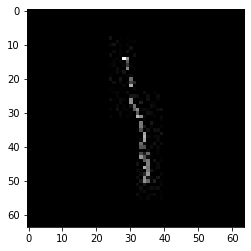

confidence for 15796 is 0.9985244


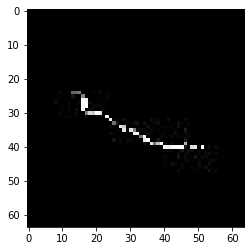

confidence for 15802 is 0.99995154


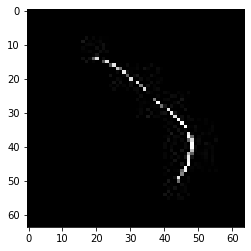

confidence for 15803 is 0.9829812


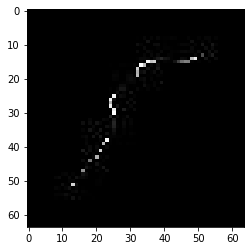

confidence for 15808 is 0.99586344


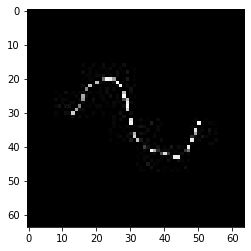

confidence for 15819 is 0.99491227


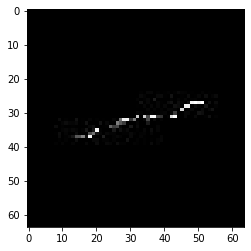

confidence for 15825 is 0.98468894


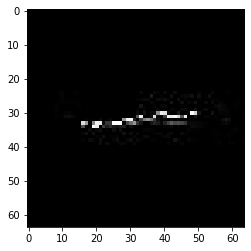

confidence for 15829 is 0.9970733


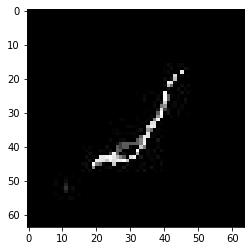

confidence for 15833 is 0.9999995


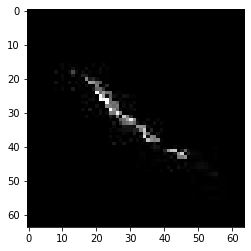

confidence for 15837 is 0.89328927


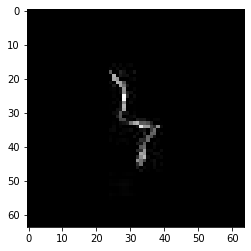

confidence for 15846 is 0.8622864


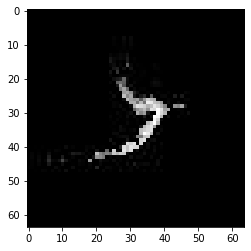

confidence for 15856 is 0.96695715


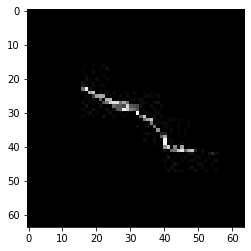

confidence for 15868 is 0.9999942


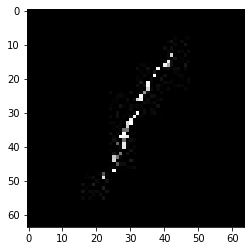

confidence for 15872 is 0.9931104


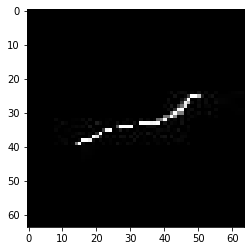

confidence for 15873 is 0.9693186


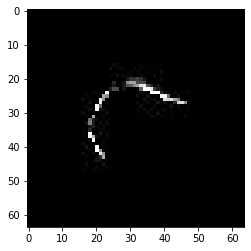

confidence for 15875 is 0.9767468


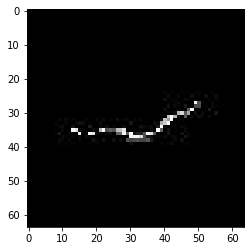

confidence for 15880 is 0.9850799


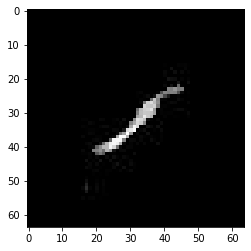

confidence for 15881 is 0.8118745


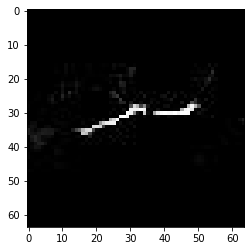

confidence for 15885 is 0.9993943


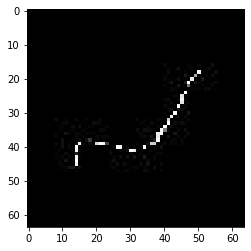

confidence for 15896 is 0.99997133


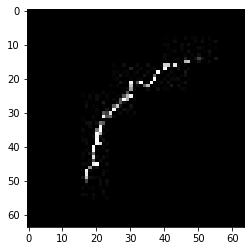

confidence for 15898 is 0.9781601


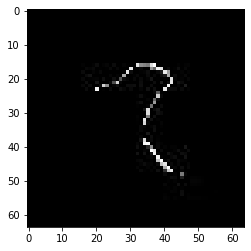

confidence for 15901 is 0.99999666


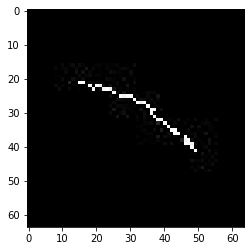

confidence for 15904 is 0.93728226


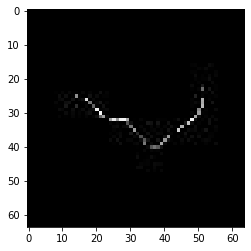

confidence for 15909 is 0.9878504


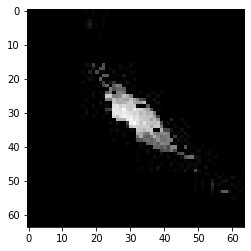

confidence for 15912 is 0.92389846


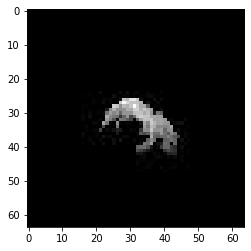

confidence for 15931 is 0.93447316


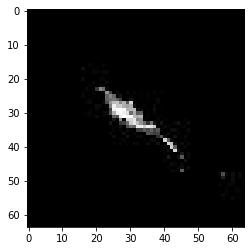

confidence for 15934 is 0.99862826


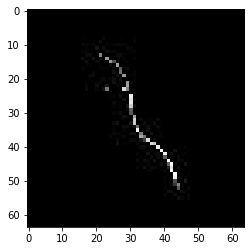

confidence for 15936 is 0.754917


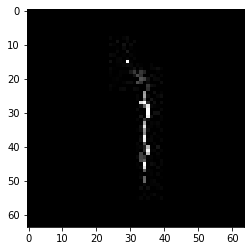

confidence for 15946 is 0.8740703


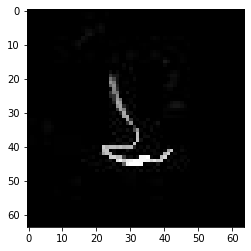

confidence for 15952 is 0.999009


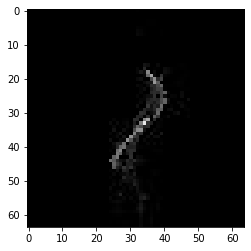

confidence for 15954 is 0.9995896


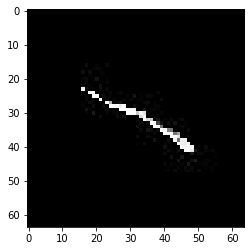

confidence for 15967 is 0.9943397


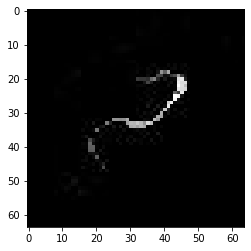

confidence for 15970 is 0.99279195


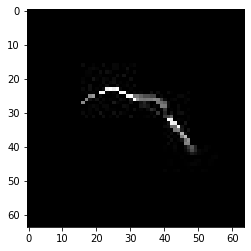

confidence for 15980 is 0.96802026


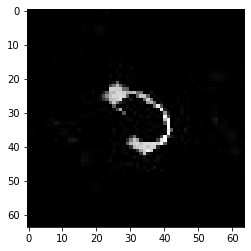

confidence for 15984 is 0.998985


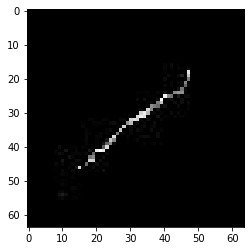

confidence for 15990 is 0.779891


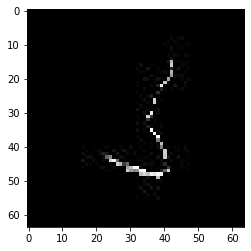

confidence for 15996 is 0.91148376


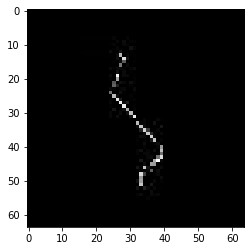

confidence for 16010 is 0.77238595


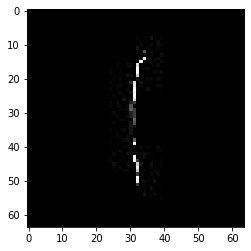

confidence for 16017 is 0.9867167


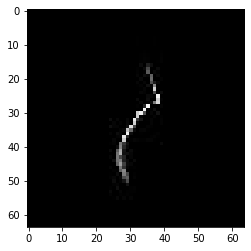

confidence for 16028 is 0.81270975


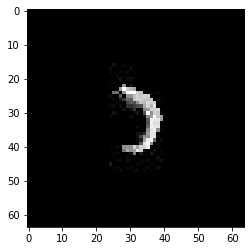

confidence for 16034 is 0.9559632


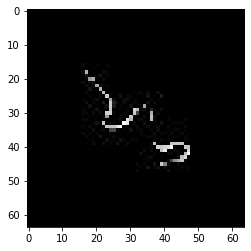

confidence for 16038 is 0.97496563


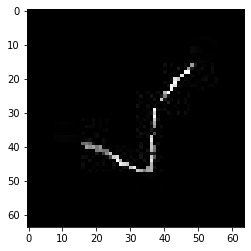

confidence for 16040 is 0.70406085


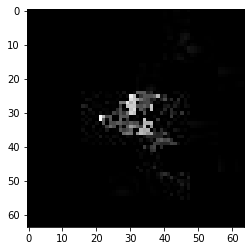

confidence for 16042 is 0.9980211


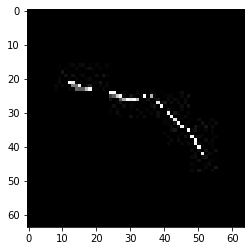

confidence for 16047 is 0.89521784


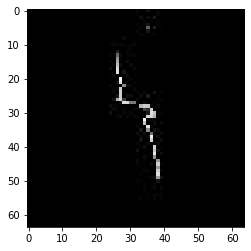

confidence for 16052 is 0.999807


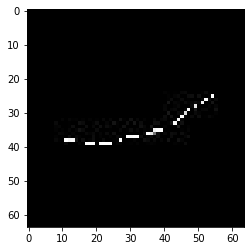

confidence for 16054 is 0.99956363


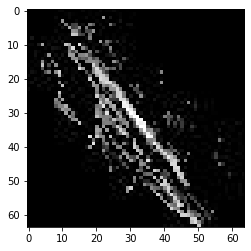

confidence for 16059 is 0.9728471


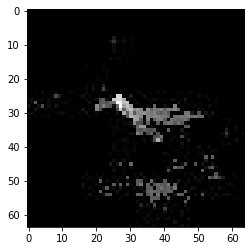

confidence for 16060 is 0.99999547


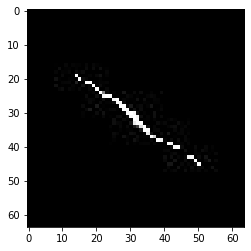

confidence for 16061 is 0.999852


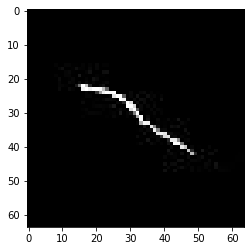

confidence for 16065 is 0.9999513


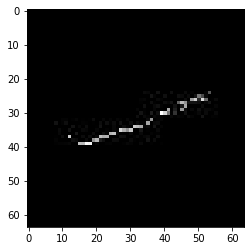

confidence for 16066 is 0.96051604


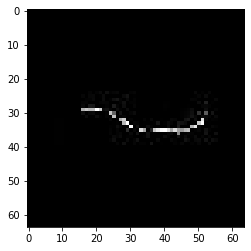

confidence for 16072 is 0.9872917


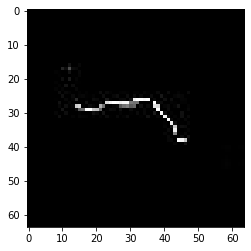

confidence for 16073 is 0.9923484


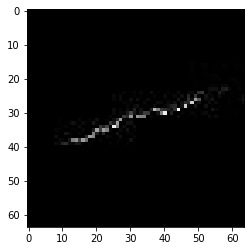

confidence for 16084 is 0.9993906


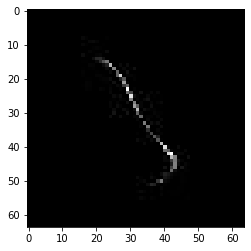

confidence for 16091 is 0.9569756


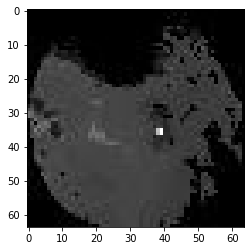

confidence for 16095 is 0.9203551


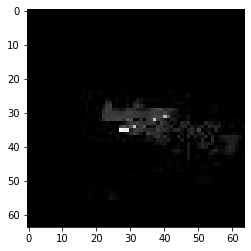

confidence for 16104 is 0.97243655


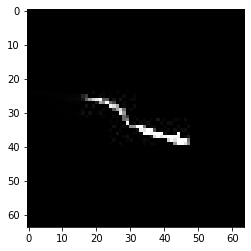

confidence for 16105 is 0.93884903


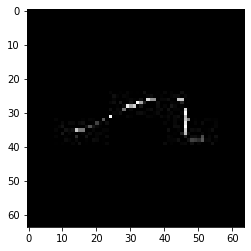

confidence for 16120 is 0.9999806


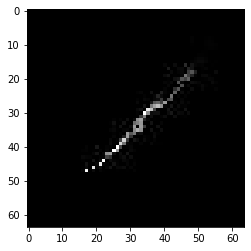

confidence for 16122 is 0.9408061


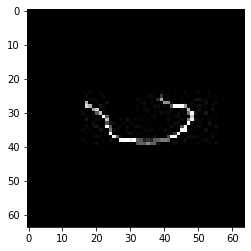

confidence for 16124 is 0.78287315


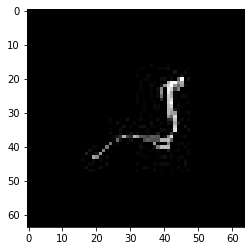

confidence for 16125 is 0.994362


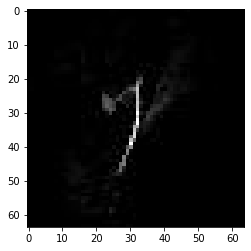

confidence for 16128 is 0.97927386


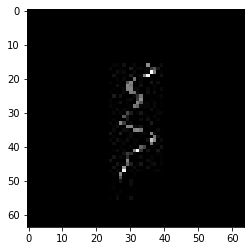

confidence for 16141 is 0.81484354


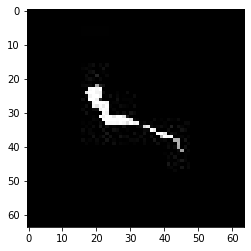

confidence for 16147 is 0.93669623


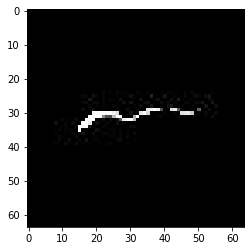

confidence for 16150 is 0.992829


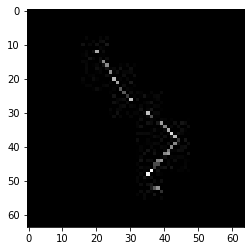

confidence for 16168 is 0.9961137


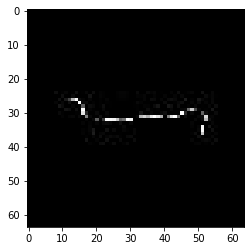

confidence for 16171 is 0.77662796


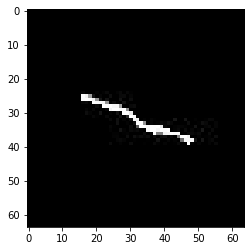

confidence for 16172 is 0.96030915


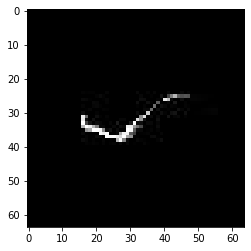

confidence for 16174 is 0.99998003


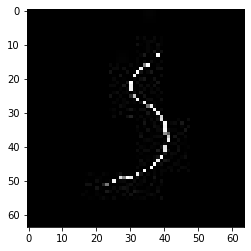

confidence for 16176 is 0.8450033


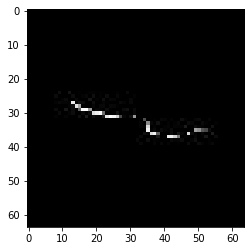

confidence for 16182 is 0.957641


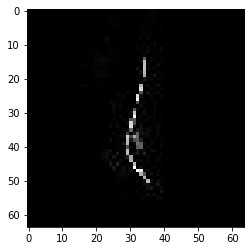

confidence for 16204 is 0.8487826


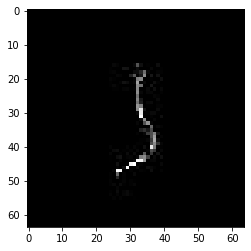

confidence for 16205 is 0.9998732


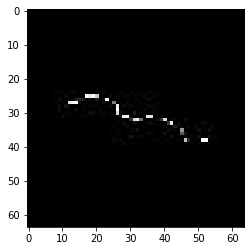

confidence for 16208 is 0.88881063


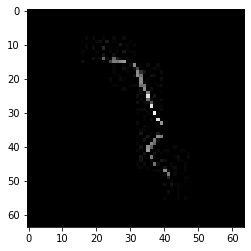

confidence for 16211 is 0.99974763


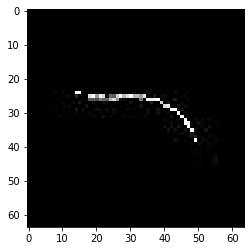

confidence for 16212 is 0.9988966


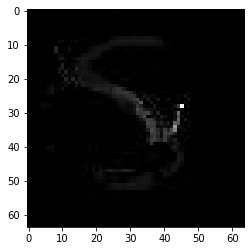

confidence for 16224 is 0.9909058


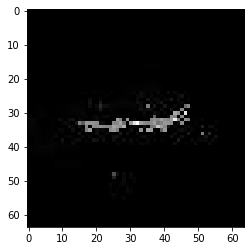

confidence for 16235 is 0.9956193


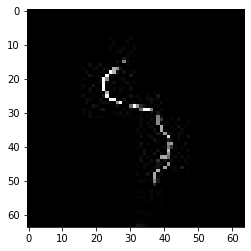

confidence for 16243 is 0.980875


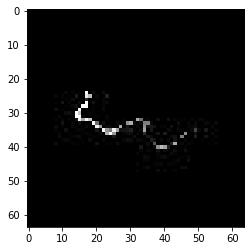

confidence for 16249 is 0.98040354


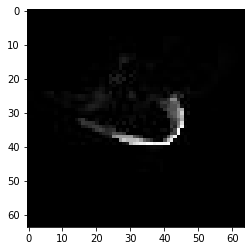

confidence for 16259 is 0.98561156


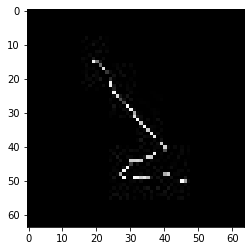

confidence for 16261 is 0.8565245


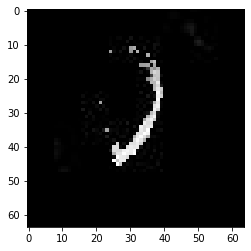

confidence for 16270 is 0.78129566


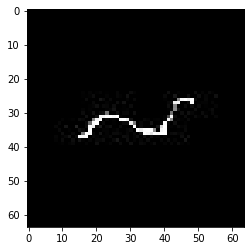

confidence for 16272 is 0.8198772


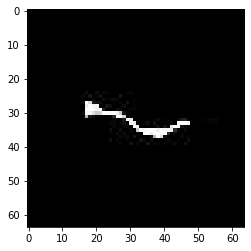

confidence for 16278 is 0.87789464


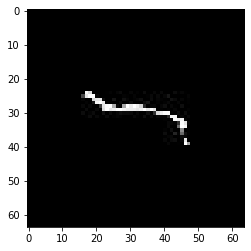

confidence for 16288 is 0.80223626


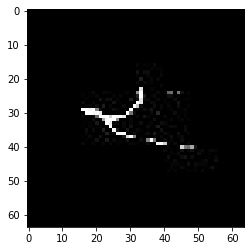

confidence for 16289 is 0.9955294


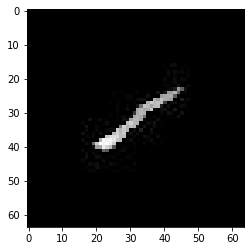

confidence for 16302 is 0.99850404


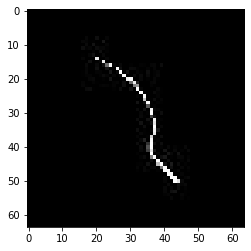

confidence for 16303 is 0.9994658


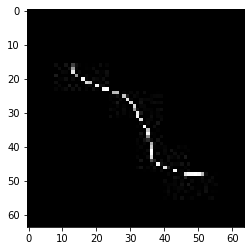

confidence for 16308 is 0.76952916


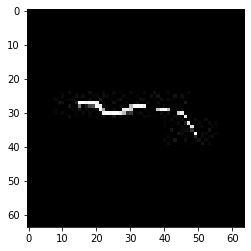

confidence for 16333 is 0.80227125


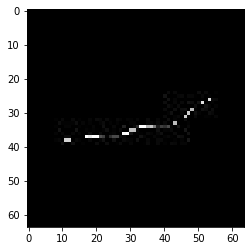

confidence for 16337 is 0.9472288


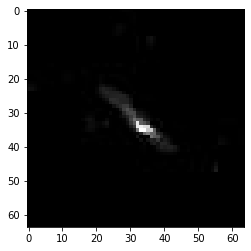

confidence for 16346 is 0.97785825


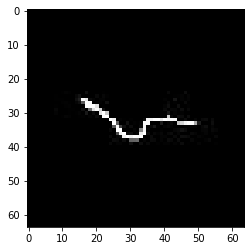

confidence for 16362 is 0.99759936


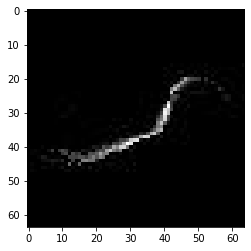

confidence for 16376 is 0.86074555


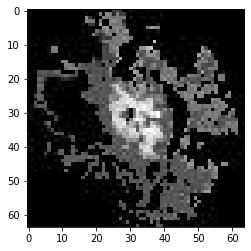

confidence for 16377 is 0.9858172


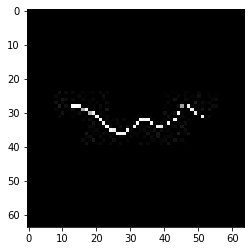

confidence for 16379 is 0.7544376


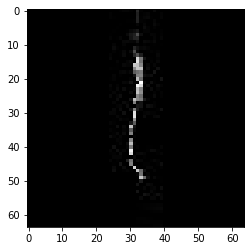

confidence for 16383 is 0.9693457


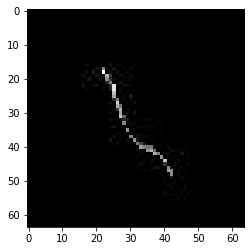

confidence for 16392 is 0.98233014


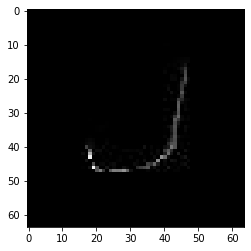

confidence for 16393 is 0.9572531


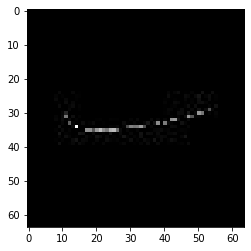

confidence for 16400 is 0.9073484


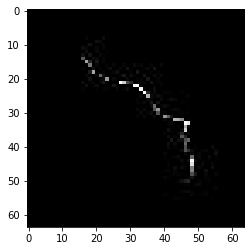

confidence for 16405 is 0.92875093


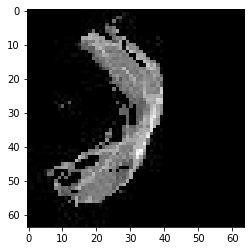

confidence for 16409 is 0.99945456


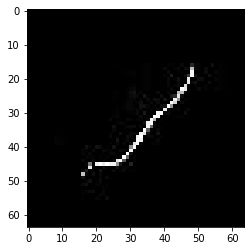

confidence for 16412 is 0.9982408


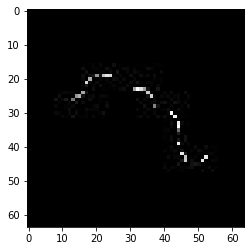

confidence for 16417 is 0.76515347


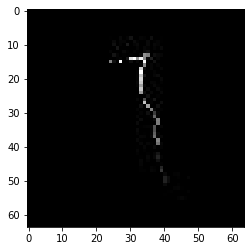

confidence for 16424 is 0.9484464


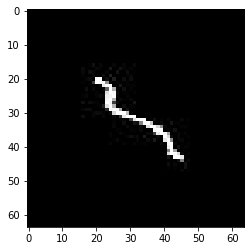

confidence for 16480 is 0.82437265


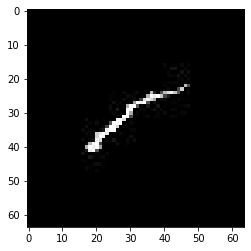

confidence for 16492 is 0.98436767


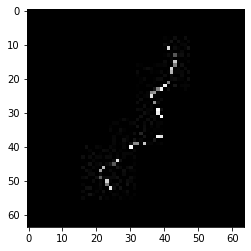

confidence for 16499 is 0.93952274


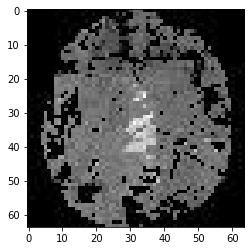

confidence for 16502 is 0.9064619


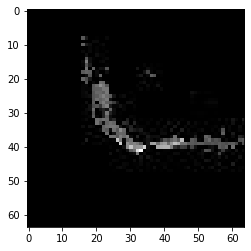

confidence for 16504 is 0.9919606


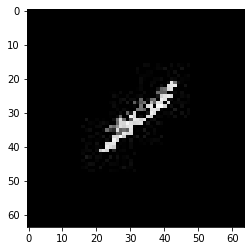

confidence for 16521 is 0.7912352


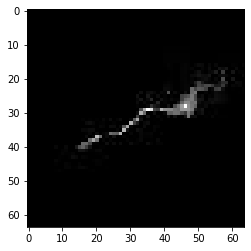

confidence for 16530 is 0.81771284


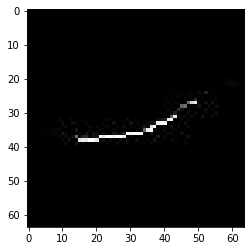

confidence for 16574 is 0.9533007


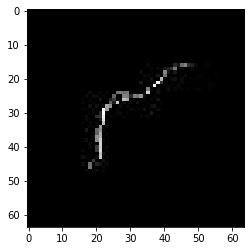

confidence for 16576 is 0.7110683


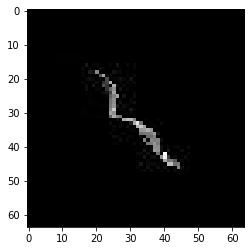

confidence for 16577 is 0.7984894


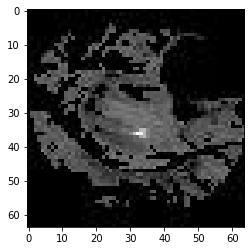

confidence for 16590 is 0.9964687


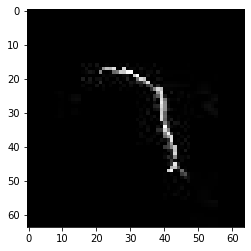

confidence for 16593 is 0.9992118


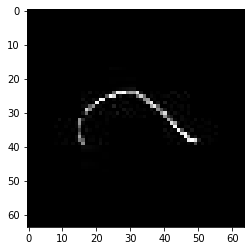

confidence for 16597 is 0.97775066


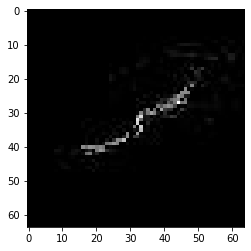

confidence for 16604 is 0.96562696


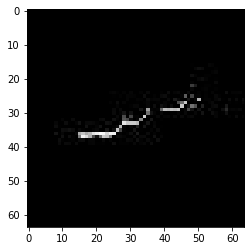

confidence for 16611 is 0.85201865


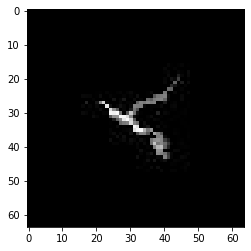

confidence for 16613 is 0.9999271


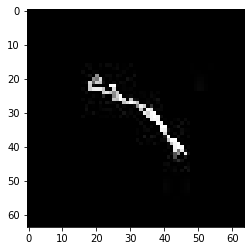

confidence for 16636 is 0.9720055


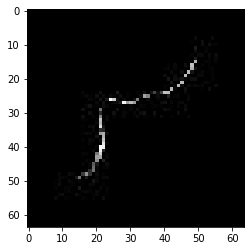

confidence for 16637 is 0.9933724


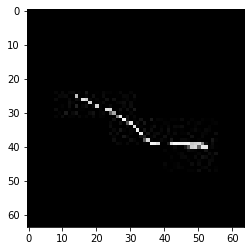

confidence for 16640 is 0.9328399


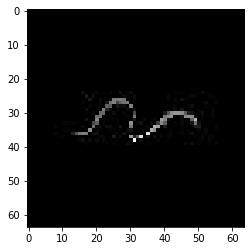

confidence for 16641 is 0.9873137


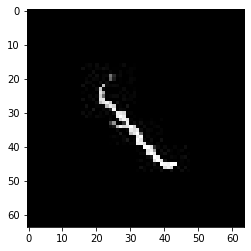

confidence for 16642 is 0.93661267


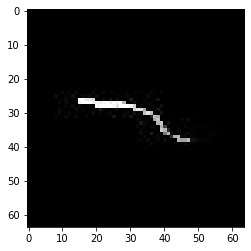

confidence for 16651 is 0.8913029


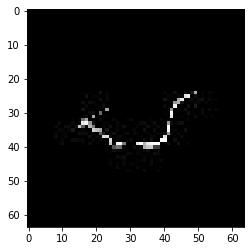

confidence for 16659 is 0.96489483


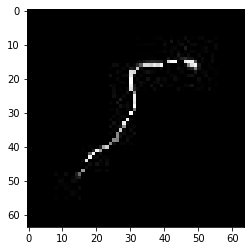

confidence for 16668 is 0.99590516


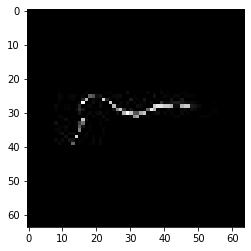

confidence for 16674 is 0.96088856


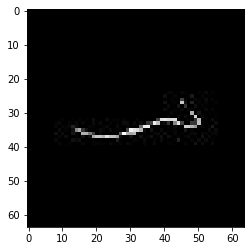

confidence for 16678 is 0.99969286


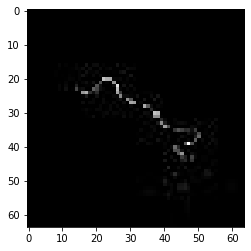

confidence for 16704 is 0.9998685


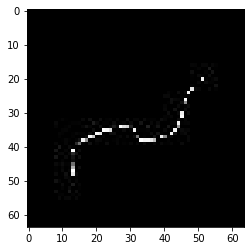

confidence for 16705 is 0.9999522


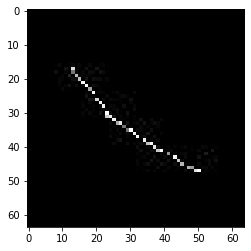

confidence for 16713 is 0.9615625


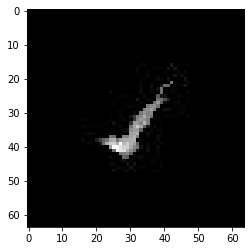

confidence for 16715 is 0.99984556


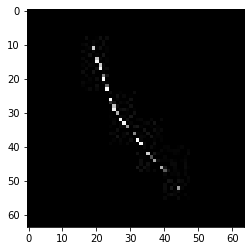

confidence for 16729 is 0.9998241


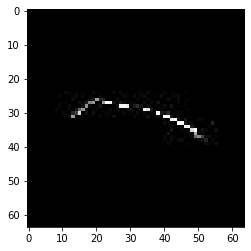

confidence for 16745 is 0.96272945


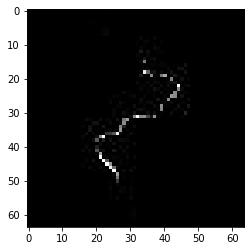

confidence for 16746 is 0.9999994


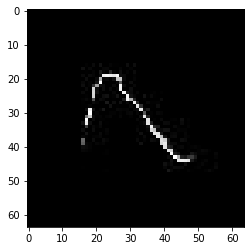

confidence for 16767 is 0.9266425


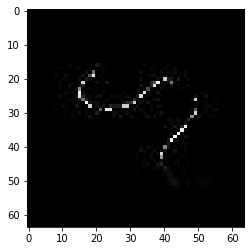

confidence for 16779 is 0.9937971


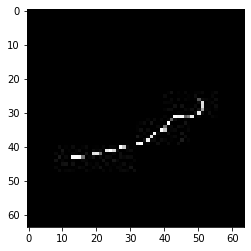

confidence for 16794 is 0.9998889


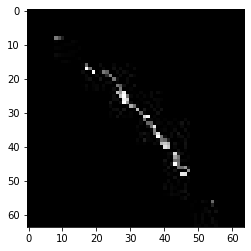

confidence for 16798 is 0.97679645


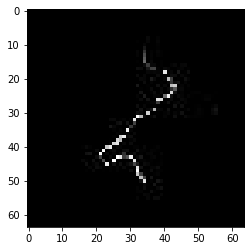

confidence for 16824 is 0.9285093


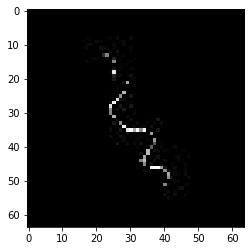

confidence for 16832 is 0.96736187


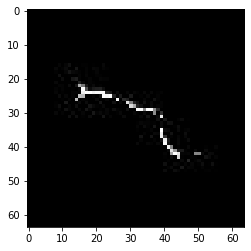

confidence for 16860 is 0.7201254


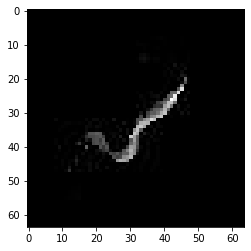

confidence for 16865 is 0.8317535


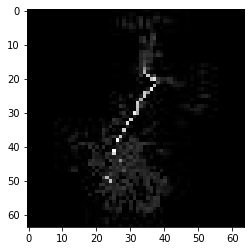

confidence for 16867 is 0.988325


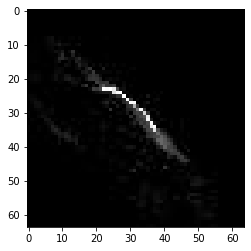

confidence for 16877 is 0.9999328


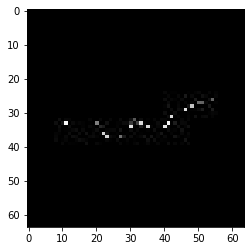

confidence for 16884 is 0.98207027


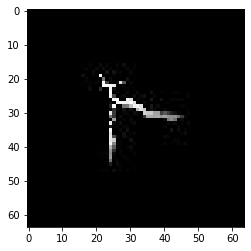

confidence for 16908 is 0.91776377


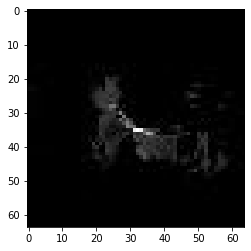

confidence for 16924 is 0.84144086


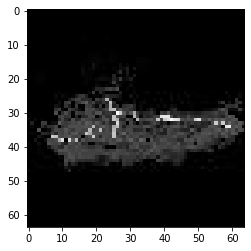

confidence for 16931 is 0.87133497


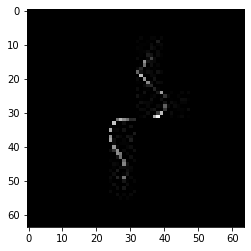

confidence for 16938 is 0.818092


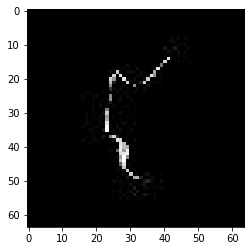

confidence for 16943 is 0.999845


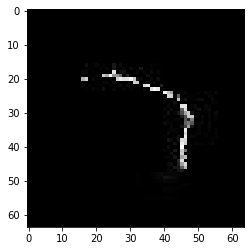

confidence for 16948 is 0.9996032


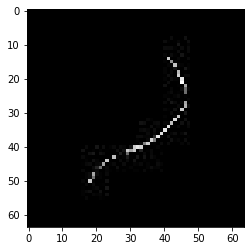

confidence for 16954 is 0.99982965


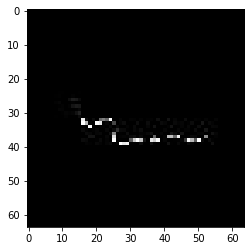

confidence for 16956 is 0.98870397


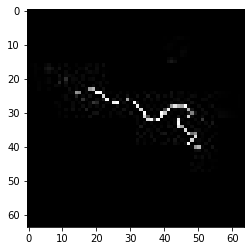

confidence for 16963 is 0.79736614


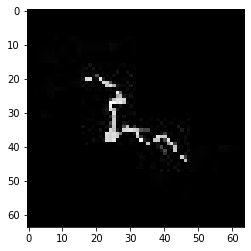

confidence for 16970 is 0.84167874


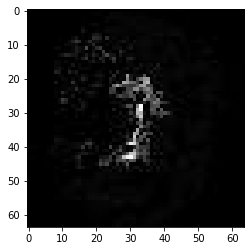

confidence for 16975 is 0.9962797


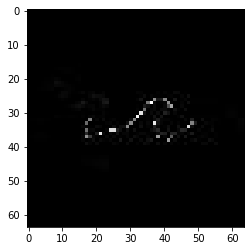

confidence for 16977 is 0.92686325


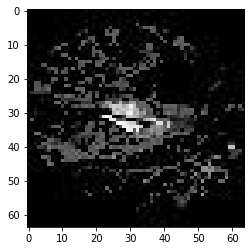

confidence for 16988 is 0.9966081


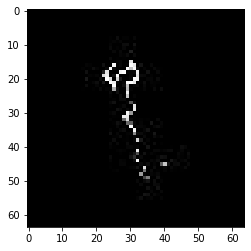

confidence for 16996 is 0.97518116


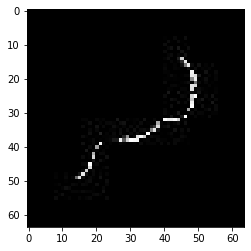

confidence for 17003 is 0.9977692


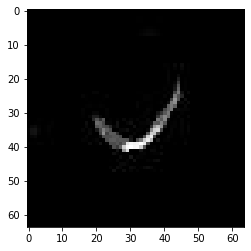

confidence for 17008 is 0.9732362


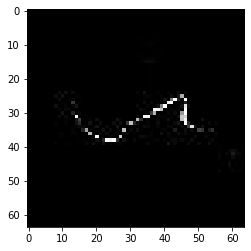

confidence for 17010 is 0.9949551


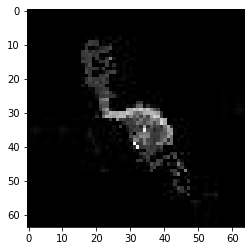

confidence for 17012 is 0.87599


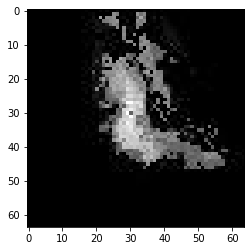

confidence for 17016 is 0.97656184


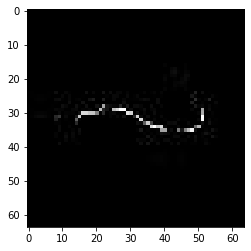

confidence for 17033 is 0.99161005


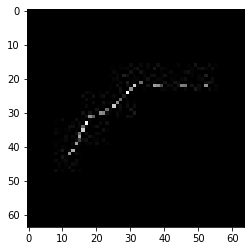

confidence for 17040 is 0.8715054


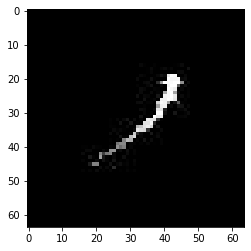

confidence for 17051 is 0.9999441


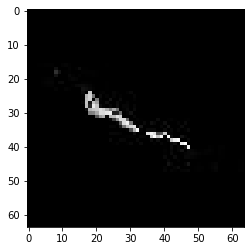

confidence for 17056 is 0.98354274


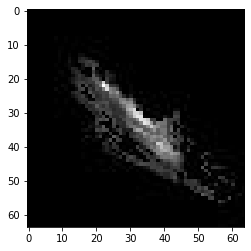

confidence for 17061 is 0.9949823


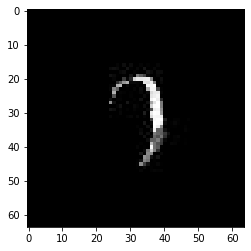

confidence for 17063 is 0.999987


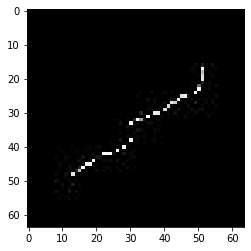

confidence for 17065 is 0.95487005


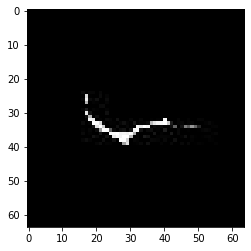

confidence for 17076 is 0.99897164


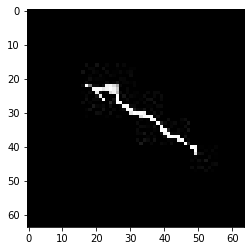

confidence for 17087 is 0.99128014


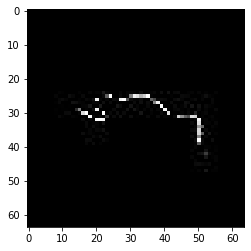

confidence for 17093 is 0.9978228


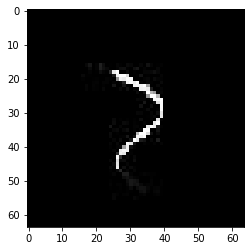

confidence for 17097 is 0.9999362


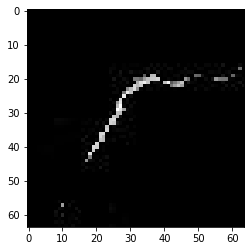

confidence for 17104 is 0.9992392


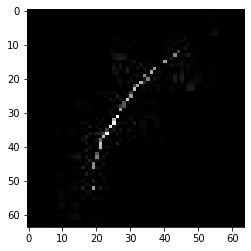

confidence for 17110 is 0.9896793


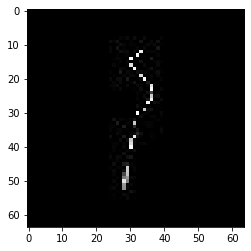

confidence for 17118 is 0.9698087


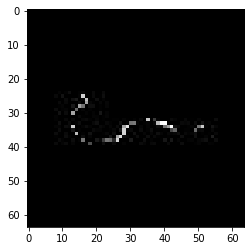

confidence for 17119 is 0.9999567


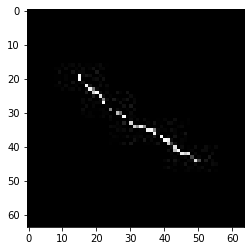

confidence for 17120 is 0.976336


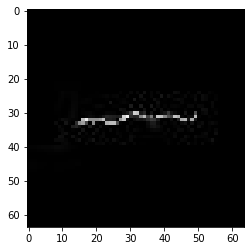

confidence for 17125 is 0.98529804


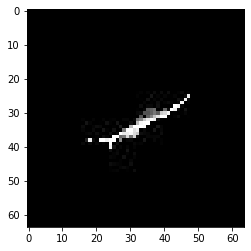

confidence for 17127 is 0.9997908


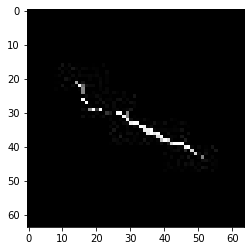

confidence for 17139 is 0.9036126


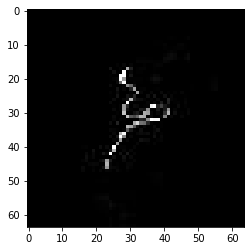

confidence for 17152 is 0.72932917


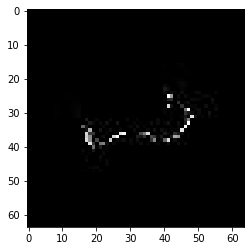

confidence for 17159 is 0.9997736


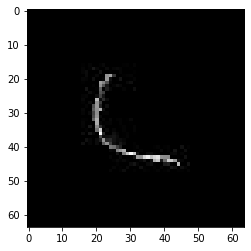

confidence for 17162 is 0.92589194


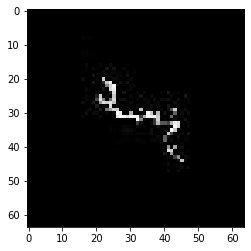

confidence for 17176 is 0.9029977


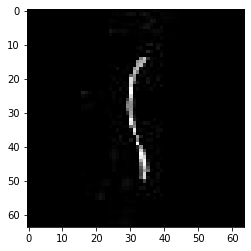

confidence for 17177 is 0.99993616


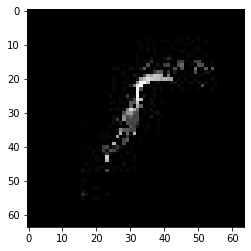

confidence for 17179 is 0.9904334


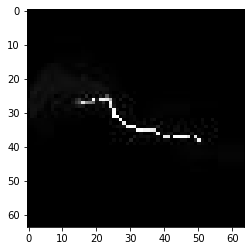

confidence for 17200 is 0.72566205


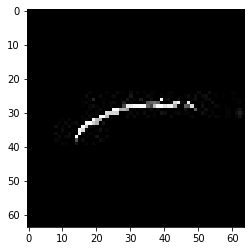

confidence for 17202 is 0.9731343


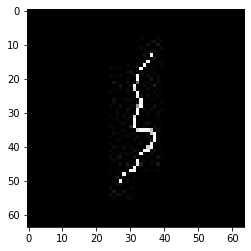

confidence for 17203 is 0.95459366


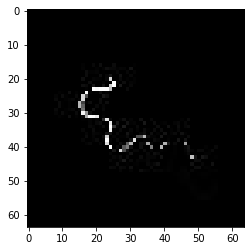

confidence for 17219 is 0.8909903


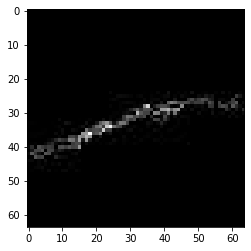

confidence for 17224 is 0.8297513


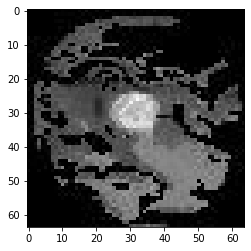

confidence for 17237 is 0.9990531


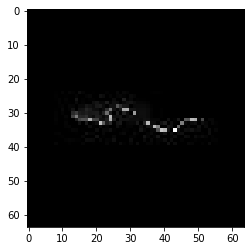

confidence for 17238 is 0.84136856


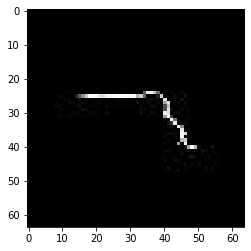

confidence for 17240 is 0.9550782


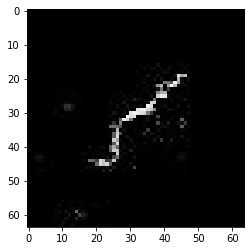

confidence for 17245 is 0.9924757


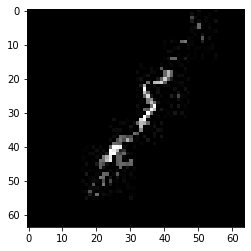

confidence for 17254 is 0.840669


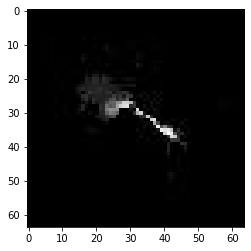

confidence for 17256 is 0.98250055


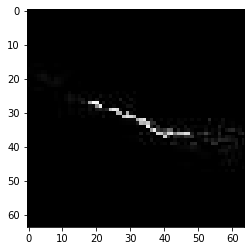

confidence for 17270 is 0.9595221


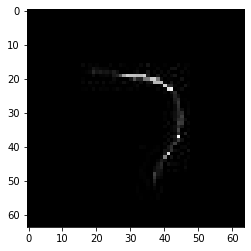

confidence for 17272 is 0.9892501


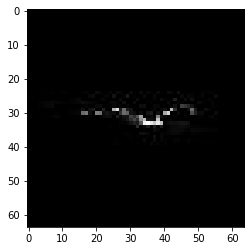

confidence for 17279 is 0.8769833


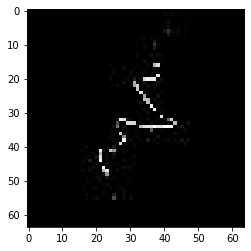

confidence for 17285 is 0.9943549


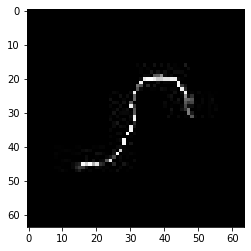

confidence for 17290 is 0.84325296


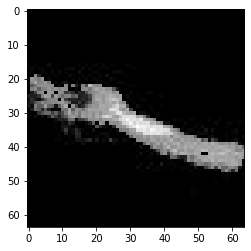

confidence for 17291 is 0.7489877


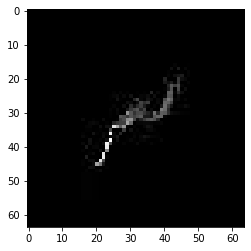

confidence for 17293 is 0.99832827


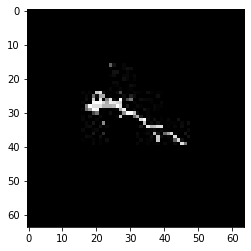

confidence for 17298 is 0.9886932


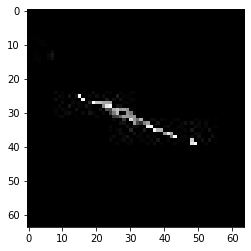

confidence for 17303 is 0.99936724


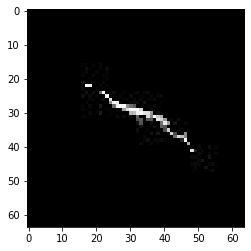

confidence for 17304 is 0.98592544


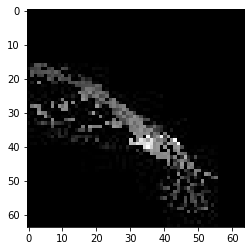

confidence for 17307 is 0.9984747


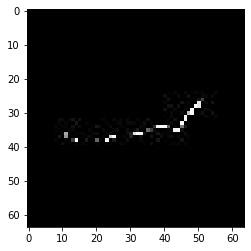

confidence for 17311 is 0.99964213


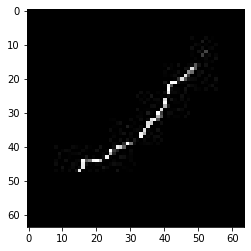

confidence for 17312 is 0.995371


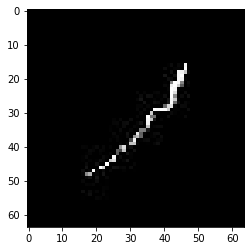

confidence for 17323 is 0.9770783


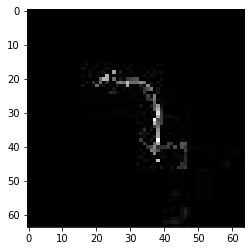

confidence for 17326 is 0.9324065


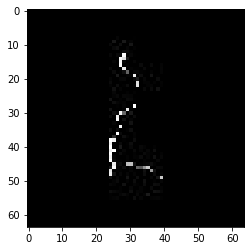

confidence for 17332 is 0.9923574


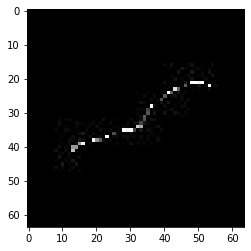

confidence for 17342 is 0.9992178


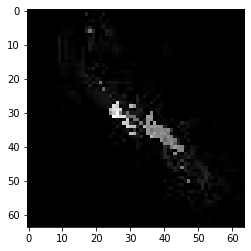

confidence for 17343 is 0.9988989


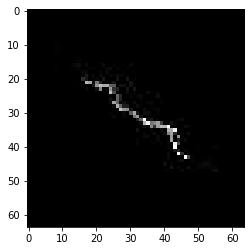

confidence for 17345 is 0.9562005


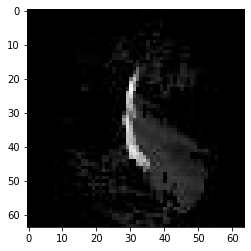

confidence for 17350 is 0.80117816


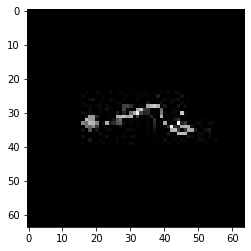

confidence for 17355 is 0.7969924


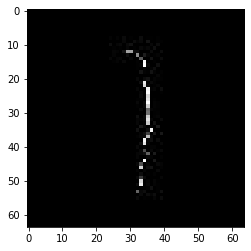

confidence for 17368 is 0.87687653


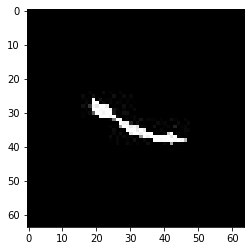

confidence for 17375 is 0.9924505


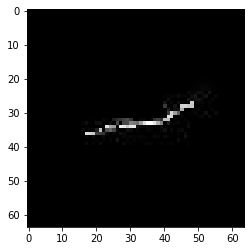

confidence for 17377 is 0.9999533


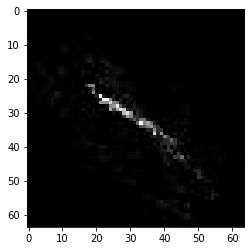

confidence for 17379 is 0.9844247


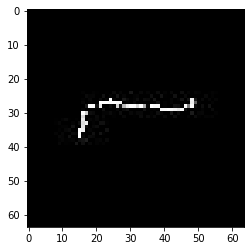

confidence for 17380 is 0.983076


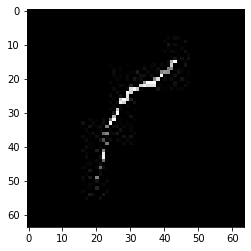

confidence for 17382 is 0.986144


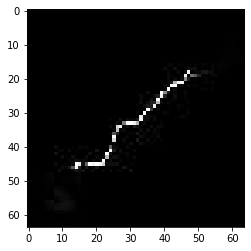

confidence for 17389 is 0.99853075


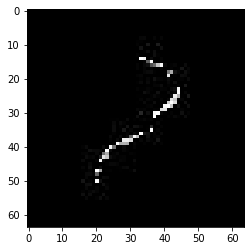

confidence for 17392 is 0.99553347


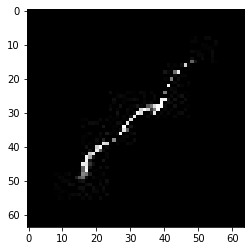

confidence for 17404 is 0.8308901


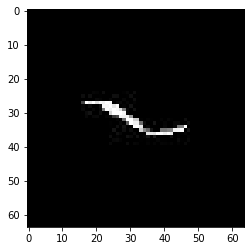

confidence for 17406 is 0.999979


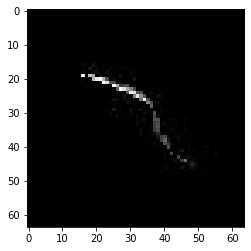

confidence for 17410 is 0.71034175


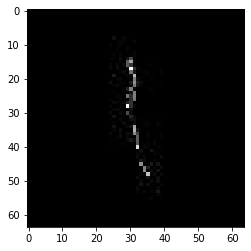

confidence for 17412 is 0.933775


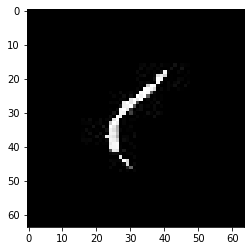

confidence for 17414 is 1.0


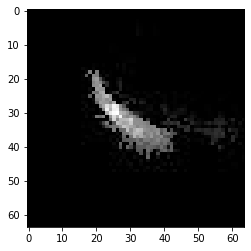

confidence for 17419 is 0.99430877


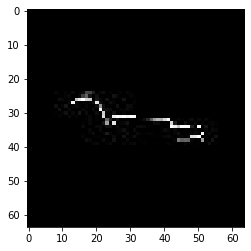

confidence for 17422 is 0.9999982


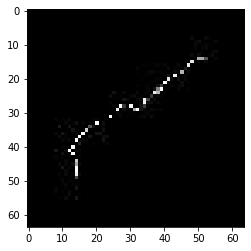

confidence for 17427 is 0.92950785


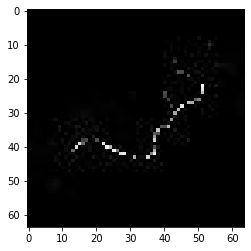

confidence for 17429 is 0.9900519


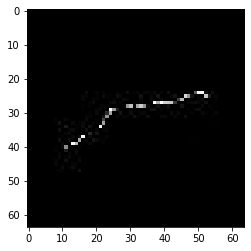

confidence for 17441 is 0.99601036


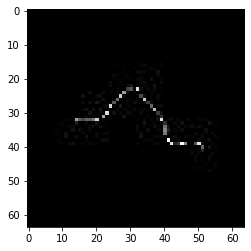

confidence for 17442 is 0.99929494


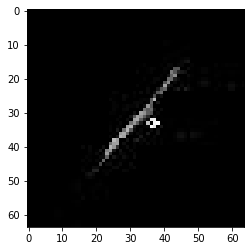

confidence for 17457 is 0.99993515


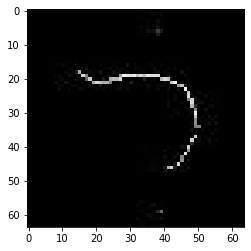

confidence for 17462 is 0.9454186


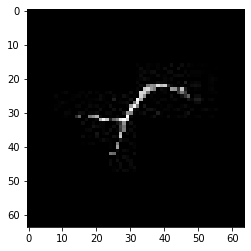

confidence for 17470 is 0.9999749


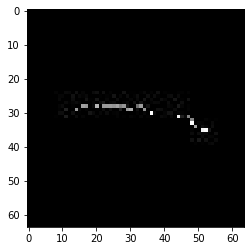

confidence for 17471 is 0.9979216


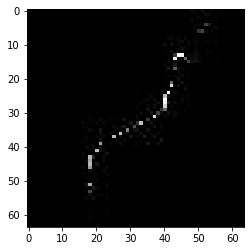

confidence for 17475 is 0.7448982


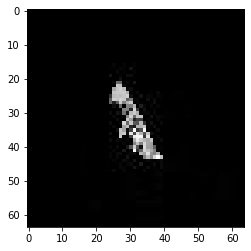

confidence for 17477 is 0.9823872


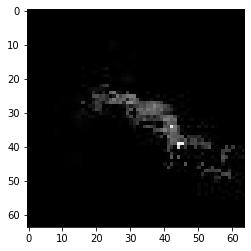

confidence for 17483 is 0.99877197


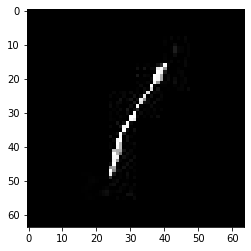

confidence for 17484 is 0.99989223


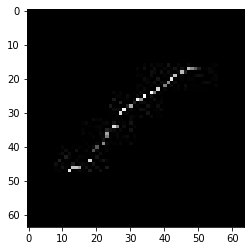

confidence for 17485 is 0.7730814


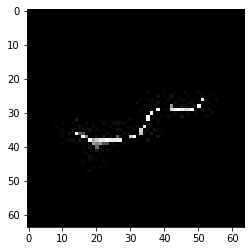

confidence for 17486 is 0.9976388


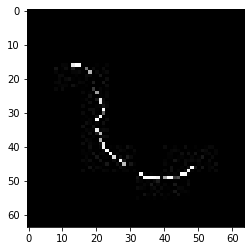

confidence for 17496 is 0.9993033


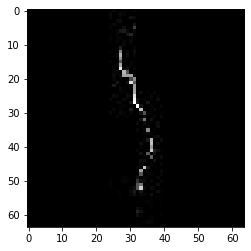

confidence for 17497 is 0.9939459


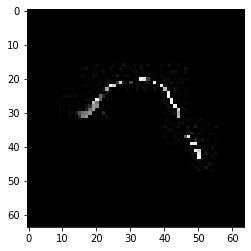

confidence for 17515 is 0.8629708


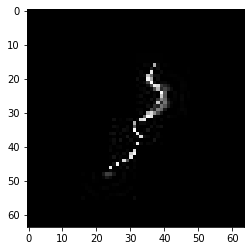

confidence for 17525 is 0.9990069


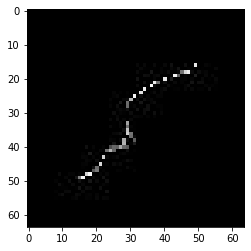

confidence for 17536 is 0.9964902


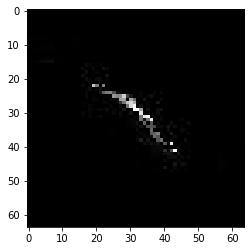

confidence for 17537 is 0.9987653


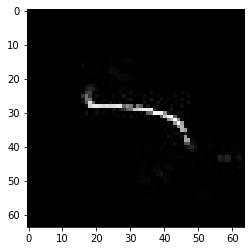

confidence for 17538 is 0.9997113


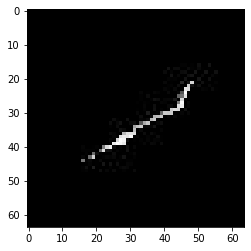

confidence for 17544 is 0.9831547


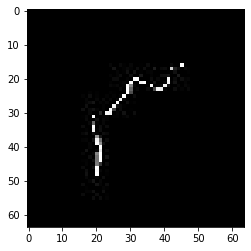

confidence for 17545 is 0.998606


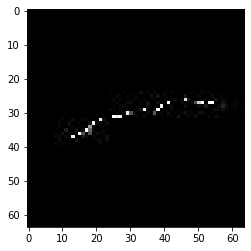

confidence for 17551 is 0.816629


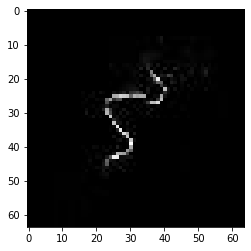

confidence for 17558 is 0.9978711


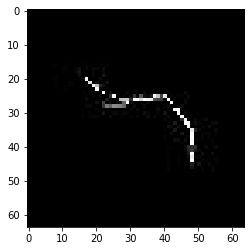

confidence for 17562 is 0.8311753


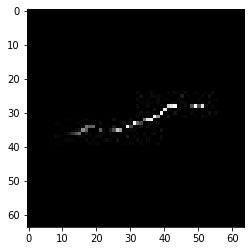

confidence for 17564 is 0.99658513


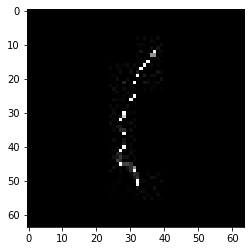

confidence for 17565 is 0.9172388


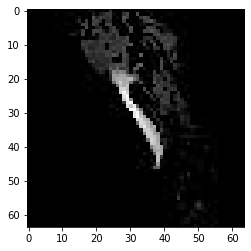

confidence for 17570 is 0.8900957


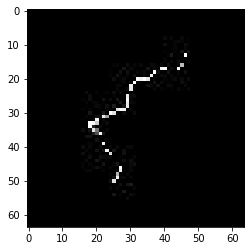

confidence for 17574 is 0.9496567


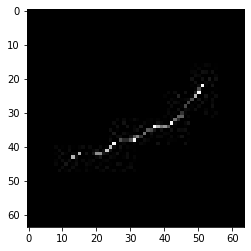

confidence for 17576 is 0.93122977


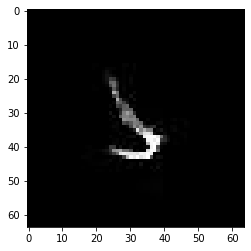

confidence for 17580 is 0.97603303


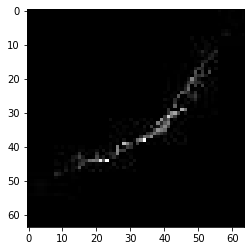

confidence for 17595 is 0.9601081


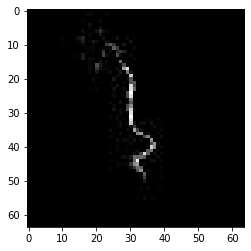

confidence for 17596 is 0.7297947


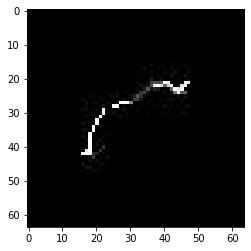

confidence for 17598 is 0.99838513


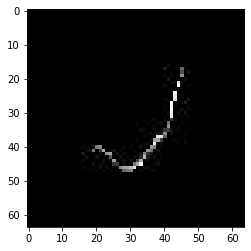

confidence for 17603 is 0.9250304


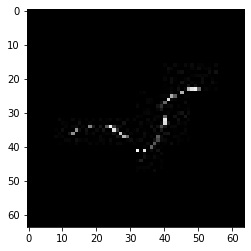

confidence for 17617 is 0.99894536


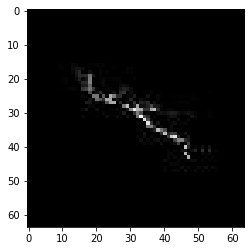

confidence for 17618 is 0.94668317


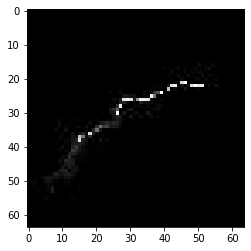

confidence for 17623 is 0.99803984


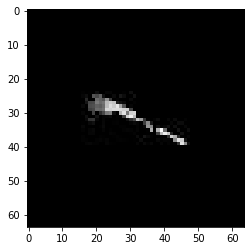

confidence for 17630 is 0.70311314


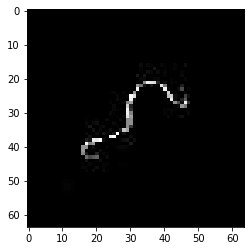

confidence for 17636 is 0.893621


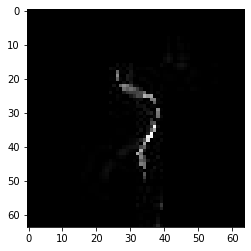

confidence for 17642 is 0.99857724


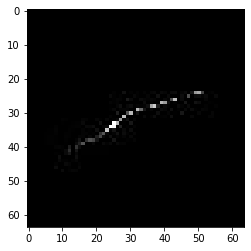

confidence for 17647 is 0.9896211


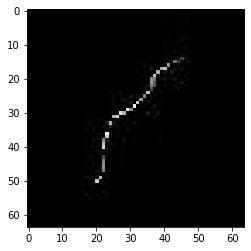

confidence for 17651 is 0.9938691


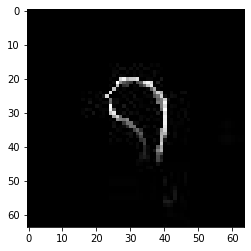

confidence for 17653 is 0.989355


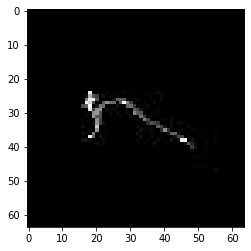

confidence for 17656 is 0.98890656


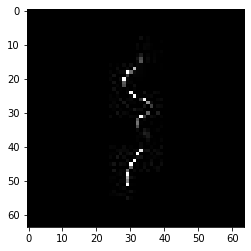

confidence for 17664 is 0.90615463


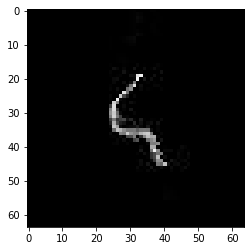

confidence for 17667 is 0.9961539


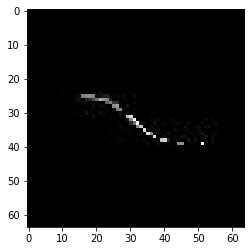

confidence for 17668 is 0.97273505


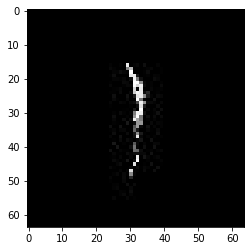

confidence for 17682 is 0.9999988


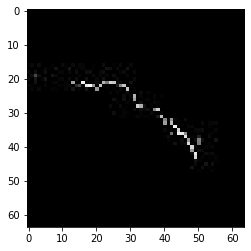

confidence for 17691 is 0.99942154


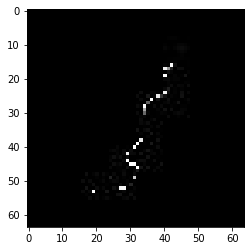

confidence for 17698 is 0.8924836


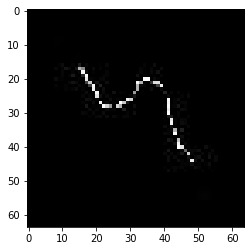

confidence for 17699 is 0.9890178


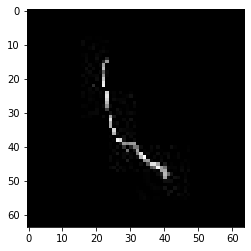

confidence for 17703 is 0.95800555


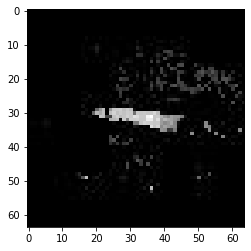

confidence for 17704 is 0.996228


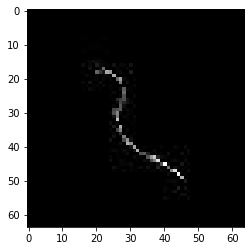

confidence for 17714 is 0.9934771


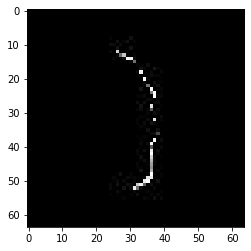

confidence for 17716 is 0.71005154


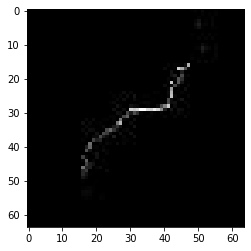

confidence for 17721 is 0.9999955


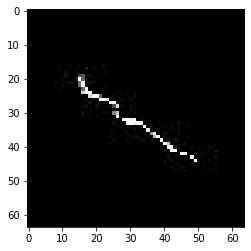

confidence for 17733 is 0.9985901


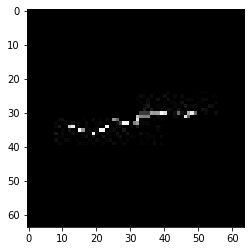

confidence for 17743 is 0.9857084


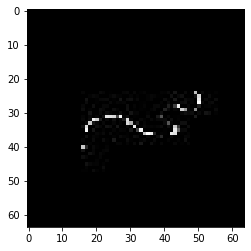

confidence for 17750 is 0.7344911


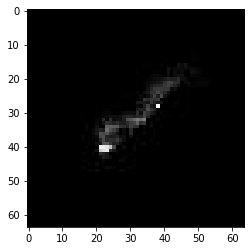

confidence for 17759 is 0.72263086


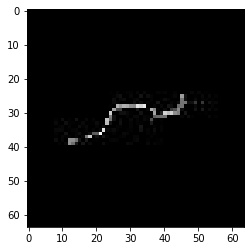

confidence for 17764 is 0.991838


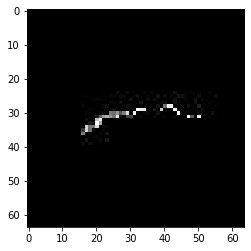

confidence for 17765 is 0.99999756


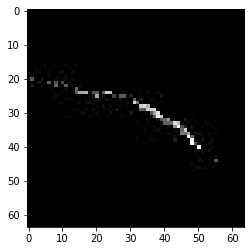

confidence for 17770 is 0.9575686


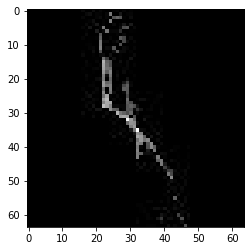

confidence for 17771 is 0.8552762


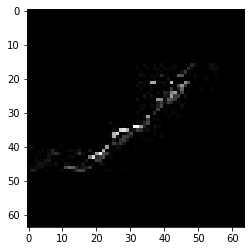

confidence for 17773 is 0.992182


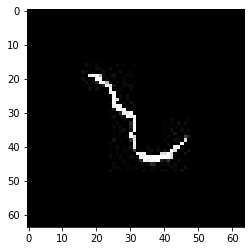

confidence for 17802 is 0.8767221


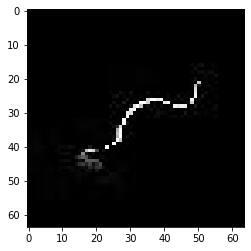

confidence for 17828 is 0.99959224


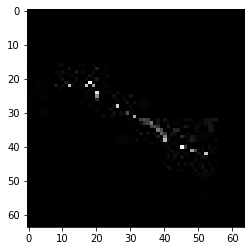

confidence for 17847 is 0.9999989


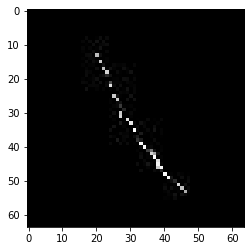

confidence for 17854 is 0.75810516


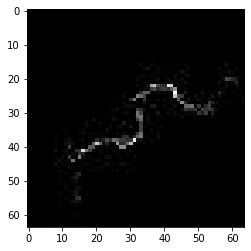

confidence for 17866 is 0.7931691


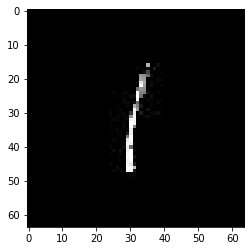

confidence for 17869 is 0.99945486


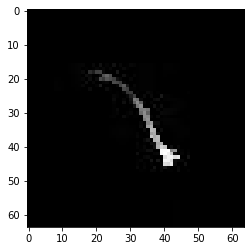

confidence for 17873 is 0.99815345


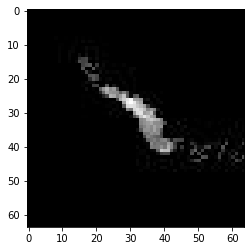

confidence for 17885 is 0.7732484


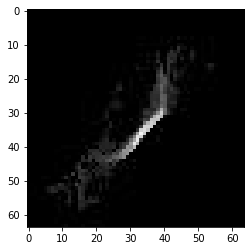

confidence for 17887 is 0.99193025


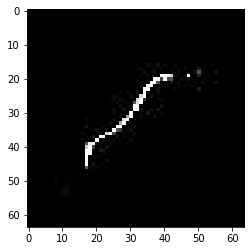

confidence for 17889 is 0.98304945


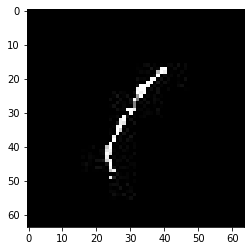

confidence for 17890 is 1.0


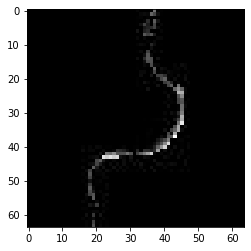

confidence for 17904 is 0.97173804


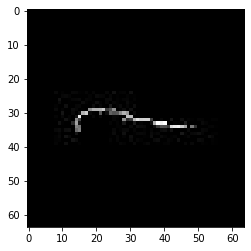

confidence for 17905 is 0.9999302


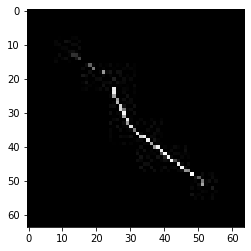

confidence for 17926 is 0.99597853


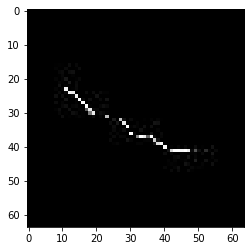

confidence for 17932 is 0.9623743


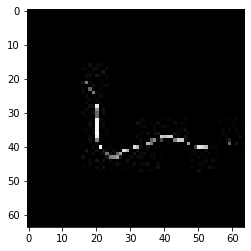

confidence for 17959 is 0.97991925


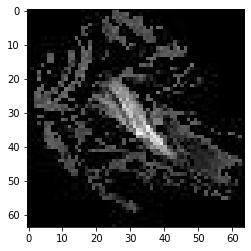

confidence for 17962 is 0.8020172


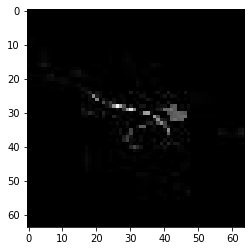

confidence for 17963 is 0.9004286


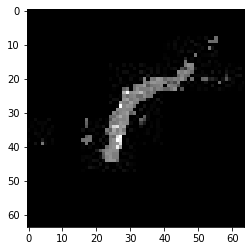

confidence for 17980 is 0.9867488


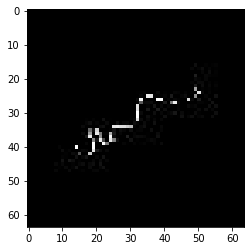

confidence for 17986 is 0.9780894


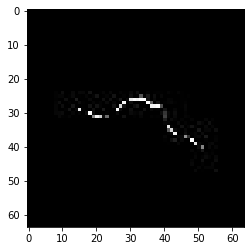

confidence for 17991 is 0.99716914


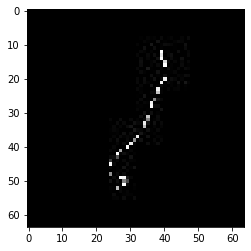

confidence for 17997 is 0.94851345


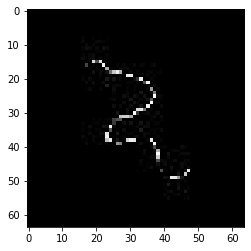

confidence for 18006 is 0.9914923


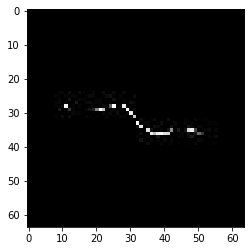

confidence for 18010 is 0.98167914


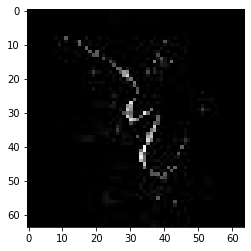

confidence for 18012 is 0.9782479


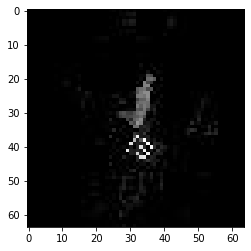

confidence for 18015 is 0.92931676


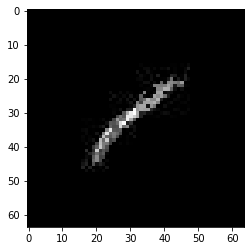

confidence for 18029 is 0.9634197


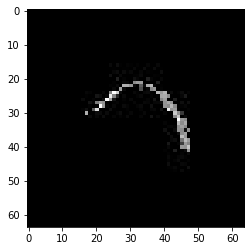

confidence for 18035 is 0.9991722


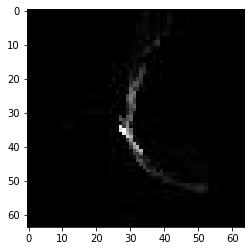

confidence for 18051 is 0.99749964


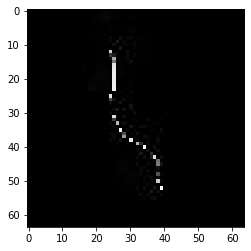

confidence for 18088 is 0.98648006


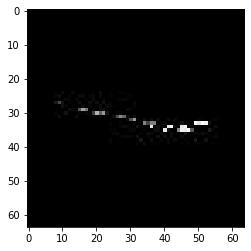

confidence for 18089 is 0.9999998


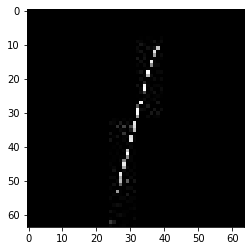

confidence for 18096 is 0.9999886


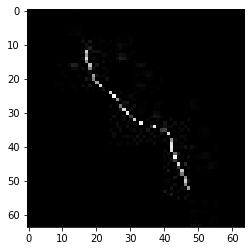

confidence for 18106 is 0.9964813


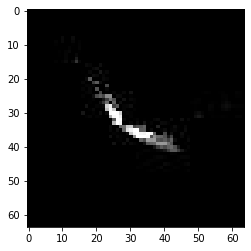

confidence for 18120 is 0.8861681


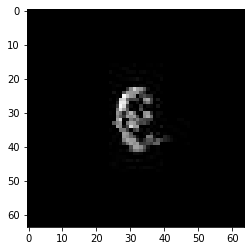

confidence for 18123 is 0.85539603


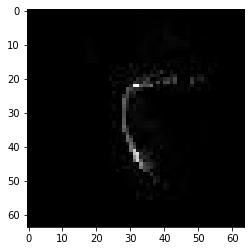

confidence for 18124 is 0.9859115


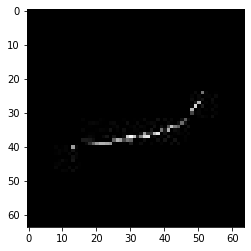

confidence for 18144 is 0.96018386


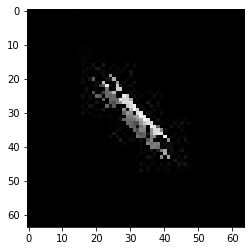

confidence for 18150 is 0.84792805


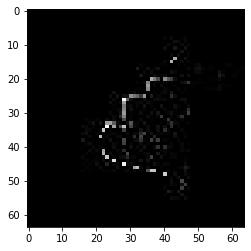

confidence for 18151 is 0.91699845


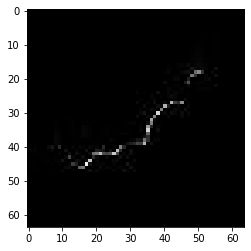

confidence for 18152 is 0.9796324


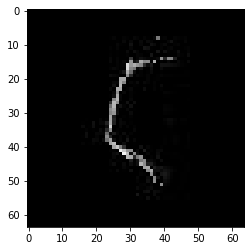

confidence for 18168 is 0.98249626


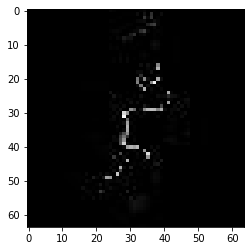

confidence for 18172 is 0.99749804


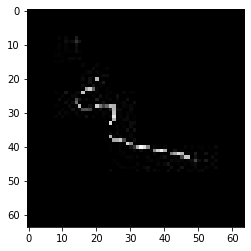

confidence for 18174 is 0.9191218


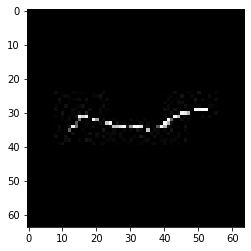

confidence for 18181 is 0.97361565


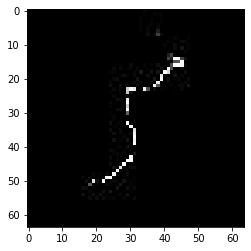

confidence for 18191 is 0.99527335


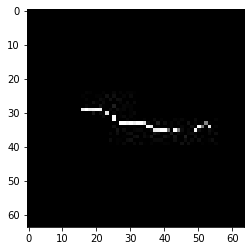

confidence for 18200 is 0.99992937


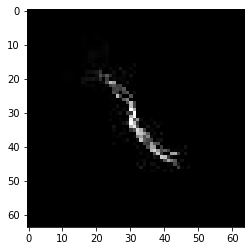

confidence for 18203 is 0.7763653


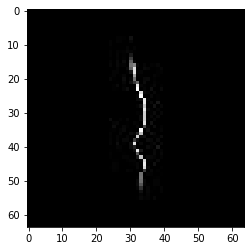

confidence for 18204 is 0.7158144


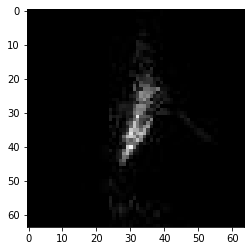

confidence for 18219 is 0.93265873


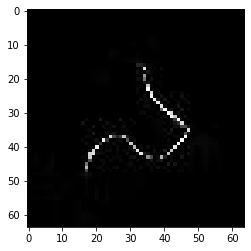

confidence for 18221 is 0.988484


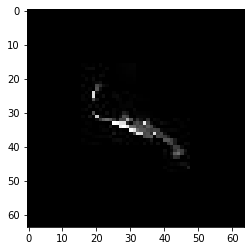

confidence for 18223 is 0.9999258


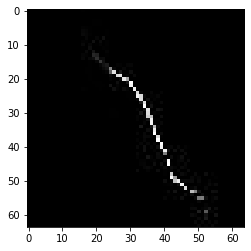

confidence for 18240 is 0.9529459


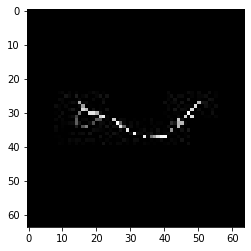

confidence for 18242 is 0.994661


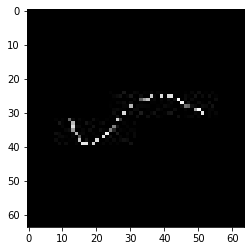

confidence for 18247 is 0.99990326


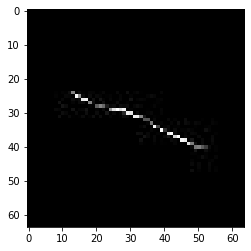

confidence for 18260 is 0.89237666


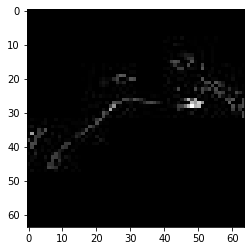

confidence for 18261 is 0.94327193


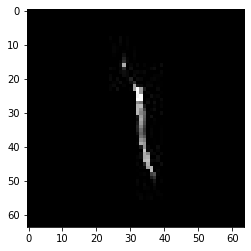

confidence for 18262 is 0.95469916


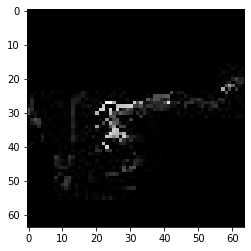

confidence for 18265 is 0.7028035


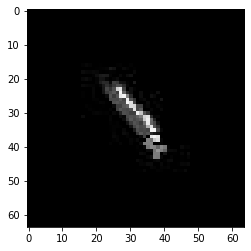

confidence for 18272 is 0.9992493


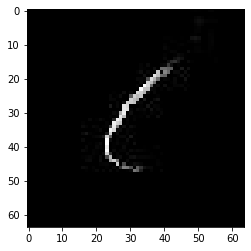

confidence for 18282 is 0.9901449


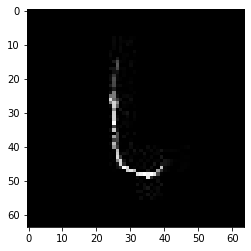

confidence for 18284 is 0.9911239


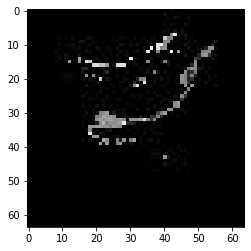

confidence for 18323 is 0.98699117


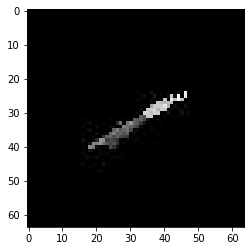

confidence for 18325 is 0.9812818


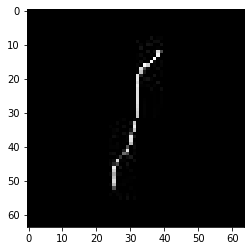

confidence for 18328 is 0.80191046


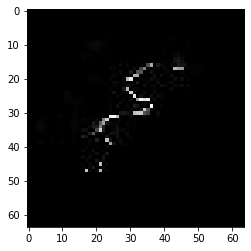

confidence for 18329 is 0.954139


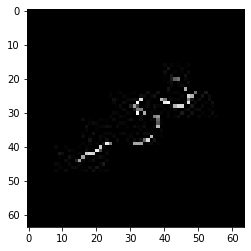

confidence for 18330 is 0.8400257


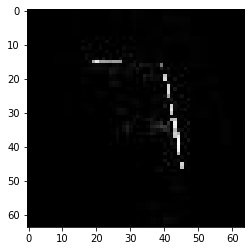

confidence for 18341 is 0.99533373


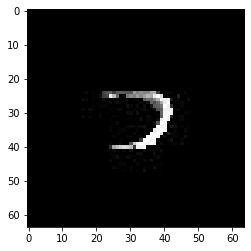

confidence for 18348 is 0.7021468


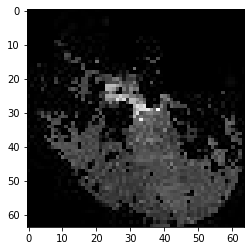

confidence for 18357 is 0.9872114


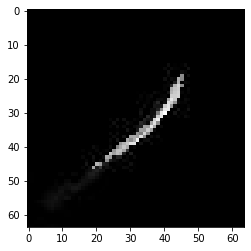

confidence for 18358 is 0.99829495


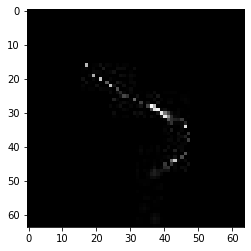

confidence for 18361 is 0.9997311


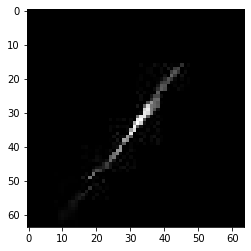

confidence for 18368 is 0.9998215


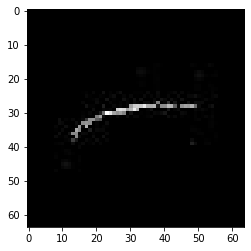

confidence for 18373 is 0.9996693


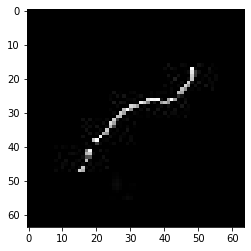

confidence for 18377 is 0.9909892


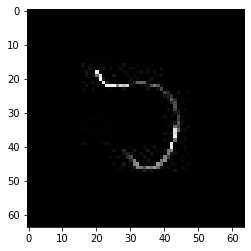

confidence for 18384 is 0.9665217


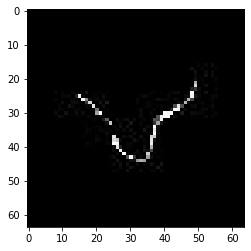

confidence for 18389 is 0.964395


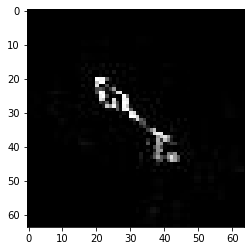

confidence for 18397 is 0.95755935


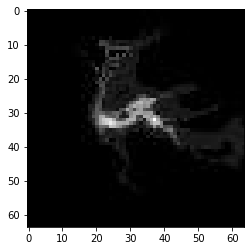

confidence for 18406 is 0.7477071


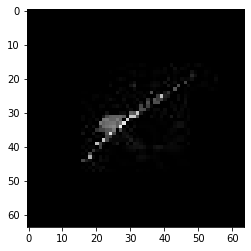

confidence for 18411 is 0.9992495


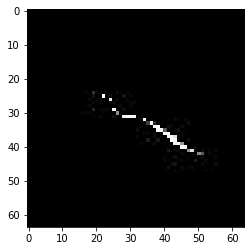

confidence for 18413 is 0.9951398


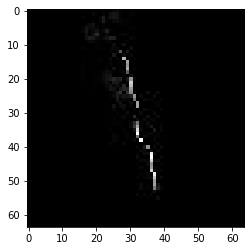

confidence for 18416 is 0.999998


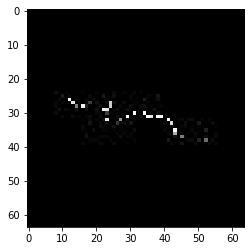

confidence for 18417 is 0.9953616


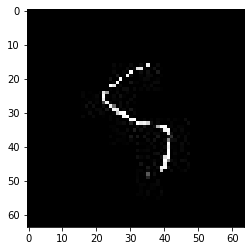

confidence for 18429 is 0.999135


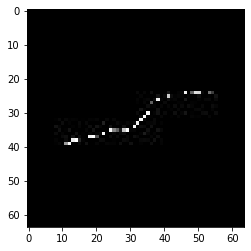

confidence for 18445 is 0.94481766


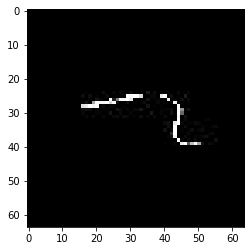

confidence for 18446 is 0.96610343


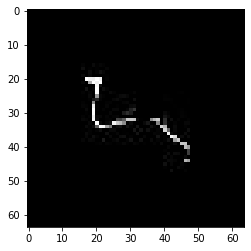

confidence for 18464 is 0.8155688


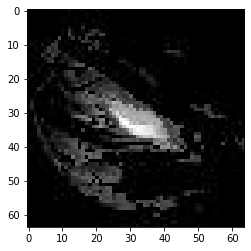

confidence for 18466 is 0.994661


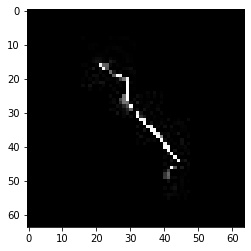

confidence for 18471 is 0.94636583


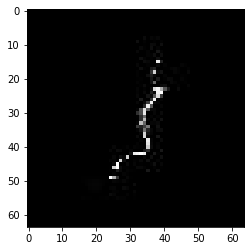

confidence for 18474 is 0.999952


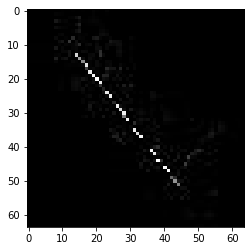

confidence for 18493 is 0.93992066


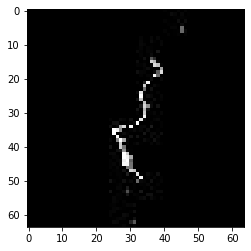

confidence for 18497 is 0.9302524


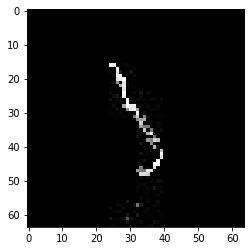

confidence for 18515 is 0.7429605


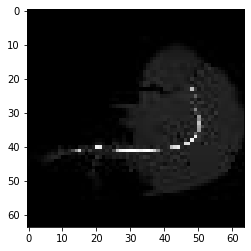

confidence for 18554 is 0.9985225


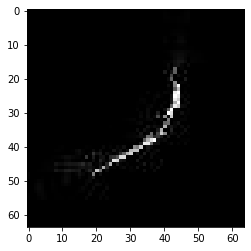

confidence for 18555 is 0.9404966


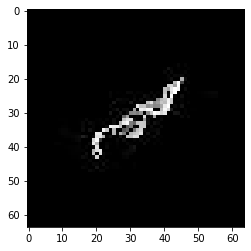

confidence for 18575 is 0.76598054


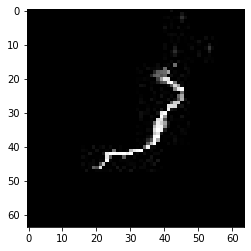

confidence for 18583 is 0.96666676


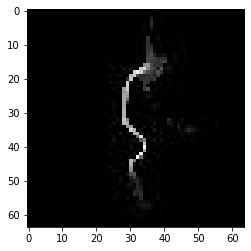

confidence for 18586 is 0.9997197


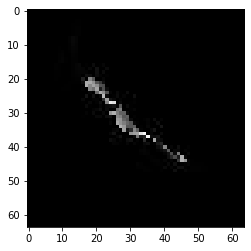

confidence for 18595 is 0.712523


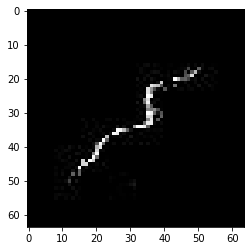

confidence for 18598 is 0.99721843


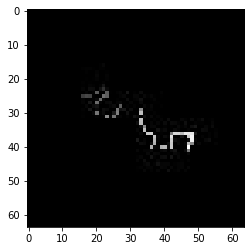

confidence for 18605 is 0.99759763


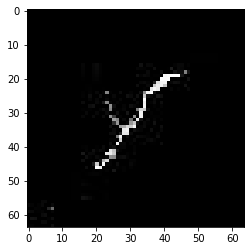

confidence for 18617 is 0.9812145


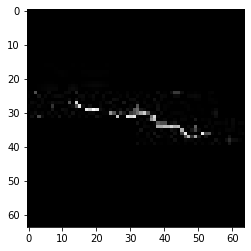

confidence for 18626 is 0.99987155


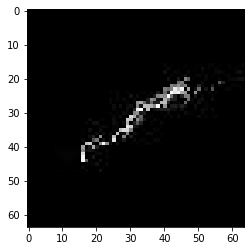

confidence for 18633 is 0.86339706


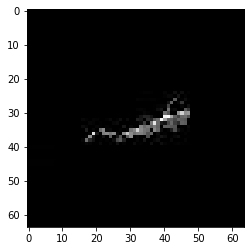

confidence for 18635 is 0.99999976


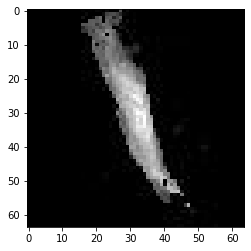

confidence for 18641 is 0.99996173


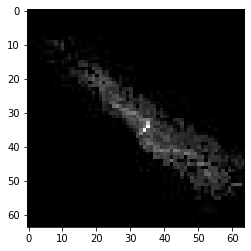

confidence for 18664 is 0.9208516


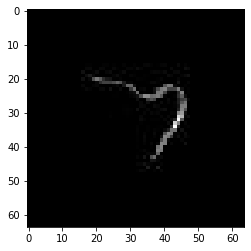

confidence for 18673 is 0.9942934


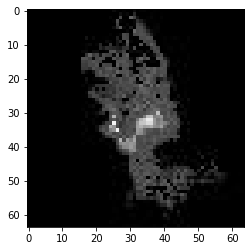

confidence for 18675 is 0.7015789


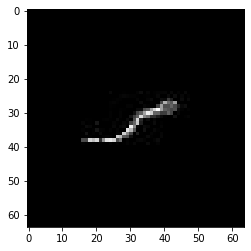

confidence for 18676 is 0.8629659


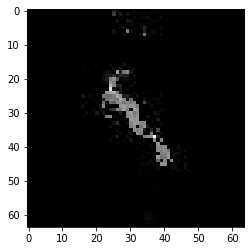

confidence for 18691 is 0.8808532


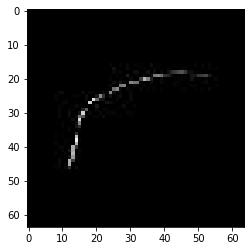

confidence for 18694 is 0.99242175


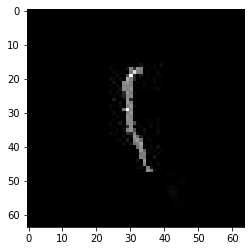

confidence for 18697 is 0.9941026


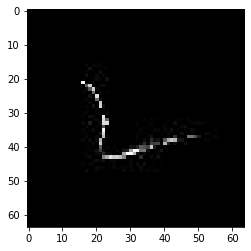

confidence for 18700 is 0.98165506


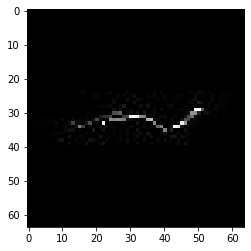

confidence for 18706 is 0.9883516


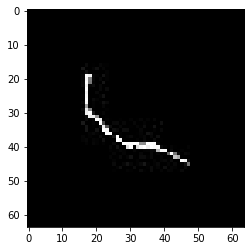

confidence for 18712 is 0.999402


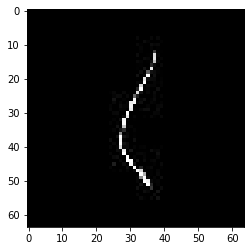

confidence for 18715 is 0.98078805


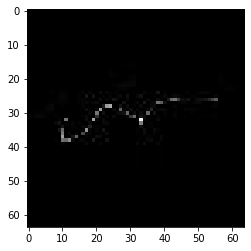

confidence for 18719 is 0.97845453


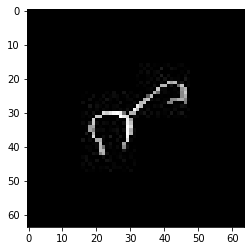

confidence for 18731 is 0.9323497


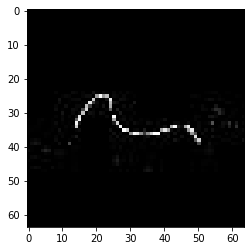

confidence for 18733 is 0.9973622


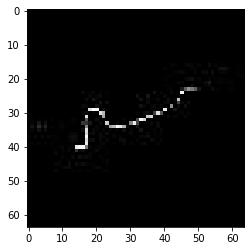

confidence for 18735 is 0.99614304


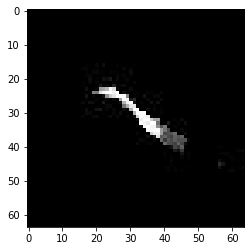

confidence for 18739 is 0.8631415


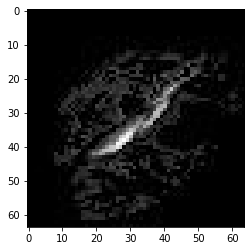

confidence for 18740 is 0.95286113


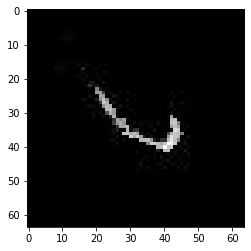

confidence for 18746 is 0.9757793


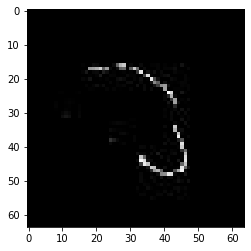

confidence for 18761 is 0.9725275


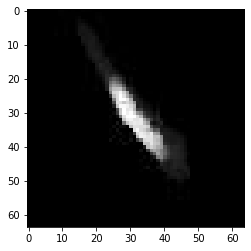

confidence for 18762 is 0.7030061


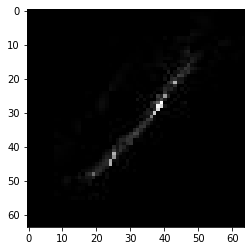

confidence for 18779 is 0.98983586


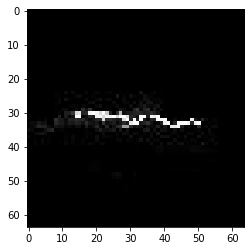

confidence for 18784 is 0.986664


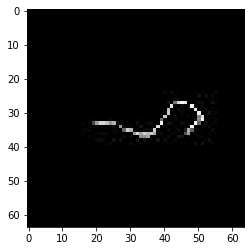

confidence for 18792 is 0.9999988


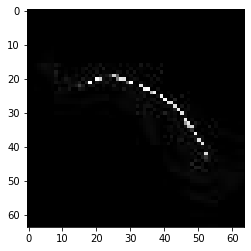

confidence for 18795 is 0.9998414


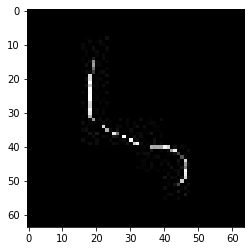

confidence for 18796 is 0.95880264


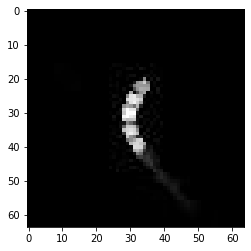

confidence for 18809 is 0.9656343


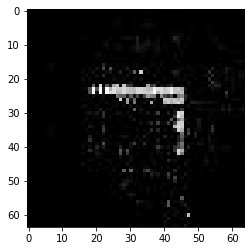

confidence for 18812 is 0.9192249


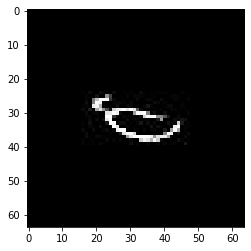

confidence for 18821 is 0.9390162


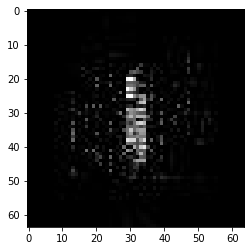

confidence for 18825 is 0.9234204


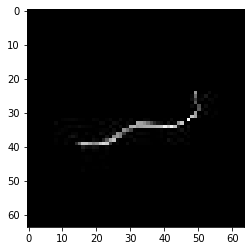

confidence for 18828 is 0.7547949


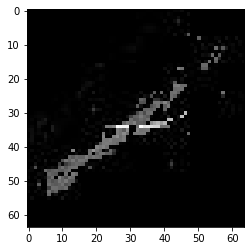

confidence for 18840 is 0.9972803


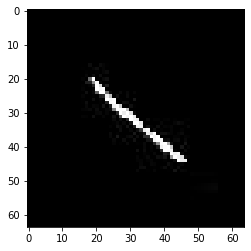

confidence for 18856 is 0.9957972


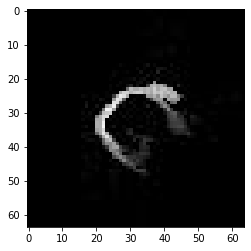

confidence for 18857 is 0.9629553


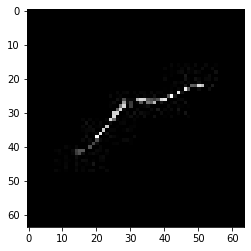

confidence for 18860 is 0.99997413


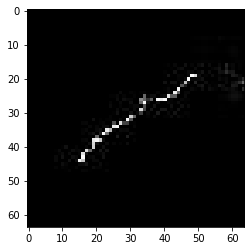

confidence for 18873 is 0.98186785


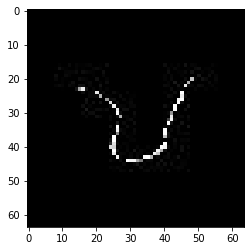

confidence for 18874 is 0.9995933


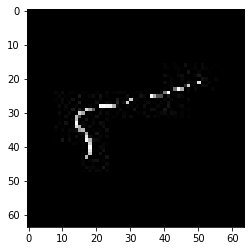

confidence for 18878 is 0.7081126


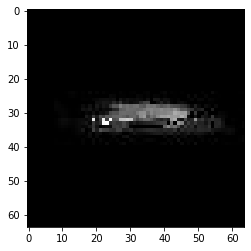

confidence for 18882 is 0.99989456


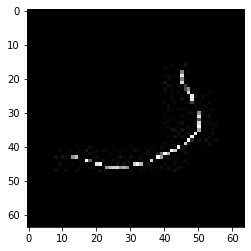

confidence for 18885 is 0.97798115


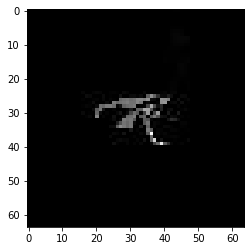

confidence for 18892 is 0.9999351


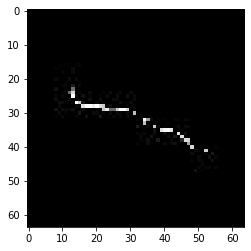

confidence for 18896 is 0.9932708


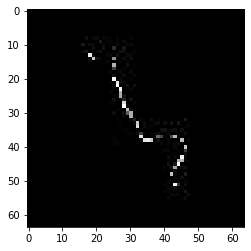

confidence for 18898 is 0.9935485


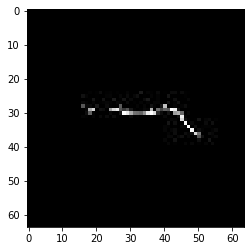

confidence for 18901 is 1.0


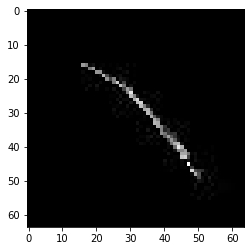

confidence for 18903 is 0.9726642


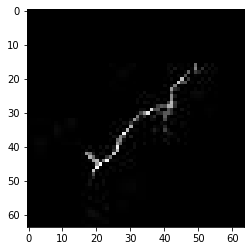

confidence for 18909 is 0.73213595


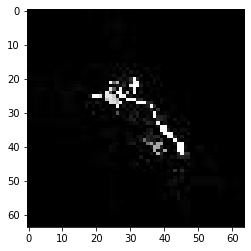

confidence for 18913 is 0.7422446


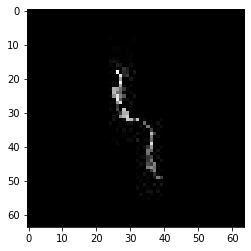

confidence for 18916 is 0.9644025


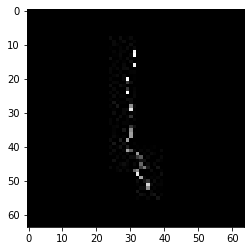

confidence for 18923 is 0.9999992


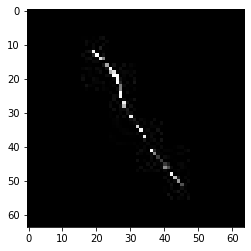

confidence for 18933 is 0.9305509


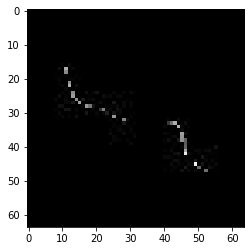

confidence for 18934 is 0.7582418


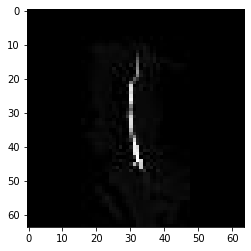

confidence for 18956 is 0.9966953


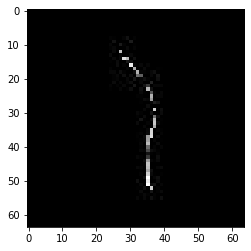

confidence for 18968 is 0.9697858


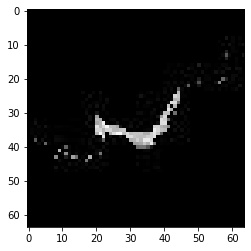

confidence for 18973 is 0.93219686


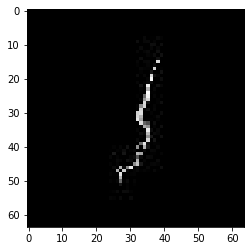

confidence for 18995 is 0.90439755


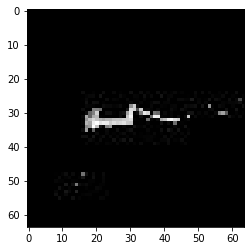

confidence for 19010 is 0.98961467


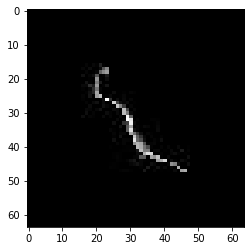

confidence for 19012 is 0.97171265


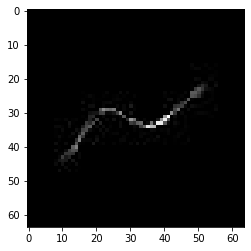

confidence for 19014 is 0.9902432


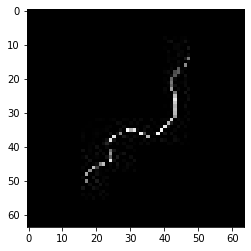

confidence for 19015 is 0.9941053


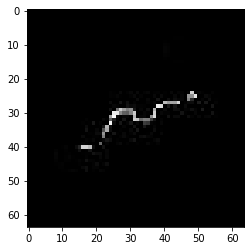

confidence for 19017 is 0.9857125


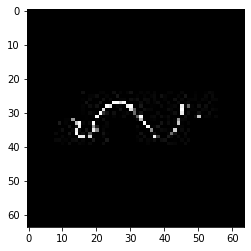

confidence for 19018 is 0.9050887


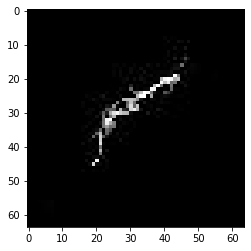

confidence for 19023 is 0.9904586


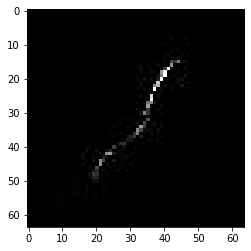

confidence for 19025 is 0.9670567


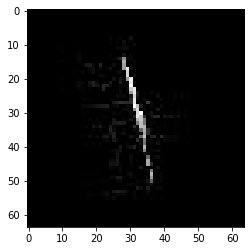

confidence for 19026 is 0.8661766


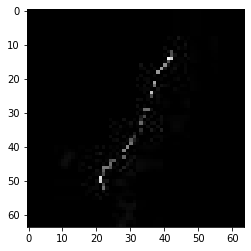

confidence for 19030 is 0.995287


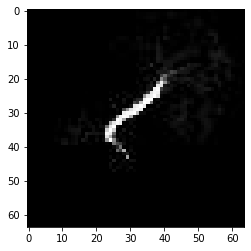

confidence for 19047 is 0.8906761


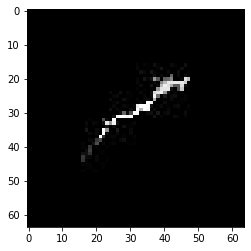

confidence for 19050 is 0.92739505


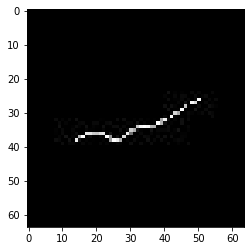

confidence for 19052 is 0.8253893


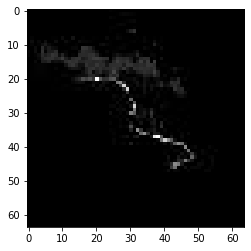

confidence for 19054 is 0.9977127


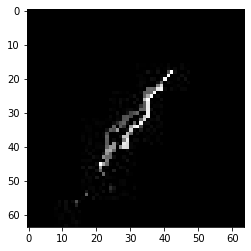

confidence for 19065 is 0.99511176


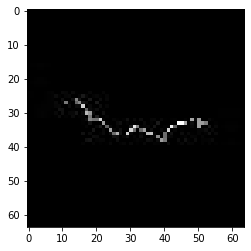

confidence for 19066 is 0.9947618


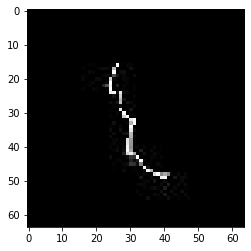

confidence for 19068 is 0.9621226


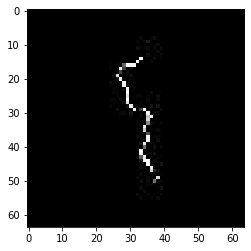

confidence for 19071 is 0.9896029


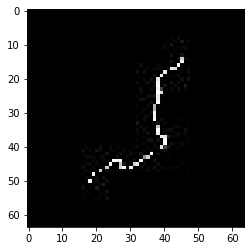

confidence for 19093 is 0.95501184


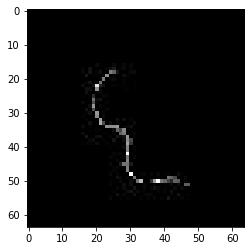

confidence for 19099 is 0.9768604


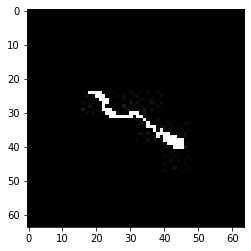

confidence for 19108 is 0.99314994


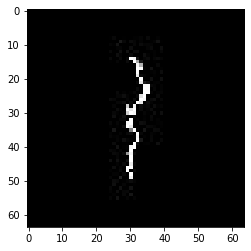

confidence for 19111 is 0.99989504


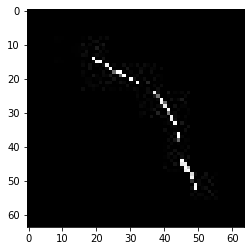

confidence for 19142 is 0.8573778


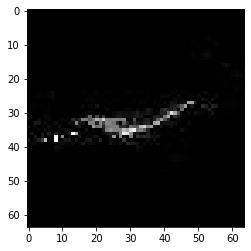

confidence for 19151 is 0.86549455


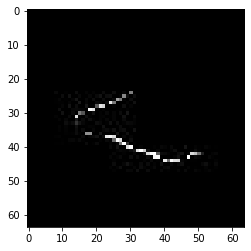

confidence for 19159 is 0.74467134


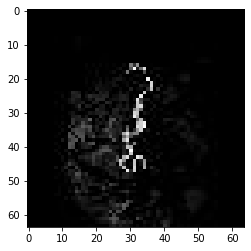

confidence for 19168 is 0.87435013


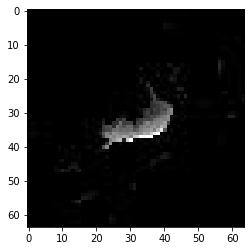

confidence for 19183 is 0.99997425


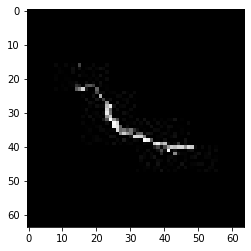

confidence for 19191 is 0.9990229


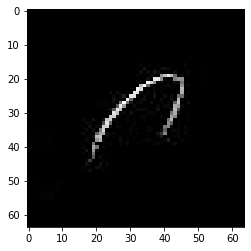

confidence for 19201 is 0.99919415


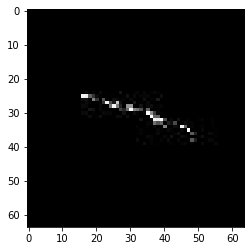

confidence for 19208 is 0.95574886


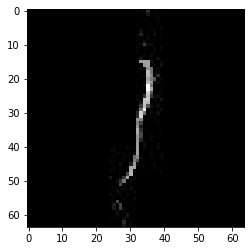

confidence for 19218 is 0.859768


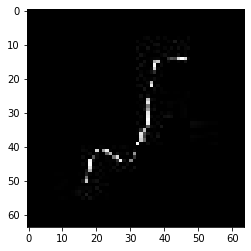

confidence for 19227 is 0.8679875


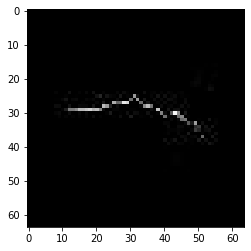

confidence for 19230 is 0.83286476


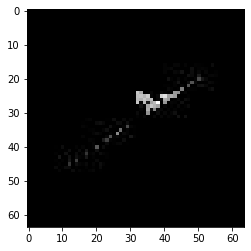

confidence for 19233 is 0.8785078


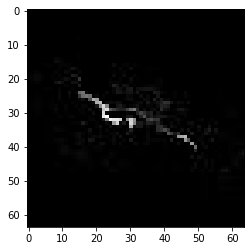

confidence for 19243 is 0.9960567


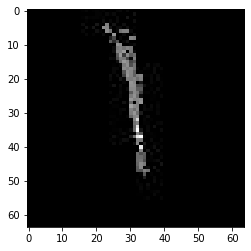

confidence for 19252 is 0.9940493


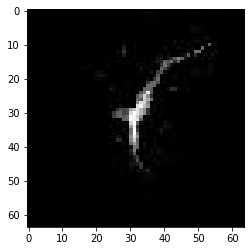

confidence for 19258 is 0.70926976


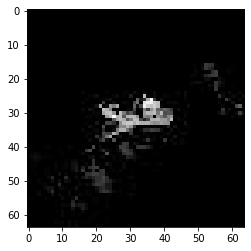

confidence for 19264 is 0.96440285


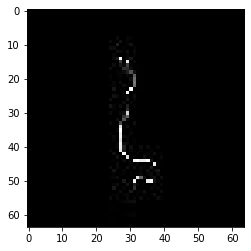

confidence for 19274 is 0.731284


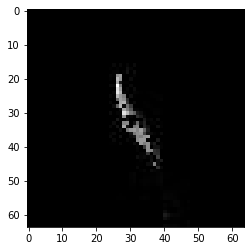

confidence for 19282 is 0.82260454


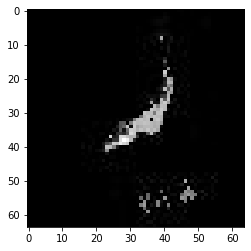

confidence for 19283 is 0.99687296


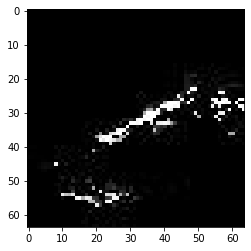

confidence for 19291 is 0.8977841


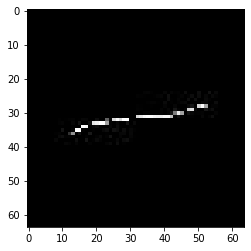

confidence for 19293 is 0.96981126


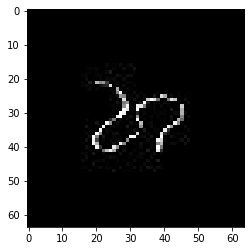

confidence for 19297 is 0.98709327


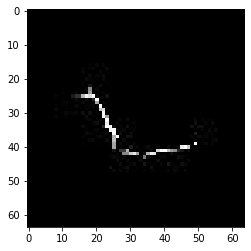

confidence for 19301 is 0.9991134


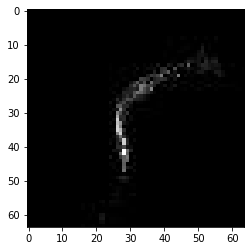

confidence for 19304 is 0.7953289


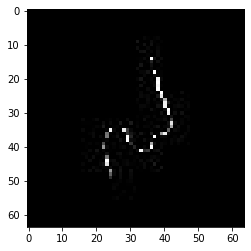

confidence for 19307 is 0.9874185


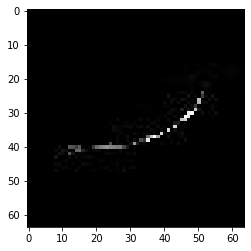

confidence for 19315 is 0.9992555


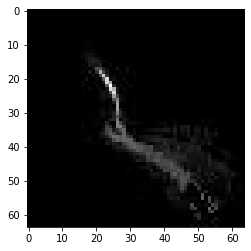

confidence for 19329 is 0.9928364


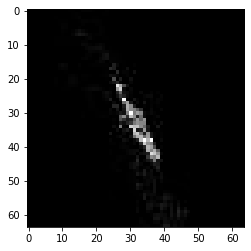

confidence for 19343 is 0.9595269


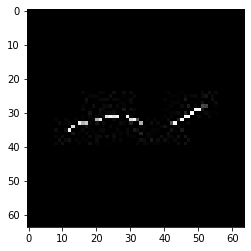

confidence for 19350 is 0.9645148


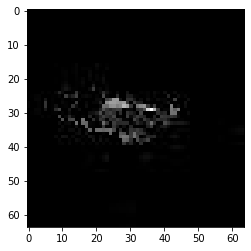

confidence for 19361 is 0.9994598


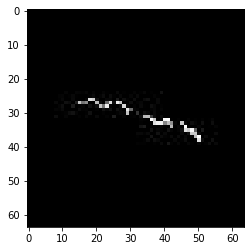

confidence for 19366 is 0.91165155


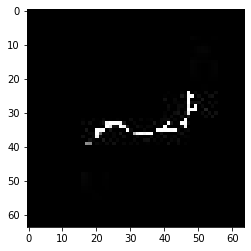

confidence for 19399 is 0.8033174


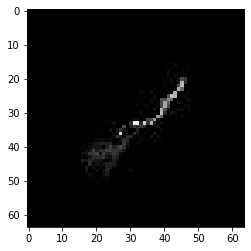

confidence for 19414 is 0.9995131


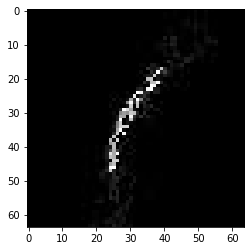

confidence for 19428 is 0.99948037


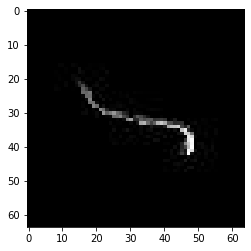

confidence for 19431 is 0.99999815


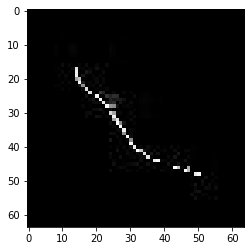

confidence for 19435 is 0.9380244


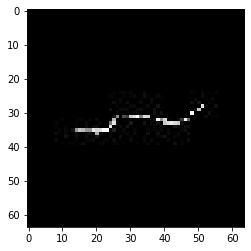

confidence for 19458 is 0.7374758


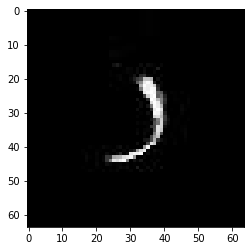

confidence for 19459 is 0.9231531


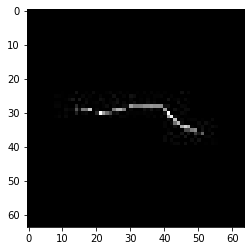

confidence for 19463 is 0.98775774


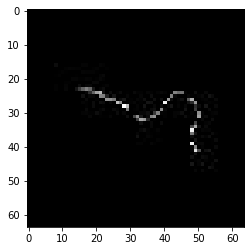

confidence for 19507 is 0.9999949


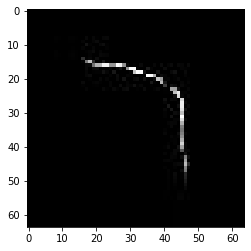

confidence for 19522 is 0.92987466


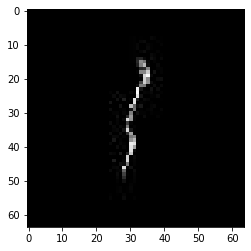

confidence for 19546 is 0.99856436


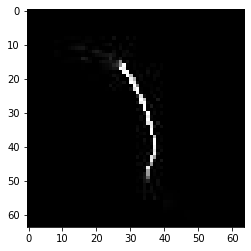

confidence for 19548 is 0.80138373


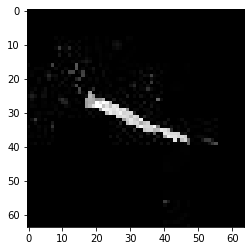

confidence for 19549 is 0.9986901


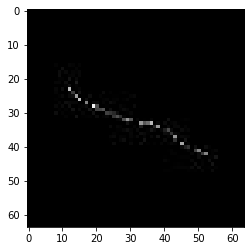

confidence for 19587 is 0.7946059


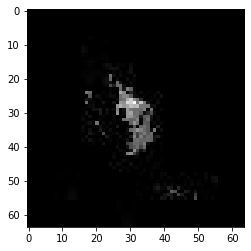

confidence for 19598 is 0.9413547


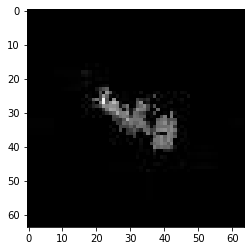

confidence for 19612 is 0.998785


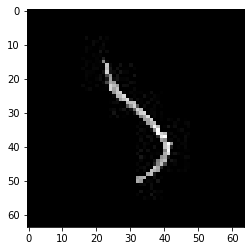

confidence for 19617 is 0.9827467


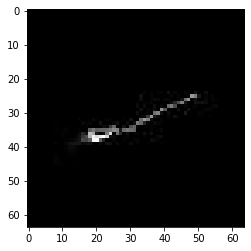

confidence for 19619 is 0.96226877


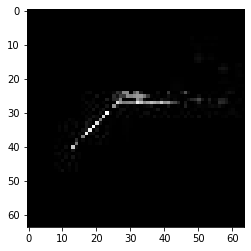

confidence for 19624 is 0.9996218


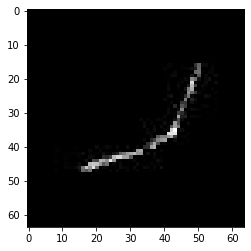

confidence for 19643 is 0.9939957


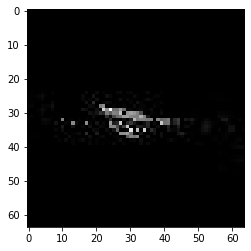

confidence for 19647 is 0.99853927


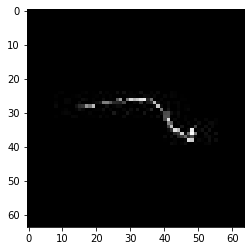

confidence for 19662 is 0.7197438


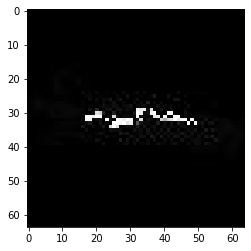

confidence for 19682 is 0.9999981


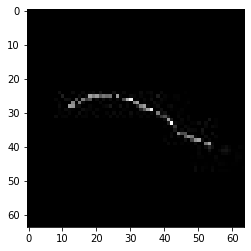

confidence for 19684 is 0.9643862


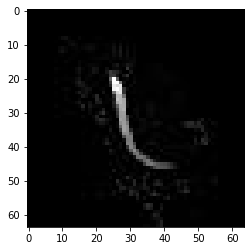

confidence for 19689 is 0.93985915


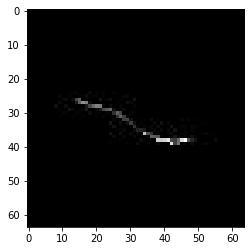

confidence for 19692 is 0.7152105


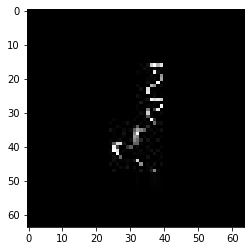

confidence for 19694 is 0.95980036


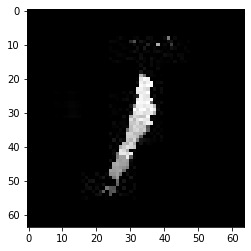

confidence for 19698 is 0.9948203


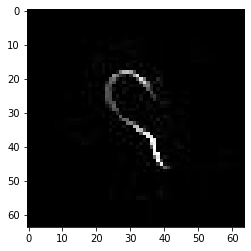

confidence for 19708 is 0.99435496


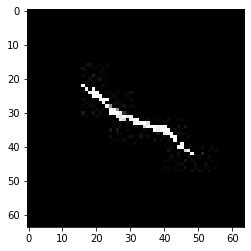

confidence for 19719 is 0.999958


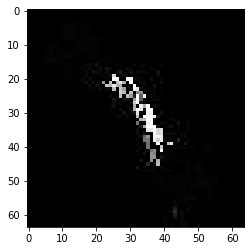

confidence for 19723 is 0.98711467


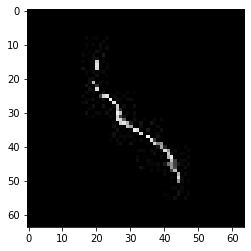

confidence for 19726 is 0.9863533


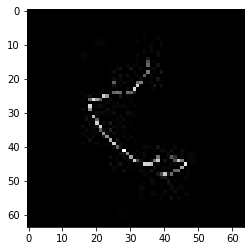

confidence for 19734 is 0.8798878


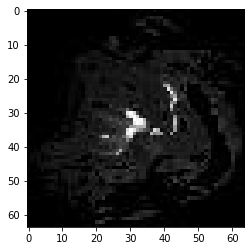

confidence for 19747 is 0.95603895


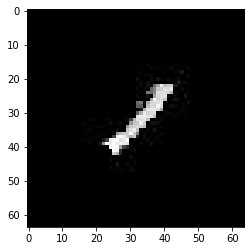

confidence for 19756 is 0.99314874


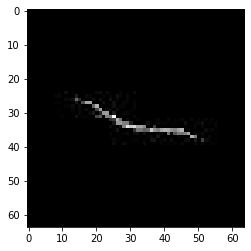

confidence for 19758 is 1.0


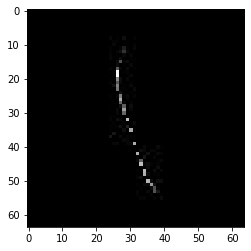

confidence for 19761 is 0.75200695


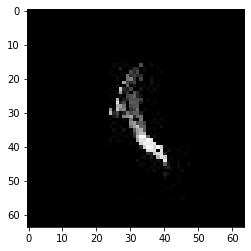

confidence for 19766 is 0.96941286


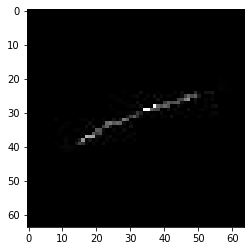

confidence for 19775 is 0.99999845


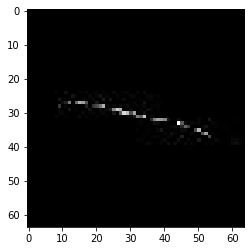

confidence for 19777 is 0.9999577


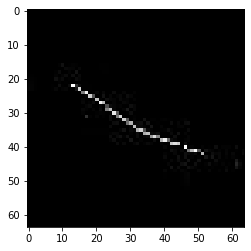

confidence for 19798 is 0.906196


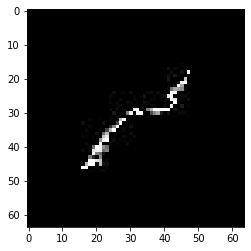

confidence for 19823 is 0.9981541


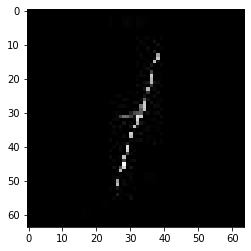

confidence for 19834 is 1.0


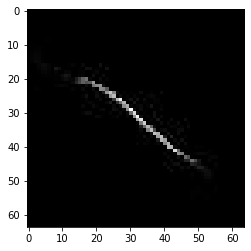

confidence for 19843 is 0.8518615


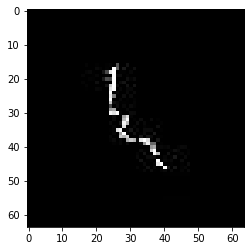

confidence for 19865 is 0.8731114


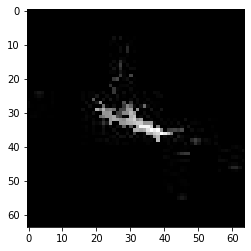

confidence for 19867 is 0.9999983


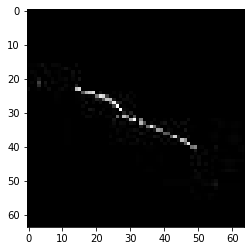

confidence for 19870 is 0.9978225


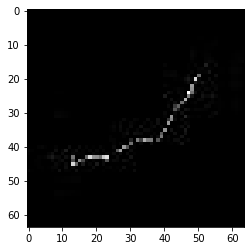

confidence for 19872 is 0.9180113


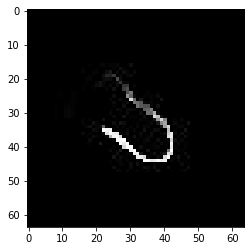

confidence for 19878 is 0.8141631


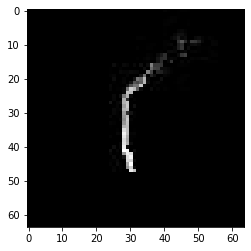

confidence for 19879 is 0.9123397


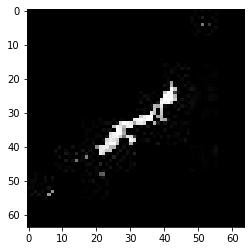

confidence for 19888 is 0.8350454


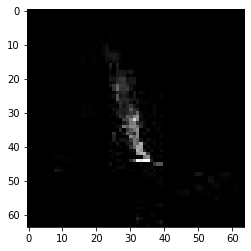

confidence for 19896 is 0.9642101


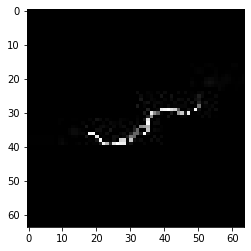

confidence for 19903 is 0.99793035


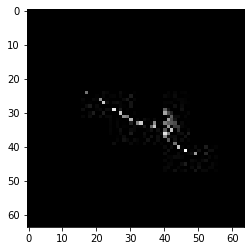

confidence for 19908 is 0.99974024


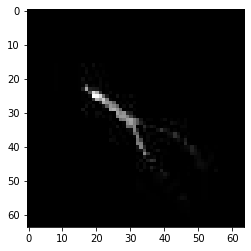

confidence for 19934 is 0.936238


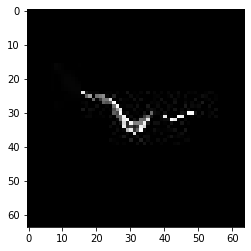

confidence for 19951 is 0.99440265


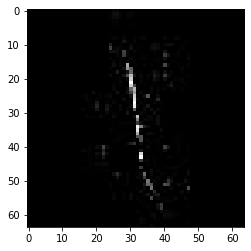

confidence for 19955 is 0.764894


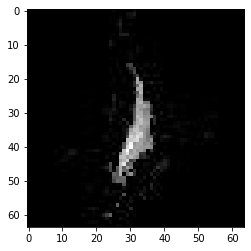

confidence for 19956 is 0.9999811


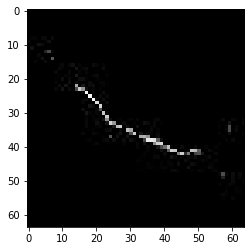

confidence for 19961 is 0.86918145


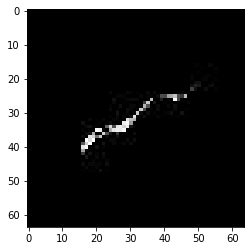

confidence for 19964 is 0.99982595


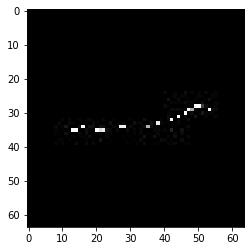

confidence for 19965 is 0.9999932


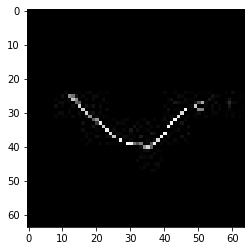

confidence for 19966 is 0.99324274


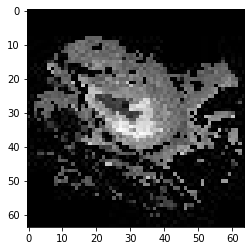

confidence for 19978 is 0.99935544


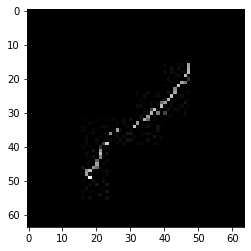

confidence for 19994 is 0.99997675


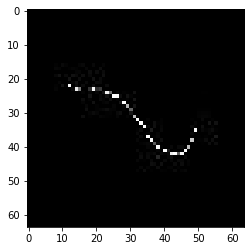

confidence for 20004 is 0.99975586


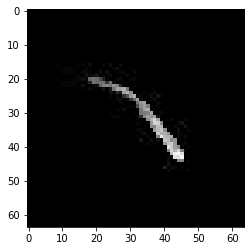

confidence for 20025 is 0.9995174


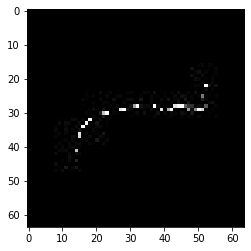

confidence for 20030 is 0.9401767


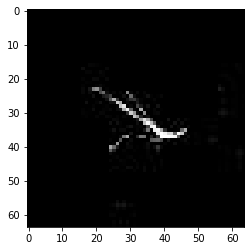

confidence for 20041 is 0.9298967


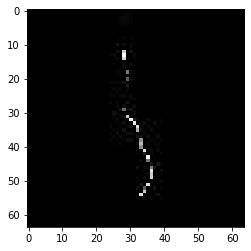

confidence for 20062 is 0.9967597


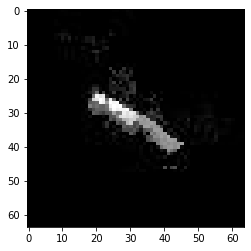

confidence for 20071 is 0.9757315


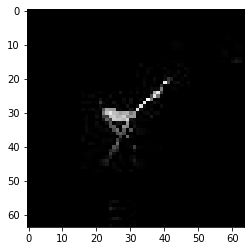

confidence for 20078 is 0.9989642


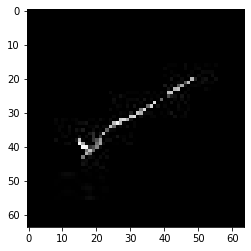

confidence for 20089 is 0.9903568


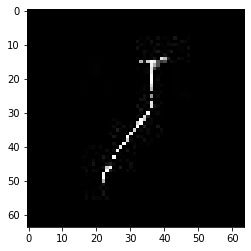

confidence for 20092 is 1.0


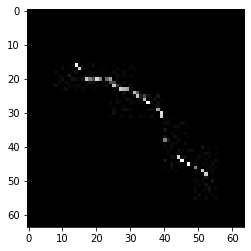

confidence for 20101 is 0.8105808


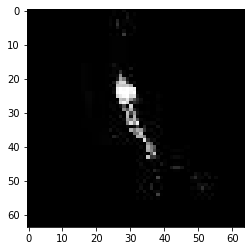

confidence for 20105 is 0.9998755


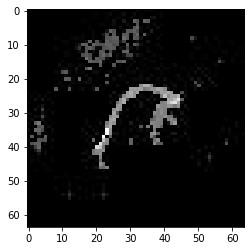

confidence for 20111 is 0.99985754


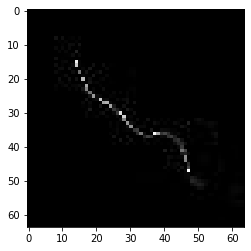

confidence for 20126 is 0.99991626


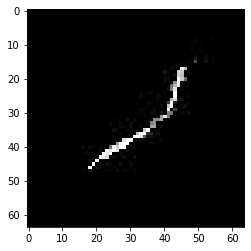

confidence for 20139 is 0.96734583


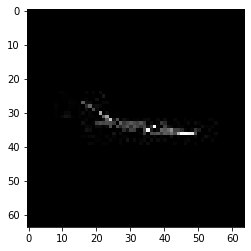

confidence for 20150 is 0.99991846


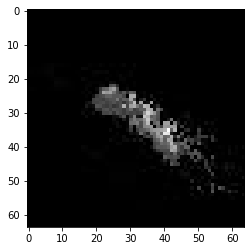

confidence for 20163 is 0.9067774


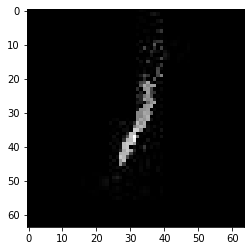

confidence for 20165 is 0.9998566


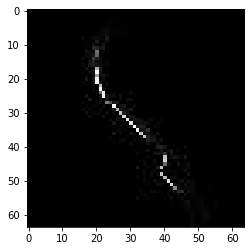

confidence for 20176 is 0.9823663


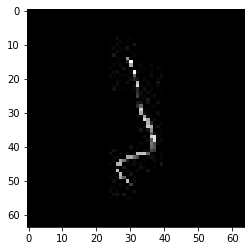

confidence for 20179 is 0.90519714


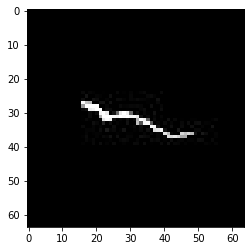

confidence for 20194 is 0.72264177


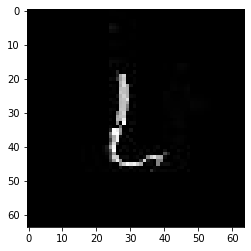

confidence for 20196 is 0.9991318


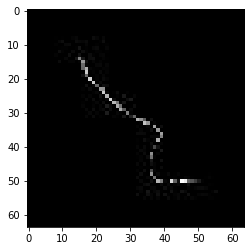

confidence for 20201 is 0.73235327


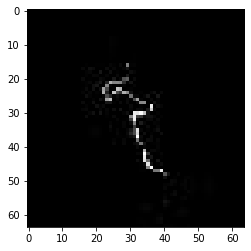

confidence for 20232 is 0.959171


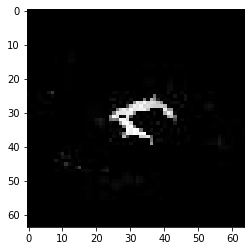

confidence for 20238 is 0.9612865


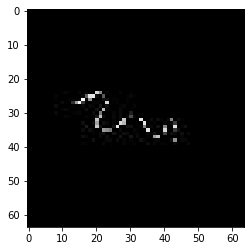

confidence for 20244 is 0.7087725


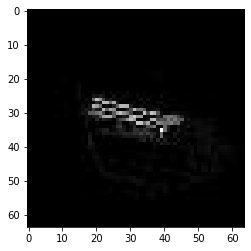

confidence for 20265 is 0.99397606


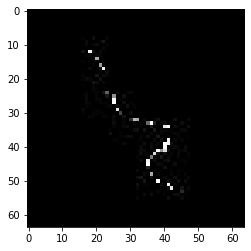

confidence for 20272 is 0.9920062


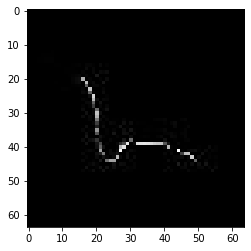

confidence for 20281 is 0.96562093


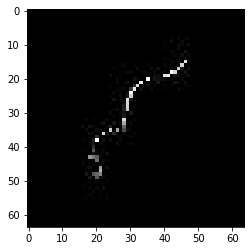

confidence for 20290 is 0.76160264


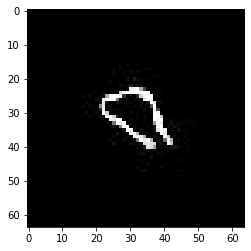

confidence for 20302 is 0.99848676


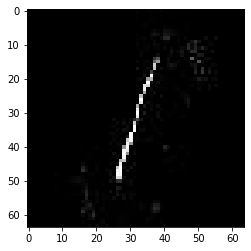

confidence for 20322 is 0.99797267


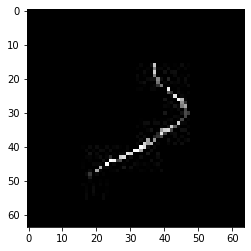

confidence for 20337 is 0.999977


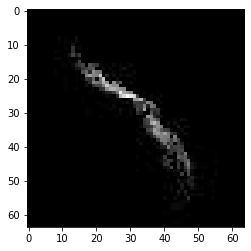

confidence for 20352 is 0.99809724


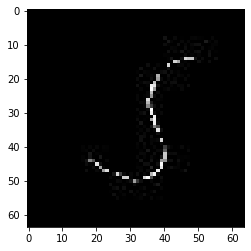

confidence for 20354 is 0.9470688


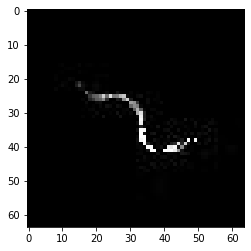

confidence for 20361 is 0.9400542


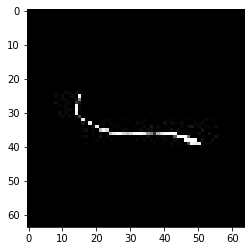

confidence for 20363 is 0.8637535


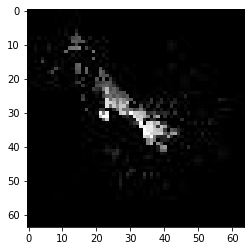

confidence for 20367 is 0.981526


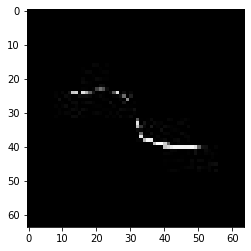

confidence for 20368 is 0.99964017


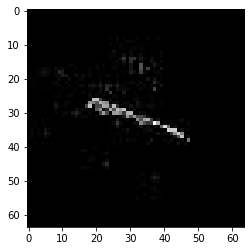

confidence for 20372 is 0.8112134


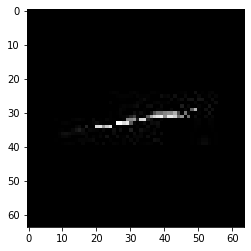

confidence for 20384 is 0.9925842


confidence for 20391 is 0.9751849


confidence for 20399 is 0.99933183


confidence for 20402 is 0.83599985


confidence for 20403 is 0.88296586


confidence for 20409 is 0.7665224


confidence for 20415 is 0.98425376


confidence for 20428 is 0.99721754


confidence for 20446 is 0.9994048


confidence for 20452 is 0.9385602


confidence for 20466 is 0.996965


confidence for 20476 is 0.8928528


confidence for 20480 is 0.9646


confidence for 20482 is 0.9336596


confidence for 20496 is 0.7025886


confidence for 20524 is 0.9999056


confidence for 20527 is 0.81470376


confidence for 20530 is 0.9079784


confidence for 20531 is 0.9995788


confidence for 20535 is 0.97270614


confidence for 20537 is 0.73116404


confidence for 20552 is 0.790761


confidence for 20604 is 0.8425943


confidence for 20606 is 0.97408265


confidence for 20610 is 0.99996245


confidence for 20624 is 0.93868005


confidence for 20628 is 0.96374094


confidence for 20630 is 0.9101969


confidence for 20634 is 0.94326764


confidence for 20639 is 0.89693326


confidence for 20645 is 0.9860302


confidence for 20647 is 0.749435


confidence for 20651 is 0.982867


confidence for 20658 is 0.9999636


confidence for 20660 is 0.96069354


confidence for 20664 is 0.9959874


confidence for 20671 is 0.9995769


confidence for 20674 is 0.98687166


confidence for 20675 is 0.9297523


confidence for 20678 is 0.9569575


confidence for 20680 is 0.9409977


confidence for 20681 is 0.9856668


confidence for 20690 is 0.83686924


confidence for 20701 is 0.99882245


confidence for 20702 is 0.99474126


confidence for 20704 is 0.993297


confidence for 20705 is 0.96950954


confidence for 20707 is 0.99986976


confidence for 20710 is 0.9999962


confidence for 20713 is 0.9962885


confidence for 20714 is 0.9411809


confidence for 20718 is 0.998615


confidence for 20725 is 0.9790147


confidence for 20728 is 0.9973522


confidence for 20730 is 0.9847051


confidence for 20731 is 0.9988292


confidence for 20732 is 0.9385033


confidence for 20736 is 0.97512734


confidence for 20741 is 0.9900348


confidence for 20743 is 0.83344716


confidence for 20748 is 0.9993684


confidence for 20749 is 0.91531134


confidence for 20752 is 0.9999565


confidence for 20754 is 0.99765


confidence for 20755 is 0.9782605


confidence for 20756 is 0.99760526


confidence for 20760 is 0.83407986


confidence for 20761 is 0.9965877


confidence for 20767 is 0.802534


confidence for 20775 is 0.99909


confidence for 20777 is 0.99998194


confidence for 20778 is 0.91604


confidence for 20781 is 0.9777247


confidence for 20785 is 0.9588828


confidence for 20796 is 0.9892925


confidence for 20803 is 0.95570606


confidence for 20805 is 0.99014646


confidence for 20808 is 0.9496253


confidence for 20810 is 0.7659831


confidence for 20812 is 0.9984624


confidence for 20814 is 0.9857662


confidence for 20817 is 0.75253606


confidence for 20819 is 0.97790456


confidence for 20820 is 0.9920046


confidence for 20828 is 0.9998086


confidence for 20863 is 0.78602505


confidence for 20864 is 0.8915297


confidence for 20869 is 0.8075109


confidence for 20875 is 0.9982281


confidence for 20878 is 0.9999987


confidence for 20887 is 0.9325561


confidence for 20891 is 0.9973714


confidence for 20892 is 0.99446464


confidence for 20898 is 0.9860129


confidence for 20901 is 0.9999994


confidence for 20904 is 0.99963087


confidence for 20914 is 0.9722192


confidence for 20916 is 0.984656


confidence for 20917 is 0.9832069


confidence for 20927 is 0.731147


confidence for 20950 is 0.9997532


confidence for 20954 is 0.7300431


confidence for 20955 is 0.9999041


confidence for 20958 is 0.7945928


confidence for 20962 is 0.9228618


confidence for 20966 is 0.74145734


confidence for 20971 is 0.9260893


confidence for 20981 is 0.858883


confidence for 20983 is 0.82753915


confidence for 20984 is 0.99998534


confidence for 20986 is 0.99579686


confidence for 20991 is 0.9973972


confidence for 20993 is 0.82649416


confidence for 20994 is 0.95492685


confidence for 20999 is 0.9994485


confidence for 21004 is 0.97926253


confidence for 21013 is 0.9952751


confidence for 21019 is 0.88777286


confidence for 21032 is 0.9869243


confidence for 21040 is 0.9998575


confidence for 21053 is 0.98928785


confidence for 21057 is 0.81290877


confidence for 21064 is 0.99851084


confidence for 21068 is 0.93215066


confidence for 21092 is 0.91368836


confidence for 21094 is 0.70582354


confidence for 21098 is 0.99853206


confidence for 21104 is 0.99980086


confidence for 21115 is 0.9734939


confidence for 21122 is 0.7447797


confidence for 21135 is 0.8136948


confidence for 21136 is 0.99256414


confidence for 21145 is 0.9920282


confidence for 21146 is 0.90758085


confidence for 21149 is 0.7680083


confidence for 21150 is 0.99946064


confidence for 21154 is 0.94847184


confidence for 21161 is 0.99568325


confidence for 21166 is 0.99105155


confidence for 21168 is 0.96067154


confidence for 21169 is 0.8902586


confidence for 21176 is 0.9985477


confidence for 21193 is 0.99996525


confidence for 21197 is 0.9983398


confidence for 21198 is 0.97335607


confidence for 21201 is 0.99997413


confidence for 21202 is 0.99775964


confidence for 21209 is 0.99561125


confidence for 21212 is 0.9766827


confidence for 21221 is 0.99783236


confidence for 21225 is 0.99690676


confidence for 21233 is 0.99648


confidence for 21235 is 0.97880214


confidence for 21237 is 0.9833252


confidence for 21246 is 0.97588336


confidence for 21255 is 0.9817993


confidence for 21256 is 0.95323014


confidence for 21257 is 0.9151392


confidence for 21258 is 0.98736334


confidence for 21267 is 0.99993956


confidence for 21278 is 0.98139757


confidence for 21284 is 0.96177346


confidence for 21304 is 0.97313124


confidence for 21313 is 0.9312128


confidence for 21316 is 0.818808


confidence for 21317 is 0.9840669


confidence for 21318 is 0.8359816


confidence for 21321 is 0.98966396


confidence for 21333 is 0.99988675


confidence for 21359 is 0.8895876


confidence for 21364 is 0.7855692


confidence for 21377 is 0.99829006


confidence for 21388 is 0.9837724


confidence for 21411 is 0.9803102


confidence for 21416 is 0.9614818


confidence for 21423 is 0.8806932


confidence for 21424 is 0.9641641


confidence for 21453 is 0.985954


confidence for 21455 is 0.8802715


confidence for 21459 is 0.8618857


confidence for 21475 is 0.9999991


confidence for 21477 is 0.94700056


confidence for 21495 is 0.9969208


confidence for 21498 is 0.94431627


confidence for 21499 is 0.81386673


confidence for 21500 is 0.9992924


confidence for 21527 is 0.836668


confidence for 21535 is 0.8825713


confidence for 21536 is 0.97217053


confidence for 21540 is 0.99622875


confidence for 21542 is 0.98376364


confidence for 21551 is 0.8463853


confidence for 21554 is 0.9550404


confidence for 21555 is 0.9819741


confidence for 21566 is 0.7512158


confidence for 21581 is 0.99935055


confidence for 21587 is 0.9997619


confidence for 21593 is 0.86922985


confidence for 21603 is 0.9973733


confidence for 21610 is 0.9995707


confidence for 21629 is 0.9999957


confidence for 21630 is 0.99385786


confidence for 21638 is 0.99522763


confidence for 21640 is 0.9994949


confidence for 21648 is 0.8879192


confidence for 21653 is 0.9911866


confidence for 21665 is 0.99999964


confidence for 21666 is 0.7832295


confidence for 21668 is 0.99776995


confidence for 21684 is 0.82755584


confidence for 21685 is 0.9502884


confidence for 21694 is 0.9956853


confidence for 21697 is 0.85073274


confidence for 21703 is 0.9788728


confidence for 21709 is 0.9999318


confidence for 21716 is 0.90107733


confidence for 21718 is 0.98291314


confidence for 21720 is 0.99969953


confidence for 21745 is 0.71635056


confidence for 21747 is 0.99682957


confidence for 21756 is 0.9603361


confidence for 21779 is 0.999804


confidence for 21791 is 0.8290376


confidence for 21801 is 0.99641955


confidence for 21810 is 0.99808097


confidence for 21825 is 0.9999508


confidence for 21827 is 0.99997246


confidence for 21828 is 0.99676555


confidence for 21830 is 0.84233934


confidence for 21846 is 0.99930096


confidence for 21856 is 0.78698546


confidence for 21857 is 0.97655517


confidence for 21860 is 0.9986212


confidence for 21869 is 0.7334957


confidence for 21881 is 0.9990314


confidence for 21890 is 0.8070678


confidence for 21896 is 0.9995186


confidence for 21897 is 0.9996679


confidence for 21900 is 0.8846667


confidence for 21909 is 0.8673262


confidence for 21915 is 0.99934614


confidence for 21919 is 0.7459054


confidence for 21926 is 0.9982048


confidence for 21927 is 0.9902046


confidence for 21930 is 0.90998036


confidence for 21932 is 0.9917088


confidence for 21937 is 0.97028756


confidence for 21940 is 0.9779666


confidence for 21941 is 0.999623


confidence for 21949 is 0.9761985


confidence for 21956 is 0.7855454


confidence for 21968 is 0.9948717


confidence for 21971 is 0.99959356


confidence for 21974 is 0.9778154


confidence for 21978 is 0.9818409


confidence for 21984 is 0.9998035


confidence for 21987 is 0.8800607


confidence for 21995 is 0.99999994


confidence for 21997 is 0.9917269


confidence for 22004 is 0.99748135


confidence for 22006 is 0.99964064


confidence for 22015 is 0.8573573


confidence for 22017 is 0.9571397


confidence for 22020 is 0.948641


confidence for 22021 is 0.99972695


confidence for 22042 is 0.9999156


confidence for 22046 is 0.7551607


confidence for 22057 is 0.9106565


confidence for 22062 is 0.96371573


confidence for 22072 is 0.97414416


confidence for 22086 is 0.95408684


confidence for 22088 is 0.9510863


confidence for 22089 is 0.9798931


confidence for 22108 is 0.9993916


confidence for 22116 is 0.86476547


confidence for 22119 is 0.8284541


confidence for 22128 is 1.0


confidence for 22149 is 0.999878


confidence for 22156 is 0.74120814


confidence for 22157 is 0.99999994


confidence for 22158 is 0.9998771


confidence for 22160 is 0.9956169


confidence for 22164 is 0.99215454


confidence for 22176 is 0.99905634


confidence for 22191 is 0.9927371


confidence for 22196 is 0.9460507


confidence for 22214 is 0.90300715


confidence for 22216 is 0.98575336


confidence for 22221 is 0.99427783


confidence for 22223 is 0.98494


confidence for 22225 is 0.9496709


confidence for 22228 is 0.99999815


confidence for 22242 is 0.82492286


confidence for 22250 is 0.8456735


confidence for 22255 is 0.9104794


confidence for 22256 is 0.80489045


confidence for 22261 is 0.9936216


confidence for 22262 is 0.9582639


confidence for 22273 is 0.9444657


confidence for 22276 is 0.968775


confidence for 22280 is 0.98051494


confidence for 22281 is 0.77932477


confidence for 22282 is 0.997867


confidence for 22284 is 0.9994336


confidence for 22285 is 0.99974495


confidence for 22295 is 0.99847734


confidence for 22308 is 0.96837616


confidence for 22316 is 0.81751794


confidence for 22317 is 0.87205744


confidence for 22319 is 0.94834214


confidence for 22322 is 0.99999654


confidence for 22323 is 0.81268597


confidence for 22331 is 0.7153063


confidence for 22334 is 0.8367376


confidence for 22346 is 0.7419736


confidence for 22361 is 0.8579804


confidence for 22365 is 0.9557456


confidence for 22375 is 0.9294056


confidence for 22378 is 0.8732965


confidence for 22392 is 0.97746533


confidence for 22402 is 0.9702443


confidence for 22415 is 0.72491485


confidence for 22424 is 0.99999726


confidence for 22427 is 0.99948853


confidence for 22443 is 0.94430006


confidence for 22446 is 0.9947999


confidence for 22473 is 0.96660334


confidence for 22476 is 0.95201427


confidence for 22489 is 0.9323409


confidence for 22503 is 0.7443938


confidence for 22517 is 0.9997541


confidence for 22529 is 0.879109


confidence for 22531 is 0.9086247


confidence for 22538 is 0.9994203


confidence for 22547 is 0.7810687


confidence for 22553 is 0.9999371


confidence for 22563 is 0.97524893


confidence for 22583 is 0.975264


confidence for 22589 is 1.0


confidence for 22601 is 0.99895185


confidence for 22603 is 0.9990116


confidence for 22613 is 0.98121923


confidence for 22634 is 0.9663349


confidence for 22635 is 0.9653066


confidence for 22640 is 0.99749494


confidence for 22643 is 0.9958291


confidence for 22644 is 0.9895051


confidence for 22647 is 0.9667519


confidence for 22648 is 0.98908305


confidence for 22659 is 0.99999905


confidence for 22666 is 0.91793317


confidence for 22668 is 0.74228734


confidence for 22669 is 0.90187347


confidence for 22677 is 0.9421929


confidence for 22680 is 0.9939193


confidence for 22690 is 0.9999149


confidence for 22693 is 0.8984314


confidence for 22696 is 0.9010924


confidence for 22713 is 0.9995747


confidence for 22714 is 0.98317134


confidence for 22715 is 0.7365086


confidence for 22733 is 0.963882


confidence for 22734 is 0.74520946


confidence for 22768 is 0.98148084


confidence for 22772 is 0.99667984


confidence for 22785 is 0.85049284


confidence for 22794 is 0.9695518


confidence for 22795 is 0.98883146


confidence for 22801 is 0.98832995


confidence for 22803 is 0.999858


confidence for 22805 is 0.9931871


confidence for 22809 is 0.9736739


confidence for 22820 is 0.98634946


confidence for 22823 is 0.95108426


confidence for 22824 is 0.99855804


confidence for 22835 is 0.99778634


confidence for 22873 is 0.90632427


confidence for 22889 is 0.91639


confidence for 22897 is 0.99638385


confidence for 22899 is 0.99032164


confidence for 22902 is 0.99854666


confidence for 22910 is 0.9995419


confidence for 22912 is 0.999243


confidence for 22926 is 0.92974705


confidence for 22935 is 0.7835642


confidence for 22937 is 0.96677876


confidence for 22949 is 0.73803174


confidence for 22957 is 0.9988055


confidence for 22986 is 0.99904835


confidence for 22990 is 0.9990004


confidence for 22991 is 0.99796724


confidence for 22996 is 0.99999195


confidence for 22997 is 0.9995189


confidence for 23006 is 0.99935836


confidence for 23007 is 0.8655442


confidence for 23028 is 0.8883089


confidence for 23031 is 0.96934015


confidence for 23040 is 0.7217816


confidence for 23044 is 0.9902161


confidence for 23045 is 0.9992916


confidence for 23049 is 0.9393912


confidence for 23058 is 0.7947562


confidence for 23064 is 0.9868982


confidence for 23069 is 0.87016267


confidence for 23077 is 0.89005136


confidence for 23086 is 0.9844397


confidence for 23089 is 0.71742195


confidence for 23092 is 0.7041089


confidence for 23102 is 0.9999948


confidence for 23104 is 0.90393823


confidence for 23114 is 0.9999105


confidence for 23131 is 0.9946849


confidence for 23135 is 0.99858385


confidence for 23145 is 0.9344737


confidence for 23150 is 0.9999036


confidence for 23155 is 0.99635506


confidence for 23160 is 0.9932574


confidence for 23166 is 0.9987659


confidence for 23170 is 0.7312456


confidence for 23171 is 0.9987299


confidence for 23174 is 0.9564102


confidence for 23176 is 0.9202348


confidence for 23183 is 0.99397177


confidence for 23191 is 0.8657723


confidence for 23193 is 0.99932665


confidence for 23199 is 0.9932902


confidence for 23206 is 0.99727947


confidence for 23210 is 0.9735166


confidence for 23219 is 0.97508293


confidence for 23222 is 1.0


confidence for 23224 is 0.8613088


confidence for 23234 is 0.99905103


confidence for 23271 is 0.958964


confidence for 23279 is 0.99999094


confidence for 23282 is 0.99683255


confidence for 23292 is 0.9844062


confidence for 23305 is 0.9999815


confidence for 23320 is 0.9986444


confidence for 23326 is 0.9999164


confidence for 23334 is 0.97292405


confidence for 23338 is 0.99980974


confidence for 23342 is 0.999998


confidence for 23343 is 0.90162235


confidence for 23349 is 0.9613708


confidence for 23351 is 0.99999034


confidence for 23352 is 0.9127759


confidence for 23353 is 0.99696463


confidence for 23354 is 0.8424004


confidence for 23363 is 0.99829245


confidence for 23365 is 0.93952334


confidence for 23372 is 0.9994764


confidence for 23373 is 0.9885545


confidence for 23387 is 0.874006


confidence for 23392 is 0.9846737


confidence for 23399 is 0.9792621


confidence for 23400 is 0.9291939


confidence for 23413 is 0.99452263


confidence for 23428 is 0.99896675


confidence for 23429 is 0.99892074


confidence for 23431 is 0.96397555


confidence for 23435 is 0.973704


confidence for 23438 is 0.98243254


confidence for 23440 is 0.7273555


confidence for 23441 is 0.8997184


confidence for 23447 is 0.99998784


confidence for 23448 is 0.99999976


confidence for 23449 is 0.9176471


confidence for 23450 is 0.9899871


confidence for 23453 is 0.9890499


confidence for 23455 is 0.91584706


confidence for 23462 is 0.9996821


confidence for 23467 is 0.70280606


confidence for 23470 is 0.9418272


confidence for 23471 is 0.9463281


confidence for 23482 is 0.9998531


confidence for 23486 is 0.9218918


confidence for 23487 is 0.76874924


confidence for 23496 is 0.9990507


confidence for 23497 is 0.9778449


confidence for 23513 is 0.99925405


confidence for 23517 is 0.9985913


confidence for 23519 is 0.99076205


confidence for 23525 is 0.9871596


confidence for 23531 is 0.9517685


confidence for 23553 is 0.7831337


confidence for 23556 is 0.93610966


confidence for 23559 is 0.99901205


confidence for 23563 is 0.7462896


confidence for 23565 is 0.9882713


confidence for 23568 is 0.98909223


confidence for 23580 is 0.9968599


confidence for 23594 is 0.9973517


confidence for 23598 is 0.80873424


confidence for 23607 is 0.8170104


confidence for 23612 is 0.73881185


confidence for 23614 is 0.80972373


confidence for 23619 is 0.8857145


confidence for 23625 is 0.9998563


confidence for 23631 is 0.8024131


confidence for 23634 is 0.999968


confidence for 23635 is 0.99998266


confidence for 23638 is 0.99712193


confidence for 23643 is 0.7644443


confidence for 23652 is 0.99385214


confidence for 23679 is 0.71206385


confidence for 23683 is 0.84041


confidence for 23685 is 0.8189477


confidence for 23687 is 0.99289626


confidence for 23689 is 0.9267621


confidence for 23695 is 0.9999995


confidence for 23697 is 0.98733336


confidence for 23700 is 0.99804425


confidence for 23706 is 0.9908142


confidence for 23707 is 0.95128936


confidence for 23709 is 0.9211282


confidence for 23715 is 0.99991995


confidence for 23716 is 0.9982705


confidence for 23720 is 0.9041863


confidence for 23724 is 0.76873845


confidence for 23725 is 0.99807185


confidence for 23749 is 0.98597157


confidence for 23750 is 0.9932715


confidence for 23756 is 0.9400278


confidence for 23766 is 0.82342684


confidence for 23767 is 0.9734539


confidence for 23770 is 0.99150395


confidence for 23773 is 0.9958872


confidence for 23775 is 0.9967772


confidence for 23796 is 0.8939586


confidence for 23801 is 0.7461023


confidence for 23803 is 0.99946463


confidence for 23813 is 0.9967359


confidence for 23839 is 0.91099524


confidence for 23842 is 0.9253393


confidence for 23849 is 0.73512644


confidence for 23853 is 0.90560955


confidence for 23869 is 0.9985235


confidence for 23874 is 0.99985206


confidence for 23882 is 0.99861425


confidence for 23884 is 0.95748335


confidence for 23898 is 0.99746275


confidence for 23902 is 0.9247217


confidence for 23903 is 0.9995336


confidence for 23906 is 0.99997914


confidence for 23915 is 0.99996406


confidence for 23916 is 0.8328245


confidence for 23918 is 0.84023815


confidence for 23919 is 0.92812663


confidence for 23922 is 0.87867683


confidence for 23926 is 0.9440194


confidence for 23932 is 0.9993388


confidence for 23944 is 0.99686545


confidence for 23945 is 0.9999608


confidence for 23947 is 0.9703816


confidence for 23950 is 0.9998957


confidence for 23954 is 0.7503001


confidence for 23961 is 0.9522581


confidence for 23966 is 0.9991504


confidence for 23967 is 0.9425096


confidence for 23971 is 0.9942672


confidence for 23987 is 0.9387454


confidence for 23997 is 0.9572586


confidence for 24004 is 0.9902822


confidence for 24009 is 0.9999171


confidence for 24017 is 0.9994442


confidence for 24022 is 0.99999857


confidence for 24025 is 0.7974755


confidence for 24033 is 0.77282584


confidence for 24036 is 0.99893767


confidence for 24038 is 0.94764537


confidence for 24041 is 0.98249507


confidence for 24049 is 0.71781796


confidence for 24051 is 0.9999822


confidence for 24057 is 0.9838749


confidence for 24062 is 0.8610374


confidence for 24064 is 0.98412544


confidence for 24067 is 0.99501073


confidence for 24095 is 0.9791985


confidence for 24099 is 0.9981555


confidence for 24102 is 0.9999676


confidence for 24103 is 0.97136664


confidence for 24106 is 0.966575


confidence for 24112 is 0.9923237


confidence for 24114 is 0.99998313


confidence for 24122 is 0.99863005


confidence for 24131 is 0.9997705


confidence for 24141 is 0.97341675


confidence for 24160 is 0.73510784


confidence for 24170 is 0.9821207


confidence for 24171 is 0.9711717


confidence for 24174 is 0.95925415


confidence for 24181 is 0.9999678


confidence for 24182 is 0.92735153


confidence for 24190 is 0.75356466


confidence for 24192 is 0.94934845


confidence for 24199 is 0.9991823


confidence for 24202 is 0.96960175


confidence for 24204 is 0.99172026


confidence for 24217 is 0.9938002


confidence for 24218 is 0.9987048


confidence for 24219 is 0.8062419


confidence for 24222 is 0.860162


confidence for 24233 is 0.9706088


confidence for 24237 is 0.89710295


confidence for 24240 is 0.91304165


confidence for 24241 is 0.9929044


confidence for 24252 is 0.80237967


confidence for 24257 is 0.99260056


confidence for 24259 is 0.70134544


confidence for 24262 is 0.94705653


confidence for 24269 is 0.95111686


confidence for 24287 is 0.9099937


confidence for 24291 is 0.99999994


confidence for 24301 is 0.99343836


confidence for 24302 is 0.98428905


confidence for 24303 is 0.8242561


confidence for 24311 is 0.95232946


confidence for 24316 is 0.85390943


confidence for 24319 is 0.99994487


confidence for 24322 is 0.9993782


confidence for 24323 is 0.9733645


confidence for 24326 is 0.9999997


confidence for 24328 is 0.94104517


confidence for 24330 is 0.9823153


confidence for 24332 is 0.99653715


confidence for 24335 is 0.95275563


confidence for 24340 is 0.9802549


confidence for 24348 is 0.7277571


confidence for 24350 is 0.78713596


confidence for 24357 is 0.9992367


confidence for 24361 is 0.99909955


confidence for 24364 is 0.9893506


confidence for 24390 is 0.9877925


confidence for 24406 is 0.9988078


confidence for 24407 is 0.7442885


confidence for 24417 is 0.939024


confidence for 24418 is 0.9980676


confidence for 24424 is 0.8686832


confidence for 24425 is 0.75791633


confidence for 24432 is 0.8902234


confidence for 24439 is 0.99962246


confidence for 24442 is 0.99930644


confidence for 24443 is 0.9959664


confidence for 24446 is 0.9622597


confidence for 24456 is 0.88840944


confidence for 24461 is 0.94290805


confidence for 24467 is 0.9995808


confidence for 24483 is 0.9999753


confidence for 24492 is 0.98160243


confidence for 24493 is 0.9950196


confidence for 24494 is 0.99798226


confidence for 24495 is 0.89932966


confidence for 24497 is 0.9925092


confidence for 24498 is 0.7450484


confidence for 24530 is 0.99996406


confidence for 24566 is 0.954665


confidence for 24574 is 0.92049575


confidence for 24576 is 0.7572138


confidence for 24579 is 0.99993527


confidence for 24580 is 0.99922866


confidence for 24587 is 0.94434434


confidence for 24591 is 0.9627288


confidence for 24593 is 0.99141264


confidence for 24596 is 0.8609316


confidence for 24601 is 0.9701794


confidence for 24614 is 0.9900909


confidence for 24622 is 0.9945334


confidence for 24623 is 0.9104026


confidence for 24624 is 0.99890566


confidence for 24632 is 0.9932391


confidence for 24649 is 0.95667773


confidence for 24652 is 0.92699623


confidence for 24658 is 0.9876885


confidence for 24669 is 0.9919906


confidence for 24679 is 0.94669265


confidence for 24682 is 0.9962652


confidence for 24684 is 0.82016826


confidence for 24685 is 0.77534705


confidence for 24690 is 0.9865365


confidence for 24691 is 0.7160237


confidence for 24696 is 0.9663286


confidence for 24699 is 0.9667814


confidence for 24725 is 0.9986835


confidence for 24731 is 0.9808404


confidence for 24736 is 0.84313107


confidence for 24740 is 0.89910734


confidence for 24753 is 0.97785157


confidence for 24755 is 0.9786675


confidence for 24773 is 0.99197185


confidence for 24775 is 0.89605725


confidence for 24776 is 0.7953156


confidence for 24780 is 0.9999996


confidence for 24782 is 0.99999094


confidence for 24783 is 0.99737316


confidence for 24786 is 0.9996512


confidence for 24807 is 0.94023216


confidence for 24818 is 0.9997034


confidence for 24821 is 0.9415636


confidence for 24822 is 0.9541628


confidence for 24827 is 0.9998966


confidence for 24828 is 0.9995266


confidence for 24829 is 0.987315


confidence for 24840 is 0.95137525


confidence for 24847 is 0.998447


confidence for 24850 is 0.9984359


confidence for 24864 is 0.89319515


confidence for 24865 is 0.9978803


confidence for 24870 is 0.9964724


confidence for 24875 is 0.9999825


confidence for 24880 is 0.99890417


confidence for 24885 is 0.917745


confidence for 24889 is 0.9207946


confidence for 24900 is 0.96896005


confidence for 24905 is 0.99906397


confidence for 24909 is 0.9262308


confidence for 24918 is 0.9455459


confidence for 24933 is 0.9225947


confidence for 24938 is 0.98603565


confidence for 24943 is 0.87875974


confidence for 24945 is 0.98934245


confidence for 24949 is 0.9974379


confidence for 24951 is 0.9999969


confidence for 24956 is 0.75755507


confidence for 24960 is 0.9944535


confidence for 24972 is 0.9787158


confidence for 24989 is 0.9813264


COMPLETE


In [24]:
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

results = []
rivers = []
other = []
threshold = 0.70
model = resnet50v2model

for i in range(25000):
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i)+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    # print(model.predict(x))
    results.append(model.predict(x))
    if (model.predict(x) > threshold):
        print("----------------------------------------------------------------------"+str(i)+" is a predicted river")
        
for i in range(len(results)):
    if (results[i][0] >= threshold):
        rivers.append([i,results[i][0]])
    else:
        other.append([i,results[i][0]])
        
print("number of rivers:",len(rivers))
print("number of other:",len(other))

for i in rivers:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    plt.imshow(img)
    print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
    plt.show()
    img.save("../data/resnet50v2_predicted_threshold"+str(threshold*100)+"/river/"+str(i[0])+"-"+str(int(100*i[1][0]))+".jpeg", "JPEG")
    
for i in other:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    img.save("../data/resnet50v2_predicted_threshold"+str(threshold*100)+"/other/"+str(i[0])+"-"+str(int(100*i[1][0]))+".jpeg", "JPEG")

print("COMPLETE")

In [25]:
# for i in other:
#     print("../data/resnet50v2_predicted_threshold70/river/"+str(i[0])+"-"+str(int(100*i[1][0]))+".jpeg", "JPEG")

../data/resnet50v2_predicted_threshold70/river/0-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1-8.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/2-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/4-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/6-27.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7-2.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/8-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/10-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/12-34.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13-67.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/14-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/15-0.jpeg JPEG
../data/resnet5

../data/resnet50v2_predicted_threshold70/river/1932-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1933-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1934-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1935-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1936-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1937-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1938-7.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1939-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1940-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1941-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1942-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1943-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1945-15.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1946-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/1947-0.jpeg JPEG
../data/resnet50v2_predicted_threshold7

../data/resnet50v2_predicted_threshold70/river/3872-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3873-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3874-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3875-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3877-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3878-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3879-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3880-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3881-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3882-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3883-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3884-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3885-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3886-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/3887-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70

../data/resnet50v2_predicted_threshold70/river/5847-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5849-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5850-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5851-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5852-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5853-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5854-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5855-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5856-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5857-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5858-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5859-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5860-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5861-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/5862-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70

../data/resnet50v2_predicted_threshold70/river/7821-66.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7822-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7823-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7824-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7825-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7826-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7827-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7828-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7829-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7830-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7831-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7832-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7834-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7835-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/7836-0.jpeg JPEG
../data/resnet50v2_predicted_threshold7

../data/resnet50v2_predicted_threshold70/river/9818-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9819-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9820-36.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9821-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9822-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9824-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9825-2.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9826-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9827-20.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9828-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9829-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9830-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9831-13.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9832-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/9834-0.jpeg JPEG
../data/resnet50v2_predicted_threshol

../data/resnet50v2_predicted_threshold70/river/11815-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11816-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11817-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11818-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11819-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11820-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11821-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11822-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11824-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11825-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11826-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11827-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11828-6.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11829-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/11830-0.jpeg JPEG
../data/resnet50v2_predic

../data/resnet50v2_predicted_threshold70/river/13828-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13829-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13830-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13831-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13832-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13833-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13834-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13835-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13839-4.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13840-32.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13841-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13842-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13843-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13844-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/13845-0.jpeg JPEG
../data/resnet50v2_predi

../data/resnet50v2_predicted_threshold70/river/16004-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16005-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16006-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16007-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16008-66.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16009-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16011-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16012-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16013-42.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16014-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16015-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16016-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16018-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16019-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/16020-0.jpeg JPEG
../data/resnet50v2_pred

../data/resnet50v2_predicted_threshold70/river/18143-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18145-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18146-1.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18147-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18148-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18149-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18153-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18154-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18155-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18156-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18157-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18158-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18159-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18160-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/18161-4.jpeg JPEG
../data/resnet50v2_predic

../data/resnet50v2_predicted_threshold70/river/20223-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20224-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20225-32.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20226-54.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20227-6.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20228-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20229-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20230-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20231-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20233-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20234-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20235-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20236-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20237-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/20239-0.jpeg JPEG
../data/resnet50v2_pred

../data/resnet50v2_predicted_threshold70/river/22405-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22406-46.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22407-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22408-8.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22409-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22410-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22411-32.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22412-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22413-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22414-2.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22416-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22417-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22418-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22419-4.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/22420-1.jpeg JPEG
../data/resnet50v2_pred

../data/resnet50v2_predicted_threshold70/river/24542-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24543-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24544-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24545-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24546-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24547-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24548-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24549-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24550-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24551-4.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24552-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24553-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24554-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24555-0.jpeg JPEG
../data/resnet50v2_predicted_threshold70/river/24556-14.jpeg JPEG
../data/resnet50v2_predi

# end of 12/9/22 testing

# start of 12/12/22

In [21]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf
# from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions


import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

import fnmatch

In [28]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

train_path = '../data/task1_new_strategy/train'
valid_path = '../data/task1_new_strategy/test'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (64,64),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (64,64),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 15765 images belonging to 2 classes.
Found 2145 images belonging to 2 classes.


In [29]:
IMAGE_SIZE = [64,64]

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                              include_top = False,
                                              classes = 2
                                              #input_shape=(64,64,3)
                                             )

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', 
                        optimizer='adam',
                        metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_3[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                      

                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
                                                                                                  
 conv2_blo

                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)                           128)                                                              
          

 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_7 (MaxPooling2D)  (None, None, None,   0          ['conv3_block3_out[0][0]']       
                                512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_block4_out (Add)         (None, None, None,   0           ['max_pooling2d_7[0][0]',        
          

                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_blo

                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
                                1024)                                                             
          

 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block2_preact_relu[0][0]'
          

In [30]:
train_score = resnet50v2model.evaluate(training)
test_score = resnet50v2model.evaluate(testing)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

269/269 [==============================] - 6s 22ms/step - loss: 0.0231 - accuracy: 0.9944 - precision_2: 0.9562 - recall_2: 0.9562
train accuracy: 99.40374493598938 %
test accuracy: 99.44055676460266 %


In [32]:
unlabeled_path = "../data/task1_unlabeled_12_12"

In [36]:
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

results = []
rivers = []
other = []
unclassified = []
threshold = 0.999
model = resnet50v2model

unlabeled_length = len(fnmatch.filter(os.listdir("../data/task1_unlabeled_12_12"), '*.jpeg'))

for i in os.listdir("../data/task1_unlabeled_12_12"):
    img_path = '../data/task1_unlabeled_12_12/'+str(i)
    img = image.load_img(img_path, target_size=(64,64))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    # print(model.predict(x))
    results.append(model.predict(x,verbose=0))
    if (model.predict(x,verbose=0) > threshold):
        print("----------------------------------------------------------------------"+str(i)+" is a predicted river")
        
for i in range(len(results)):
    if (results[i][0] >= threshold):
        rivers.append([i,results[i][0]])
    if (results[i][0] < (1-threshold)):
        other.append([i,results[i][0]])
    if (results[i][0] < threshold and results[i][0] >= (1-threshold)):
        unclassified.append([i,results[i][0]])

print("number of results:",len(results))
print("number of rivers w 99.9% confidence:",len(rivers))
print("number of other w 99.9% confidence:",len(other))

length_train_rivers = len(fnmatch.filter(os.listdir(train_path+"/river"), '*.jpeg'))
length_train_other = len(fnmatch.filter(os.listdir(train_path+"/other"), '*.jpeg'))
length_test_rivers = len(fnmatch.filter(os.listdir(valid_path+"/river"), '*.jpeg'))
length_test_other = len(fnmatch.filter(os.listdir(valid_path+"/other"), '*.jpeg'))


# rivercount = 0

# for i in rivers:
#     img_path = '../data/task1_unlabeled_12_12/'+str(i[0])+".jpeg"
#     img = image.load_img(img_path, target_size=(64,64))
#     plt.imshow(img)
#     print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
#     plt.show()
#     if ((rivercount // 8) == 0):
#         img.save("../data/task1_new_strategy/train/river/"+str(i[0]+length_train_rivers)+".jpeg", "JPEG")
#     if ((rivercount//8) == 1):
#         img.save("../data/task1_new_strategy/test/river/"+str(i[0]+length_test_rivers)+".jpeg", "JPEG")
#     if (rivercount < 9):
#         rivercount += 1
#     if (rivercount == 9):
#         rivercount = 0

# othercount = 0
    
# for i in other:
#     img_path = '../data/task1_unlabeled_12_12/'+str(i[0])+'.jpeg'
#     img = image.load_img(img_path, target_size=(64,64))
#     if ((othercount // 8) == 0):
#         img.save("../data/task1_new_strategy/train/other/"+str(i[0]+length_train_other)+".jpeg", "JPEG")
#     if ((othercount//8) == 1):
#         img.save("../data/task1_new_strategy/test/other/"+str(i[0]+length_test_other)+".jpeg", "JPEG")
#     if (othercount < 9):
#         othercount += 1
#     if (othercount == 9):
#         othercount = 0
        
# length_unlabeled = len(fnmatch.filter(os.listdir("../data/task1_unlabeled_12_12"), '*.jpeg'))        

# unlabeled_images = glob.glob("../data/task1_unlabeled_12_12/")
# for i in unlabeled_images:
#     os.remove(i)

# for i in unclassified:
#     img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
#     img = image.load_img(img_path, target_size=(64,64))
#     img.save("../data/task1_unlabeled_12_12/"+str(i[0]+length_unlabeled)+".jpeg", "JPEG")
        
        
print("COMPLETE")

----------------------------------------------------------------------99.jpeg is a predicted river
----------------------------------------------------------------------114.jpeg is a predicted river
----------------------------------------------------------------------151.jpeg is a predicted river
----------------------------------------------------------------------357.jpeg is a predicted river
----------------------------------------------------------------------644.jpeg is a predicted river
----------------------------------------------------------------------702.jpeg is a predicted river
----------------------------------------------------------------------707.jpeg is a predicted river
----------------------------------------------------------------------746.jpeg is a predicted river
----------------------------------------------------------------------797.jpeg is a predicted river
----------------------------------------------------------------------798.jpeg is a predicted river
-

----------------------------------------------------------------------5930.jpeg is a predicted river
----------------------------------------------------------------------6034.jpeg is a predicted river
----------------------------------------------------------------------6035.jpeg is a predicted river
----------------------------------------------------------------------6036.jpeg is a predicted river
----------------------------------------------------------------------6159.jpeg is a predicted river
----------------------------------------------------------------------6189.jpeg is a predicted river
----------------------------------------------------------------------6262.jpeg is a predicted river
----------------------------------------------------------------------6497.jpeg is a predicted river
----------------------------------------------------------------------6526.jpeg is a predicted river
----------------------------------------------------------------------6564.jpeg is a predic

----------------------------------------------------------------------12772.jpeg is a predicted river
----------------------------------------------------------------------13025.jpeg is a predicted river
----------------------------------------------------------------------13060.jpeg is a predicted river
----------------------------------------------------------------------13127.jpeg is a predicted river
----------------------------------------------------------------------13244.jpeg is a predicted river
----------------------------------------------------------------------13294.jpeg is a predicted river
----------------------------------------------------------------------13313.jpeg is a predicted river
----------------------------------------------------------------------13545.jpeg is a predicted river
----------------------------------------------------------------------13556.jpeg is a predicted river
----------------------------------------------------------------------13580.jpeg i

----------------------------------------------------------------------16278.jpeg is a predicted river
----------------------------------------------------------------------16302.jpeg is a predicted river
----------------------------------------------------------------------16392.jpeg is a predicted river
----------------------------------------------------------------------16636.jpeg is a predicted river
----------------------------------------------------------------------16668.jpeg is a predicted river
----------------------------------------------------------------------16729.jpeg is a predicted river
----------------------------------------------------------------------16954.jpeg is a predicted river
----------------------------------------------------------------------17008.jpeg is a predicted river
----------------------------------------------------------------------17061.jpeg is a predicted river
----------------------------------------------------------------------17065.jpeg i

----------------------------------------------------------------------21053.jpeg is a predicted river
----------------------------------------------------------------------21166.jpeg is a predicted river
----------------------------------------------------------------------21209.jpeg is a predicted river
----------------------------------------------------------------------21221.jpeg is a predicted river
----------------------------------------------------------------------21225.jpeg is a predicted river
----------------------------------------------------------------------21246.jpeg is a predicted river
----------------------------------------------------------------------21278.jpeg is a predicted river
----------------------------------------------------------------------21377.jpeg is a predicted river
----------------------------------------------------------------------21540.jpeg is a predicted river
----------------------------------------------------------------------21630.jpeg i

FileNotFoundError: [Errno 2] No such file or directory: '../data/task1_unlabeled_12_12/28'

confidence for 28 is 0.99999857


confidence for 34 is 0.99999964


confidence for 39 is 0.99994004


confidence for 113 is 0.9999757


confidence for 177 is 0.9999938


confidence for 193 is 0.99996156


confidence for 196 is 0.9999992


confidence for 211 is 0.9999999


confidence for 224 is 0.99999994


confidence for 225 is 0.9997746


confidence for 232 is 0.99935627


confidence for 254 is 0.9995021


confidence for 278 is 1.0


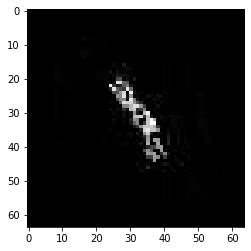

confidence for 295 is 0.99983793


confidence for 312 is 0.99999887


confidence for 341 is 0.99997085


confidence for 349 is 0.9999913


confidence for 352 is 0.9999738


confidence for 356 is 0.9999997


confidence for 362 is 0.9999788


confidence for 369 is 0.9999993


confidence for 383 is 0.99982727


confidence for 385 is 0.9999093


confidence for 388 is 0.99997675


confidence for 390 is 0.9999362


confidence for 391 is 0.9998438


confidence for 395 is 1.0


confidence for 405 is 0.99998105


confidence for 407 is 0.9999998


confidence for 410 is 0.9999481


confidence for 411 is 0.9999999


confidence for 422 is 0.9999996


confidence for 432 is 0.99990386


confidence for 530 is 0.99999946


confidence for 568 is 0.99987173


confidence for 593 is 0.9999994


confidence for 597 is 0.9999943


confidence for 650 is 0.99956346


confidence for 670 is 0.99986047


confidence for 676 is 0.99910605


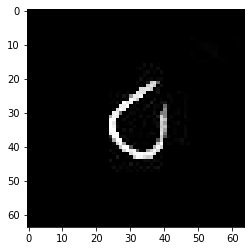

confidence for 708 is 0.9999443


confidence for 754 is 1.0


confidence for 775 is 0.9990184


confidence for 794 is 0.99999666


confidence for 845 is 0.9999997


confidence for 858 is 0.99989754


confidence for 936 is 0.9998896


confidence for 983 is 0.99994355


confidence for 994 is 0.9999998


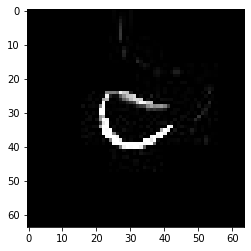

confidence for 1012 is 0.99997383


confidence for 1018 is 0.99962085


confidence for 1047 is 1.0


confidence for 1057 is 0.99999994


confidence for 1079 is 0.99905384


confidence for 1104 is 0.9997561


confidence for 1128 is 0.99999905


confidence for 1172 is 0.9996882


confidence for 1180 is 0.999474


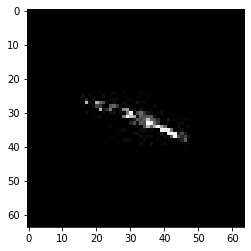

confidence for 1222 is 0.99999934


confidence for 1227 is 0.9990371


confidence for 1246 is 0.9990805


confidence for 1260 is 0.99996024


confidence for 1267 is 1.0


confidence for 1276 is 0.99999905


confidence for 1319 is 0.9999994


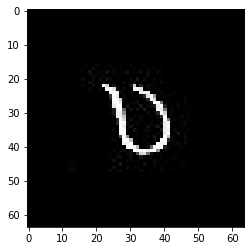

confidence for 1331 is 0.9999912


confidence for 1337 is 0.99988216


confidence for 1379 is 0.99928975


confidence for 1396 is 0.9999494


confidence for 1411 is 0.99978137


confidence for 1430 is 0.99993247


confidence for 1459 is 0.9999999


confidence for 1481 is 0.9999995


confidence for 1483 is 0.9998965


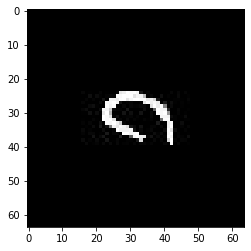

confidence for 1535 is 0.9997057


confidence for 1537 is 0.99964595


confidence for 1547 is 0.99936295


confidence for 1566 is 0.9997192


confidence for 1567 is 0.9994221


confidence for 1649 is 1.0


confidence for 1653 is 0.99977773


confidence for 1659 is 0.9999513


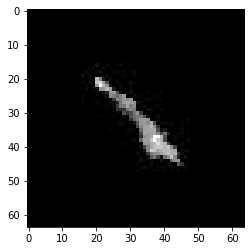

confidence for 1660 is 0.9998376


confidence for 1688 is 0.99994653


confidence for 1712 is 0.9990867


confidence for 1713 is 0.99991876


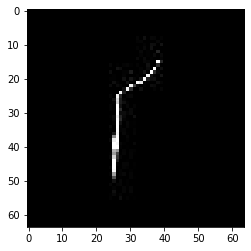

confidence for 1714 is 0.99990714


confidence for 1759 is 0.9999906


confidence for 1770 is 1.0


confidence for 1791 is 0.99998844


confidence for 1856 is 0.9999631


confidence for 1866 is 0.9998223


confidence for 1878 is 1.0


confidence for 1886 is 0.9999855


confidence for 1904 is 0.999058


confidence for 1910 is 0.9999988


confidence for 1913 is 0.9995178


confidence for 1937 is 0.9998705


confidence for 1950 is 0.99987084


confidence for 1952 is 0.99999875


confidence for 1976 is 0.9999931


confidence for 1979 is 1.0


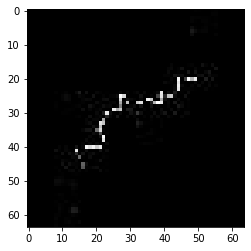

confidence for 2057 is 0.999755


confidence for 2131 is 0.99909765


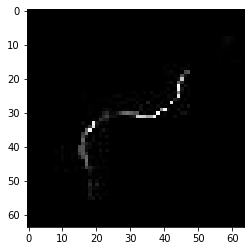

confidence for 2136 is 0.9999066


confidence for 2145 is 0.9997046


confidence for 2164 is 0.99928063


confidence for 2176 is 0.99996626


confidence for 2224 is 0.99902797


confidence for 2254 is 0.9996168


confidence for 2261 is 0.9999996


confidence for 2282 is 0.999999


confidence for 2283 is 0.9999917


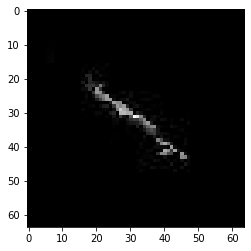

confidence for 2284 is 0.9992476


confidence for 2291 is 0.9993358


confidence for 2295 is 0.999484


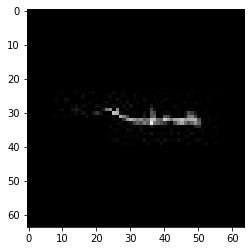

confidence for 2309 is 0.99941283


confidence for 2337 is 0.9992167


confidence for 2353 is 0.99954474


confidence for 2357 is 0.9999966


confidence for 2373 is 1.0


confidence for 2384 is 0.9999996


confidence for 2396 is 0.9995076


confidence for 2417 is 0.99999934


confidence for 2428 is 0.99968785


confidence for 2441 is 0.9999969


confidence for 2443 is 0.9999997


confidence for 2473 is 0.9993588


confidence for 2490 is 0.9996935


confidence for 2537 is 0.9999053


confidence for 2560 is 0.9999642


confidence for 2574 is 0.99997723


confidence for 2675 is 0.9999929


confidence for 2705 is 0.9998767


confidence for 2727 is 0.9997348


confidence for 2731 is 0.99932724


confidence for 2733 is 0.9999996


confidence for 2774 is 0.9999999


confidence for 2875 is 0.99998116


confidence for 2984 is 0.9992405


confidence for 3017 is 0.99972445


confidence for 3024 is 0.99919486


confidence for 3026 is 1.0


confidence for 3096 is 0.99998266


confidence for 3109 is 0.9990329


confidence for 3119 is 0.9999998


confidence for 3128 is 0.99999076


confidence for 3138 is 0.9990946


confidence for 3167 is 0.9999993


confidence for 3180 is 0.99999946


confidence for 3252 is 0.9997367


confidence for 3314 is 0.9999997


confidence for 3349 is 0.9999936


confidence for 3417 is 0.9996095


confidence for 3451 is 0.99947554


confidence for 3474 is 0.99988663


confidence for 3491 is 0.999949


confidence for 3492 is 0.99995846


confidence for 3528 is 0.9999272


confidence for 3531 is 0.99960816


confidence for 3573 is 1.0


confidence for 3574 is 0.99929976


confidence for 3577 is 0.99940115


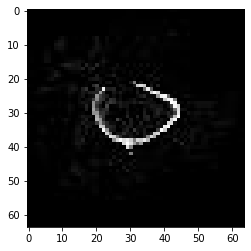

confidence for 3600 is 0.9999481


confidence for 3690 is 0.9999873


confidence for 3775 is 0.9999994


confidence for 3785 is 0.99992627


confidence for 3804 is 0.99998504


confidence for 3851 is 1.0


confidence for 3877 is 0.999497


confidence for 3888 is 0.99997395


confidence for 3963 is 0.9999794


confidence for 3968 is 0.9999716


confidence for 3974 is 0.9995782


confidence for 4001 is 0.99959177


confidence for 4032 is 0.9990063


confidence for 4051 is 0.99917054


confidence for 4073 is 0.9999942


confidence for 4083 is 1.0


confidence for 4110 is 0.999691


confidence for 4133 is 0.999995


confidence for 4149 is 0.9999774


confidence for 4165 is 0.999605


confidence for 4197 is 1.0


confidence for 4291 is 0.9999509


confidence for 4300 is 0.99993926


confidence for 4305 is 0.99990135


confidence for 4312 is 0.99983186


confidence for 4319 is 0.9995337


confidence for 4350 is 0.9999967


confidence for 4361 is 1.0


confidence for 4380 is 0.99995536


confidence for 4417 is 0.9999898


confidence for 4487 is 0.9999975


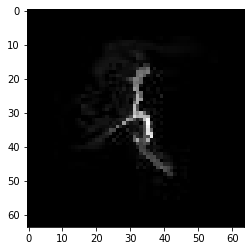

confidence for 4489 is 0.9999549


confidence for 4493 is 0.99960476


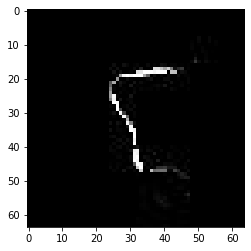

confidence for 4497 is 0.999999


confidence for 4500 is 0.9997695


confidence for 4505 is 0.9999906


confidence for 4518 is 0.9997842


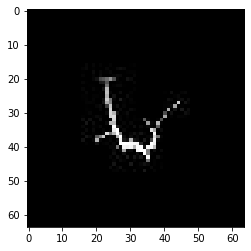

confidence for 4521 is 1.0


confidence for 4522 is 0.9990685


confidence for 4538 is 0.99943036


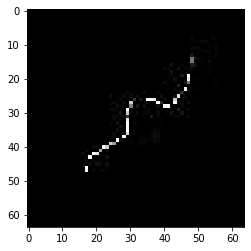

confidence for 4542 is 0.9998276


confidence for 4564 is 0.9997919


confidence for 4569 is 0.9999645


confidence for 4571 is 0.9999674


confidence for 4603 is 0.9999997


confidence for 4624 is 0.99997026


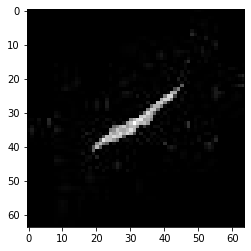

confidence for 4631 is 0.99998146


confidence for 4632 is 0.99991953


confidence for 4633 is 0.9999928


confidence for 4635 is 0.99999946


confidence for 4651 is 0.9999999


confidence for 4652 is 1.0


confidence for 4669 is 0.9992146


confidence for 4677 is 0.99987596


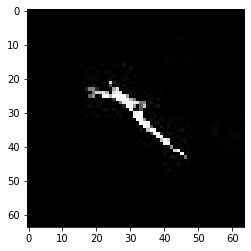

confidence for 4717 is 0.9994486


confidence for 4790 is 0.99999666


confidence for 4807 is 0.99974155


confidence for 4814 is 0.99976265


confidence for 4818 is 0.9999932


confidence for 4825 is 0.99921125


confidence for 4838 is 0.99947035


confidence for 4844 is 0.99999905


confidence for 4857 is 0.999803


confidence for 4870 is 0.99958974


confidence for 4880 is 0.9994657


confidence for 4886 is 0.99997354


confidence for 4887 is 0.9999983


confidence for 4913 is 1.0


confidence for 4917 is 0.99938315


confidence for 4937 is 0.99999297


confidence for 4945 is 0.99961674


confidence for 4972 is 0.99999946


confidence for 4977 is 0.9999969


confidence for 4997 is 0.9999063


confidence for 5007 is 0.99920166


confidence for 5014 is 0.9998506


confidence for 5037 is 0.99988824


confidence for 5066 is 0.99997514


confidence for 5070 is 0.9998851


confidence for 5085 is 1.0


confidence for 5096 is 0.9999963


confidence for 5099 is 0.99999994


confidence for 5115 is 0.999789


confidence for 5126 is 0.999975


confidence for 5160 is 0.99999535


confidence for 5251 is 0.9999998


confidence for 5264 is 0.99953187


confidence for 5282 is 0.9999764


confidence for 5392 is 0.99937063


confidence for 5418 is 0.99938965


confidence for 5444 is 0.99999535


confidence for 5447 is 0.9999545


confidence for 5505 is 0.99974996


confidence for 5536 is 0.9991122


confidence for 5558 is 0.9999991


confidence for 5571 is 0.9992341


confidence for 5584 is 0.9999977


confidence for 5600 is 0.9999218


confidence for 5611 is 0.9997122


confidence for 5643 is 0.99999994


confidence for 5647 is 0.9999616


confidence for 5666 is 0.99955755


confidence for 5686 is 0.9991579


confidence for 5712 is 0.9996033


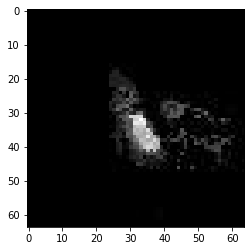

confidence for 5724 is 0.99986434


confidence for 5727 is 1.0


confidence for 5749 is 0.99998647


confidence for 5752 is 0.9999995


confidence for 5758 is 0.99994874


confidence for 5762 is 0.99961936


confidence for 5779 is 1.0


confidence for 5796 is 0.9991495


confidence for 5834 is 0.99999034


confidence for 5835 is 0.9998062


confidence for 5901 is 0.9999413


confidence for 5954 is 0.999479


confidence for 5999 is 0.9999998


confidence for 6022 is 0.99999565


confidence for 6035 is 0.9999978


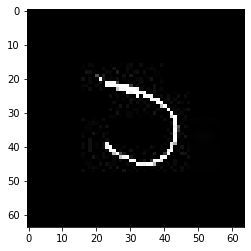

confidence for 6060 is 0.99998766


confidence for 6065 is 0.9997743


confidence for 6122 is 0.9993044


confidence for 6157 is 0.99999946


confidence for 6158 is 0.99917525


confidence for 6161 is 0.99969023


confidence for 6173 is 0.9996459


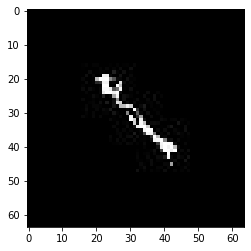

confidence for 6175 is 0.9999736


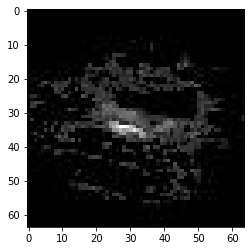

confidence for 6177 is 0.99916905


confidence for 6178 is 0.99999964


confidence for 6195 is 0.9998603


confidence for 6221 is 0.9999748


confidence for 6228 is 0.99999833


confidence for 6240 is 0.9991936


confidence for 6243 is 0.99919736


confidence for 6258 is 0.99930805


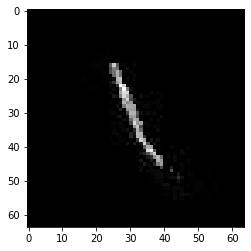

confidence for 6289 is 0.99982166


confidence for 6292 is 0.99917096


confidence for 6315 is 0.9998393


confidence for 6318 is 0.99913085


confidence for 6333 is 0.99945235


confidence for 6388 is 0.9995833


confidence for 6448 is 0.9999988


confidence for 6459 is 0.999881


confidence for 6514 is 0.9999999


confidence for 6523 is 0.9999311


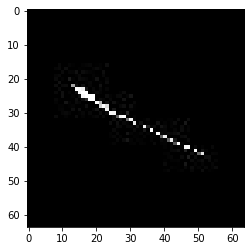

confidence for 6539 is 0.9999999


confidence for 6650 is 0.99918973


confidence for 6757 is 0.99999994


confidence for 6786 is 0.999958


confidence for 6790 is 0.9998938


confidence for 6910 is 0.9999735


confidence for 6913 is 0.99944437


confidence for 6926 is 0.9999985


confidence for 6928 is 0.999995


confidence for 6935 is 1.0


confidence for 6943 is 0.9999999


confidence for 6950 is 0.9999746


confidence for 6953 is 0.9999742


confidence for 6972 is 0.99973524


confidence for 6981 is 0.9996252


confidence for 7006 is 1.0


confidence for 7013 is 0.99967456


confidence for 7023 is 0.99998647


confidence for 7083 is 0.9995433


confidence for 7129 is 1.0


confidence for 7149 is 0.9999913


confidence for 7155 is 0.9999999


confidence for 7157 is 0.9999564


confidence for 7164 is 0.99991095


confidence for 7176 is 0.99999577


confidence for 7220 is 0.9995425


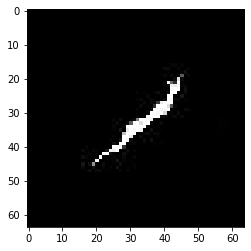

confidence for 7293 is 0.9998992


confidence for 7332 is 0.9999892


confidence for 7345 is 0.9997307


confidence for 7350 is 0.999852


confidence for 7365 is 1.0


confidence for 7369 is 0.99960744


confidence for 7381 is 0.9999329


confidence for 7396 is 0.9999873


confidence for 7413 is 0.9999945


confidence for 7418 is 0.99949074


confidence for 7426 is 0.9997782


confidence for 7473 is 0.9998695


confidence for 7475 is 0.9999996


confidence for 7478 is 0.99999815


confidence for 7493 is 0.9991246


confidence for 7519 is 0.99907726


confidence for 7533 is 0.9999523


confidence for 7627 is 0.9999998


confidence for 7644 is 0.9999934


confidence for 7721 is 0.9994544


confidence for 7732 is 0.999636


confidence for 7748 is 0.99933934


confidence for 7832 is 0.9995798


confidence for 7837 is 0.999088


confidence for 7845 is 0.99931675


confidence for 7874 is 0.99955904


confidence for 7875 is 0.99959505


confidence for 7937 is 0.9999941


confidence for 7944 is 0.99991804


confidence for 7991 is 1.0


confidence for 8023 is 0.9997396


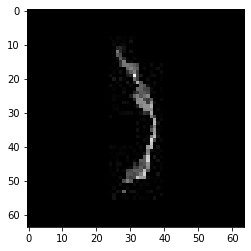

confidence for 8070 is 0.99942005


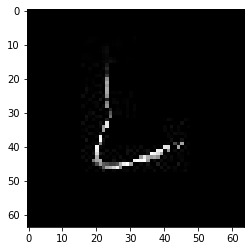

confidence for 8102 is 0.9999932


confidence for 8112 is 0.99996847


confidence for 8113 is 0.99999994


confidence for 8137 is 0.999767


confidence for 8245 is 0.9999981


confidence for 8263 is 0.99964803


confidence for 8284 is 0.9999957


confidence for 8311 is 0.9999212


confidence for 8325 is 0.9999768


confidence for 8351 is 0.9997219


confidence for 8353 is 0.99931186


confidence for 8365 is 0.9999662


confidence for 8368 is 0.99999404


confidence for 8388 is 0.99984866


confidence for 8401 is 0.9999987


confidence for 8419 is 0.9994416


confidence for 8455 is 0.9999541


confidence for 8520 is 0.9999984


confidence for 8564 is 0.9999944


confidence for 8586 is 0.99984586


confidence for 8604 is 0.9999974


confidence for 8605 is 1.0


confidence for 8607 is 1.0


confidence for 8640 is 0.99996585


confidence for 8694 is 0.9998716


confidence for 8699 is 0.9992391


confidence for 8725 is 0.9999883


confidence for 8728 is 0.99989253


confidence for 8737 is 0.99978036


confidence for 8758 is 0.9992917


confidence for 8764 is 0.9999694


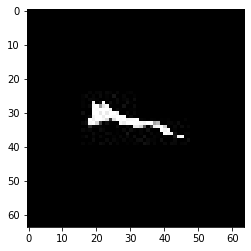

confidence for 8773 is 0.9999787


confidence for 8783 is 0.9999894


confidence for 8825 is 0.99999696


In [39]:
rivercount = 0

for i in rivers:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    plt.imshow(img)
    print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
    plt.show()
    if ((rivercount // 8) == 0):
        img.save("../data/task1_new_strategy/train/river/"+str(i[0]+length_train_rivers)+".jpeg", "JPEG")
    if ((rivercount//8) == 1):
        img.save("../data/task1_new_strategy/test/river/"+str(i[0]+length_test_rivers)+".jpeg", "JPEG")
    if (rivercount < 9):
        rivercount += 1
    if (rivercount == 9):
        rivercount = 0

othercount = 0
    
for i in other:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    if ((othercount // 8) == 0):
        img.save("../data/task1_new_strategy/train/other/"+str(i[0]+length_train_other)+".jpeg", "JPEG")
    if ((othercount//8) == 1):
        img.save("../data/task1_new_strategy/test/other/"+str(i[0]+length_test_other)+".jpeg", "JPEG")
    if (othercount < 9):
        othercount += 1
    if (othercount == 9):
        othercount = 0
        
length_unlabeled = len(fnmatch.filter(os.listdir("../data/task1_unlabeled_12_12"), '*.jpeg'))        


In [ ]:
for i in unclassified:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    img.save("../data/task1_unlabeled_12_12/"+str(i[0]+length_unlabeled)+".jpeg", "JPEG")
    
print("COMPLETE")

In [19]:
# train_accuracies = []
# test_accuracies = []

# while (abs(test_accuracies[len(test_accuracies)-1] - test_accuracies[len(test_accuracies)-2]) > .00001):
#     train_augmentation = ImageDataGenerator(
#         rescale = 1./255,
#         shear_range = 0.2,
#         horizontal_flip = True,
#         rotation_range=20,
#         width_shift_range=0.2,
#         height_shift_range=0.2,
#     )

#     test_rescale = ImageDataGenerator(
#         rescale = 1./255
#     )

#     train_path = '../data/task1_new_strategy/train'
#     valid_path = '../data/task1_new_strategy/test'
#     training = train_augmentation.flow_from_directory(train_path,
#                                                      target_size = (64,64),
#                                                      batch_size = 8,
#                                                      class_mode = 'binary')
#     testing = test_rescale.flow_from_directory(valid_path,
#                                                    target_size = (64,64),
#                                                    batch_size = 8,
#                                                    class_mode = 'binary')

#     IMAGE_SIZE = [64,64]

#     resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
#                                                   include_top = False,
#                                                   classes = 2
#                                                   #input_shape=(64,64,3)
#                                                  )

#     for layer in resnet50v2.layers:
#         layer.trainable = False

#     resnet50v2.summary()

#     output = resnet50v2.output
#     output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
#     output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
#     y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
#     resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
#     resnet50v2model.compile(loss='binary_crossentropy', 
#                             optimizer='adam',
#                             metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

#     hist = resnet50v2model.fit(training,
#                     validation_data = testing,
#                     epochs = 20,
#                     steps_per_epoch=len(training),
#                     validation_steps=len(testing))

#     train_score = resnet50v2model.evaluate(training)
#     test_score = resnet50v2model.evaluate(testing)
#     print("train accuracy:",train_score[1]*100,"%")
#     print("test accuracy:", test_score[1]*100,"%")
#     train_accuracies.append(train_score[1])
#     test_accuracies.append(test_score[1])
    
#     from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

#     results = []
#     rivers = []
#     other = []
#     unclassified = []
#     threshold = 0.999
#     model = resnet50v2model

#     for i in range(25000):
#         img_path = '../data/shonal_unlabeled/unlabeled/'+str(i)+'.jpeg'
#         img = image.load_img(img_path, target_size=(64,64))
#         x = image.img_to_array(img)
#         x = np.expand_dims(x, axis=0)
#         x = preprocess_input(x)
#         # print(model.predict(x))
#         results.append(model.predict(x))
#         if (model.predict(x) > threshold):
#             print("----------------------------------------------------------------------"+str(i)+" is a predicted river")

#     for i in range(len(results)):
#         if (results[i][0] >= threshold):
#             rivers.append([i,results[i][0]])
#         if (results[i][0] < (1-threshold)):
#             other.append([i,results[i][0]])
#         if (results[i][0] < threshold and results[i][0] >= (1-threshold)):
#             unclassified.append([i,results[i][0]])

#     print("number of rivers w 99.9% confidence:",len(rivers))
#     print("number of other w 99.9% confidence:",len(other))

#     length_train_rivers = len(fnmatch.filter(os.listdir(train_path+"/river"), '*.jpeg'))
#     length_train_other = len(fnmatch.filter(os.listdir(train_path+"/other"), '*.jpeg'))
#     length_test_rivers = len(fnmatch.filter(os.listdir(valid_path+"/river"), '*.jpeg'))
#     length_test_other = len(fnmatch.filter(os.listdir(valid_path+"/other"), '*.jpeg'))


#     rivercount = 0

#     for i in rivers:
#         img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
#         img = image.load_img(img_path, target_size=(64,64))
#         plt.imshow(img)
#         print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
#         plt.show()
#         if ((rivercount // 8) == 0):
#             img.save("../data/task1_new_strategy/train/river/"+str(i[0]+length_train_rivers)+".jpeg", "JPEG")
#         if ((rivercount//8) == 1):
#             img.save("../data/task1_new_strategy/test/river/"+str(i[0]+length_test_rivers)+".jpeg", "JPEG")
#         if (rivercount < 9):
#             rivercount += 1
#         if (rivercount == 9):
#             rivercount = 0

#     othercount = 0

#     for i in other:
#         img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
#         img = image.load_img(img_path, target_size=(64,64))
#         if ((othercount // 8) == 0):
#             img.save("../data/task1_new_strategy/train/other/"+str(i[0]+length_train_other)+".jpeg", "JPEG")
#         if ((othercount//8) == 1):
#             img.save("../data/task1_new_strategy/test/other/"+str(i[0]+length_test_other)+".jpeg", "JPEG")
#         if (othercount < 9):
#             othercount += 1
#         if (othercount == 9):
#             othercount = 0

#     length_unlabeled = len(fnmatch.filter(os.listdir("../data/task1_unlabeled_12_12"), '*.jpeg'))        
            
#     for i in unclassified:
#         img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
#         img = image.load_img(img_path, target_size=(64,64))
#         img.save("../data/task1_unlabeled_12_12/"+str(i[0]+length_unlabeled)+".jpeg", "JPEG")
        
#     print("COMPLETE")

253
253
1148
64
288


# take 2

In [1]:
from tensorflow.keras.layers import Flatten, Dense, Input, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import load_img,ImageDataGenerator, img_to_array
import tensorflow as tf
# from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions


import numpy as np
from glob import glob
import os
import matplotlib.pyplot as plt 

import fnmatch

2022-12-12 20:50:23.188738: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-12 20:50:25.716104: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-12 20:50:25.716149: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2022-12-12 20:50:25.929367: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2022-12-12 20:5

In [2]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

train_path = '../data/shonal/train'
valid_path = '../data/shonal/test'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (64,64),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (64,64),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 1406 images belonging to 2 classes.
Found 352 images belonging to 2 classes.


In [3]:
IMAGE_SIZE = [64,64]

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                              include_top = False,
                                              classes = 2
                                              #input_shape=(64,64,3)
                                             )

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', 
                        optimizer='adam',
                        metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))

2022-12-12 20:50:42.559670: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-12 20:50:42.559797: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-12 20:50:42.559889: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /panfs/roc/msisoft/cuda/10.0/lib64
2022-12-12 20:50:42.559964: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcufft.so.10'; dlerror: libcu

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                      

                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
                                                                                                  
 conv2_blo

                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)                           128)                                                              
          

 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_1 (MaxPooling2D)  (None, None, None,   0          ['conv3_block3_out[0][0]']       
                                512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_block4_out (Add)         (None, None, None,   0           ['max_pooling2d_1[0][0]',        
          

                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_blo

                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
                                1024)                                                             
          

 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block2_preact_relu[0][0]'
          

In [4]:
train_score = resnet50v2model.evaluate(training)
test_score = resnet50v2model.evaluate(testing)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

44/44 [==============================] - 1s 21ms/step - loss: 0.0824 - accuracy: 0.9858 - precision: 0.9403 - recall: 0.9844
train accuracy: 98.57752323150635 %
test accuracy: 98.57954382896423 %


In [5]:
unlabeled_path = "../data/task1_unlabeled_12_12"

----------------------------------------------------------------------54 is a predicted river
----------------------------------------------------------------------89 is a predicted river
----------------------------------------------------------------------114 is a predicted river
----------------------------------------------------------------------140 is a predicted river
----------------------------------------------------------------------232 is a predicted river
----------------------------------------------------------------------296 is a predicted river
----------------------------------------------------------------------336 is a predicted river
----------------------------------------------------------------------343 is a predicted river
----------------------------------------------------------------------379 is a predicted river
----------------------------------------------------------------------648 is a predicted river
----------------------------------------------------

----------------------------------------------------------------------4161 is a predicted river
----------------------------------------------------------------------4240 is a predicted river
----------------------------------------------------------------------4302 is a predicted river
----------------------------------------------------------------------4314 is a predicted river
----------------------------------------------------------------------4362 is a predicted river
----------------------------------------------------------------------4425 is a predicted river
----------------------------------------------------------------------4584 is a predicted river
----------------------------------------------------------------------4599 is a predicted river
----------------------------------------------------------------------4634 is a predicted river
----------------------------------------------------------------------4643 is a predicted river
----------------------------------------

----------------------------------------------------------------------8088 is a predicted river
----------------------------------------------------------------------8135 is a predicted river
----------------------------------------------------------------------8141 is a predicted river
----------------------------------------------------------------------8185 is a predicted river
----------------------------------------------------------------------8235 is a predicted river
----------------------------------------------------------------------8312 is a predicted river
----------------------------------------------------------------------8336 is a predicted river
----------------------------------------------------------------------8379 is a predicted river
----------------------------------------------------------------------8421 is a predicted river
----------------------------------------------------------------------8535 is a predicted river
----------------------------------------

----------------------------------------------------------------------11599 is a predicted river
----------------------------------------------------------------------11637 is a predicted river
----------------------------------------------------------------------11675 is a predicted river
----------------------------------------------------------------------11715 is a predicted river
----------------------------------------------------------------------11752 is a predicted river
----------------------------------------------------------------------11774 is a predicted river
----------------------------------------------------------------------11823 is a predicted river
----------------------------------------------------------------------11948 is a predicted river
----------------------------------------------------------------------11975 is a predicted river
----------------------------------------------------------------------12021 is a predicted river
------------------------------

----------------------------------------------------------------------14064 is a predicted river
----------------------------------------------------------------------14092 is a predicted river
----------------------------------------------------------------------14172 is a predicted river
----------------------------------------------------------------------14201 is a predicted river
----------------------------------------------------------------------14207 is a predicted river
----------------------------------------------------------------------14237 is a predicted river
----------------------------------------------------------------------14280 is a predicted river
----------------------------------------------------------------------14312 is a predicted river
----------------------------------------------------------------------14385 is a predicted river
----------------------------------------------------------------------14426 is a predicted river
------------------------------

----------------------------------------------------------------------15657 is a predicted river
----------------------------------------------------------------------15672 is a predicted river
----------------------------------------------------------------------15698 is a predicted river
----------------------------------------------------------------------15701 is a predicted river
----------------------------------------------------------------------15709 is a predicted river
----------------------------------------------------------------------15723 is a predicted river
----------------------------------------------------------------------15727 is a predicted river
----------------------------------------------------------------------15734 is a predicted river
----------------------------------------------------------------------15740 is a predicted river
----------------------------------------------------------------------15742 is a predicted river
------------------------------

----------------------------------------------------------------------17471 is a predicted river
----------------------------------------------------------------------17484 is a predicted river
----------------------------------------------------------------------17486 is a predicted river
----------------------------------------------------------------------17496 is a predicted river
----------------------------------------------------------------------17525 is a predicted river
----------------------------------------------------------------------17536 is a predicted river
----------------------------------------------------------------------17537 is a predicted river
----------------------------------------------------------------------17538 is a predicted river
----------------------------------------------------------------------17558 is a predicted river
----------------------------------------------------------------------17564 is a predicted river
------------------------------

----------------------------------------------------------------------19183 is a predicted river
----------------------------------------------------------------------19191 is a predicted river
----------------------------------------------------------------------19242 is a predicted river
----------------------------------------------------------------------19244 is a predicted river
----------------------------------------------------------------------19252 is a predicted river
----------------------------------------------------------------------19297 is a predicted river
----------------------------------------------------------------------19301 is a predicted river
----------------------------------------------------------------------19315 is a predicted river
----------------------------------------------------------------------19319 is a predicted river
----------------------------------------------------------------------19350 is a predicted river
------------------------------

----------------------------------------------------------------------21145 is a predicted river
----------------------------------------------------------------------21150 is a predicted river
----------------------------------------------------------------------21166 is a predicted river
----------------------------------------------------------------------21193 is a predicted river
----------------------------------------------------------------------21197 is a predicted river
----------------------------------------------------------------------21201 is a predicted river
----------------------------------------------------------------------21202 is a predicted river
----------------------------------------------------------------------21221 is a predicted river
----------------------------------------------------------------------21267 is a predicted river
----------------------------------------------------------------------21278 is a predicted river
------------------------------

----------------------------------------------------------------------23171 is a predicted river
----------------------------------------------------------------------23193 is a predicted river
----------------------------------------------------------------------23222 is a predicted river
----------------------------------------------------------------------23279 is a predicted river
----------------------------------------------------------------------23301 is a predicted river
----------------------------------------------------------------------23305 is a predicted river
----------------------------------------------------------------------23326 is a predicted river
----------------------------------------------------------------------23342 is a predicted river
----------------------------------------------------------------------23351 is a predicted river
----------------------------------------------------------------------23353 is a predicted river
------------------------------

----------------------------------------------------------------------24847 is a predicted river
----------------------------------------------------------------------24850 is a predicted river
----------------------------------------------------------------------24856 is a predicted river
----------------------------------------------------------------------24870 is a predicted river
----------------------------------------------------------------------24873 is a predicted river
----------------------------------------------------------------------24875 is a predicted river
----------------------------------------------------------------------24880 is a predicted river
----------------------------------------------------------------------24949 is a predicted river
----------------------------------------------------------------------24951 is a predicted river
----------------------------------------------------------------------24960 is a predicted river
number of rivers: 862
number o

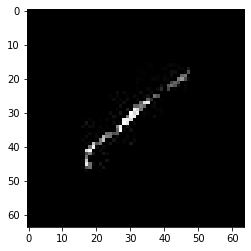

confidence for 89 is 0.9997587


confidence for 114 is 0.99997574


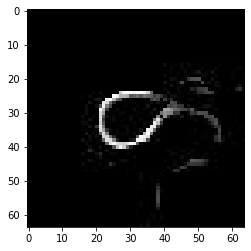

confidence for 140 is 0.99999756


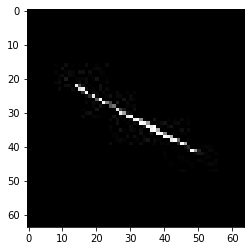

confidence for 232 is 0.9999468


confidence for 296 is 0.9999992


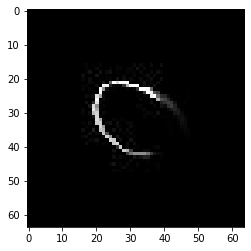

confidence for 336 is 0.9991638


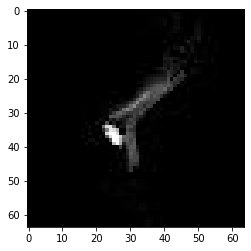

confidence for 343 is 0.9999889


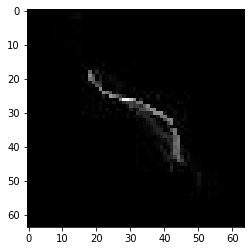

confidence for 379 is 0.9994079


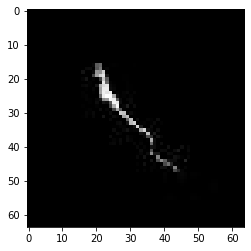

confidence for 648 is 0.99968296


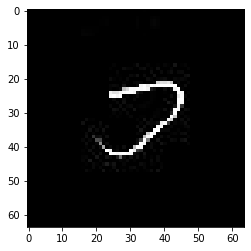

confidence for 746 is 0.9995515


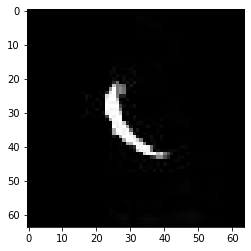

confidence for 879 is 1.0


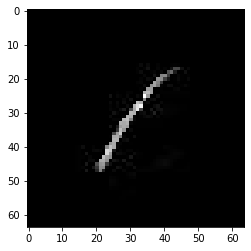

confidence for 892 is 0.99968356


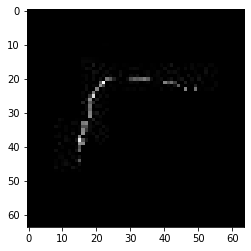

confidence for 894 is 0.9999896


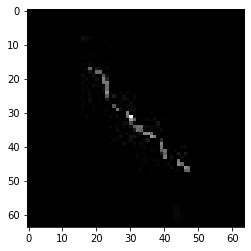

confidence for 946 is 0.9997256


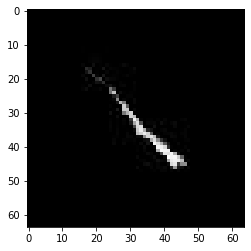

confidence for 949 is 0.9998799


confidence for 972 is 0.9999393


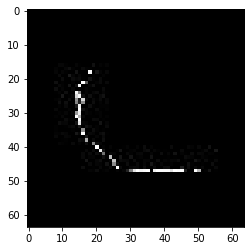

confidence for 994 is 0.99999744


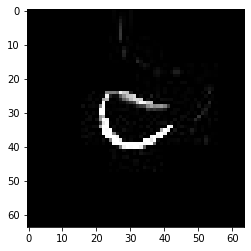

confidence for 995 is 1.0


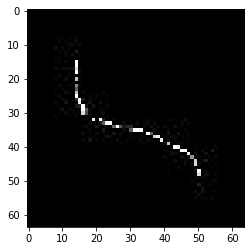

confidence for 1043 is 0.999674


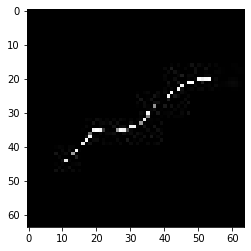

confidence for 1055 is 0.9999106


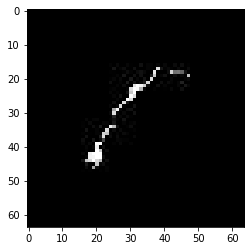

confidence for 1150 is 0.9999978


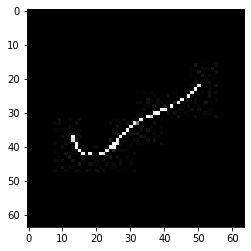

confidence for 1196 is 0.9998956


confidence for 1208 is 0.9998386


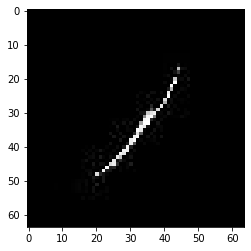

confidence for 1209 is 0.9994483


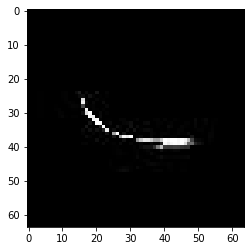

confidence for 1217 is 0.9999175


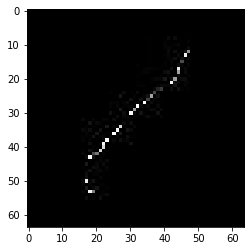

confidence for 1228 is 0.9997328


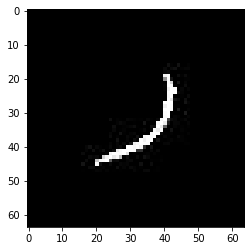

confidence for 1262 is 0.9999989


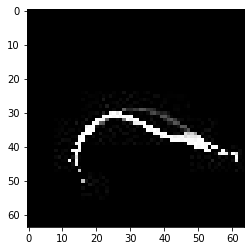

confidence for 1319 is 0.99991804


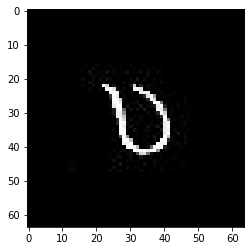

confidence for 1334 is 0.99961734


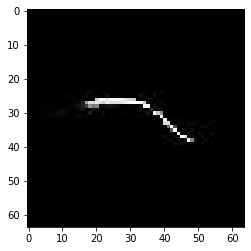

confidence for 1367 is 0.9999998


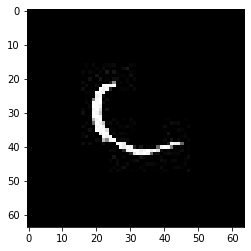

confidence for 1375 is 0.9991581


confidence for 1376 is 0.9998571


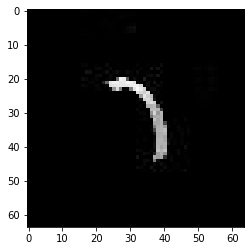

confidence for 1401 is 0.9999986


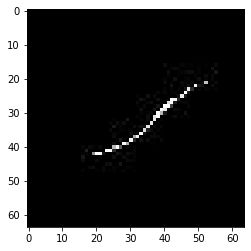

confidence for 1408 is 0.99964035


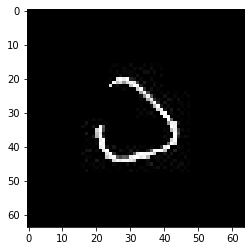

confidence for 1455 is 0.99998987


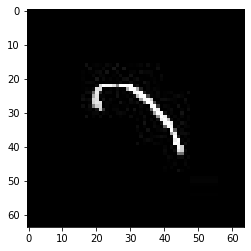

confidence for 1586 is 0.99978125


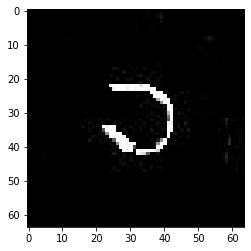

confidence for 1700 is 0.99998677


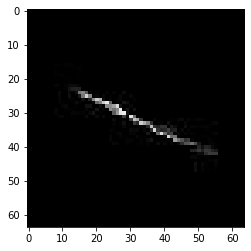

confidence for 1758 is 0.9999787


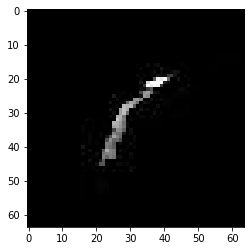

confidence for 1837 is 0.9999855


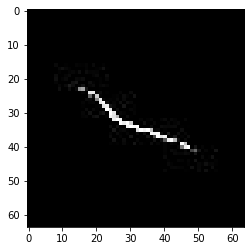

confidence for 1850 is 0.9998444


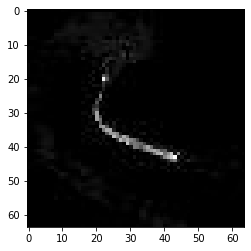

confidence for 1971 is 0.9998302


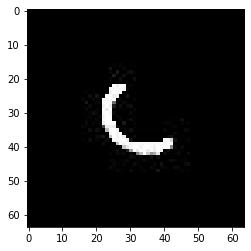

confidence for 2111 is 0.99982


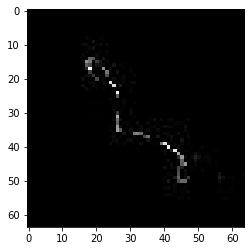

confidence for 2131 is 0.99997157


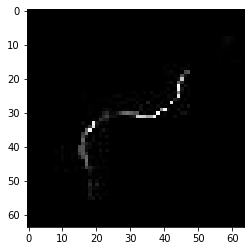

confidence for 2191 is 0.9999933


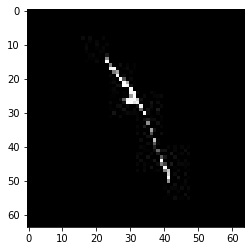

confidence for 2387 is 0.9998921


confidence for 2409 is 0.9999796


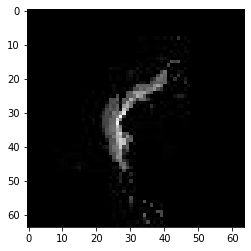

confidence for 2486 is 0.9995198


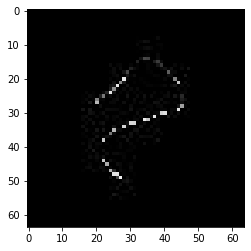

confidence for 2490 is 1.0


confidence for 2566 is 0.99998873


confidence for 2616 is 0.99977726


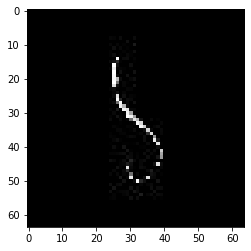

confidence for 2644 is 0.9997049


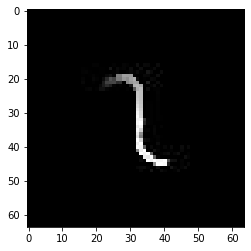

confidence for 2672 is 0.99995166


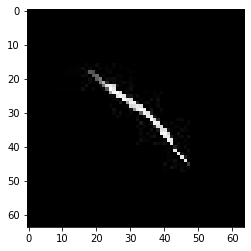

confidence for 2680 is 0.99988353


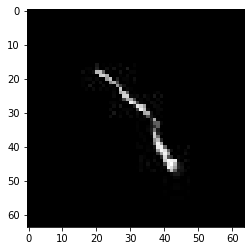

confidence for 2698 is 0.9999997


confidence for 2799 is 0.9998769


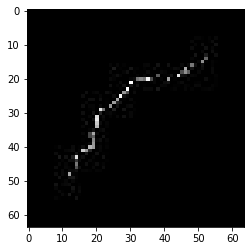

confidence for 2823 is 0.99935704


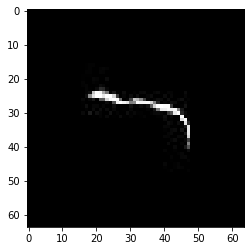

confidence for 2862 is 0.9999658


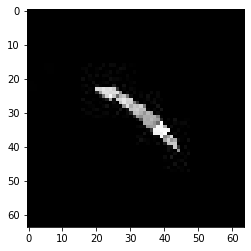

confidence for 3095 is 0.9996912


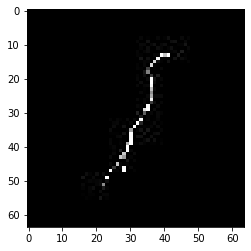

confidence for 3268 is 0.99983895


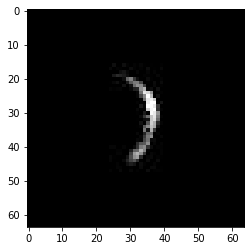

confidence for 3271 is 0.99972


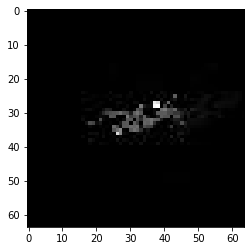

confidence for 3275 is 0.9999998


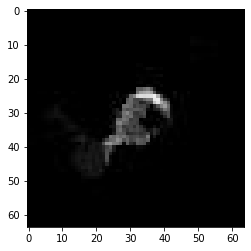

confidence for 3306 is 1.0


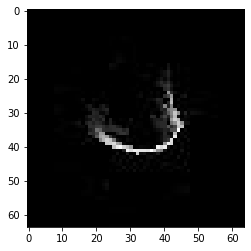

confidence for 3351 is 0.99997526


confidence for 3414 is 0.9999785


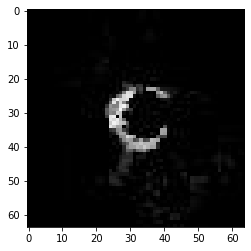

confidence for 3444 is 0.999223


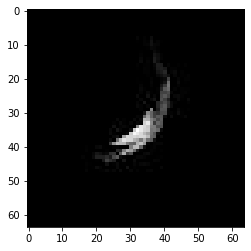

confidence for 3526 is 0.99970114


confidence for 3540 is 0.9997065


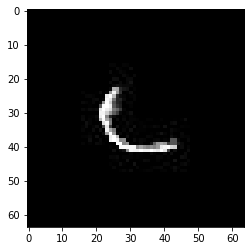

confidence for 3577 is 0.99984336


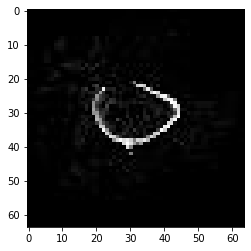

confidence for 3638 is 0.9998905


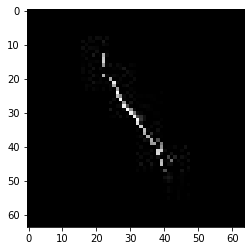

confidence for 3710 is 0.9999695


confidence for 3731 is 1.0


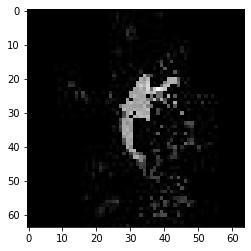

confidence for 3734 is 0.99988896


confidence for 3806 is 0.9998578


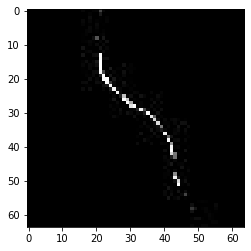

confidence for 3826 is 0.9993615


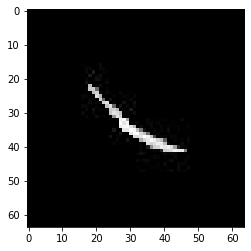

confidence for 3832 is 0.9998155


confidence for 3916 is 0.99901074


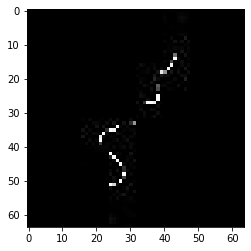

confidence for 3918 is 0.9999999


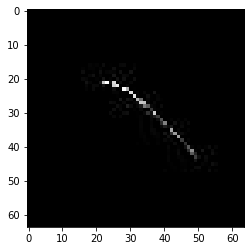

confidence for 3926 is 0.9999944


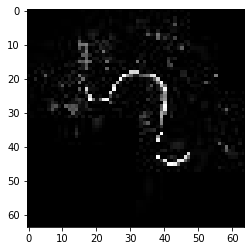

confidence for 3961 is 0.99999976


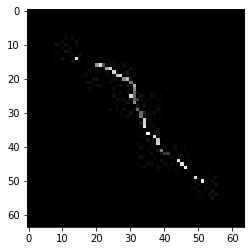

confidence for 3973 is 0.999846


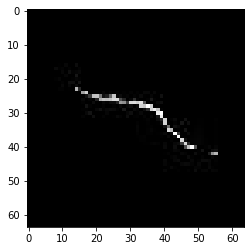

confidence for 4005 is 0.9999363


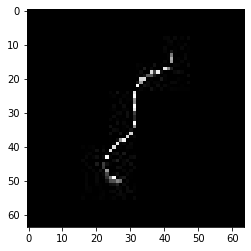

confidence for 4012 is 0.9998033


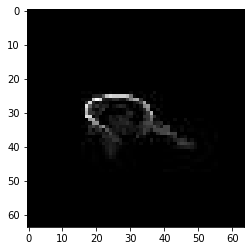

confidence for 4074 is 0.9997262


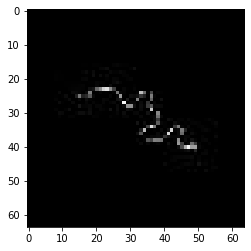

confidence for 4084 is 0.9996139


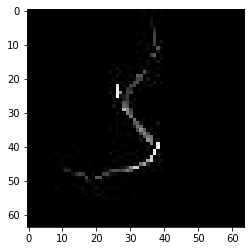

confidence for 4151 is 0.99993646


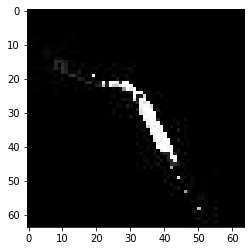

confidence for 4161 is 0.99983644


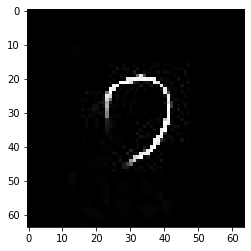

confidence for 4240 is 0.99996185


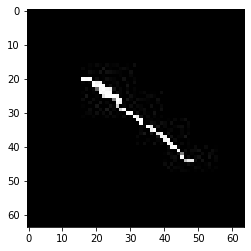

confidence for 4302 is 0.99999994


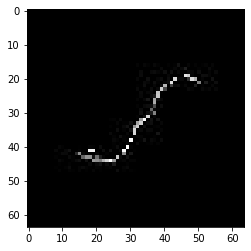

confidence for 4314 is 0.999834


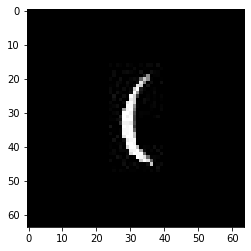

confidence for 4362 is 0.99927133


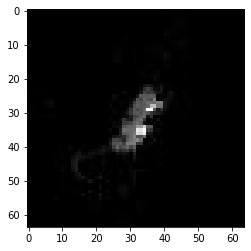

confidence for 4425 is 0.9994634


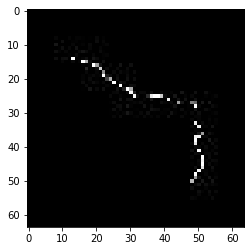

confidence for 4584 is 0.9997577


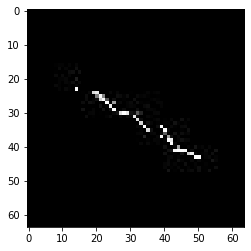

confidence for 4599 is 0.9998203


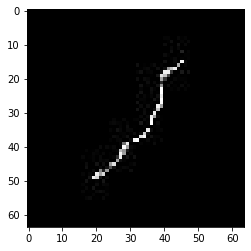

confidence for 4634 is 1.0


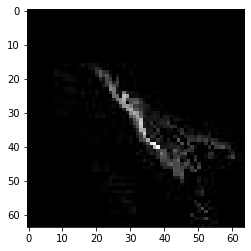

confidence for 4643 is 0.99988866


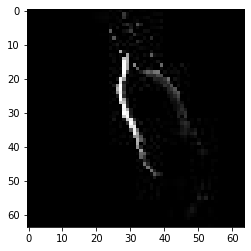

confidence for 4652 is 0.99995816


confidence for 4668 is 0.99999624


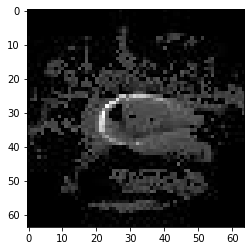

confidence for 4746 is 0.99957263


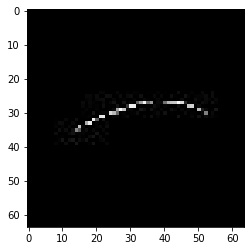

confidence for 4757 is 0.99914217


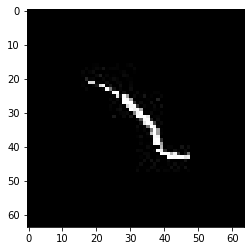

confidence for 4763 is 0.9999971


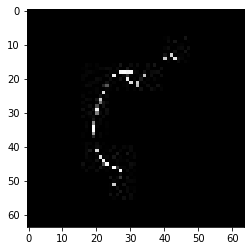

confidence for 4791 is 0.99991965


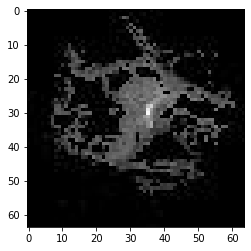

confidence for 4839 is 0.99986064


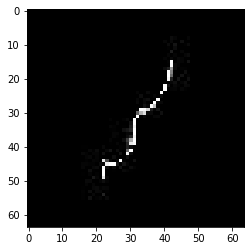

confidence for 4845 is 0.9999973


confidence for 4906 is 0.999422


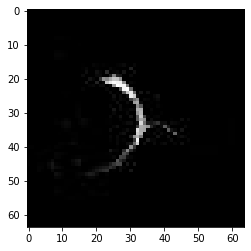

confidence for 4933 is 0.99971795


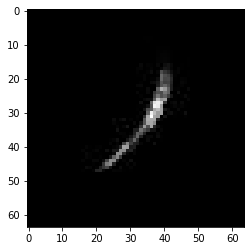

confidence for 5026 is 0.99995065


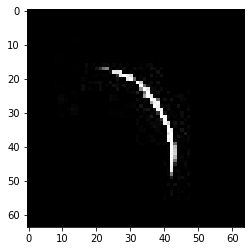

confidence for 5082 is 0.9990806


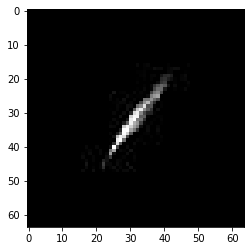

confidence for 5127 is 0.99913955


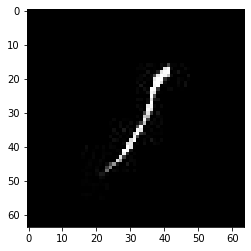

confidence for 5131 is 0.9999221


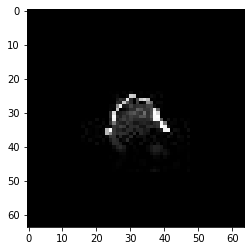

confidence for 5365 is 0.99944353


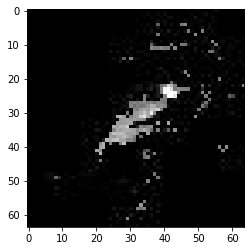

confidence for 5517 is 0.9996815


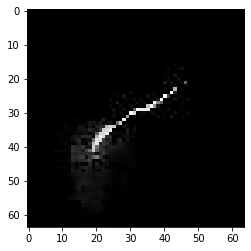

confidence for 5560 is 0.9990223


confidence for 5591 is 0.99938464


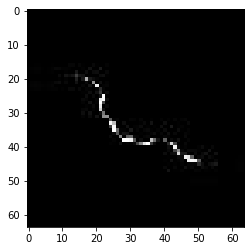

confidence for 5654 is 0.99996006


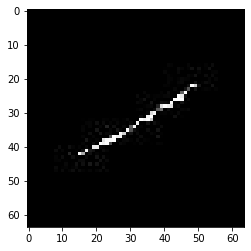

confidence for 5679 is 0.9999681


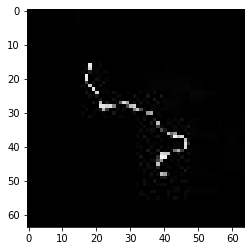

confidence for 5712 is 0.99984694


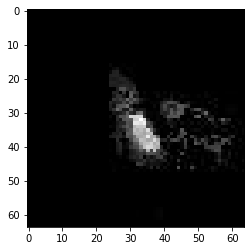

confidence for 5729 is 0.9999984


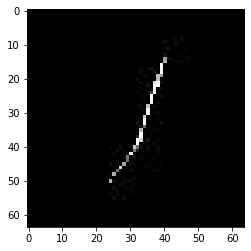

confidence for 5745 is 0.9999133


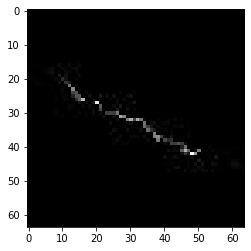

confidence for 5793 is 0.99979216


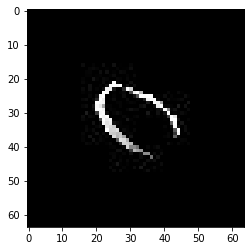

confidence for 5803 is 0.9990044


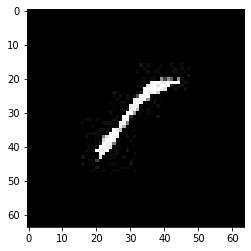

confidence for 5824 is 0.99969655


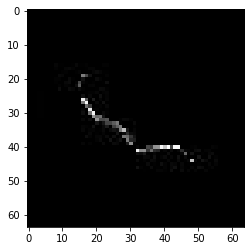

confidence for 5863 is 0.99997854


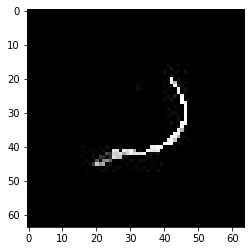

confidence for 5869 is 0.9990602


confidence for 5884 is 0.99999017


confidence for 5930 is 0.999971


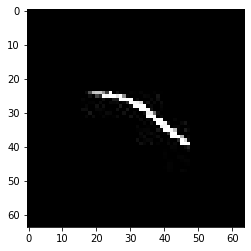

confidence for 5946 is 0.99960476


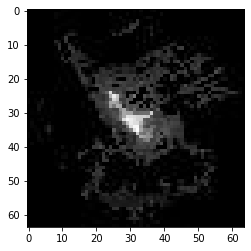

confidence for 5986 is 0.99939144


confidence for 6002 is 0.9998954


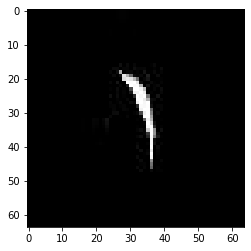

confidence for 6015 is 0.99998367


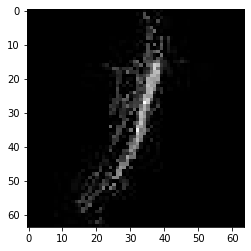

confidence for 6036 is 0.99999654


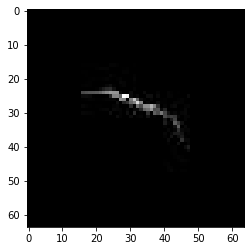

confidence for 6038 is 0.9999849


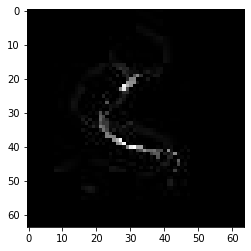

confidence for 6043 is 0.99999493


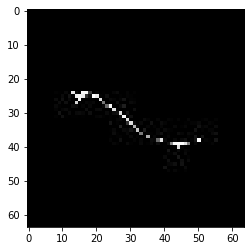

confidence for 6056 is 0.99998444


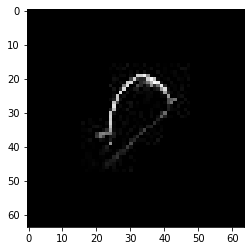

confidence for 6124 is 0.99982315


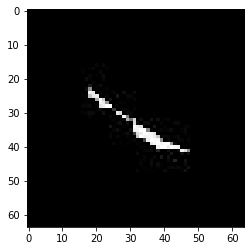

confidence for 6175 is 0.9999989


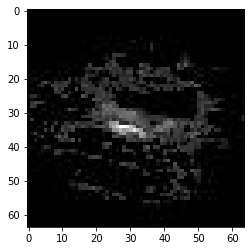

confidence for 6454 is 0.99999815


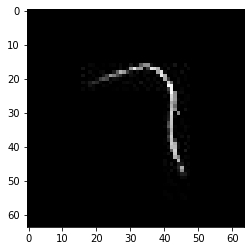

confidence for 6504 is 0.9994151


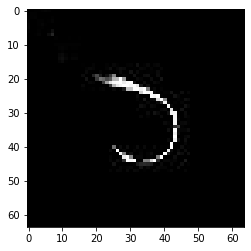

confidence for 6517 is 0.9991104


confidence for 6523 is 0.9999964


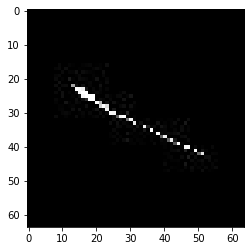

confidence for 6562 is 0.99960876


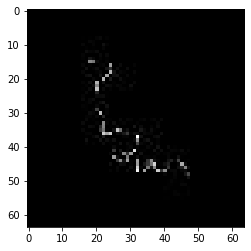

confidence for 6564 is 0.9991123


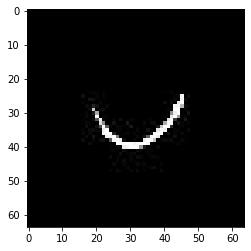

confidence for 6635 is 0.99998236


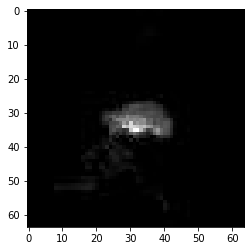

confidence for 6642 is 0.9999191


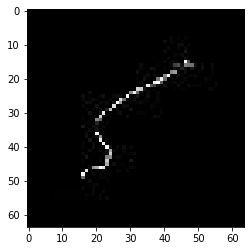

confidence for 6653 is 0.99999285


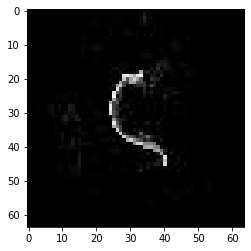

confidence for 6677 is 0.99999976


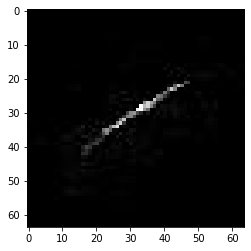

confidence for 6710 is 0.9999951


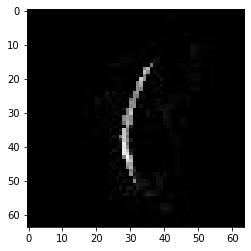

confidence for 6715 is 0.9999999


confidence for 6756 is 0.9999145


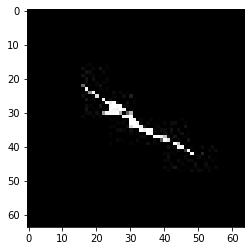

confidence for 6796 is 1.0


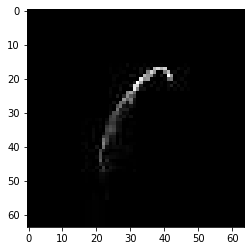

confidence for 6799 is 1.0


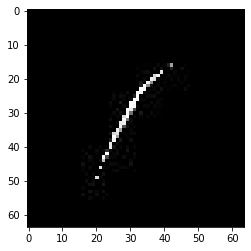

confidence for 6827 is 0.99999684


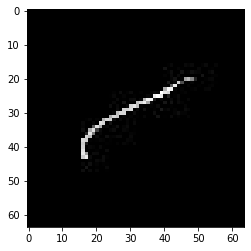

confidence for 6832 is 0.99999905


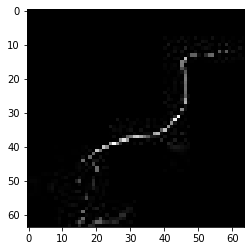

confidence for 6838 is 0.9997416


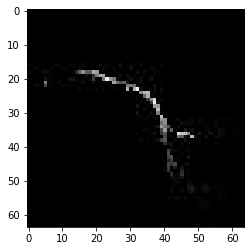

confidence for 6870 is 0.99960816


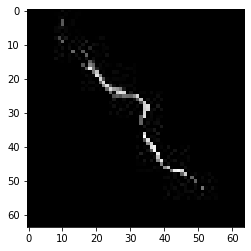

confidence for 6903 is 0.99962914


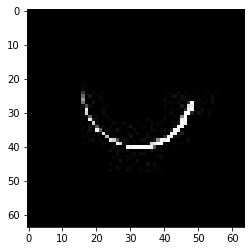

confidence for 6939 is 0.9999802


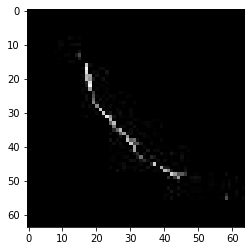

confidence for 6946 is 0.99998087


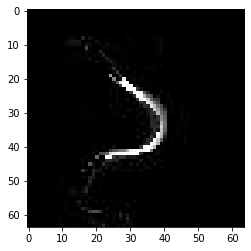

confidence for 7043 is 0.99998796


confidence for 7060 is 0.99932057


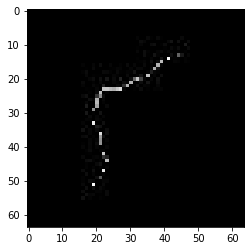

confidence for 7267 is 0.9993569


confidence for 7415 is 0.9999866


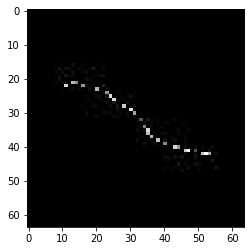

confidence for 7431 is 0.9998241


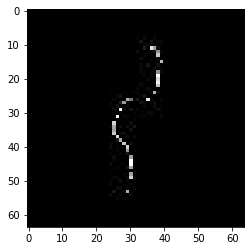

confidence for 7531 is 0.99979734


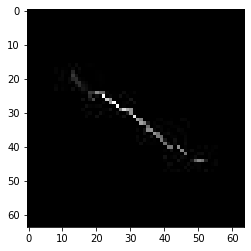

confidence for 7605 is 0.9992491


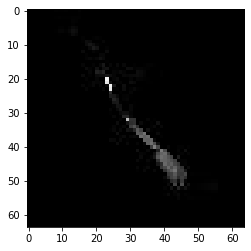

confidence for 7648 is 0.9990162


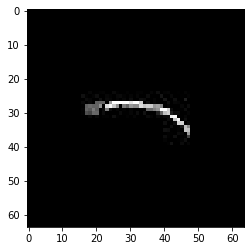

confidence for 7807 is 0.9999829


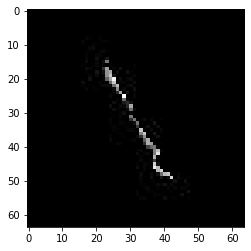

confidence for 7970 is 0.99975514


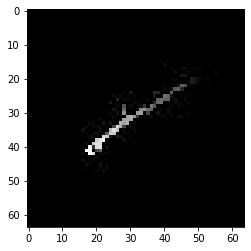

confidence for 8003 is 0.99976444


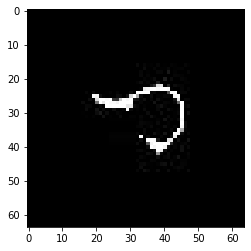

confidence for 8044 is 0.9993323


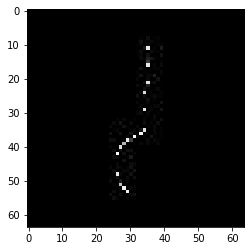

confidence for 8065 is 0.99996734


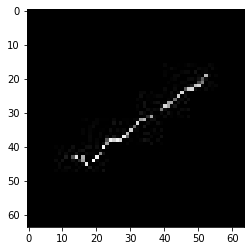

confidence for 8071 is 0.9999932


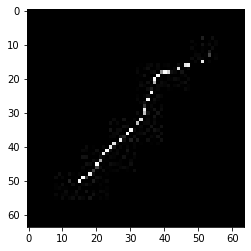

confidence for 8088 is 0.9999881


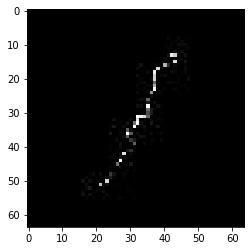

confidence for 8135 is 0.9999768


confidence for 8141 is 0.99982965


confidence for 8185 is 0.99978954


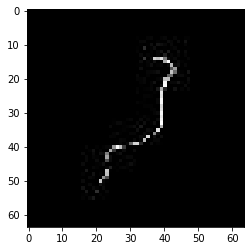

confidence for 8235 is 0.9999999


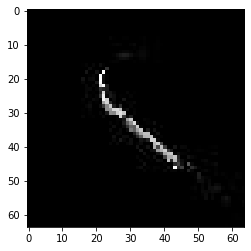

confidence for 8312 is 0.9997152


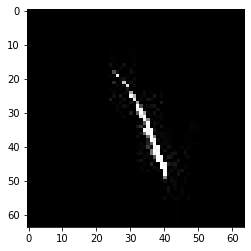

confidence for 8336 is 1.0


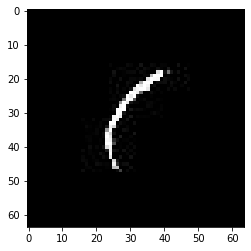

confidence for 8379 is 0.99950826


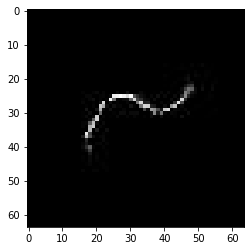

confidence for 8421 is 0.999617


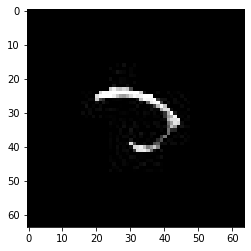

confidence for 8535 is 0.9998838


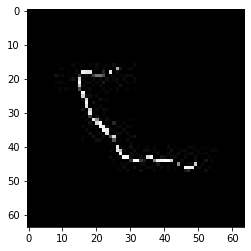

confidence for 8537 is 0.9999922


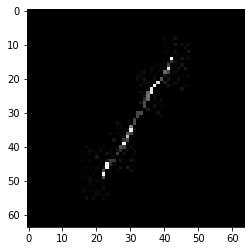

confidence for 8574 is 0.99996895


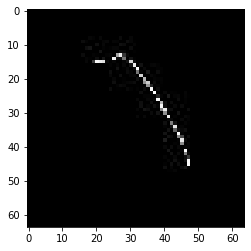

confidence for 8577 is 0.9999954


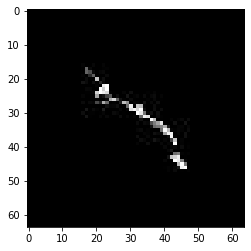

confidence for 8581 is 0.9996493


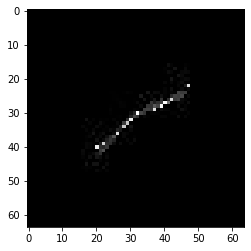

confidence for 8585 is 0.9999952


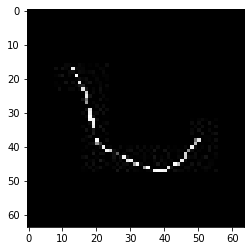

confidence for 8602 is 0.999159


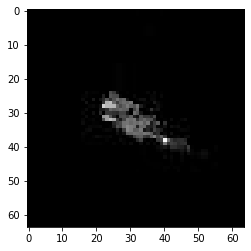

confidence for 8610 is 0.9990859


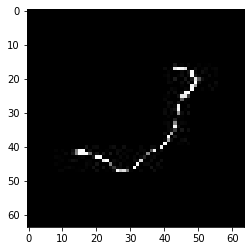

confidence for 8613 is 0.99955535


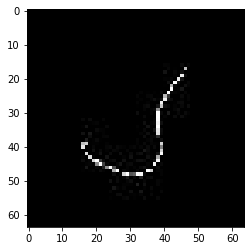

confidence for 8682 is 0.99999684


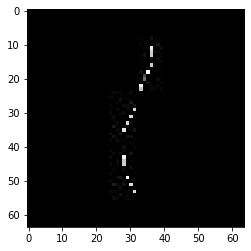

confidence for 8722 is 0.99999803


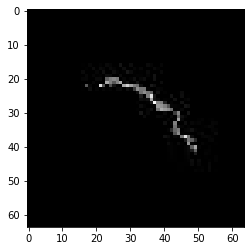

confidence for 8733 is 0.9993133


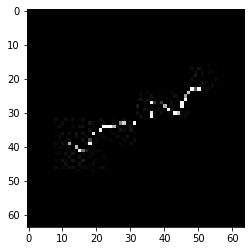

confidence for 8841 is 0.9999817


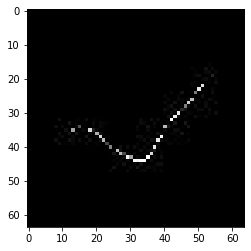

confidence for 8900 is 0.99990535


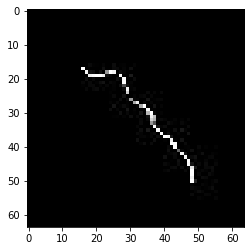

confidence for 9003 is 0.9999798


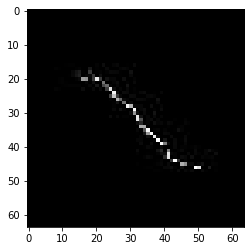

confidence for 9050 is 0.99968624


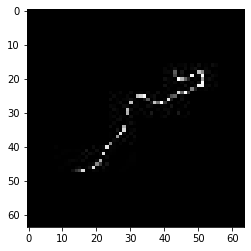

confidence for 9081 is 0.999997


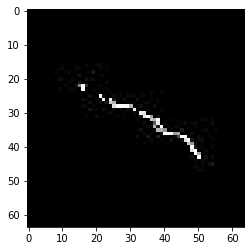

confidence for 9087 is 0.9999981


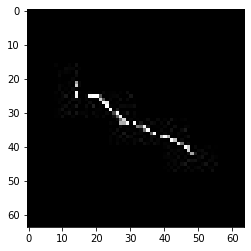

confidence for 9114 is 0.99999636


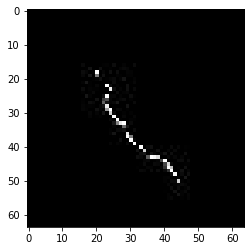

confidence for 9162 is 0.99953425


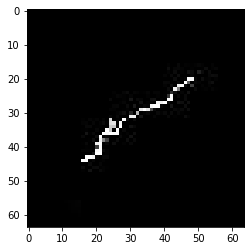

confidence for 9208 is 0.9999681


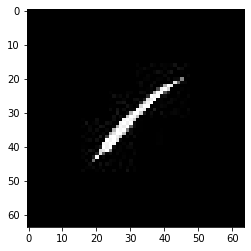

confidence for 9266 is 0.99999326


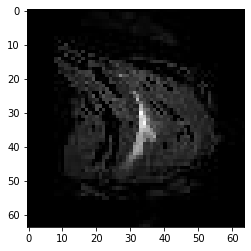

confidence for 9304 is 0.99959576


confidence for 9379 is 0.99988216


confidence for 9380 is 0.99999964


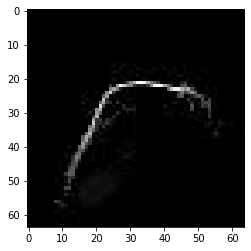

confidence for 9430 is 1.0


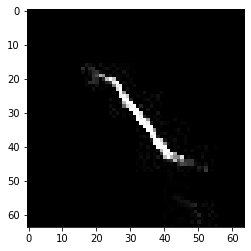

confidence for 9438 is 0.9998699


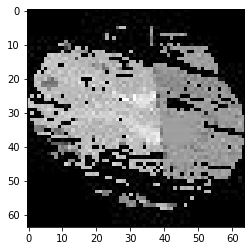

confidence for 9446 is 1.0


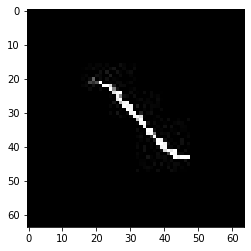

confidence for 9448 is 0.99971926


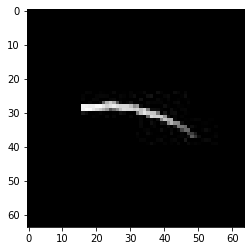

confidence for 9465 is 0.9999997


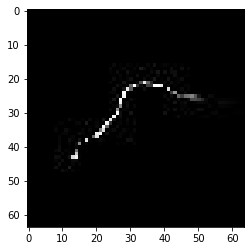

confidence for 9482 is 0.9999894


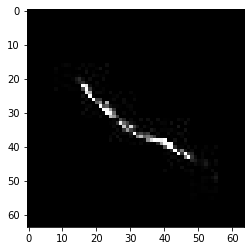

confidence for 9484 is 0.9994039


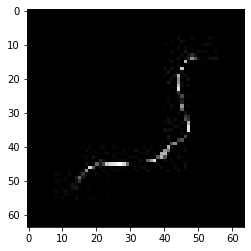

confidence for 9493 is 0.9996724


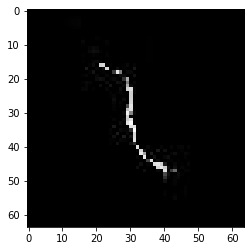

confidence for 9494 is 0.99999994


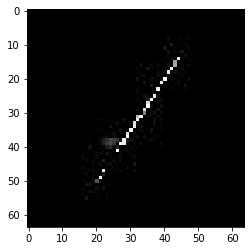

confidence for 9590 is 0.9998598


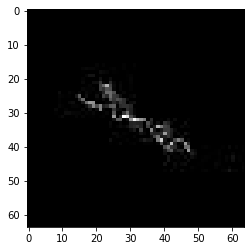

confidence for 9605 is 0.9999051


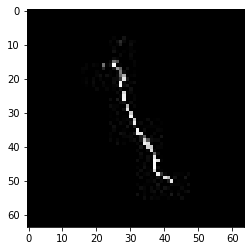

confidence for 9634 is 0.99994636


confidence for 9683 is 0.9992413


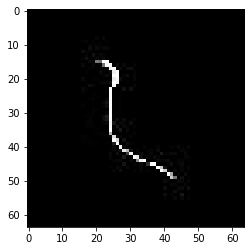

confidence for 9801 is 0.99999994


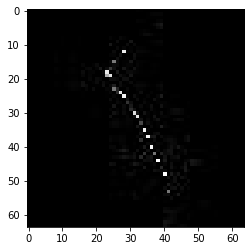

confidence for 9986 is 0.9999547


confidence for 10018 is 0.99996513


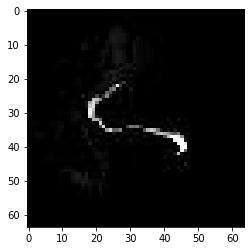

confidence for 10061 is 0.9999941


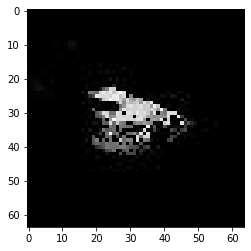

confidence for 10074 is 0.9999999


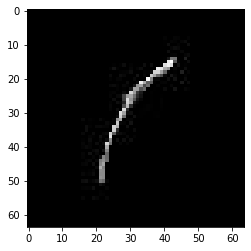

confidence for 10081 is 0.9999264


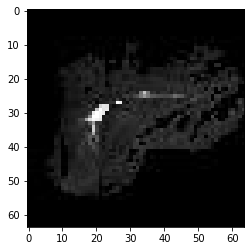

confidence for 10181 is 0.99999917


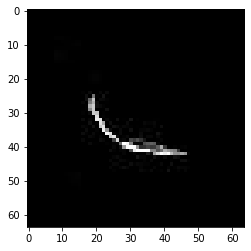

confidence for 10251 is 0.9997149


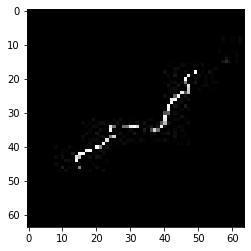

confidence for 10336 is 0.99999076


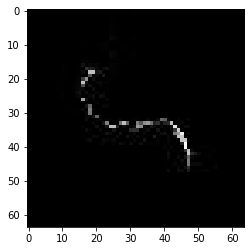

confidence for 10371 is 0.9998213


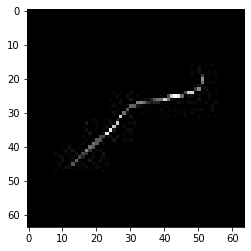

confidence for 10425 is 1.0


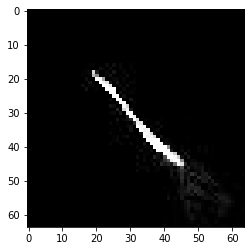

confidence for 10430 is 0.9999889


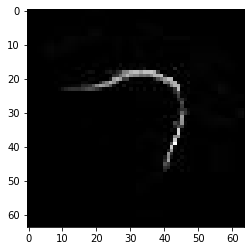

confidence for 10490 is 0.9998272


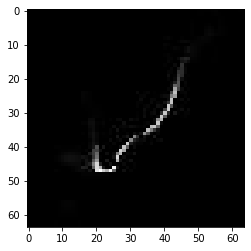

confidence for 10535 is 0.9992039


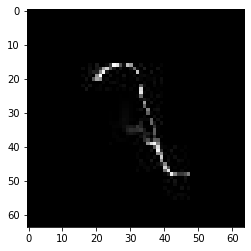

confidence for 10545 is 0.999863


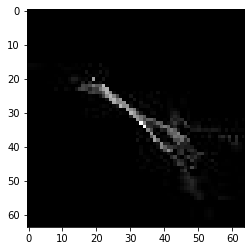

confidence for 10642 is 1.0


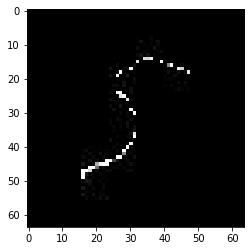

confidence for 10649 is 0.99998754


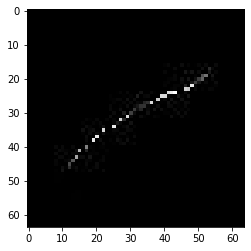

confidence for 10724 is 0.99925303


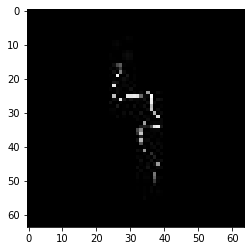

confidence for 10782 is 0.9999414


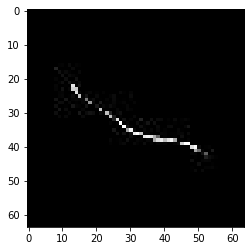

confidence for 10811 is 0.9999926


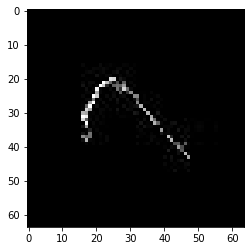

confidence for 10827 is 0.99998266


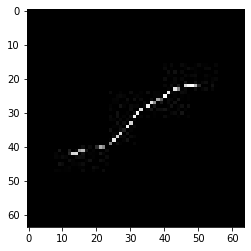

confidence for 10840 is 0.99999994


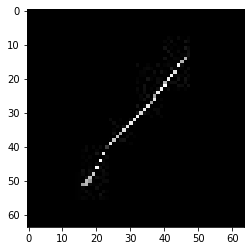

confidence for 10898 is 1.0


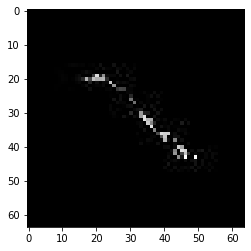

confidence for 10966 is 0.9999892


confidence for 10992 is 0.99976003


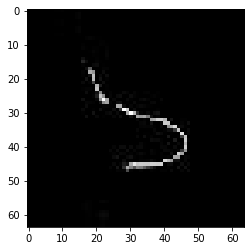

confidence for 11013 is 0.9991796


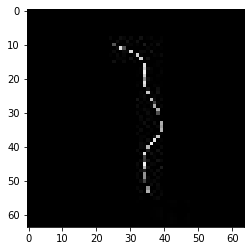

confidence for 11065 is 0.99994797


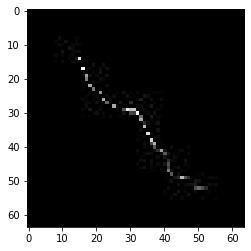

confidence for 11096 is 0.9995418


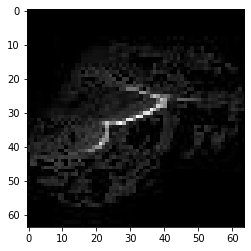

confidence for 11103 is 0.9999997


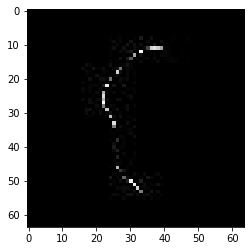

confidence for 11162 is 0.99991584


confidence for 11169 is 0.9999997


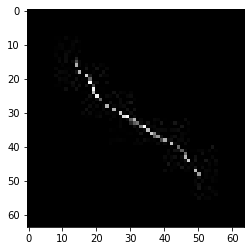

confidence for 11192 is 0.99998575


confidence for 11339 is 0.99999875


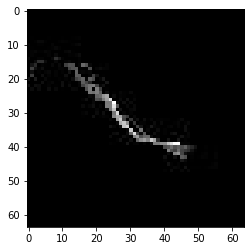

confidence for 11374 is 0.99998456


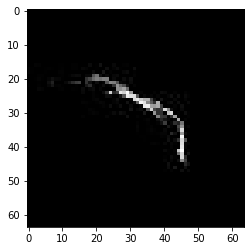

confidence for 11467 is 0.99992996


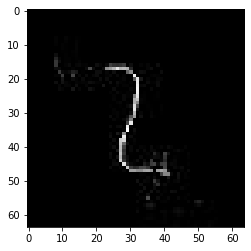

confidence for 11522 is 1.0


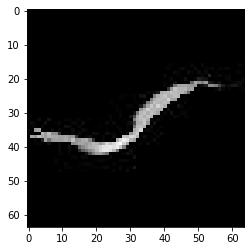

confidence for 11541 is 0.9999983


confidence for 11542 is 0.999996


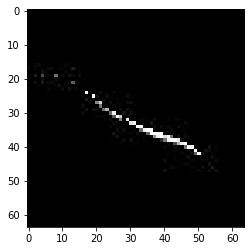

confidence for 11599 is 0.9999897


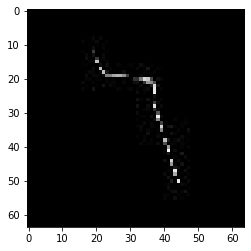

confidence for 11637 is 0.9999677


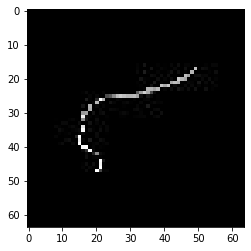

confidence for 11675 is 0.999883


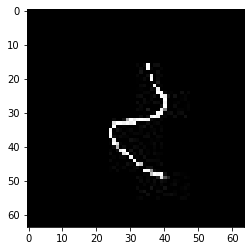

confidence for 11715 is 0.99999774


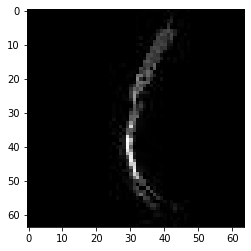

confidence for 11752 is 0.99999994


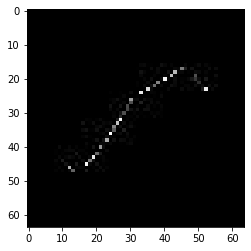

confidence for 11774 is 0.9999826


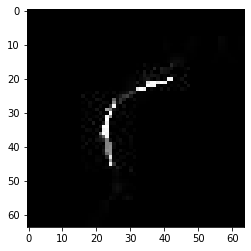

confidence for 11823 is 0.99972653


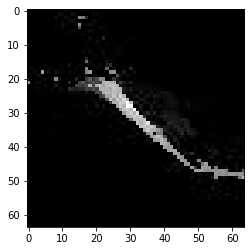

confidence for 11948 is 1.0


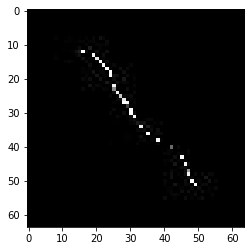

confidence for 11975 is 0.9998649


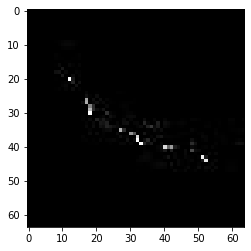

confidence for 12021 is 0.9998026


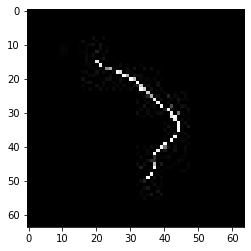

confidence for 12036 is 0.9999569


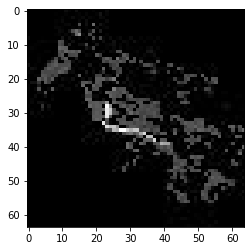

confidence for 12041 is 0.9999209


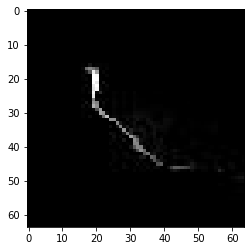

confidence for 12053 is 0.9999993


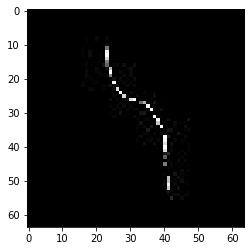

confidence for 12092 is 0.999997


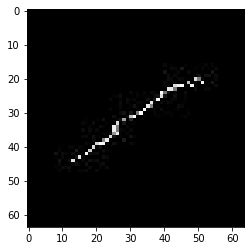

confidence for 12101 is 1.0


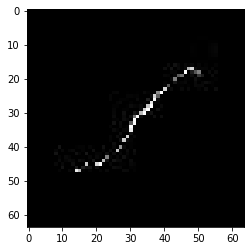

confidence for 12117 is 0.99997103


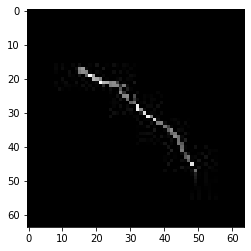

confidence for 12130 is 0.9999436


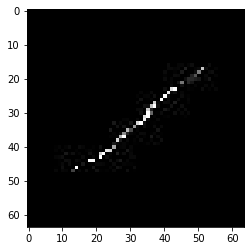

confidence for 12133 is 0.9999759


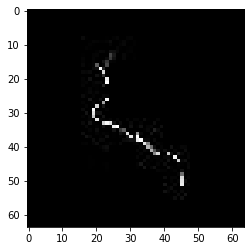

confidence for 12139 is 0.9996686


confidence for 12165 is 1.0


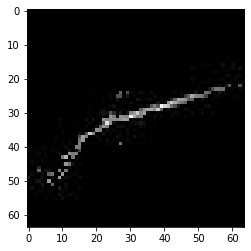

confidence for 12194 is 0.9999432


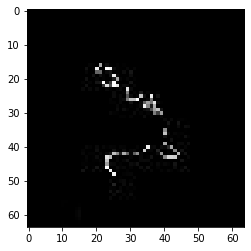

confidence for 12204 is 0.99999934


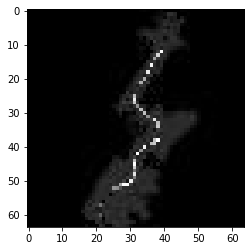

confidence for 12226 is 1.0


confidence for 12229 is 0.999999


confidence for 12234 is 0.99997157


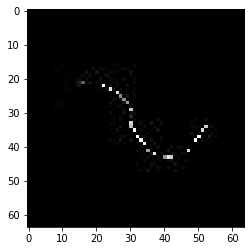

confidence for 12237 is 0.999549


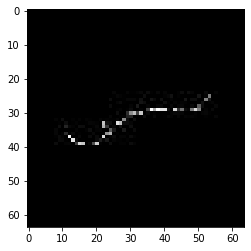

confidence for 12245 is 0.9999952


confidence for 12256 is 0.999198


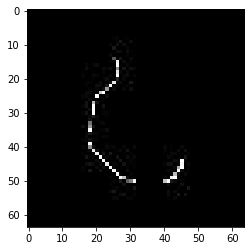

confidence for 12258 is 0.99903464


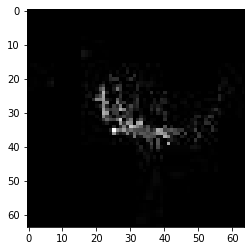

confidence for 12295 is 0.99999726


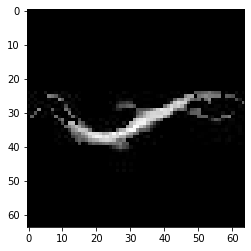

confidence for 12336 is 0.9992175


confidence for 12346 is 0.999969


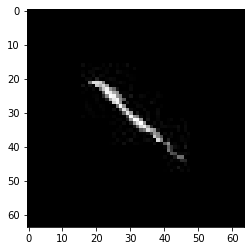

confidence for 12387 is 0.99949294


confidence for 12424 is 0.99997085


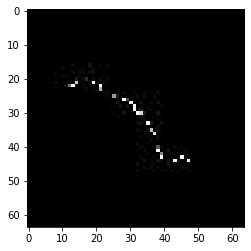

confidence for 12427 is 0.99998033


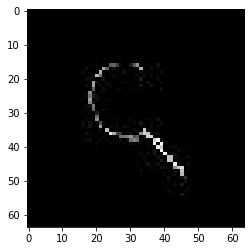

confidence for 12449 is 0.9999997


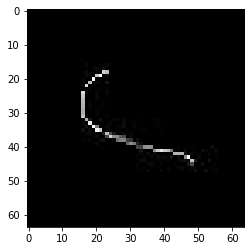

confidence for 12519 is 0.9999981


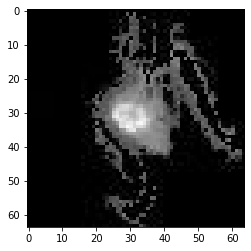

confidence for 12522 is 0.99970615


confidence for 12595 is 0.99999994


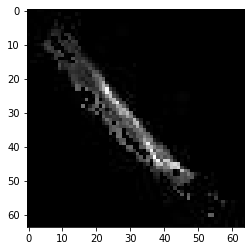

confidence for 12772 is 0.99935204


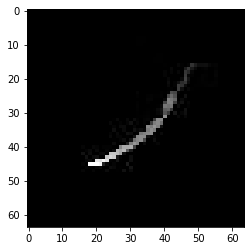

confidence for 12797 is 0.99991304


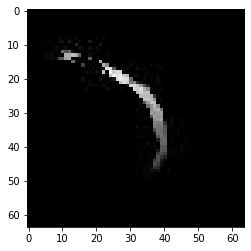

confidence for 12812 is 0.999983


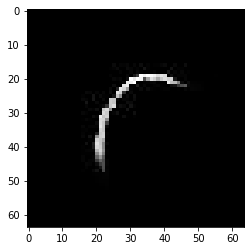

confidence for 12815 is 0.99995255


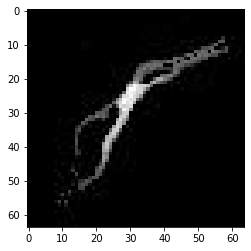

confidence for 12852 is 0.99999434


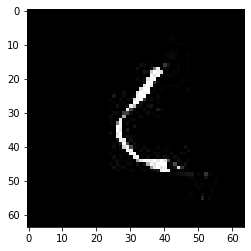

confidence for 12879 is 0.9999895


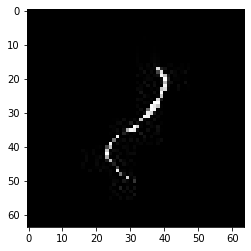

confidence for 12881 is 0.99999243


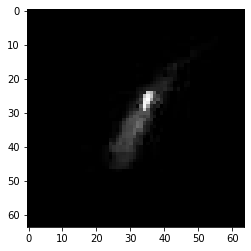

confidence for 12974 is 0.99999005


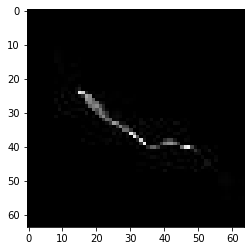

confidence for 12994 is 1.0


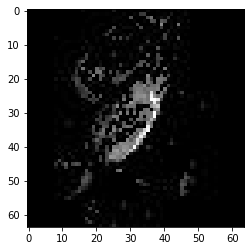

confidence for 13006 is 0.9998396


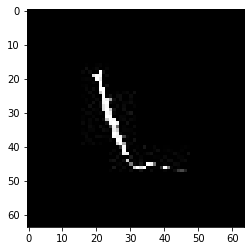

confidence for 13008 is 0.9998147


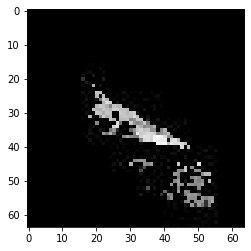

confidence for 13036 is 0.99902207


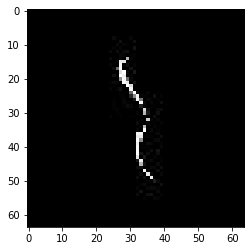

confidence for 13058 is 0.9998157


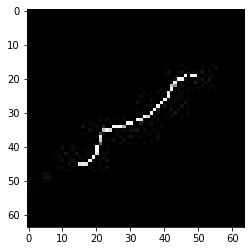

confidence for 13124 is 0.9998075


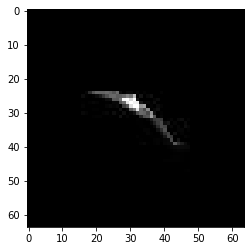

confidence for 13127 is 0.9995412


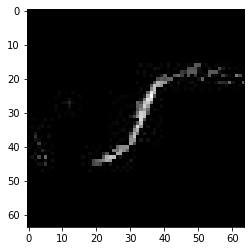

confidence for 13169 is 0.9998136


confidence for 13194 is 0.99988574


confidence for 13207 is 0.9994783


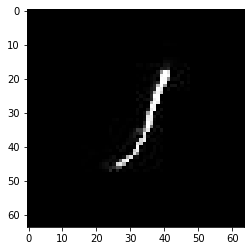

confidence for 13211 is 0.99999946


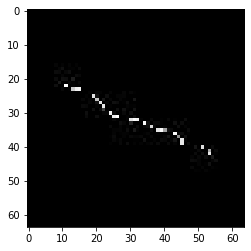

confidence for 13228 is 0.9999956


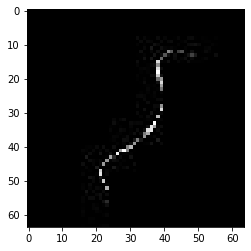

confidence for 13244 is 0.9997539


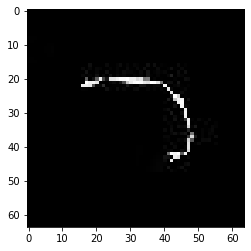

confidence for 13247 is 0.99997365


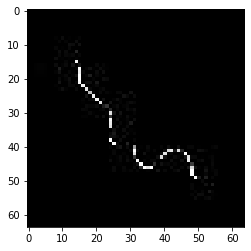

confidence for 13313 is 0.99949837


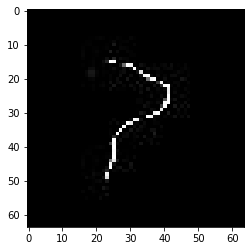

confidence for 13334 is 0.99989676


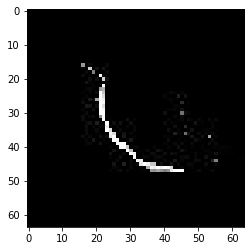

confidence for 13380 is 0.99999917


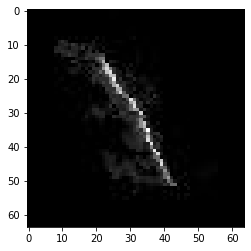

confidence for 13384 is 1.0


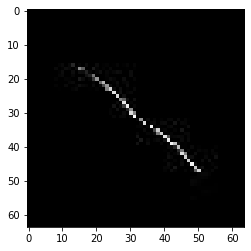

confidence for 13433 is 0.99999994


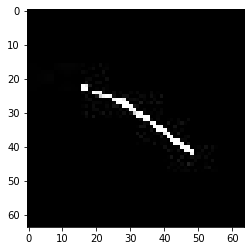

confidence for 13446 is 0.9999996


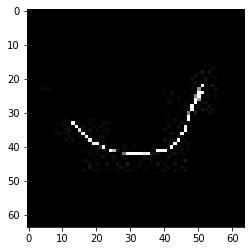

confidence for 13456 is 0.9999772


confidence for 13503 is 0.9996202


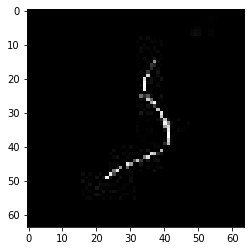

confidence for 13541 is 0.9999928


confidence for 13545 is 0.9995797


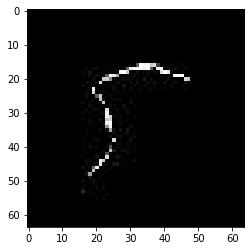

confidence for 13554 is 1.0


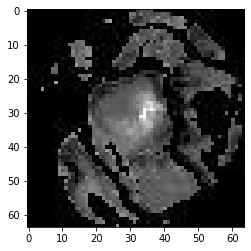

confidence for 13627 is 0.99971956


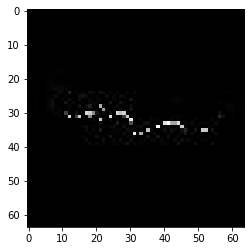

confidence for 13642 is 0.99927723


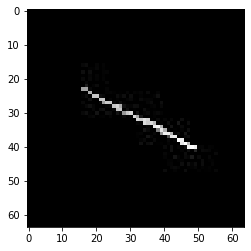

confidence for 13685 is 0.99987787


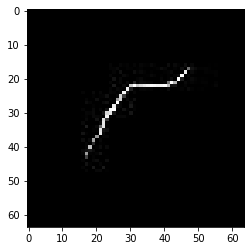

confidence for 13772 is 0.9999592


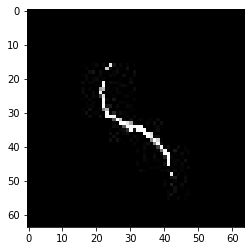

confidence for 13804 is 0.99976915


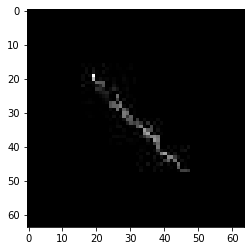

confidence for 13838 is 0.99992126


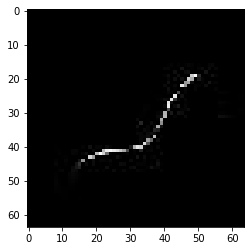

confidence for 13855 is 0.9992887


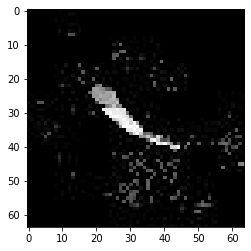

confidence for 13874 is 0.9990517


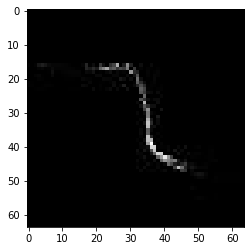

confidence for 13895 is 0.99994123


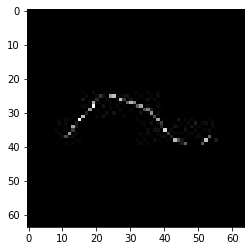

confidence for 13954 is 0.9998506


confidence for 13957 is 1.0


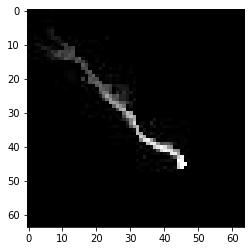

confidence for 13985 is 0.99993813


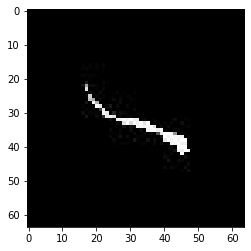

confidence for 14023 is 0.9997797


confidence for 14064 is 0.9997322


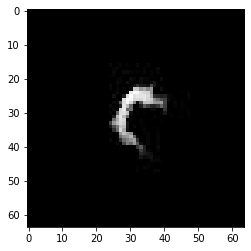

confidence for 14092 is 0.9994813


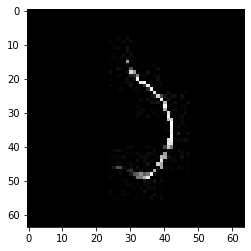

confidence for 14172 is 0.9999601


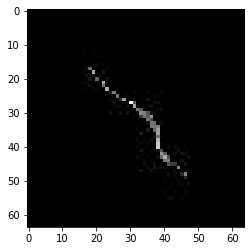

confidence for 14201 is 0.99989873


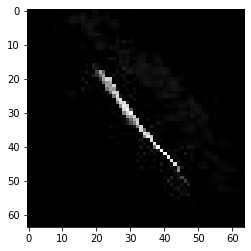

confidence for 14207 is 0.9991263


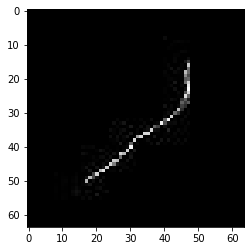

confidence for 14237 is 0.9998271


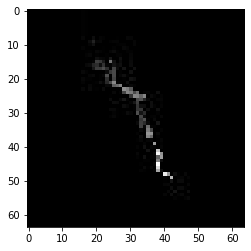

confidence for 14280 is 0.99961597


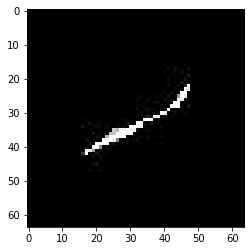

confidence for 14312 is 0.9999886


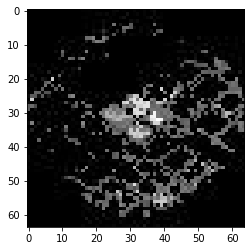

confidence for 14385 is 0.9996633


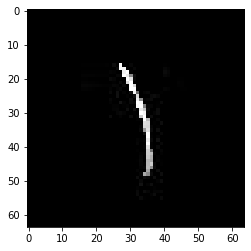

confidence for 14426 is 0.9991474


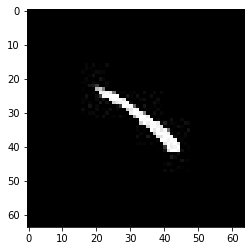

confidence for 14439 is 0.99999964


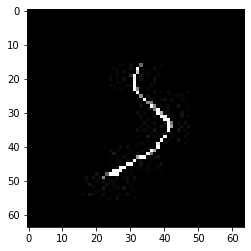

confidence for 14460 is 0.99998355


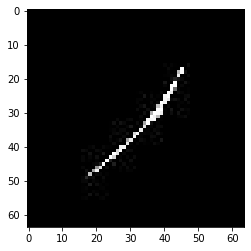

confidence for 14470 is 0.99990964


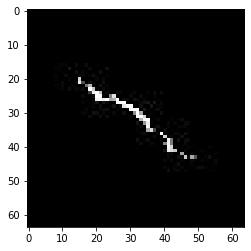

confidence for 14500 is 0.9999977


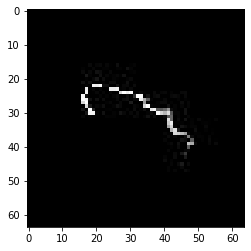

confidence for 14517 is 0.99960095


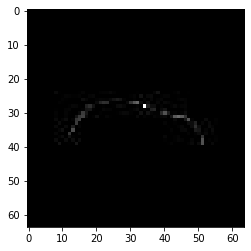

confidence for 14519 is 0.9994115


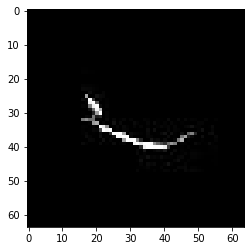

confidence for 14542 is 0.99993795


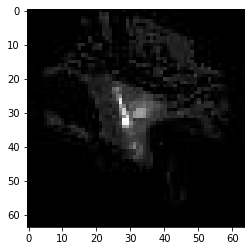

confidence for 14545 is 0.9991436


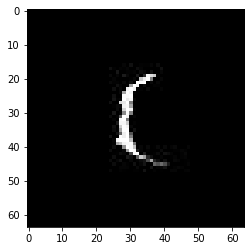

confidence for 14607 is 0.9996252


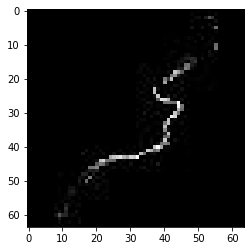

confidence for 14654 is 0.9999993


confidence for 14674 is 0.9993692


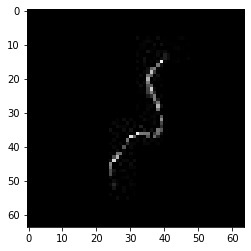

confidence for 14680 is 0.999988


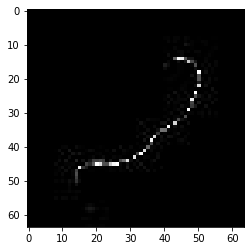

confidence for 14709 is 0.99998844


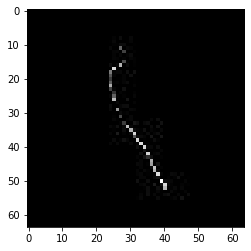

confidence for 14728 is 0.9995448


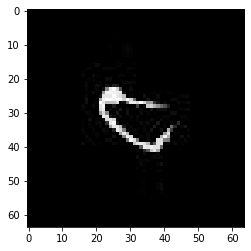

confidence for 14734 is 0.9999483


confidence for 14790 is 0.9999884


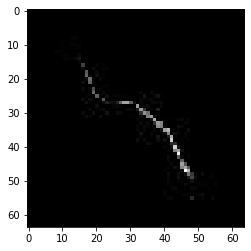

confidence for 14799 is 0.99983823


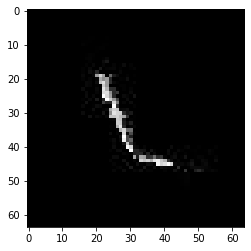

confidence for 14816 is 0.99941087


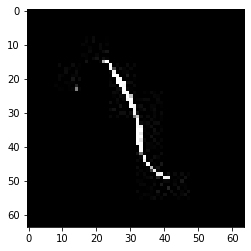

confidence for 14834 is 0.9999072


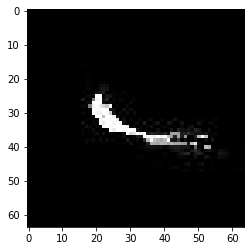

confidence for 14859 is 0.99981


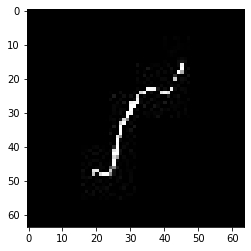

confidence for 14908 is 0.9994999


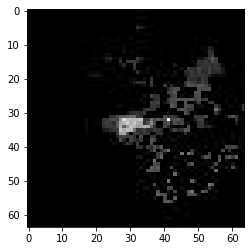

confidence for 14921 is 0.99999875


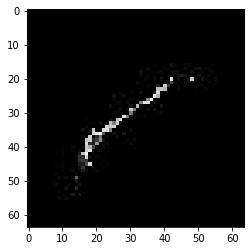

confidence for 14922 is 0.9999575


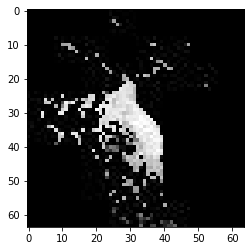

confidence for 14935 is 0.99981403


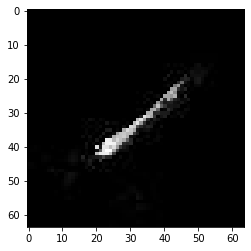

confidence for 14963 is 1.0


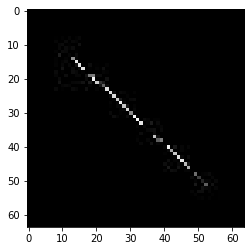

confidence for 14965 is 0.9996134


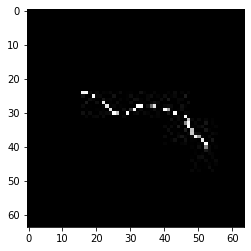

confidence for 14981 is 0.9997379


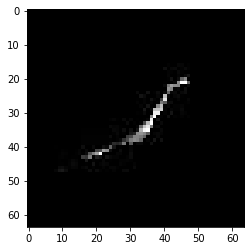

confidence for 14997 is 0.99998516


confidence for 14999 is 0.9999824


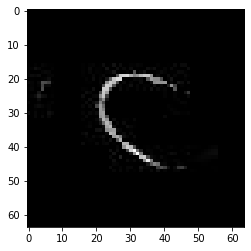

confidence for 15004 is 0.9999985


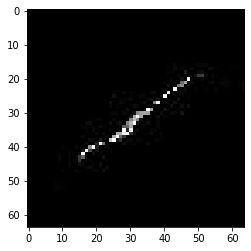

confidence for 15014 is 0.99999934


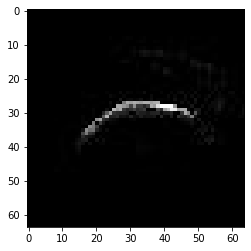

confidence for 15018 is 0.99986285


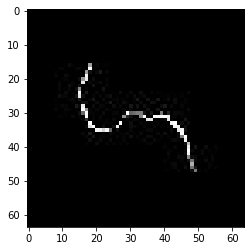

confidence for 15042 is 0.9999823


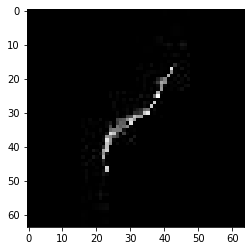

confidence for 15053 is 0.99991226


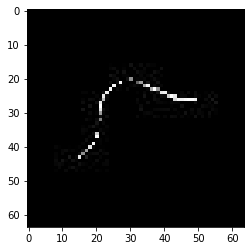

confidence for 15087 is 0.999997


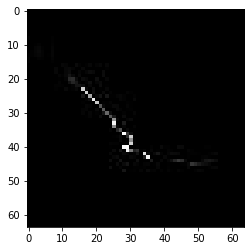

confidence for 15096 is 0.99983376


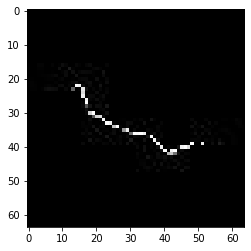

confidence for 15104 is 0.99993783


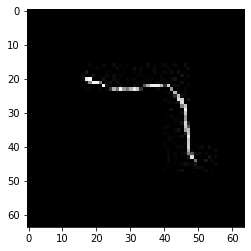

confidence for 15112 is 0.9995074


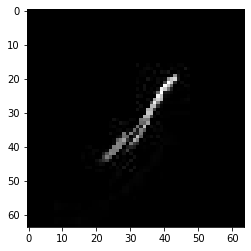

confidence for 15119 is 0.9996817


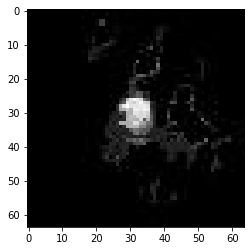

confidence for 15124 is 0.9999848


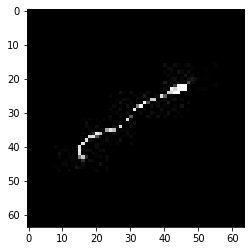

confidence for 15130 is 0.9997863


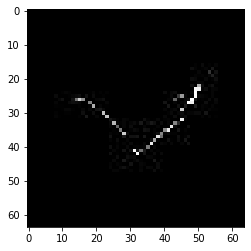

confidence for 15134 is 0.99994653


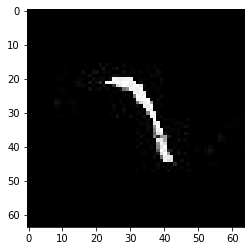

confidence for 15135 is 0.999417


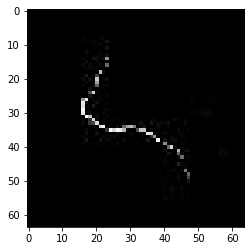

confidence for 15164 is 0.9997613


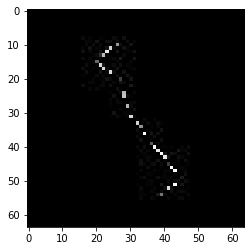

confidence for 15176 is 0.9999991


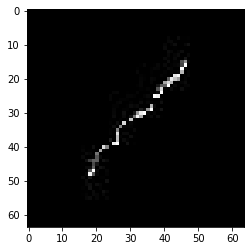

confidence for 15185 is 0.9998286


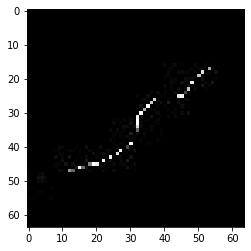

confidence for 15221 is 1.0


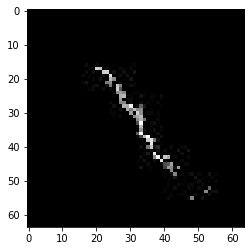

confidence for 15222 is 0.99981844


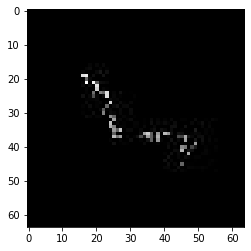

confidence for 15252 is 0.999668


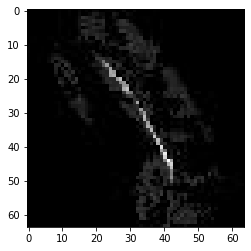

confidence for 15284 is 0.99999994


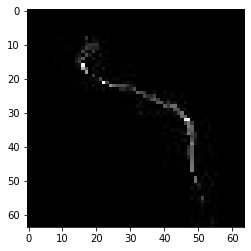

confidence for 15291 is 0.99999934


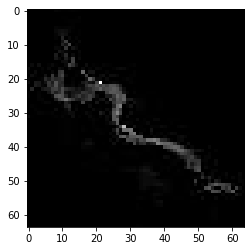

confidence for 15302 is 0.99999595


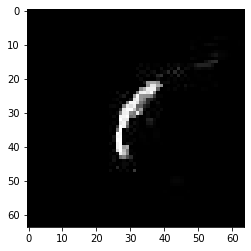

confidence for 15304 is 0.99987376


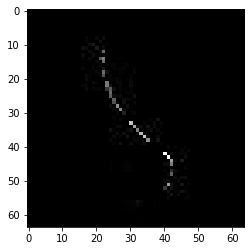

confidence for 15320 is 1.0


confidence for 15355 is 0.9993752


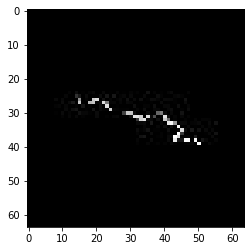

confidence for 15384 is 0.9996711


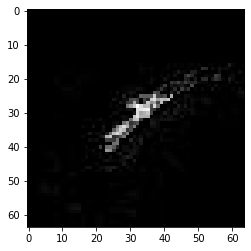

confidence for 15394 is 0.99999803


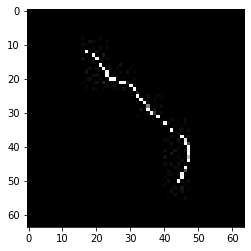

confidence for 15418 is 0.9999888


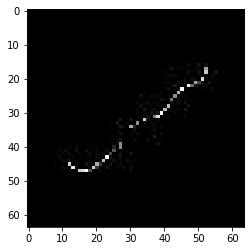

confidence for 15457 is 0.99999994


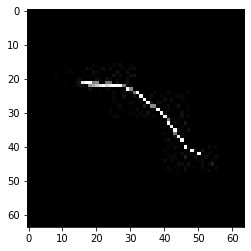

confidence for 15463 is 0.9997951


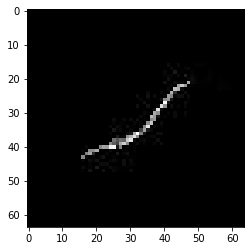

confidence for 15464 is 0.9999191


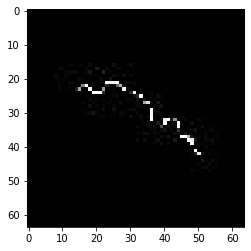

confidence for 15483 is 0.99973035


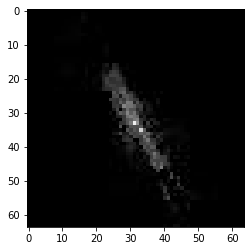

confidence for 15509 is 0.9999189


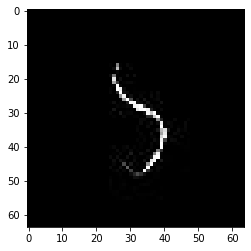

confidence for 15550 is 0.99909663


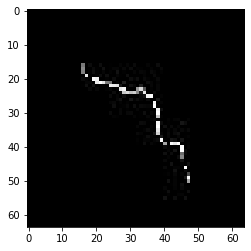

confidence for 15571 is 0.9999419


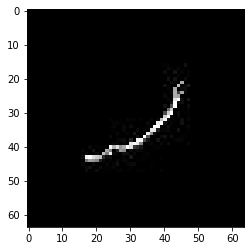

confidence for 15591 is 0.99929094


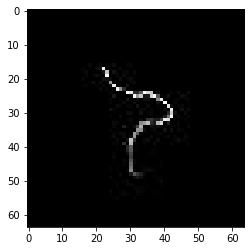

confidence for 15598 is 0.99998075


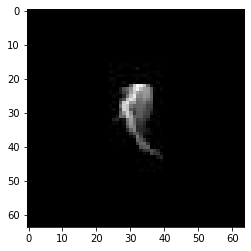

confidence for 15608 is 0.99999976


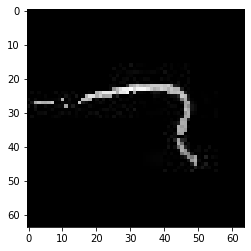

confidence for 15610 is 0.9999272


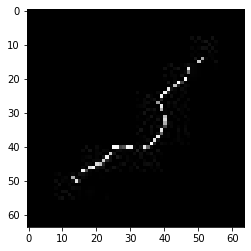

confidence for 15619 is 0.99999887


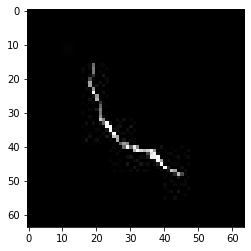

confidence for 15629 is 0.99964136


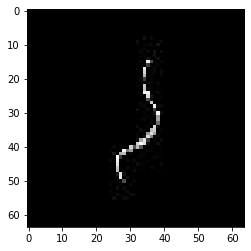

confidence for 15636 is 0.9994069


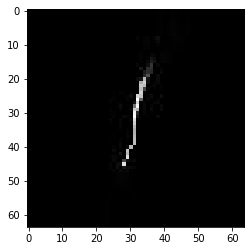

confidence for 15646 is 0.99999964


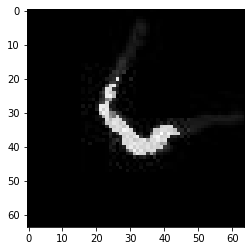

confidence for 15648 is 0.99949545


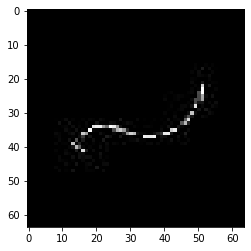

confidence for 15650 is 0.9999721


confidence for 15657 is 0.9999178


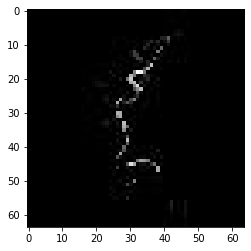

confidence for 15672 is 0.999909


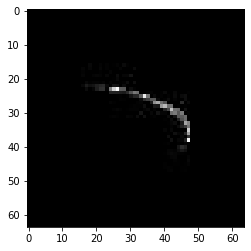

confidence for 15698 is 0.99993527


confidence for 15701 is 0.9999821


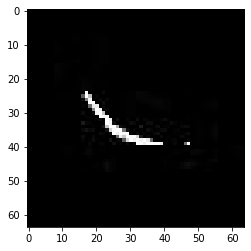

confidence for 15709 is 0.99989563


confidence for 15723 is 0.99999136


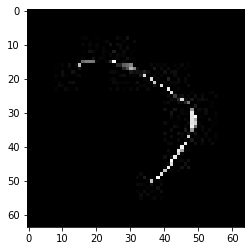

confidence for 15727 is 0.99995786


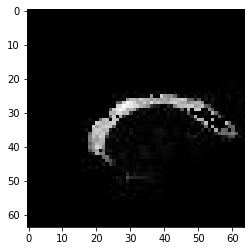

confidence for 15734 is 0.999506


confidence for 15740 is 0.9999952


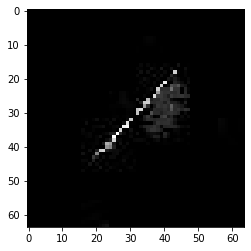

confidence for 15742 is 0.99905896


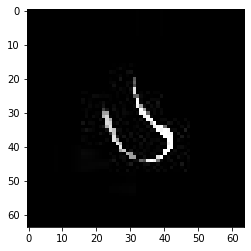

confidence for 15745 is 0.9999726


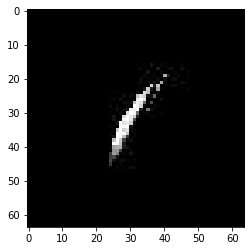

confidence for 15752 is 0.9999989


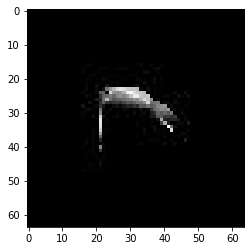

confidence for 15760 is 0.99998116


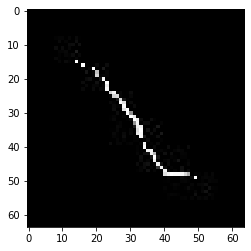

confidence for 15772 is 0.99999934


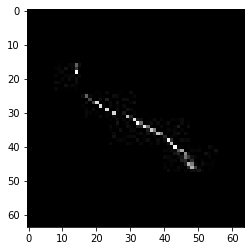

confidence for 15789 is 0.99999326


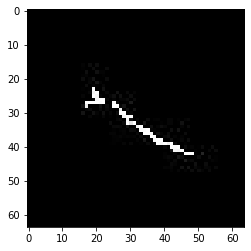

confidence for 15802 is 0.99999875


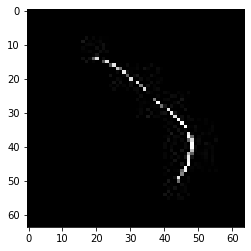

confidence for 15829 is 0.99967617


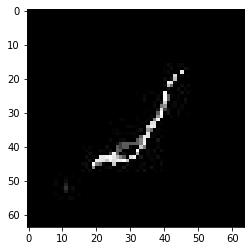

confidence for 15833 is 1.0


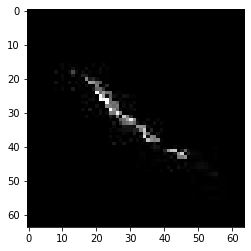

confidence for 15868 is 0.999998


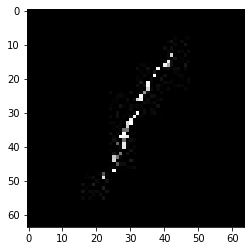

confidence for 15885 is 0.9999507


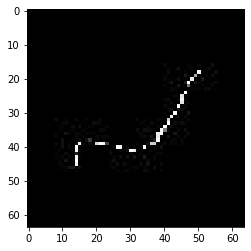

confidence for 15896 is 1.0


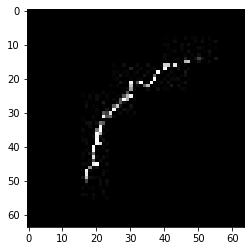

confidence for 15901 is 1.0


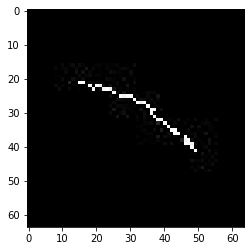

confidence for 15912 is 0.9999939


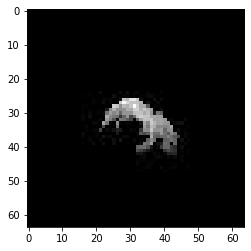

confidence for 15952 is 0.9999744


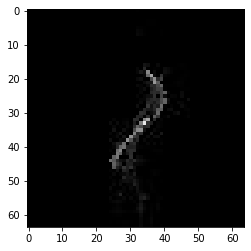

confidence for 15967 is 0.9998426


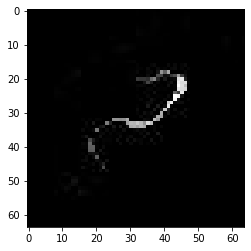

confidence for 15970 is 0.99950653


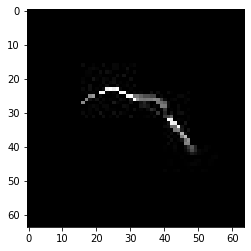

confidence for 15984 is 0.99998325


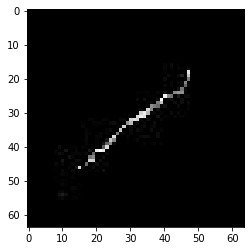

confidence for 16017 is 0.9994129


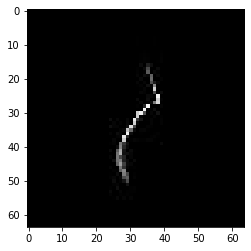

confidence for 16042 is 0.9996116


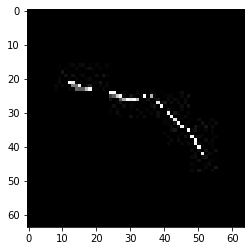

confidence for 16052 is 0.9999072


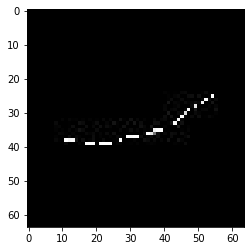

confidence for 16060 is 1.0


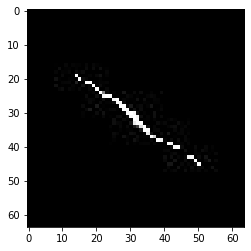

confidence for 16061 is 0.9999933


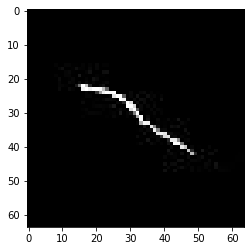

confidence for 16084 is 0.9999609


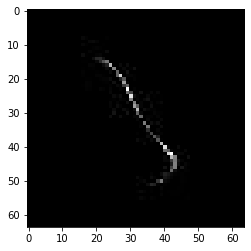

confidence for 16120 is 0.99999326


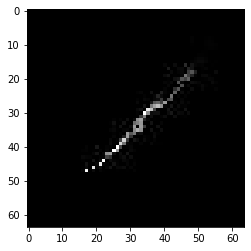

confidence for 16125 is 0.9998552


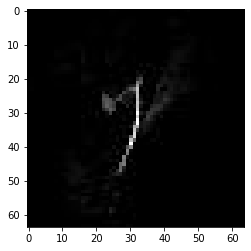

confidence for 16174 is 0.9999914


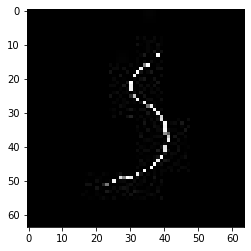

confidence for 16211 is 0.99998194


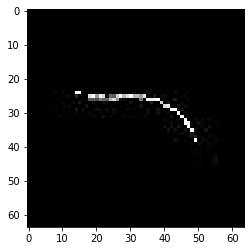

confidence for 16212 is 0.99994534


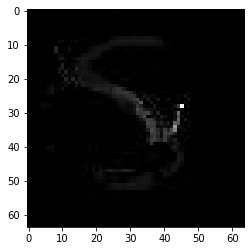

confidence for 16235 is 0.99991614


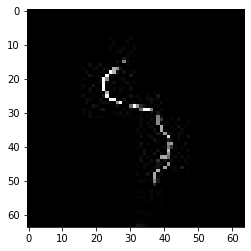

confidence for 16249 is 0.99959


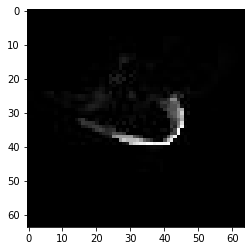

confidence for 16261 is 0.99992543


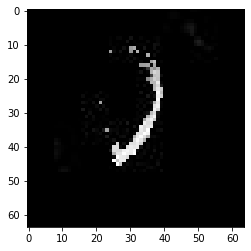

confidence for 16303 is 0.99965626


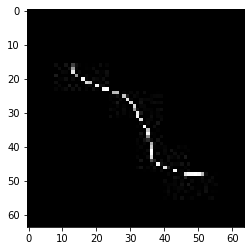

confidence for 16362 is 0.99993193


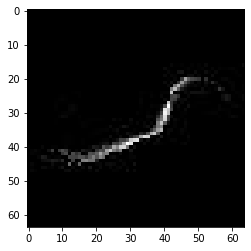

confidence for 16409 is 0.99973136


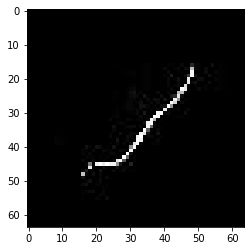

confidence for 16412 is 0.9999929


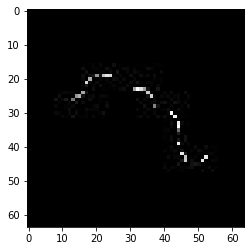

confidence for 16499 is 0.9999726


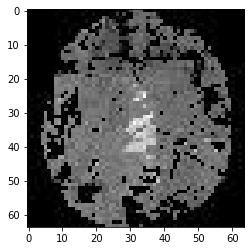

confidence for 16593 is 0.9999756


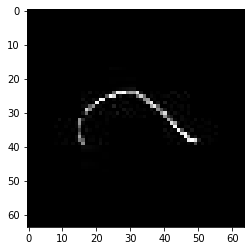

confidence for 16613 is 0.99993694


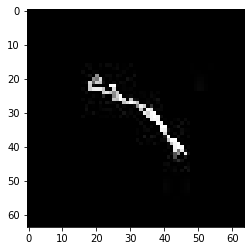

confidence for 16704 is 0.99999386


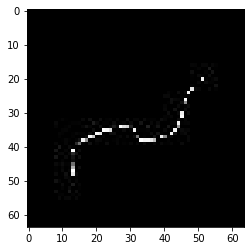

confidence for 16705 is 0.9999992


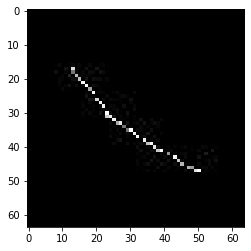

confidence for 16714 is 0.9999979


confidence for 16715 is 0.9998112


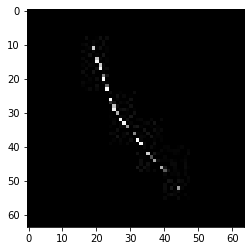

confidence for 16729 is 0.99932295


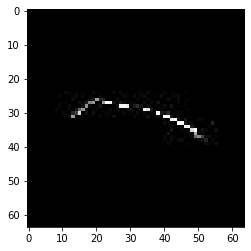

confidence for 16746 is 0.9999998


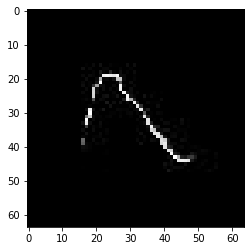

confidence for 16764 is 0.99999994


confidence for 16794 is 1.0


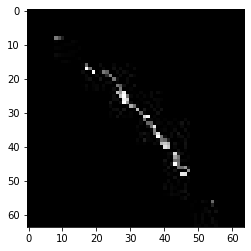

confidence for 16877 is 0.9998443


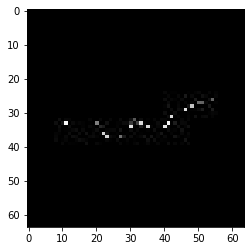

confidence for 16908 is 0.9997579


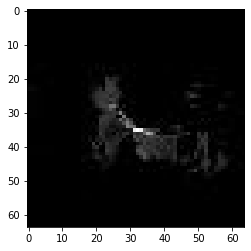

confidence for 16924 is 0.9996738


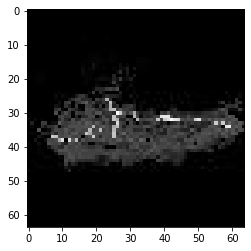

confidence for 16943 is 0.9998043


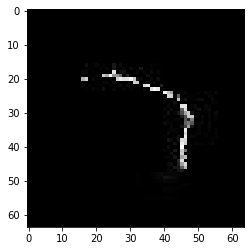

confidence for 16948 is 0.99993753


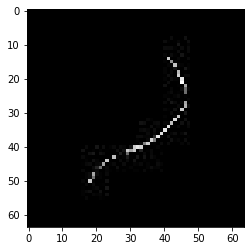

confidence for 17002 is 0.99994296


confidence for 17051 is 0.9999183


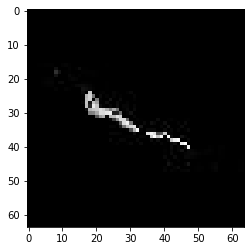

confidence for 17056 is 0.9999955


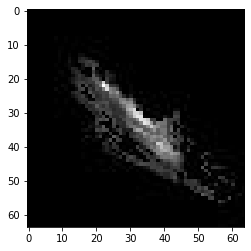

confidence for 17061 is 0.99958265


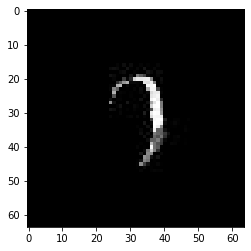

confidence for 17063 is 0.99999774


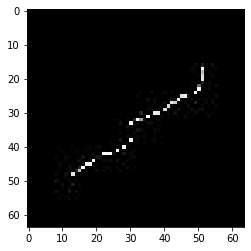

confidence for 17097 is 0.9999998


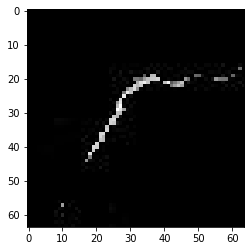

confidence for 17104 is 0.9999998


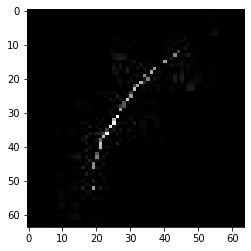

confidence for 17119 is 0.9999994


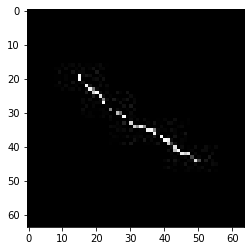

confidence for 17127 is 0.9999927


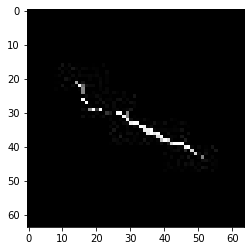

confidence for 17159 is 0.999999


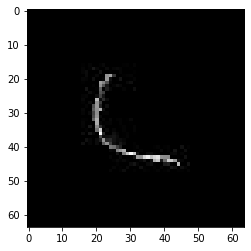

confidence for 17177 is 0.9999387


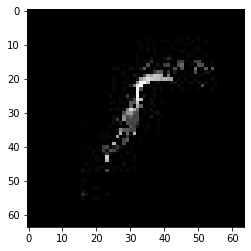

confidence for 17303 is 0.99988985


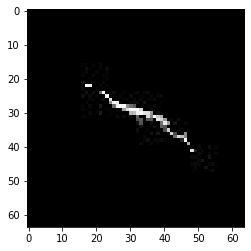

confidence for 17311 is 0.9997647


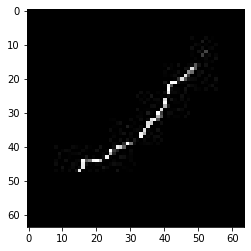

confidence for 17342 is 0.99957705


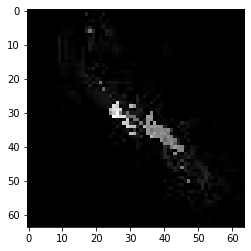

confidence for 17345 is 0.9996668


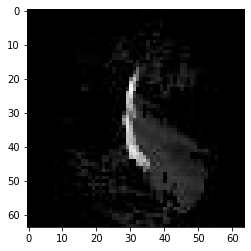

confidence for 17377 is 0.99999684


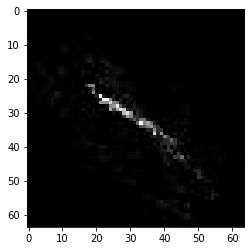

confidence for 17380 is 0.99968314


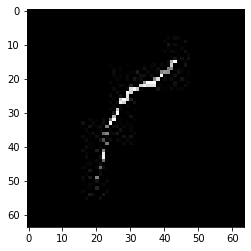

confidence for 17385 is 0.9997646


confidence for 17406 is 0.9999993


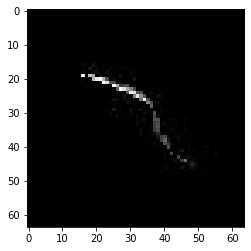

confidence for 17412 is 0.9995953


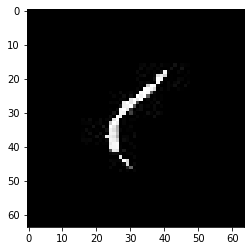

confidence for 17414 is 1.0


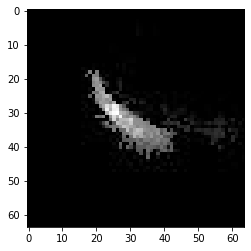

confidence for 17422 is 0.9999997


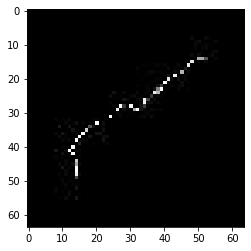

confidence for 17442 is 0.9999974


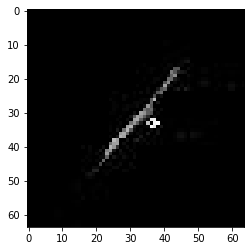

confidence for 17457 is 0.9999972


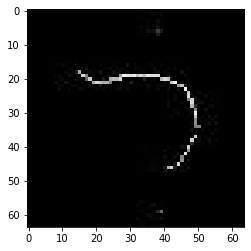

confidence for 17471 is 0.99987715


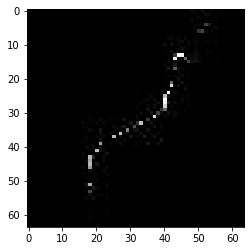

confidence for 17484 is 0.99999833


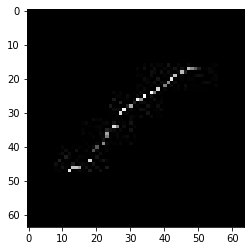

confidence for 17486 is 0.9998635


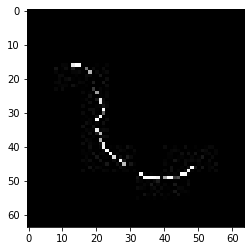

confidence for 17496 is 0.9991898


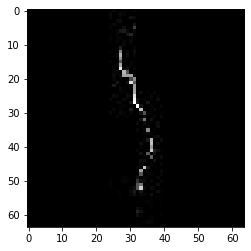

confidence for 17525 is 0.999974


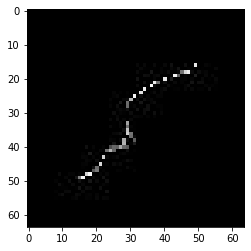

confidence for 17536 is 0.99997306


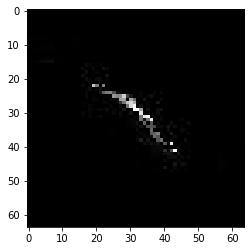

confidence for 17537 is 0.99999535


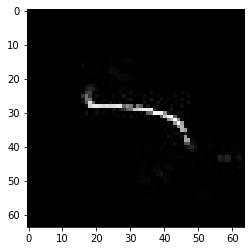

confidence for 17538 is 0.9998267


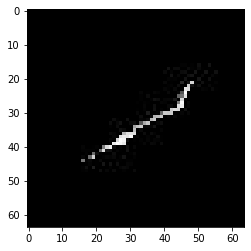

confidence for 17558 is 0.9994908


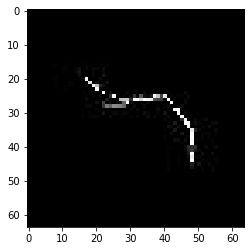

confidence for 17564 is 0.99953663


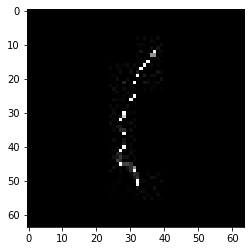

confidence for 17582 is 0.9999563


confidence for 17598 is 0.9998666


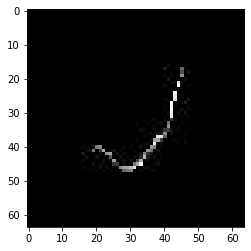

confidence for 17651 is 0.9998436


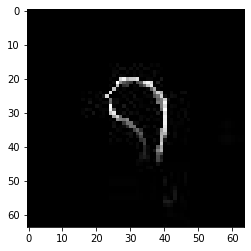

confidence for 17676 is 0.9999991


confidence for 17682 is 0.99999624


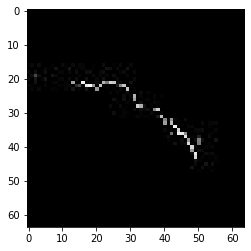

confidence for 17699 is 0.99929005


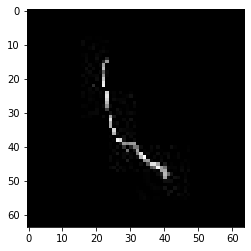

confidence for 17704 is 0.99974036


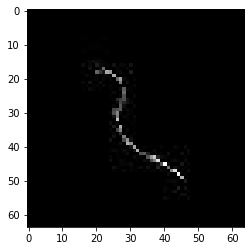

confidence for 17721 is 0.9999999


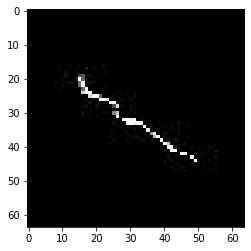

confidence for 17765 is 0.9999923


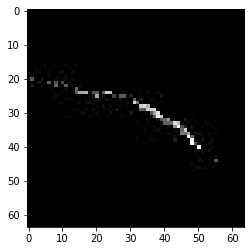

confidence for 17847 is 1.0


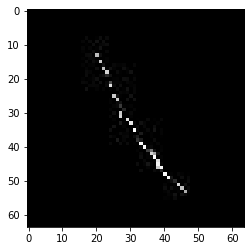

confidence for 17857 is 0.9999324


confidence for 17869 is 0.99994534


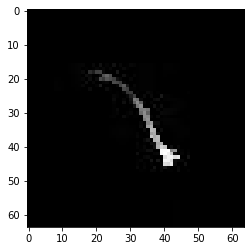

confidence for 17873 is 0.99984694


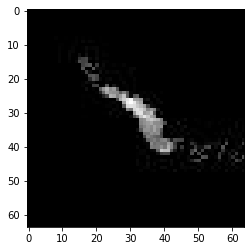

confidence for 17878 is 0.99940354


confidence for 17889 is 0.99995714


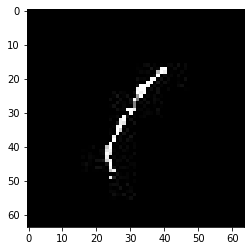

confidence for 17890 is 1.0


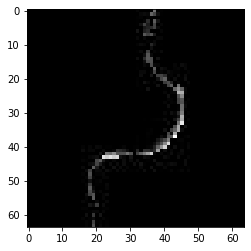

confidence for 17905 is 0.9999947


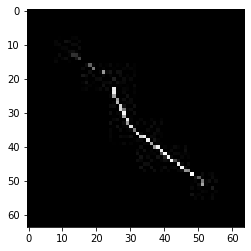

confidence for 17926 is 0.99968475


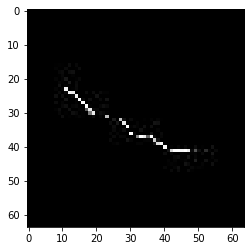

confidence for 17959 is 0.9998398


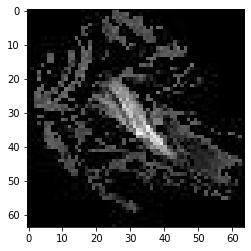

confidence for 18035 is 0.99999833


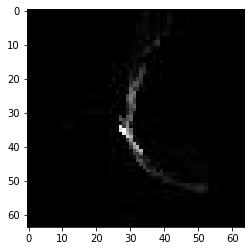

confidence for 18051 is 0.9997132


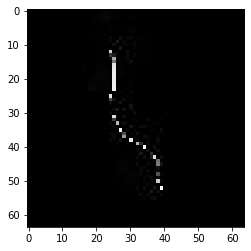

confidence for 18089 is 0.9999995


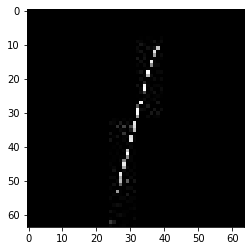

confidence for 18096 is 0.9999991


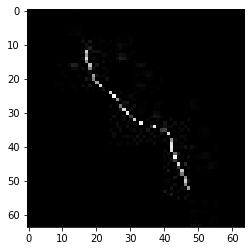

confidence for 18106 is 0.9995315


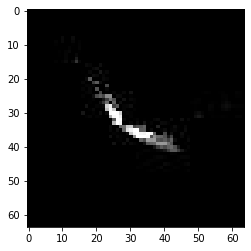

confidence for 18120 is 0.9990604


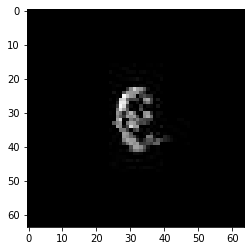

confidence for 18123 is 0.9998236


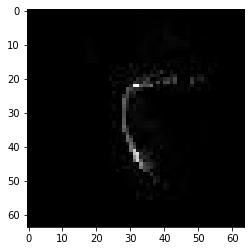

confidence for 18132 is 0.99998116


confidence for 18144 is 0.99953204


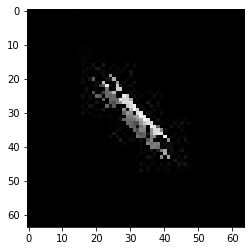

confidence for 18150 is 0.9993637


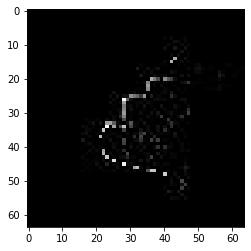

confidence for 18175 is 0.99970984


confidence for 18200 is 0.99999654


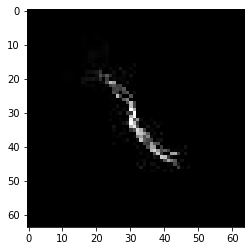

confidence for 18223 is 0.99999976


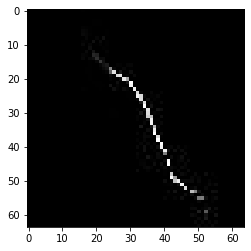

confidence for 18230 is 0.9999376


confidence for 18247 is 0.9999832


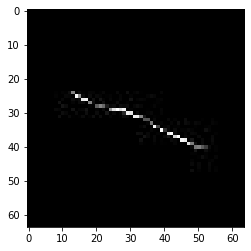

confidence for 18272 is 0.99998945


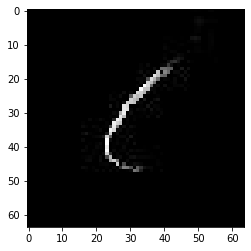

confidence for 18284 is 0.99984103


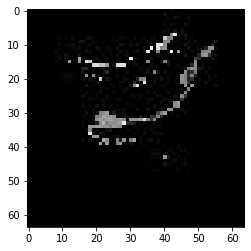

confidence for 18300 is 1.0


confidence for 18329 is 0.9990658


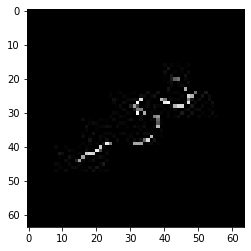

confidence for 18358 is 0.9990297


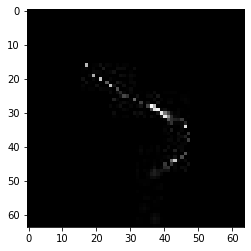

confidence for 18361 is 0.9999912


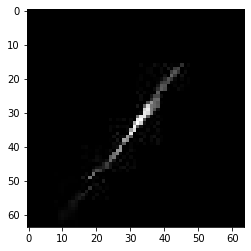

confidence for 18368 is 0.9997784


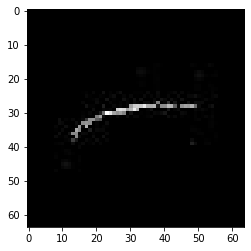

confidence for 18373 is 0.99999344


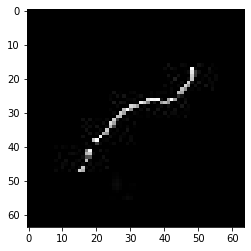

confidence for 18377 is 0.9995924


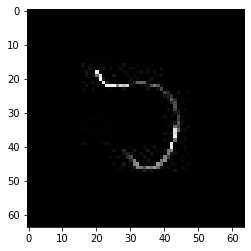

confidence for 18416 is 0.99997205


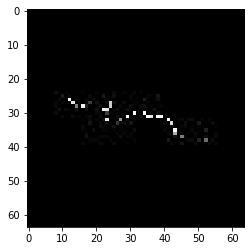

confidence for 18474 is 0.9999534


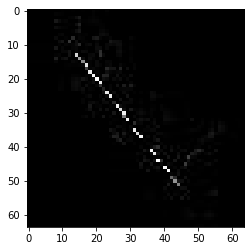

confidence for 18541 is 0.99999636


confidence for 18554 is 0.999591


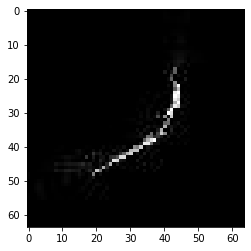

confidence for 18586 is 0.9990208


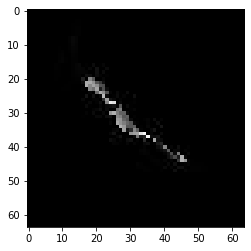

confidence for 18626 is 0.9997444


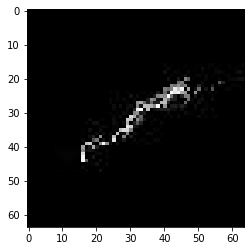

confidence for 18635 is 1.0


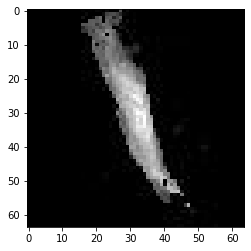

confidence for 18641 is 0.99999976


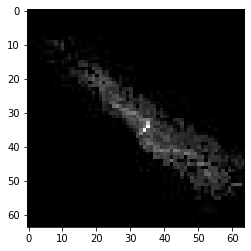

confidence for 18697 is 0.9993134


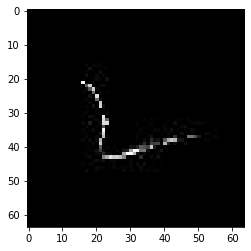

confidence for 18712 is 0.99986863


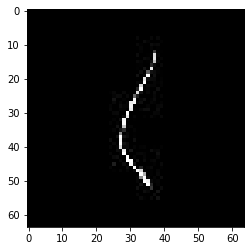

confidence for 18733 is 0.9993201


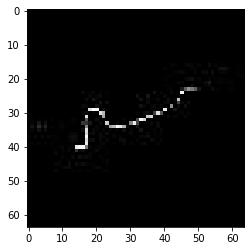

confidence for 18735 is 0.99993306


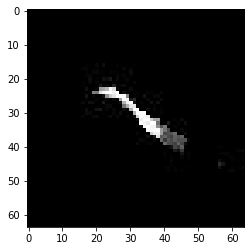

confidence for 18792 is 1.0


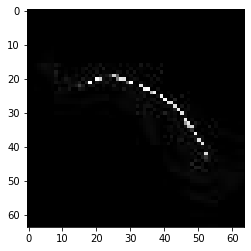

confidence for 18795 is 0.99999523


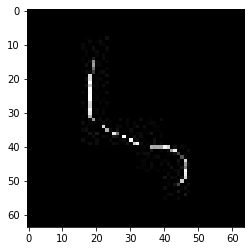

confidence for 18826 is 0.99997854


confidence for 18840 is 0.9997577


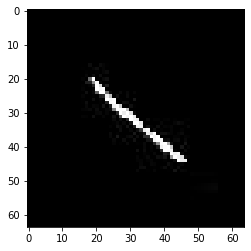

confidence for 18856 is 0.99999934


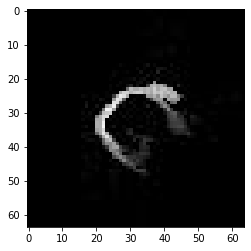

confidence for 18860 is 0.9999966


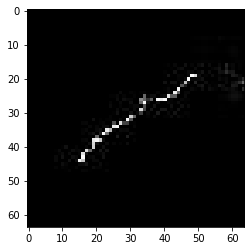

confidence for 18882 is 0.99998075


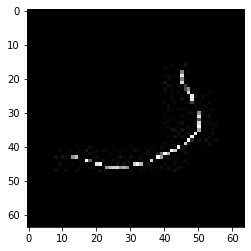

confidence for 18887 is 0.9999517


confidence for 18891 is 0.9998922


confidence for 18892 is 0.9998745


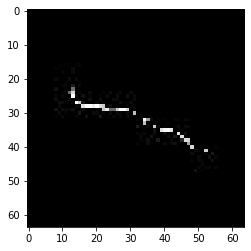

confidence for 18896 is 0.99925846


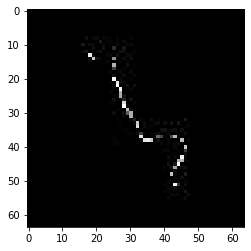

confidence for 18901 is 1.0


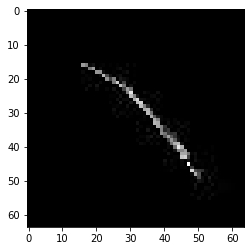

confidence for 18919 is 1.0


confidence for 18923 is 0.99999994


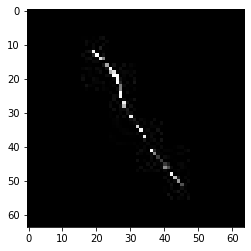

confidence for 19014 is 0.99936795


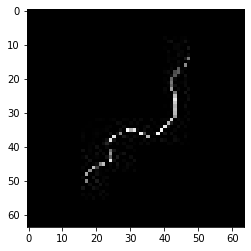

confidence for 19022 is 0.9991103


confidence for 19023 is 0.99936277


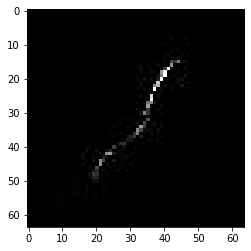

confidence for 19054 is 0.9996614


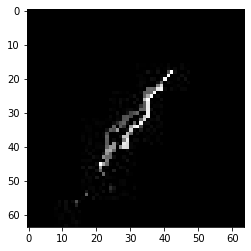

confidence for 19070 is 0.99933076


confidence for 19111 is 0.9999981


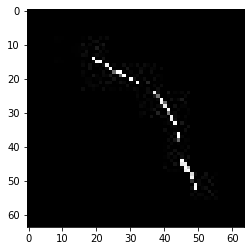

confidence for 19183 is 0.9999997


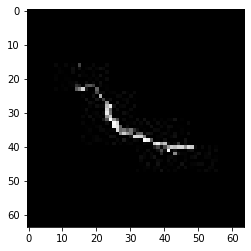

confidence for 19191 is 0.999998


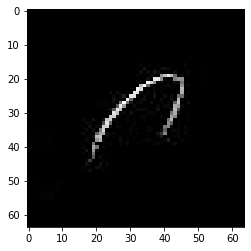

confidence for 19242 is 0.9998399


confidence for 19244 is 0.9999992


confidence for 19252 is 0.9997597


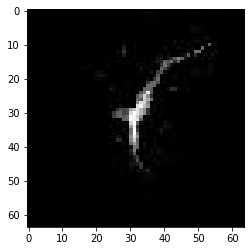

confidence for 19297 is 0.99944896


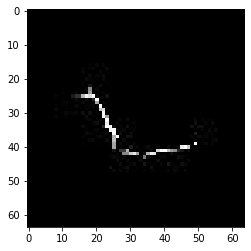

confidence for 19301 is 0.99998623


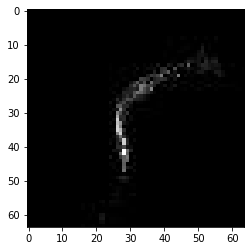

confidence for 19315 is 0.99999964


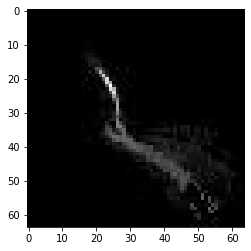

confidence for 19319 is 0.9998862


confidence for 19350 is 0.9998659


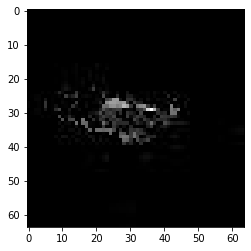

confidence for 19372 is 0.99995315


confidence for 19414 is 0.9999792


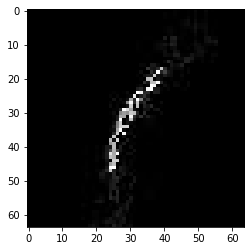

confidence for 19428 is 0.99999


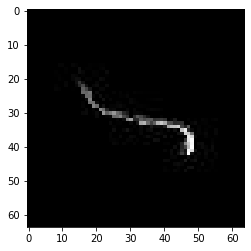

confidence for 19431 is 1.0


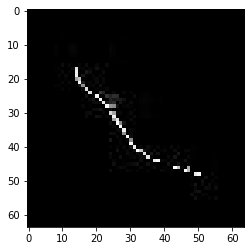

confidence for 19507 is 0.99999994


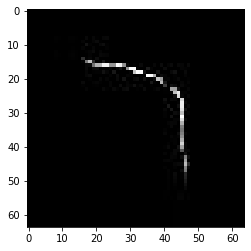

confidence for 19546 is 0.99990416


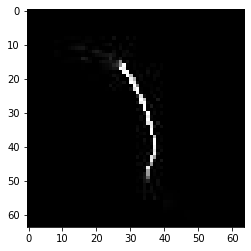

confidence for 19624 is 0.99992555


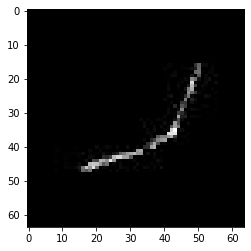

confidence for 19637 is 0.99999976


confidence for 19643 is 0.99986273


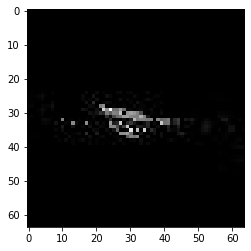

confidence for 19682 is 1.0


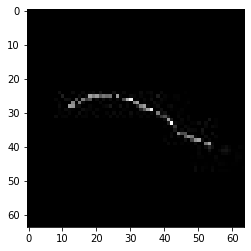

confidence for 19758 is 1.0


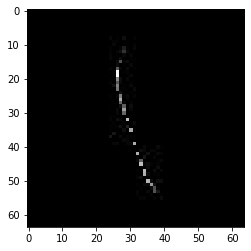

confidence for 19775 is 0.99954176


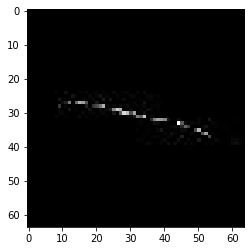

confidence for 19777 is 0.9999998


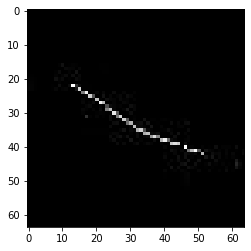

confidence for 19834 is 1.0


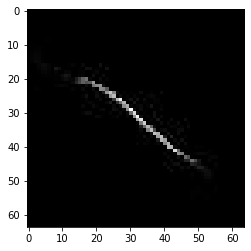

confidence for 19867 is 0.9999984


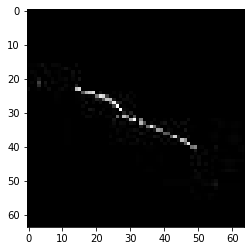

confidence for 19908 is 0.9998377


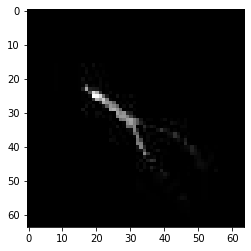

confidence for 19956 is 0.99999964


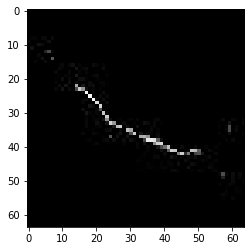

confidence for 19965 is 0.9999999


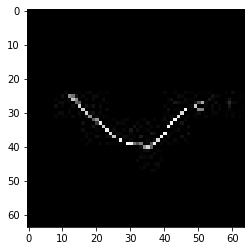

confidence for 19966 is 0.99999976


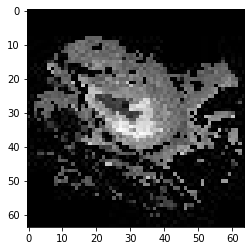

confidence for 19970 is 0.9999248


confidence for 19978 is 0.9998015


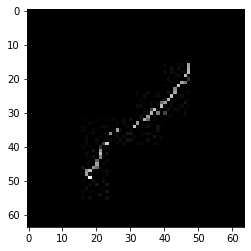

confidence for 19994 is 0.9999984


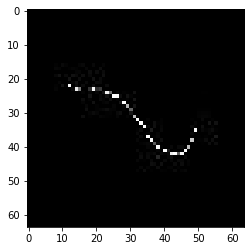

confidence for 20004 is 0.99999547


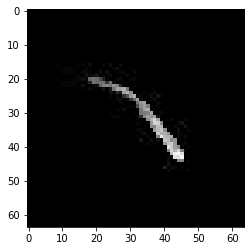

confidence for 20062 is 0.9994669


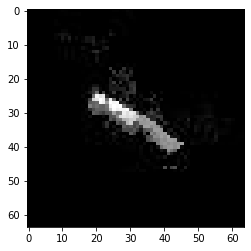

confidence for 20078 is 0.9999899


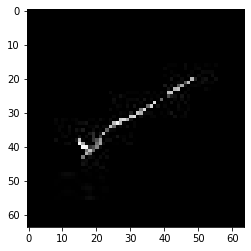

confidence for 20092 is 1.0


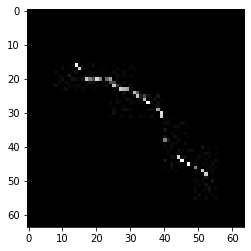

confidence for 20105 is 1.0


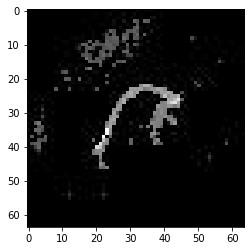

confidence for 20111 is 0.9999916


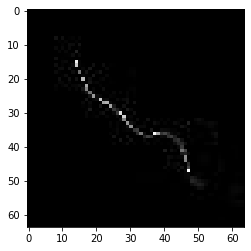

confidence for 20126 is 0.9999452


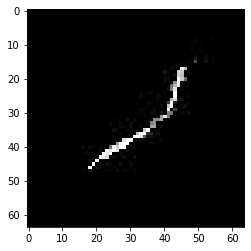

confidence for 20165 is 0.9999946


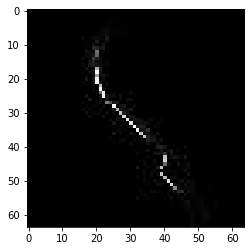

confidence for 20196 is 0.9999849


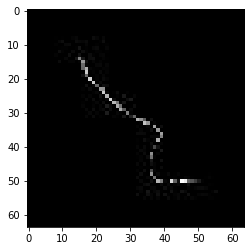

confidence for 20232 is 0.99999696


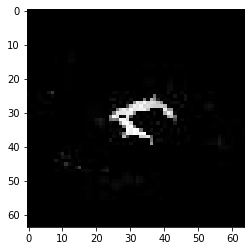

confidence for 20244 is 0.999594


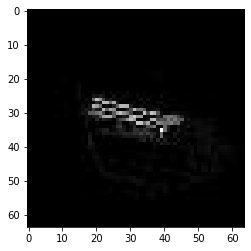

confidence for 20265 is 0.9993905


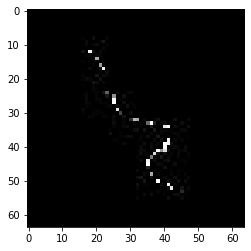

confidence for 20272 is 0.99995637


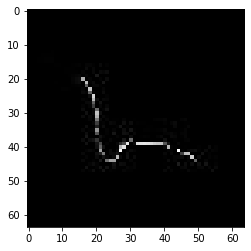

confidence for 20281 is 0.9995112


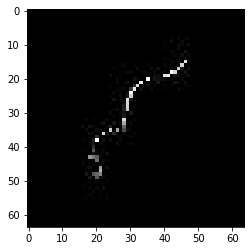

confidence for 20337 is 0.99999994


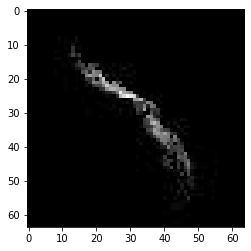

confidence for 20388 is 0.9999936


confidence for 20399 is 0.9999632


confidence for 20415 is 0.9996529


confidence for 20428 is 0.99999905


confidence for 20446 is 0.99996096


confidence for 20524 is 0.9999968


confidence for 20531 is 0.99991536


confidence for 20610 is 0.9999999


confidence for 20658 is 0.9999937


confidence for 20671 is 0.9999286


confidence for 20701 is 0.9999068


confidence for 20702 is 0.999987


confidence for 20704 is 0.9994564


confidence for 20707 is 0.99999464


confidence for 20710 is 0.9999953


confidence for 20713 is 0.9998024


confidence for 20728 is 0.99949276


confidence for 20731 is 0.999852


confidence for 20741 is 0.9997561


confidence for 20748 is 0.9995968


confidence for 20752 is 0.9999999


confidence for 20756 is 0.9995033


confidence for 20764 is 0.99968106


confidence for 20775 is 0.99998397


confidence for 20777 is 0.99999934


confidence for 20812 is 0.99944174


confidence for 20878 is 1.0


confidence for 20892 is 0.9997108


confidence for 20901 is 1.0


confidence for 20904 is 0.99992454


confidence for 20950 is 0.999983


confidence for 20984 is 0.99999994


confidence for 20999 is 0.9999671


confidence for 21040 is 0.9999898


confidence for 21064 is 0.9993914


confidence for 21098 is 0.9992114


confidence for 21104 is 1.0


confidence for 21107 is 0.9993142


confidence for 21145 is 0.99999523


confidence for 21150 is 0.99974006


confidence for 21166 is 0.99990755


confidence for 21193 is 0.9999994


confidence for 21197 is 0.999901


confidence for 21201 is 0.99999994


confidence for 21202 is 0.99986285


confidence for 21221 is 0.9994736


confidence for 21267 is 0.99998426


confidence for 21278 is 0.999371


confidence for 21333 is 0.99986404


confidence for 21411 is 0.9998522


confidence for 21475 is 1.0


confidence for 21500 is 0.9998661


confidence for 21581 is 0.99964726


confidence for 21587 is 0.99999934


confidence for 21603 is 0.99943733


confidence for 21610 is 0.99999905


confidence for 21629 is 0.9999941


confidence for 21630 is 0.9990321


confidence for 21640 is 0.9999391


confidence for 21665 is 1.0


confidence for 21694 is 0.9991524


confidence for 21738 is 0.99951595


confidence for 21776 is 1.0


confidence for 21779 is 0.9999829


confidence for 21786 is 0.9995808


confidence for 21825 is 0.99999934


confidence for 21827 is 0.9999998


confidence for 21846 is 0.9999551


confidence for 21848 is 0.9994794


confidence for 21860 is 0.9990086


confidence for 21881 is 0.99998343


confidence for 21896 is 0.999794


confidence for 21897 is 0.9999619


confidence for 21915 is 0.999966


confidence for 21949 is 0.9994027


confidence for 21971 is 0.9997077


confidence for 21995 is 1.0


confidence for 21997 is 0.9991682


confidence for 22004 is 0.999932


confidence for 22006 is 0.99989134


confidence for 22021 is 0.9999473


confidence for 22108 is 0.9999738


confidence for 22128 is 1.0


confidence for 22149 is 0.9999966


confidence for 22157 is 1.0


confidence for 22158 is 0.9999979


confidence for 22176 is 0.9998945


confidence for 22228 is 0.99996555


confidence for 22262 is 0.9999206


confidence for 22282 is 0.9998444


confidence for 22285 is 0.9999815


confidence for 22295 is 0.9996204


confidence for 22322 is 0.99999493


confidence for 22424 is 0.9999874


confidence for 22446 is 0.99997145


confidence for 22537 is 0.9992178


confidence for 22538 is 0.9999353


confidence for 22553 is 0.99999493


confidence for 22589 is 1.0


confidence for 22603 is 0.9999209


confidence for 22640 is 0.9994096


confidence for 22659 is 1.0


confidence for 22690 is 0.99997854


confidence for 22713 is 0.9999885


confidence for 22749 is 0.99963146


confidence for 22762 is 0.99999994


confidence for 22772 is 0.9997016


confidence for 22803 is 0.9999879


confidence for 22824 is 0.9999885


confidence for 22835 is 0.9996932


confidence for 22899 is 0.9998942


confidence for 22910 is 0.99957275


confidence for 22949 is 0.9999934


confidence for 22986 is 0.99997103


confidence for 22996 is 0.99999976


confidence for 23006 is 0.9998611


confidence for 23045 is 0.9999821


confidence for 23064 is 0.9999534


confidence for 23102 is 0.9999999


confidence for 23114 is 0.99958855


confidence for 23135 is 0.99996763


confidence for 23150 is 1.0


confidence for 23166 is 0.99997157


confidence for 23171 is 0.99997324


confidence for 23193 is 0.99997413


confidence for 23222 is 1.0


confidence for 23279 is 1.0


confidence for 23301 is 0.9999875


confidence for 23305 is 0.9999974


confidence for 23326 is 0.9999872


confidence for 23342 is 0.9999999


confidence for 23351 is 0.9999388


confidence for 23353 is 0.99982


confidence for 23428 is 0.99977696


confidence for 23429 is 0.999694


confidence for 23447 is 0.9999977


confidence for 23448 is 0.9999526


confidence for 23462 is 0.9996998


confidence for 23482 is 0.9999937


confidence for 23517 is 0.99965966


confidence for 23571 is 0.99934965


confidence for 23625 is 0.9999954


confidence for 23634 is 0.99998903


confidence for 23635 is 0.99932337


confidence for 23638 is 0.9993305


confidence for 23652 is 0.9998652


confidence for 23695 is 0.9999999


confidence for 23700 is 0.9999493


confidence for 23715 is 0.99995375


confidence for 23716 is 0.9992699


confidence for 23770 is 0.9997965


confidence for 23773 is 0.99905354


confidence for 23803 is 0.9999675


confidence for 23813 is 0.99932724


confidence for 23867 is 0.9991806


confidence for 23869 is 0.9999111


confidence for 23882 is 0.9993082


confidence for 23898 is 0.9999392


confidence for 23903 is 0.9999998


confidence for 23915 is 0.99999934


confidence for 23924 is 0.9992164


confidence for 23932 is 0.99993527


confidence for 23945 is 0.9999999


confidence for 23950 is 0.9999915


confidence for 23966 is 0.9999982


confidence for 24004 is 0.9992759


confidence for 24009 is 0.9999994


confidence for 24017 is 0.99995255


confidence for 24022 is 0.9999999


confidence for 24036 is 0.9997647


confidence for 24051 is 0.9999997


confidence for 24067 is 0.9992127


confidence for 24102 is 0.99999964


confidence for 24114 is 0.9995238


confidence for 24122 is 0.99999684


confidence for 24181 is 0.99999726


confidence for 24199 is 0.99962837


confidence for 24204 is 0.9996139


confidence for 24218 is 0.99996465


confidence for 24291 is 1.0


confidence for 24314 is 0.9999843


confidence for 24319 is 0.99999934


confidence for 24326 is 0.9999999


confidence for 24357 is 0.99999976


confidence for 24361 is 0.99995166


confidence for 24406 is 0.99967414


confidence for 24408 is 0.9999999


confidence for 24418 is 0.99964803


confidence for 24432 is 0.9999925


confidence for 24442 is 0.9999573


confidence for 24467 is 0.99998075


confidence for 24494 is 0.99952996


confidence for 24497 is 0.9998805


confidence for 24530 is 0.99999774


confidence for 24579 is 0.9999944


confidence for 24580 is 0.9999918


confidence for 24622 is 0.99918246


confidence for 24624 is 0.9999641


confidence for 24669 is 0.9999988


confidence for 24685 is 0.9991776


confidence for 24689 is 0.99981487


confidence for 24706 is 0.9999137


confidence for 24725 is 0.99946344


confidence for 24779 is 0.9990901


confidence for 24780 is 1.0


confidence for 24782 is 1.0


confidence for 24828 is 0.9996636


confidence for 24829 is 0.99999946


confidence for 24847 is 0.99960625


confidence for 24850 is 0.99984175


confidence for 24856 is 0.9997517


confidence for 24870 is 0.99945235


confidence for 24873 is 0.9998825


confidence for 24875 is 0.99995035


confidence for 24880 is 0.9997991


confidence for 24949 is 0.9998266


confidence for 24951 is 0.9999582


confidence for 24960 is 0.9996234


COMPLETE


In [6]:
from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

results = []
rivers = []
other = []
low_confidence = []
threshold = 0.999
model = resnet50v2model

for i in range(25000):
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i)+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    # print(model.predict(x))
    results.append(model.predict(x,verbose=0))
    if (model.predict(x,verbose=0) >= threshold):
        print("----------------------------------------------------------------------"+str(i)+" is a predicted river")
        #print(results)
        
for i in range(len(results)):
    if (results[i][0] >= threshold):
        rivers.append([i,results[i][0]])
    elif (results[i][0] <= (1-threshold)):
        other.append([i,results[i][0]])
    else:
        low_confidence.append([i,results[i][0]])

print("number of rivers:",len(rivers))
print("number of other:",len(other))
print("number of low confidence:",len(low_confidence))

rivercount = 0

for i in rivers:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    plt.imshow(img)
    print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
    plt.show()
    if (rivercount//8 == 0):
        img.save("../data/shonal_test/it1/train/river/"+str(i[0])+".jpeg", "JPEG")
    if (rivercount//8 == 1):
        img.save("../data/shonal_test/it1/test/river/"+str(i[0])+".jpeg", "JPEG")

othercount = 0
    
for i in other:
    img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    if (othercount//8 == 0):
        img.save("../data/shonal_test/it1/train/other/"+str(i[0])+".jpeg", "JPEG")
    if (othercount//8 == 1):
        img.save("../data/shonal_test/it1/test/other/"+str(i[0])+".jpeg", "JPEG")

for i in low_confidence:
    img_path = "../data/shonal_unlabeled/unlabeled/"+str(i[0])+'.jpeg'
    img = image.load_img(img_path, target_size=(64,64))
    img.save("../data/shonal_test/it1/unlabeled"+str(i[0])+".jpeg", "JPEG")
    

print("COMPLETE")

In [7]:
train_augmentation = ImageDataGenerator(
    rescale = 1./255,
    shear_range = 0.2,
    horizontal_flip = True,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
)

test_rescale = ImageDataGenerator(
    rescale = 1./255
)

train_path = "../data/shonal_test/it1/train"
valid_path = '../data/shonal_test/it1/test'
training = train_augmentation.flow_from_directory(train_path,
                                                 target_size = (64,64),
                                                 batch_size = 8,
                                                 class_mode = 'binary')
testing = test_rescale.flow_from_directory(valid_path,
                                               target_size = (64,64),
                                               batch_size = 8,
                                               class_mode = 'binary')

Found 16585 images belonging to 2 classes.
Found 352 images belonging to 2 classes.


In [8]:
IMAGE_SIZE = [64,64]

resnet50v2 = tf.keras.applications.ResNet50V2(weights='imagenet',
                                              include_top = False,
                                              classes = 2
                                              #input_shape=(64,64,3)
                                             )

for layer in resnet50v2.layers:
    layer.trainable = False
    
resnet50v2.summary()

output = resnet50v2.output
output2 = tf.keras.layers.GlobalAveragePooling2D()(output)
output3 = tf.keras.layers.Dense(128,activation='relu')(output2)
y = tf.keras.layers.Dense(1,activation='sigmoid')(output3)
resnet50v2model = tf.keras.Model(inputs=resnet50v2.input, outputs=y)
resnet50v2model.compile(loss='binary_crossentropy', 
                        optimizer='adam',
                        metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])

hist = resnet50v2model.fit(training,
                validation_data = testing,
                epochs = 20,
                steps_per_epoch=len(training),
                validation_steps=len(testing))

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_2[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                      

                                                                                                  
 conv2_block2_out (Add)         (None, None, None,   0           ['conv2_block1_out[0][0]',       
                                256)                              'conv2_block2_3_conv[0][0]']    
                                                                                                  
 conv2_block3_preact_bn (BatchN  (None, None, None,   1024       ['conv2_block2_out[0][0]']       
 ormalization)                  256)                                                              
                                                                                                  
 conv2_block3_preact_relu (Acti  (None, None, None,   0          ['conv2_block3_preact_bn[0][0]'] 
 vation)                        256)                                                              
                                                                                                  
 conv2_blo

                                128)                             ]                                
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, None, None,   512        ['conv3_block2_1_conv[0][0]']    
 ization)                       128)                                                              
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, None, None,   0          ['conv3_block2_1_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 conv3_block2_2_pad (ZeroPaddin  (None, None, None,   0          ['conv3_block2_1_relu[0][0]']    
 g2D)                           128)                                                              
          

 conv3_block4_2_relu (Activatio  (None, None, None,   0          ['conv3_block4_2_bn[0][0]']      
 n)                             128)                                                              
                                                                                                  
 max_pooling2d_4 (MaxPooling2D)  (None, None, None,   0          ['conv3_block3_out[0][0]']       
                                512)                                                              
                                                                                                  
 conv3_block4_3_conv (Conv2D)   (None, None, None,   66048       ['conv3_block4_2_relu[0][0]']    
                                512)                                                              
                                                                                                  
 conv3_block4_out (Add)         (None, None, None,   0           ['max_pooling2d_4[0][0]',        
          

                                                                                                  
 conv4_block3_preact_relu (Acti  (None, None, None,   0          ['conv4_block3_preact_bn[0][0]'] 
 vation)                        1024)                                                             
                                                                                                  
 conv4_block3_1_conv (Conv2D)   (None, None, None,   262144      ['conv4_block3_preact_relu[0][0]'
                                256)                             ]                                
                                                                                                  
 conv4_block3_1_bn (BatchNormal  (None, None, None,   1024       ['conv4_block3_1_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_blo

                                256)                                                              
                                                                                                  
 conv4_block5_2_bn (BatchNormal  (None, None, None,   1024       ['conv4_block5_2_conv[0][0]']    
 ization)                       256)                                                              
                                                                                                  
 conv4_block5_2_relu (Activatio  (None, None, None,   0          ['conv4_block5_2_bn[0][0]']      
 n)                             256)                                                              
                                                                                                  
 conv4_block5_3_conv (Conv2D)   (None, None, None,   263168      ['conv4_block5_2_relu[0][0]']    
                                1024)                                                             
          

 conv5_block1_out (Add)         (None, None, None,   0           ['conv5_block1_0_conv[0][0]',    
                                2048)                             'conv5_block1_3_conv[0][0]']    
                                                                                                  
 conv5_block2_preact_bn (BatchN  (None, None, None,   8192       ['conv5_block1_out[0][0]']       
 ormalization)                  2048)                                                             
                                                                                                  
 conv5_block2_preact_relu (Acti  (None, None, None,   0          ['conv5_block2_preact_bn[0][0]'] 
 vation)                        2048)                                                             
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, None, None,   1048576     ['conv5_block2_preact_relu[0][0]'
          

In [9]:
train_score = resnet50v2model.evaluate(training)
test_score = resnet50v2model.evaluate(testing)
print("train accuracy:",train_score[1]*100,"%")
print("test accuracy:", test_score[1]*100,"%")

44/44 [==============================] - 1s 21ms/step - loss: 0.0808 - accuracy: 0.9744 - precision_1: 0.8873 - recall_1: 0.9844
train accuracy: 99.09557104110718 %
test accuracy: 97.44318127632141 %


In [60]:
# from tensorflow.keras.applications.resnet_v2 import ResNet50V2, preprocess_input, decode_predictions

# results = []
# rivers = []
# other = []
# low_confidence = []
# threshold = 0.999
# model = resnet50v2model

# for i in os.listdir("../data/shonal_test/it1/low_confidence"):
#     img_path = '../data/shonal_unlabeled/unlabeled/'+str(i)
#     img = image.load_img(img_path, target_size=(64,64))
#     x = image.img_to_array(img)
#     x = np.expand_dims(x, axis=0)
#     x = preprocess_input(x)
#     results.append([i.split(".jpeg")[0],model.predict(x,verbose=0)])
        
# for i in range(len(results)):
#     if (results[i][1][0] >= threshold):
#         rivers.append([results[i][0],results[i][1][0]])
#     elif (results[i][1][0] <= (1-threshold)):
#         other.append([results[i][0],results[i][1][0]])
#     else:
#         low_confidence.append([results[i][0],results[i][1][0]])

# print("number of rivers:",len(rivers))
# print("number of other:",len(other))
# print("number of low confidence:",len(low_confidence))

# rivercount = 0

# for i in rivers:
#     img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
#     img = image.load_img(img_path, target_size=(64,64))
#     plt.imshow(img)
#     print("confidence for " +str(i[0])+ " is "+ str(i[1][0]))
#     plt.show()
#     if (rivercount//8 == 0):
#         img.save("../data/shonal_test/it1/train/river/"+str(i[0])+".jpeg", "JPEG")
#     if (rivercount//8 == 1):
#         img.save("../data/shonal_test/it1/test/river/"+str(i[0])+".jpeg", "JPEG")

# othercount = 0
    
# for i in other:
#     img_path = '../data/shonal_unlabeled/unlabeled/'+str(i[0])+'.jpeg'
#     img = image.load_img(img_path, target_size=(64,64))
#     if (othercount//8 = 0):
#         img.save("../data/shonal_test/it1/train/other/"+str(i[0])+".jpeg", "JPEG")
#     if (othercount//8 == 1):
#         img.save("../data/shonal_test/it1/test/other/"+str(i[0])+".jpeg", "JPEG")

# for i in low_confidence:
#     img_path = "../data/shonal_unlabeled/unlabeled/"+str(i[0])+'.jpeg'
#     img = image.load_img(img_path, target_size=(64,64))
#     img.save("../data/shonal_test/it1/unlabeled"+str(i[0])+".jpeg", "JPEG")
    

# print("COMPLETE")

# end of 12/12/22